In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import os
from os.path import join as opjoin
my_drive_path = '/content/drive/My Drive'
base_path = opjoin(my_drive_path, 'CT-GAN')
os.chdir(base_path)
from paths import *


In [2]:
os.chdir(base_path)
!git pull

remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (1/1), done.
remote: Total 4 (delta 3), reused 4 (delta 3), pack-reused 0
Unpacking objects: 100% (4/4), done.
From https://github.com/tilacyn/CT-GAN
   50edbb9..b482fe2  master     -> origin/master
Updating 50edbb9..b482fe2
Fast-forward
 procedures/mhd_injector.py | 2 +-
 1 file changed, 1 insertion(+), 1 deletion(-)


In [0]:
from matplotlib import pyplot as plt
from augmentation.luna import get_aug_service
from augmentation.coordinates_resolver import get_vox_coords
import numpy as np

def show(tampered, r, vc):
  plt.imshow(tampered[vc[0], vc[1]-r:vc[1]+r, vc[2]-r:vc[2]+r])
  plt.show()
  plt.imshow(tampered[vc[0], vc[1]-2*r:vc[1]+2*r, vc[2]-2*r:vc[2]+2*r])
  plt.show()

def show_full(tampered, vc):
  plt.imshow(tampered[vc[0]])
  plt.show()

def show_for_scan(numbers, label_getter, scan_path_getter):
  for n in numbers:
    scan_path = scan_path_getter(n)
    scan = np.load(scan_path)
    if len(scan.shape) == 4:
      scan = scan[0]
    print(scan.shape)
    label = label_getter(n)
    print(label)
    show_full(scan, label.astype(int))
    show(scan, 20, label.astype(int))

def show_generated_raw(numbers):
    scan_path_getter = lambda n: opjoin(base_path, 'generated/generated_{}.mhd.npy'.format(n))
    label_getter = get_vox_coords
    show_for_scan(numbers, label_getter, scan_path_getter)


def show_generated_preprocessed(numbers):
    scan_path_getter = lambda n: opjoin(data_base_path, 'data/augmented-preprocess-result-path/{}_clean.npy'.format(n))
    label_getter = lambda n: np.load(opjoin(data_base_path, 'data/augmented-preprocess-result-path/{}_label.npy'.format(n)))[0, :-1]
    show_for_scan(numbers, label_getter, scan_path_getter)

def show_real(numbers):
    scan_path_getter = lambda n: opjoin(data_base_path, 'data/preprocess-result-path/{}_clean.npy'.format(n))
    label_getter = lambda n: np.load(opjoin(data_base_path, 'data/preprocess-result-path/{}_label.npy'.format(n)))[0, :-1]
    show_for_scan(numbers, label_getter, scan_path_getter)  


def get_mhd_path(number):
  return opjoin(data_base_path, 'data/luna-data/{}.mhd'.format(number))

def init_aug_service(numbers):
  # scan_paths = [opjoin(data_base_path, 'data/preprocess-result-path/{}_clean.npy'.format(n)) for n in numbers]
  scan_paths = [get_mhd_path(n) for n in numbers]
  generator_path = 'wasserstein_16'
  save_dir = opjoin(base_path, 'generated')
  aug_service = get_aug_service('mhd', scan_paths, generator_path, save_dir)
  return aug_service

def augment(numbers):
  os.chdir(base_path)
  aug_service = init_aug_service(numbers)
  aug_service.load_generator()
  aug_service.augment()
  

In [7]:
int("008")

8

In [0]:
augment(np.arange(120, 200))

===Init Tamperer===
Loading models


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/layers/core.py:1030: UserWarning: procedures.trainer is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 4, 4, 4, 400)
(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)
shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 1, 1, 1, 800)
(None, 800)
(None, 800)
adain
(None, 1, 1, 1, 800)
shape after adain: (None, 1, 1, 1, 800)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)
shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 4, 4, 4, 400)
(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 16, 16, 16, 100)
(None, 100)
(None, 100)
adain
(N

(216, 512, 512)
[128 315  99]


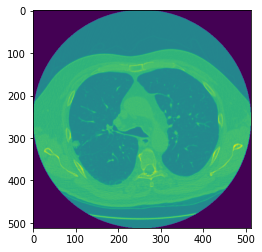

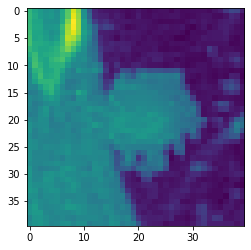

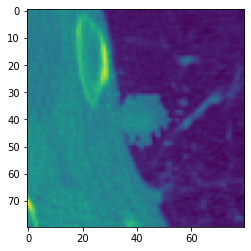

In [5]:
show_generated_raw()

(181, 512, 512)
[ 89 408 185]


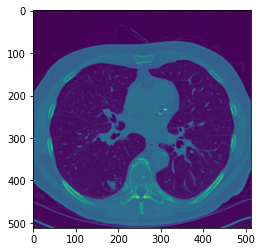

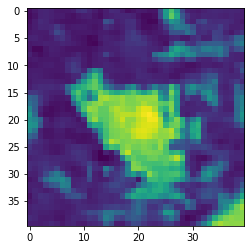

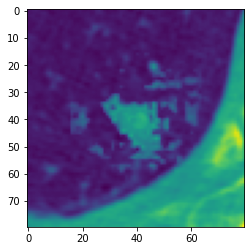

(246, 512, 512)
[ 91 307  81]


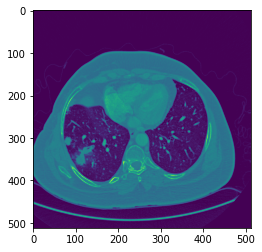

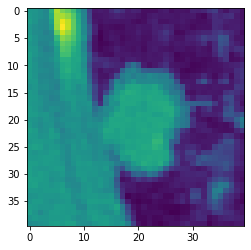

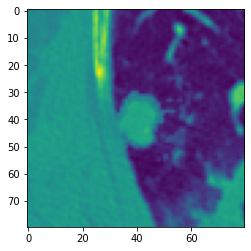

(343, 512, 512)
[193 196 418]


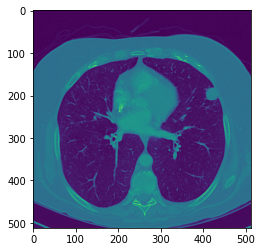

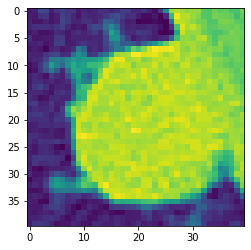

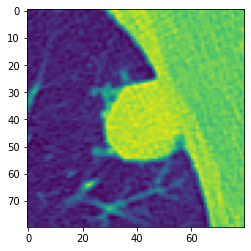

(295, 512, 512)
[125 317  59]


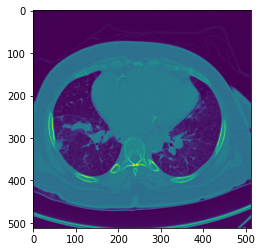

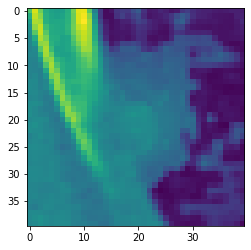

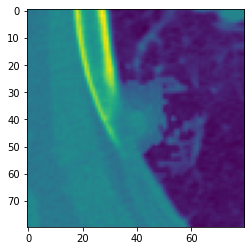

(149, 512, 512)
[ 48 336 320]


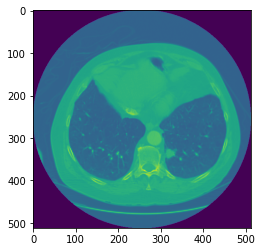

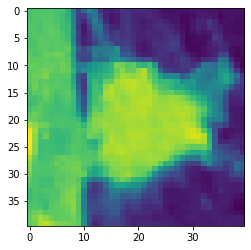

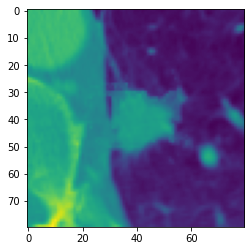

In [8]:
show_generated_raw([100, 101, 102, 103, 105])

(269, 239, 324)
[112.358979   202.36336568 113.27327442]


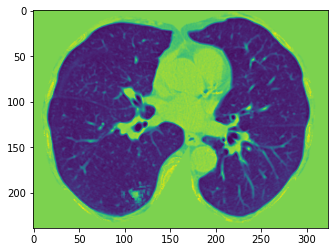

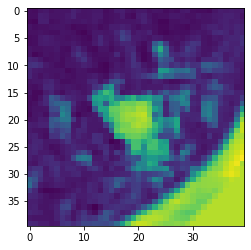

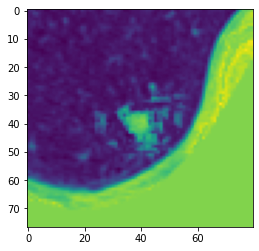

(246, 205, 286)
[ 91.654695  118.5728946  24.769919 ]


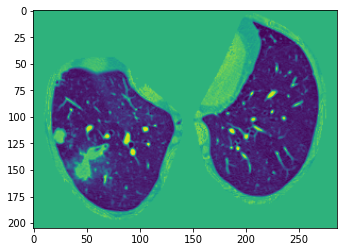

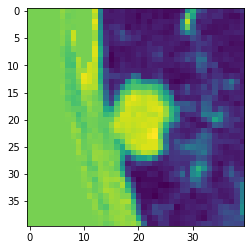

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  if __name__ == '__main__':


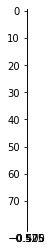

(238, 245, 310)
[140.90427008 158.54110075  38.9353147 ]


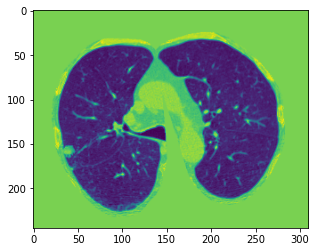

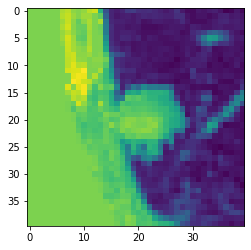

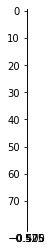

In [9]:
show_generated_preprocessed([100, 101, 802])

(238, 245, 310)
[140.90427008 158.54110075  38.9353147 ]


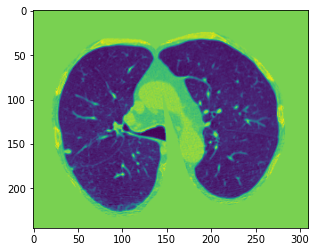

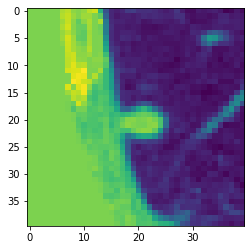

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  if __name__ == '__main__':


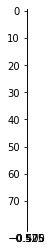

In [7]:
show_real([802])

(238, 245, 310)
[140.90427008 158.54110075  38.9353147 ]


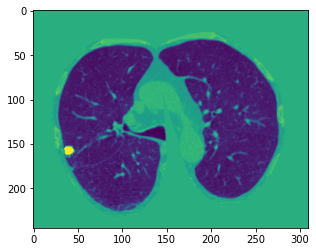

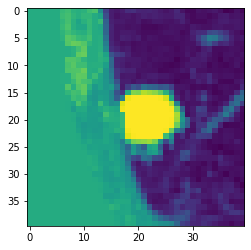

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  if __name__ == '__main__':


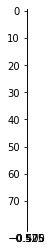

In [13]:
show_generated_preprocessed([802])

In [5]:
a = np.arange(30).reshape(5, 6)
a.max()

29

(238, 245, 310)
[140.90427008 158.54110075  38.9353147 ]


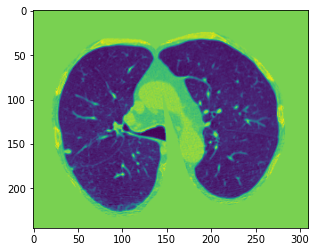

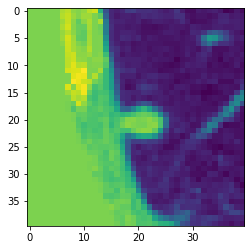

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  if __name__ == '__main__':


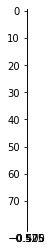

In [12]:
show_real([802])

In [8]:
aug_service = init_aug_service([800])
aug_service.load_generator()
aug_service.injector.load_target_scan(get_mhd_path(800))

===Init Tamperer===
Loading models
shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 4, 4, 4, 400)


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/layers/core.py:1030: UserWarning: procedures.trainer is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)
shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 1, 1, 1, 800)
(None, 800)
(None, 800)
adain
(None, 1, 1, 1, 800)
shape after adain: (None, 1, 1, 1, 800)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)
shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 4, 4, 4, 400)
(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 16, 16, 16, 100)
(None, 100)
(None, 100)
adain
(None, 16, 16, 16, 100)
shape after adain: (None, 16, 16, 16, 100)
Loaded Injector Model
Loading scan


In [10]:
aug_service.injector.scan.shape

(135, 512, 512)

In [0]:
aug_service.load_generator()

===Init Tamperer===
Loading models
shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 4, 4, 4, 400)
(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/layers/core.py:1030: UserWarning: procedures.trainer is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 1, 1, 1, 800)
(None, 800)
(None, 800)
adain
(None, 1, 1, 1, 800)
shape after adain: (None, 1, 1, 1, 800)
shape before adain: (None, 2, 2, 2, 800)
(None, 800)
(None, 800)
adain
(None, 2, 2, 2, 800)
shape after adain: (None, 2, 2, 2, 800)
shape before adain: (None, 4, 4, 4, 400)
(None, 400)
(None, 400)
adain
(None, 4, 4, 4, 400)
shape after adain: (None, 4, 4, 4, 400)
shape before adain: (None, 8, 8, 8, 200)
(None, 200)
(None, 200)
adain
(None, 8, 8, 8, 200)
shape after adain: (None, 8, 8, 8, 200)
shape before adain: (None, 16, 16, 16, 100)
(None, 100)
(None, 100)
adain
(None, 16, 16, 16, 100)
shape after adain: (None, 16, 16, 16, 100)
Loaded Injector Model


In [0]:
result = aug_service.injector.generator_inj.predict([np.random.randn(1, 32, 32, 32, 1)])
result = result[0, :, :, :, 0]

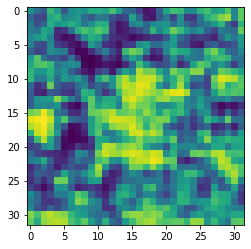

In [0]:
plt.imshow(result[16])

[[ 26.0866714  156.6384829  174.39610873   4.27720254]
 [ 71.3179593  115.68609266 109.24151874  23.80291305]]


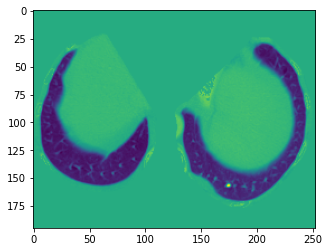

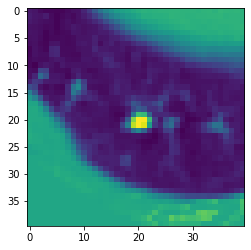

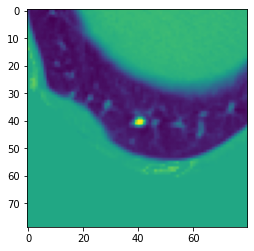

In [0]:
scan = np.load(opjoin(data_base_path, 'data/preprocess-result-path/887_clean.npy'))
label = np.load(opjoin(data_base_path, 'data/preprocess-result-path/887_label.npy'))
print(label)
label = label[0, :-1]
scan = scan[0]
show_full(scan, label.astype(int))
show(scan, 20, label.astype(int))
# scan.shape

In [0]:
from procedures.attack_pipeline import print_mean_std
dull  = scan[26, 90:110, 90:110]
bright = scan[26, 150:170, 150:180]
print_mean_std(dull)
print_mean_std(scan)
print_mean_std(bright)

mean: 0.44232635292088496, std: 0.020861364521970877
mean: 0.358409521712318, std: 0.1742144890503575
mean: -0.053358466924595026, std: 0.3346892896062603



Training CT-GAN Injector...
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 32,  0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 32, 32, 32,  0                                            
__________________________________________________________________________________________________
concatenate (Concatenate)       (None, 32, 32, 32, 2 0           input_1[0][0]                    
                                                                 input_2[0][0]                    
__________________________________________________________________________________________________
conv3d (Conv3D)                 (None, 16, 16, 16, 1 12900       

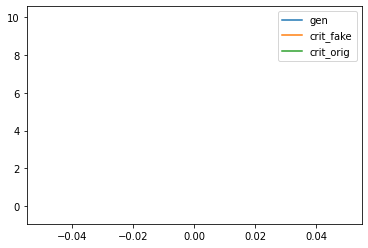

d loss fake  -0.17528322339057922
d loss real  0.005446590483188629
[Epoch 0/100] [Batch 1/345] [D loss: -0.084918, acc:   7%] [G loss: 10.149374] [c1: -0.117358, c2: -0.117508, o: -0.064218, f: -0.063083] time: 0:00:20.000749
d loss fake  -0.247188538312912
d loss real  -0.3470296859741211
[Epoch 0/100] [Batch 2/345] [D loss: -0.297109, acc:   9%] [G loss: 9.118769] [c1: -0.172486, c2: -0.173398, o: -0.121415, f: -0.116962] time: 0:00:22.302056
d loss fake  -0.4624214172363281
d loss real  -0.2659263610839844
[Epoch 0/100] [Batch 3/345] [D loss: -0.364174, acc:   4%] [G loss: 9.388139] [c1: -0.221081, c2: -0.222128, o: -0.181520, f: -0.173796] time: 0:00:24.592552
d loss fake  -0.3427351415157318
d loss real  -0.5751659870147705
[Epoch 0/100] [Batch 4/345] [D loss: -0.458951, acc:   3%] [G loss: 9.055479] [c1: -0.262180, c2: -0.264915, o: -0.239699, f: -0.223405] time: 0:00:26.898373
d loss fake  -0.4957171678543091
d loss real  -0.7285780906677246
[Epoch 0/100] [Batch 5/345] [D loss:

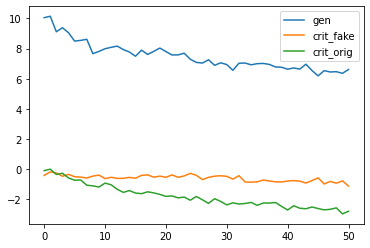

d loss fake  -1.0133414268493652
d loss real  -2.776765823364258
[Epoch 0/100] [Batch 51/345] [D loss: -1.895054, acc:   0%] [G loss: 6.547124] [c1: 1.517483, c2: 1.383145, o: -2.086397, f: 1.381524] time: 0:02:15.480348
d loss fake  -0.7961515784263611
d loss real  -2.700223445892334
[Epoch 0/100] [Batch 52/345] [D loss: -1.748188, acc:   0%] [G loss: 6.382412] [c1: 1.330806, c2: 1.190578, o: -2.119644, f: 1.192299] time: 0:02:17.778384
d loss fake  -0.8784316778182983
d loss real  -3.02046537399292
[Epoch 0/100] [Batch 53/345] [D loss: -1.949449, acc:   0%] [G loss: 6.423699] [c1: 1.411287, c2: 1.266704, o: -2.368476, f: 1.270110] time: 0:02:20.084232
d loss fake  -0.8386422395706177
d loss real  -2.7978515625
[Epoch 0/100] [Batch 54/345] [D loss: -1.818247, acc:   0%] [G loss: 6.305701] [c1: 1.367217, c2: 1.223108, o: -2.239704, f: 1.260186] time: 0:02:22.376441
d loss fake  -0.7841024994850159
d loss real  -2.3453259468078613
[Epoch 0/100] [Batch 55/345] [D loss: -1.564714, acc:   

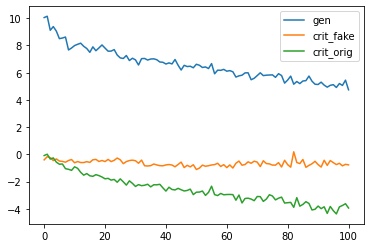

d loss fake  -0.3367181420326233
d loss real  -4.492063999176025
[Epoch 0/100] [Batch 101/345] [D loss: -2.414391, acc:   0%] [G loss: 4.845360] [c1: 0.917316, c2: 0.807439, o: -3.548569, f: 0.821565] time: 0:04:17.990601
d loss fake  -0.308107852935791
d loss real  -4.484819412231445
[Epoch 0/100] [Batch 102/345] [D loss: -2.396464, acc:   0%] [G loss: 4.551508] [c1: 0.771452, c2: 0.678924, o: -3.532967, f: 0.657003] time: 0:04:20.283525
d loss fake  -0.8395292162895203
d loss real  -4.766870498657227
[Epoch 0/100] [Batch 103/345] [D loss: -2.803200, acc:   0%] [G loss: 4.547877] [c1: 1.553151, c2: 1.441813, o: -3.729657, f: 1.432992] time: 0:04:22.561809
d loss fake  -0.7554184198379517
d loss real  -4.420109748840332
[Epoch 0/100] [Batch 104/345] [D loss: -2.587764, acc:   0%] [G loss: 4.831646] [c1: 1.342947, c2: 1.211663, o: -3.467601, f: 1.217265] time: 0:04:24.862196
d loss fake  -1.1759803295135498
d loss real  -4.409337043762207
[Epoch 0/100] [Batch 105/345] [D loss: -2.792659

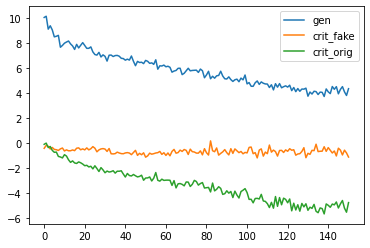

d loss fake  -0.6850619316101074
d loss real  -5.423555850982666
[Epoch 0/100] [Batch 151/345] [D loss: -3.054309, acc:   0%] [G loss: 3.833404] [c1: 1.441746, c2: 1.316671, o: -4.545094, f: 1.386590] time: 0:06:31.285070
d loss fake  -0.8427590131759644
d loss real  -4.8300323486328125
[Epoch 0/100] [Batch 152/345] [D loss: -2.836396, acc:   0%] [G loss: 4.180282] [c1: 1.462105, c2: 1.331573, o: -4.000078, f: 1.338324] time: 0:06:33.577410
d loss fake  -0.7557836771011353
d loss real  -4.997730255126953
[Epoch 0/100] [Batch 153/345] [D loss: -2.876757, acc:   0%] [G loss: 4.334011] [c1: 1.212723, c2: 1.126309, o: -4.153940, f: 1.054158] time: 0:06:35.867655
d loss fake  -0.3861590027809143
d loss real  -4.852919578552246
[Epoch 0/100] [Batch 154/345] [D loss: -2.619539, acc:   0%] [G loss: 4.034467] [c1: 0.990892, c2: 0.931469, o: -4.028135, f: 0.942854] time: 0:06:38.166684
d loss fake  -0.28315627574920654
d loss real  -5.6418046951293945
[Epoch 0/100] [Batch 155/345] [D loss: -2.96

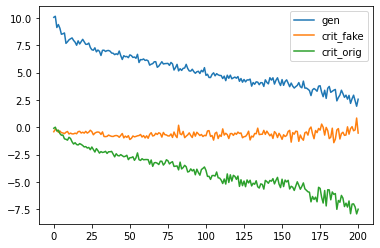

d loss fake  0.3467552661895752
d loss real  -6.262637138366699
[Epoch 0/100] [Batch 201/345] [D loss: -2.957941, acc:   0%] [G loss: 3.126050] [c1: 0.083025, c2: 0.086633, o: -5.282959, f: -0.046945] time: 0:08:26.543013
d loss fake  -1.0742555856704712
d loss real  -6.624214172363281
[Epoch 0/100] [Batch 202/345] [D loss: -3.849235, acc:   0%] [G loss: 3.419486] [c1: 1.854249, c2: 1.730481, o: -5.564137, f: 1.696268] time: 0:08:28.837827
d loss fake  -0.22980839014053345
d loss real  -7.372276782989502
[Epoch 0/100] [Batch 203/345] [D loss: -3.801043, acc:   0%] [G loss: 2.381844] [c1: 0.969726, c2: 0.882624, o: -6.150041, f: 0.953849] time: 0:08:31.122842
d loss fake  -0.3601587116718292
d loss real  -6.900924205780029
[Epoch 0/100] [Batch 204/345] [D loss: -3.630541, acc:   0%] [G loss: 2.905476] [c1: 1.072736, c2: 0.963547, o: -5.860231, f: 1.024556] time: 0:08:33.417452
d loss fake  -0.012887008488178253
d loss real  -7.516457557678223
[Epoch 0/100] [Batch 205/345] [D loss: -3.76

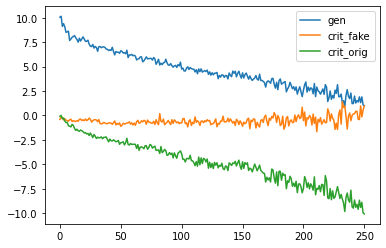

d loss fake  0.43713629245758057
d loss real  -8.588296890258789
[Epoch 0/100] [Batch 251/345] [D loss: -4.075580, acc:   0%] [G loss: 1.155780] [c1: 0.087148, c2: -0.015773, o: -7.522513, f: -0.039512] time: 0:10:29.604504
d loss fake  0.24954041838645935
d loss real  -7.3591413497924805
[Epoch 0/100] [Batch 252/345] [D loss: -3.554800, acc:   0%] [G loss: 2.503209] [c1: 0.227014, c2: 0.120061, o: -6.342026, f: 0.041040] time: 0:10:31.895129
d loss fake  0.9568226933479309
d loss real  -8.372262001037598
[Epoch 0/100] [Batch 253/345] [D loss: -3.707720, acc:   0%] [G loss: 2.106355] [c1: -0.314944, c2: -0.384033, o: -7.042254, f: -0.436880] time: 0:10:34.181419
d loss fake  -0.8016405701637268
d loss real  -8.323441505432129
[Epoch 0/100] [Batch 254/345] [D loss: -4.562541, acc:   0%] [G loss: 2.096293] [c1: 1.641742, c2: 1.508561, o: -7.302462, f: 1.521752] time: 0:10:36.466026
d loss fake  1.2251684665679932
d loss real  -10.105287551879883
[Epoch 0/100] [Batch 255/345] [D loss: -4.

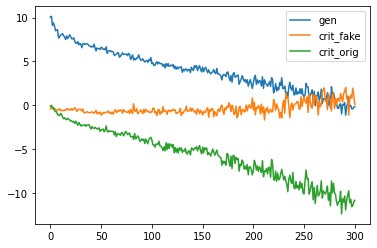

d loss fake  -0.23925204575061798
d loss real  -10.390992164611816
[Epoch 0/100] [Batch 301/345] [D loss: -5.315122, acc:   0%] [G loss: 0.437197] [c1: 0.747655, c2: 0.424325, o: -9.710842, f: 0.548382] time: 0:12:28.683151
d loss fake  2.152134418487549
d loss real  -11.887451171875
[Epoch 0/100] [Batch 302/345] [D loss: -4.867658, acc:   0%] [G loss: -0.804298] [c1: -1.333340, c2: -1.342005, o: -10.652741, f: -1.215574] time: 0:12:30.977373
d loss fake  2.1345086097717285
d loss real  -11.993703842163086
[Epoch 0/100] [Batch 303/345] [D loss: -4.929598, acc:   0%] [G loss: -0.775178] [c1: -1.289863, c2: -1.216844, o: -10.564085, f: -1.313875] time: 0:12:33.255491
d loss fake  2.286060094833374
d loss real  -12.204586029052734
[Epoch 0/100] [Batch 304/345] [D loss: -4.959263, acc:   0%] [G loss: -1.383641] [c1: -1.591204, c2: -1.281738, o: -10.847075, f: -1.651419] time: 0:12:35.552087
d loss fake  0.19312435388565063
d loss real  -11.500839233398438
[Epoch 0/100] [Batch 305/345] [D l

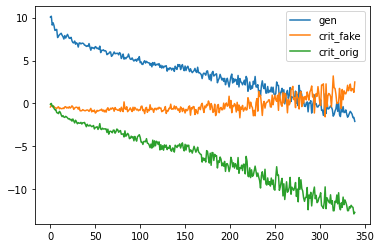

d loss fake  5.024415969848633
d loss real  -12.824004173278809
[Epoch 1/100] [Batch 1/345] [D loss: -3.899794, acc:   0%] [G loss: -2.681956] [c1: -4.638101, c2: -4.311470, o: -11.837946, f: -4.552749] time: 0:14:03.951423
d loss fake  2.5067129135131836
d loss real  -11.378726959228516
[Epoch 1/100] [Batch 2/345] [D loss: -4.436007, acc:   0%] [G loss: -1.192801] [c1: -1.492848, c2: -1.913525, o: -10.768789, f: -1.417810] time: 0:14:06.255129
d loss fake  -0.9514197111129761
d loss real  -12.001115798950195
[Epoch 1/100] [Batch 3/345] [D loss: -6.476268, acc:   0%] [G loss: -0.750169] [c1: 1.145437, c2: 0.331170, o: -11.190935, f: 0.676441] time: 0:14:08.609188
d loss fake  -0.026850014925003052
d loss real  -11.701085090637207
[Epoch 1/100] [Batch 4/345] [D loss: -5.863968, acc:   0%] [G loss: -0.390026] [c1: 0.727591, c2: 0.099879, o: -10.843513, f: 0.768967] time: 0:14:10.967173
d loss fake  2.5361552238464355
d loss real  -12.083209991455078
[Epoch 1/100] [Batch 5/345] [D loss: -

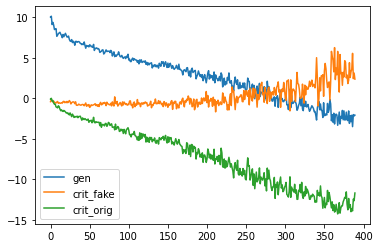

d loss fake  4.495450973510742
d loss real  -12.5791654586792
[Epoch 1/100] [Batch 51/345] [D loss: -4.041857, acc:   0%] [G loss: -3.169661] [c1: -4.677676, c2: -4.792103, o: -12.168862, f: -4.873173] time: 0:15:58.842588
d loss fake  4.749730110168457
d loss real  -13.589580535888672
[Epoch 1/100] [Batch 52/345] [D loss: -4.419925, acc:   1%] [G loss: -3.039121] [c1: -4.511024, c2: -4.529626, o: -12.766582, f: -4.548732] time: 0:16:01.121010
d loss fake  3.8797476291656494
d loss real  -12.534078598022461
[Epoch 1/100] [Batch 53/345] [D loss: -4.327165, acc:   0%] [G loss: -2.645997] [c1: -3.897092, c2: -4.193337, o: -11.922068, f: -4.014372] time: 0:16:03.391387
d loss fake  5.153992176055908
d loss real  -12.876504898071289
[Epoch 1/100] [Batch 54/345] [D loss: -3.861256, acc:   0%] [G loss: -3.584719] [c1: -5.165986, c2: -5.199492, o: -12.255754, f: -5.221165] time: 0:16:05.671564
d loss fake  3.876987934112549
d loss real  -13.999385833740234
[Epoch 1/100] [Batch 55/345] [D loss:

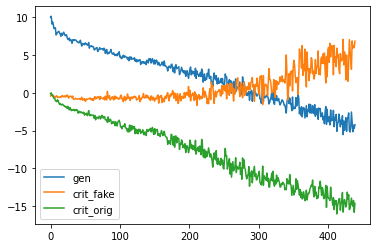

d loss fake  5.239781856536865
d loss real  -14.8341064453125
[Epoch 1/100] [Batch 101/345] [D loss: -4.797162, acc:   0%] [G loss: -4.510394] [c1: -5.444037, c2: -6.136325, o: -14.088350, f: -5.586562] time: 0:17:54.437276
d loss fake  8.208086967468262
d loss real  -15.940324783325195
[Epoch 1/100] [Batch 102/345] [D loss: -3.866119, acc:   0%] [G loss: -5.721475] [c1: -7.977089, c2: -7.812306, o: -14.748495, f: -7.928204] time: 0:17:56.719279
d loss fake  6.877973556518555
d loss real  -15.079636573791504
[Epoch 1/100] [Batch 103/345] [D loss: -4.100832, acc:   0%] [G loss: -5.223815] [c1: -6.592683, c2: -6.591739, o: -14.408910, f: -6.623155] time: 0:17:58.991350
d loss fake  5.69744873046875
d loss real  -15.100846290588379
[Epoch 1/100] [Batch 104/345] [D loss: -4.701699, acc:   0%] [G loss: -5.033922] [c1: -5.273375, c2: -5.690155, o: -14.132854, f: -5.336358] time: 0:18:01.266798
d loss fake  3.9741244316101074
d loss real  -14.809846878051758
[Epoch 1/100] [Batch 105/345] [D l

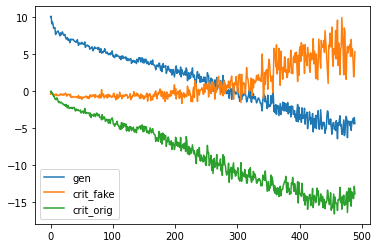

d loss fake  7.384777545928955
d loss real  -14.778392791748047
[Epoch 1/100] [Batch 151/345] [D loss: -3.696808, acc:   0%] [G loss: -5.123206] [c1: -7.478536, c2: -7.907319, o: -14.015309, f: -7.531613] time: 0:19:49.846990
d loss fake  7.482179641723633
d loss real  -14.634522438049316
[Epoch 1/100] [Batch 152/345] [D loss: -3.576171, acc:   0%] [G loss: -4.284048] [c1: -6.776750, c2: -6.670061, o: -13.695918, f: -6.556657] time: 0:19:52.132048
d loss fake  3.645275592803955
d loss real  -12.923593521118164
[Epoch 1/100] [Batch 153/345] [D loss: -4.639159, acc:   0%] [G loss: -2.696963] [c1: -3.681547, c2: -3.908380, o: -12.471443, f: -3.895366] time: 0:19:54.410795
d loss fake  6.757880210876465
d loss real  -14.743669509887695
[Epoch 1/100] [Batch 154/345] [D loss: -3.992895, acc:   0%] [G loss: -4.814949] [c1: -6.592014, c2: -6.601799, o: -13.983393, f: -6.597845] time: 0:19:56.703101
d loss fake  4.746091365814209
d loss real  -14.442854881286621
[Epoch 1/100] [Batch 155/345] [D

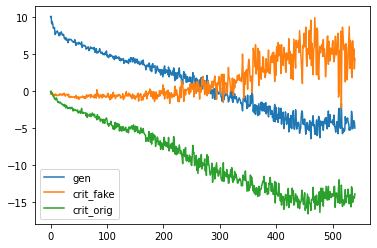

d loss fake  4.984148979187012
d loss real  -14.00020980834961
[Epoch 1/100] [Batch 201/345] [D loss: -4.508030, acc:   0%] [G loss: -3.727292] [c1: -4.647914, c2: -4.839732, o: -12.881365, f: -4.595880] time: 0:21:44.662823
d loss fake  -1.2181689739227295
d loss real  -12.601720809936523
[Epoch 1/100] [Batch 202/345] [D loss: -6.909945, acc:   0%] [G loss: -2.274903] [c1: 1.559033, c2: 0.298899, o: -12.146200, f: 1.523440] time: 0:21:46.948551
d loss fake  -0.03489494323730469
d loss real  -13.44699478149414
[Epoch 1/100] [Batch 203/345] [D loss: -6.740945, acc:   0%] [G loss: -2.581178] [c1: 0.559850, c2: -0.485432, o: -12.135284, f: 0.678997] time: 0:21:49.234047
d loss fake  5.441418170928955
d loss real  -14.482593536376953
[Epoch 1/100] [Batch 204/345] [D loss: -4.520588, acc:   0%] [G loss: -4.345449] [c1: -5.255746, c2: -5.176930, o: -12.510270, f: -5.191963] time: 0:21:51.510020
d loss fake  7.426243305206299
d loss real  -15.048049926757812
[Epoch 1/100] [Batch 205/345] [D l

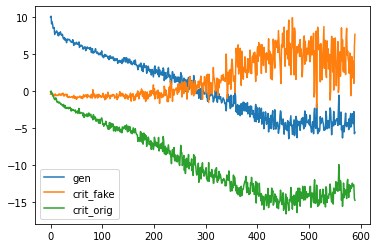

d loss fake  9.612040519714355
d loss real  -15.650920867919922
[Epoch 1/100] [Batch 251/345] [D loss: -3.019440, acc:   0%] [G loss: -7.246970] [c1: -9.472966, c2: -8.655370, o: -14.493399, f: -9.436487] time: 0:23:40.353000
d loss fake  4.678475379943848
d loss real  -15.646589279174805
[Epoch 1/100] [Batch 252/345] [D loss: -5.484057, acc:   0%] [G loss: -5.970558] [c1: -4.457047, c2: -4.439847, o: -14.355311, f: -4.489939] time: 0:23:42.636678
d loss fake  4.014774322509766
d loss real  -14.041654586791992
[Epoch 1/100] [Batch 253/345] [D loss: -5.013440, acc:   0%] [G loss: -5.496995] [c1: -4.176095, c2: -4.258946, o: -13.354759, f: -4.359476] time: 0:23:44.910176
d loss fake  4.255777359008789
d loss real  -14.481317520141602
[Epoch 1/100] [Batch 254/345] [D loss: -5.112770, acc:   0%] [G loss: -6.062113] [c1: -4.090509, c2: -4.007251, o: -13.459389, f: -4.199421] time: 0:23:47.189402
d loss fake  1.1053121089935303
d loss real  -12.906183242797852
[Epoch 1/100] [Batch 255/345] [

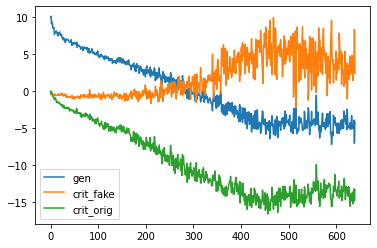

d loss fake  6.028003692626953
d loss real  -14.664230346679688
[Epoch 1/100] [Batch 301/345] [D loss: -4.318113, acc:   0%] [G loss: -3.567385] [c1: -4.920113, c2: -5.650098, o: -12.997897, f: -4.585289] time: 0:25:36.130445
d loss fake  6.0129289627075195
d loss real  -14.482306480407715
[Epoch 1/100] [Batch 302/345] [D loss: -4.234689, acc:   0%] [G loss: -5.723403] [c1: -6.162490, c2: -5.929537, o: -14.198140, f: -6.161661] time: 0:25:38.410563
d loss fake  4.575368881225586
d loss real  -14.765813827514648
[Epoch 1/100] [Batch 303/345] [D loss: -5.095222, acc:   0%] [G loss: -5.454551] [c1: -4.793165, c2: -4.914929, o: -13.665841, f: -4.964122] time: 0:25:40.683002
d loss fake  5.851154327392578
d loss real  -15.022456169128418
[Epoch 1/100] [Batch 304/345] [D loss: -4.585651, acc:   0%] [G loss: -5.106740] [c1: -5.768220, c2: -6.135320, o: -14.230919, f: -5.775187] time: 0:25:42.975384
d loss fake  6.083553791046143
d loss real  -13.381654739379883
[Epoch 1/100] [Batch 305/345] [

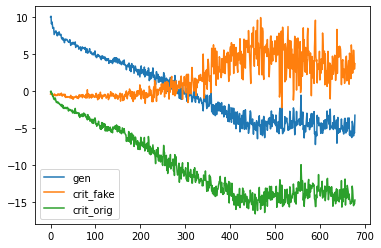

d loss fake  9.42922306060791
d loss real  -15.000961303710938
[Epoch 2/100] [Batch 1/345] [D loss: -2.785869, acc:   0%] [G loss: -5.328652] [c1: -9.035552, c2: -8.839914, o: -14.167133, f: -8.896847] time: 0:27:10.816111
d loss fake  2.156644105911255
d loss real  -13.839048385620117
[Epoch 2/100] [Batch 2/345] [D loss: -5.841202, acc:   1%] [G loss: -4.300523] [c1: -2.720188, c2: -3.431874, o: -13.096743, f: -2.993841] time: 0:27:13.108194
d loss fake  8.127521514892578
d loss real  -15.187929153442383
[Epoch 2/100] [Batch 3/345] [D loss: -3.530204, acc:   1%] [G loss: -6.100314] [c1: -8.398548, c2: -8.338449, o: -13.869828, f: -8.403089] time: 0:27:15.442474
d loss fake  5.406193733215332
d loss real  -14.44047737121582
[Epoch 2/100] [Batch 4/345] [D loss: -4.517142, acc:   0%] [G loss: -4.256022] [c1: -5.654958, c2: -6.091945, o: -12.928979, f: -5.696832] time: 0:27:17.766123
d loss fake  5.87615966796875
d loss real  -15.110515594482422
[Epoch 2/100] [Batch 5/345] [D loss: -4.617

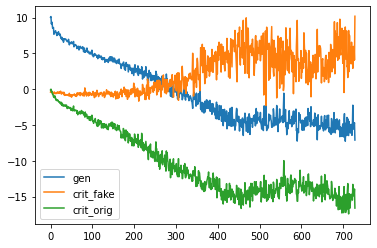

d loss fake  1.234428882598877
d loss real  -15.62440299987793
[Epoch 2/100] [Batch 51/345] [D loss: -7.194987, acc:   0%] [G loss: -3.845296] [c1: -1.682393, c2: -2.226890, o: -13.529900, f: -2.035933] time: 0:29:05.870436
d loss fake  4.825432777404785
d loss real  -16.45861053466797
[Epoch 2/100] [Batch 52/345] [D loss: -5.816589, acc:   0%] [G loss: -5.405584] [c1: -4.958158, c2: -5.768162, o: -14.602126, f: -4.983688] time: 0:29:08.146565
d loss fake  2.097818374633789
d loss real  -13.047082901000977
[Epoch 2/100] [Batch 53/345] [D loss: -5.474632, acc:   0%] [G loss: -4.164740] [c1: -1.928871, c2: -2.702970, o: -12.254445, f: -1.877461] time: 0:29:10.433167
d loss fake  6.839535713195801
d loss real  -16.596830368041992
[Epoch 2/100] [Batch 54/345] [D loss: -4.878647, acc:   0%] [G loss: -5.938040] [c1: -6.870537, c2: -7.003681, o: -14.608260, f: -6.819010] time: 0:29:12.709650
d loss fake  6.469420433044434
d loss real  -16.2458438873291
[Epoch 2/100] [Batch 55/345] [D loss: -4

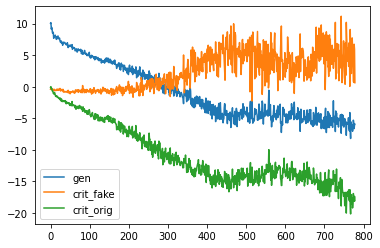

d loss fake  5.690992832183838
d loss real  -16.3360595703125
[Epoch 2/100] [Batch 101/345] [D loss: -5.322533, acc:   0%] [G loss: -4.767734] [c1: -5.296664, c2: -5.751129, o: -13.330105, f: -4.950401] time: 0:31:01.587238
d loss fake  5.152246475219727
d loss real  -17.444204330444336
[Epoch 2/100] [Batch 102/345] [D loss: -6.145979, acc:   0%] [G loss: -6.094084] [c1: -5.015913, c2: -5.271799, o: -15.120925, f: -4.951135] time: 0:31:03.868407
d loss fake  8.134794235229492
d loss real  -17.631988525390625
[Epoch 2/100] [Batch 103/345] [D loss: -4.748597, acc:   0%] [G loss: -5.587664] [c1: -7.053564, c2: -6.879756, o: -14.923822, f: -6.597132] time: 0:31:06.135926
d loss fake  1.6454167366027832
d loss real  -17.889842987060547
[Epoch 2/100] [Batch 104/345] [D loss: -8.122213, acc:   0%] [G loss: -6.331409] [c1: -0.550367, c2: -1.710049, o: -16.649534, f: -0.093495] time: 0:31:08.421769
d loss fake  5.84779691696167
d loss real  -17.523874282836914
[Epoch 2/100] [Batch 105/345] [D l

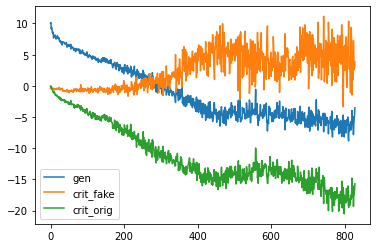

d loss fake  5.059685230255127
d loss real  -19.022836685180664
[Epoch 2/100] [Batch 151/345] [D loss: -6.981576, acc:   0%] [G loss: -6.419072] [c1: -4.640728, c2: -5.064926, o: -16.829271, f: -4.449969] time: 0:32:57.183511
d loss fake  0.46767479181289673
d loss real  -18.692020416259766
[Epoch 2/100] [Batch 152/345] [D loss: -9.112173, acc:   0%] [G loss: -5.410223] [c1: 0.151460, c2: -0.149215, o: -16.753218, f: 0.238180] time: 0:32:59.468730
d loss fake  5.384760856628418
d loss real  -17.99612045288086
[Epoch 2/100] [Batch 153/345] [D loss: -6.305680, acc:   0%] [G loss: -6.372312] [c1: -5.418035, c2: -5.832471, o: -15.797791, f: -5.498015] time: 0:33:01.742081
d loss fake  2.1464152336120605
d loss real  -16.121429443359375
[Epoch 2/100] [Batch 154/345] [D loss: -6.987507, acc:   0%] [G loss: -4.179904] [c1: -2.496500, c2: -2.666648, o: -13.847898, f: -2.751184] time: 0:33:04.024123
d loss fake  4.725039005279541
d loss real  -20.117624282836914
[Epoch 2/100] [Batch 155/345] [D

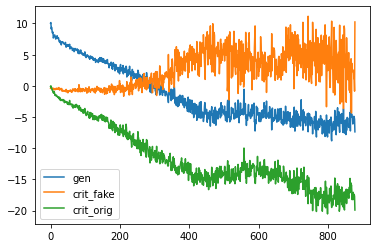

d loss fake  2.0044360160827637
d loss real  -17.938255310058594
[Epoch 2/100] [Batch 201/345] [D loss: -7.966910, acc:   0%] [G loss: -4.377674] [c1: -2.136704, c2: -1.866249, o: -15.369825, f: -2.152771] time: 0:34:51.591522
d loss fake  3.8191936016082764
d loss real  -16.423723220825195
[Epoch 2/100] [Batch 202/345] [D loss: -6.302265, acc:   0%] [G loss: -5.758772] [c1: -3.949396, c2: -3.941574, o: -14.559097, f: -4.051696] time: 0:34:53.875543
d loss fake  0.5892516374588013
d loss real  -17.624881744384766
[Epoch 2/100] [Batch 203/345] [D loss: -8.517815, acc:   0%] [G loss: -6.248486] [c1: 0.828748, c2: 0.326525, o: -15.755907, f: 1.231486] time: 0:34:56.148182
d loss fake  3.5160369873046875
d loss real  -19.363330841064453
[Epoch 2/100] [Batch 204/345] [D loss: -7.923647, acc:   0%] [G loss: -4.863992] [c1: -3.301847, c2: -4.618898, o: -16.285694, f: -3.370917] time: 0:34:58.427480
d loss fake  6.181468963623047
d loss real  -19.398902893066406
[Epoch 2/100] [Batch 205/345] [

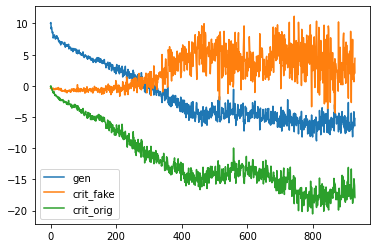

d loss fake  4.034428119659424
d loss real  -17.014781951904297
[Epoch 2/100] [Batch 251/345] [D loss: -6.490177, acc:   0%] [G loss: -5.636525] [c1: -4.536840, c2: -5.601501, o: -15.133034, f: -4.882671] time: 0:36:47.284768
d loss fake  7.384557723999023
d loss real  -16.949148178100586
[Epoch 2/100] [Batch 252/345] [D loss: -4.782295, acc:   0%] [G loss: -6.861225] [c1: -6.854491, c2: -5.852894, o: -15.052540, f: -6.741785] time: 0:36:49.573034
d loss fake  6.728598594665527
d loss real  -19.61850357055664
[Epoch 2/100] [Batch 253/345] [D loss: -6.444952, acc:   0%] [G loss: -7.288813] [c1: -5.377700, c2: -5.724905, o: -17.382042, f: -5.012419] time: 0:36:51.846160
d loss fake  4.713630676269531
d loss real  -18.658416748046875
[Epoch 2/100] [Batch 254/345] [D loss: -6.972393, acc:   0%] [G loss: -6.871559] [c1: -4.104085, c2: -4.717685, o: -17.015303, f: -4.230484] time: 0:36:54.117502
d loss fake  4.085938453674316
d loss real  -18.321104049682617
[Epoch 2/100] [Batch 255/345] [D 

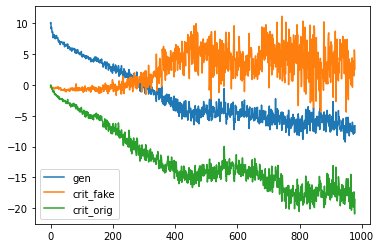

d loss fake  3.036449909210205
d loss real  -19.195528030395508
[Epoch 2/100] [Batch 301/345] [D loss: -8.079539, acc:   0%] [G loss: -6.268164] [c1: -2.730063, c2: -2.655886, o: -15.851452, f: -2.846773] time: 0:38:42.522840
d loss fake  6.479608535766602
d loss real  -19.05540657043457
[Epoch 2/100] [Batch 302/345] [D loss: -6.287899, acc:   0%] [G loss: -7.578357] [c1: -5.833143, c2: -5.469664, o: -16.819784, f: -5.722613] time: 0:38:44.804762
d loss fake  4.505552291870117
d loss real  -22.614643096923828
[Epoch 2/100] [Batch 303/345] [D loss: -9.054545, acc:   0%] [G loss: -7.271015] [c1: -4.010056, c2: -6.000965, o: -18.373783, f: -3.807042] time: 0:38:47.079218
d loss fake  3.077582359313965
d loss real  -18.800048828125
[Epoch 2/100] [Batch 304/345] [D loss: -7.861233, acc:   0%] [G loss: -6.655188] [c1: -2.964043, c2: -4.009388, o: -16.875477, f: -3.003759] time: 0:38:49.364460
d loss fake  -0.3480405807495117
d loss real  -18.653249740600586
[Epoch 2/100] [Batch 305/345] [D l

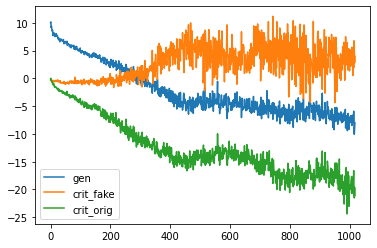

d loss fake  3.395256519317627
d loss real  -20.335166931152344
[Epoch 3/100] [Batch 1/345] [D loss: -8.469955, acc:   0%] [G loss: -6.856495] [c1: -2.842791, c2: -7.164699, o: -17.162117, f: -2.589803] time: 0:40:17.402996
d loss fake  3.1186344623565674
d loss real  -20.993135452270508
[Epoch 3/100] [Batch 2/345] [D loss: -8.937250, acc:   0%] [G loss: -8.143531] [c1: -3.379850, c2: -3.767772, o: -18.138279, f: -3.483875] time: 0:40:19.711098
d loss fake  11.241307258605957
d loss real  -20.875530242919922
[Epoch 3/100] [Batch 3/345] [D loss: -4.817111, acc:   0%] [G loss: -8.953559] [c1: -10.394316, c2: -9.222328, o: -18.365667, f: -10.079177] time: 0:40:22.074171
d loss fake  4.079623222351074
d loss real  -21.013134002685547
[Epoch 3/100] [Batch 4/345] [D loss: -8.466755, acc:   0%] [G loss: -8.134375] [c1: -3.658717, c2: -4.139262, o: -18.830477, f: -3.833697] time: 0:40:24.408387
d loss fake  5.329326629638672
d loss real  -21.861339569091797
[Epoch 3/100] [Batch 5/345] [D loss:

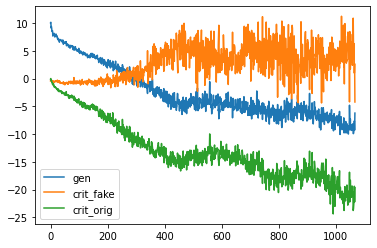

d loss fake  3.105973482131958
d loss real  -22.908119201660156
[Epoch 3/100] [Batch 51/345] [D loss: -9.901073, acc:   0%] [G loss: -7.907765] [c1: -3.304295, c2: -3.909930, o: -17.556255, f: -3.074448] time: 0:42:12.099239
d loss fake  9.06242847442627
d loss real  -23.071365356445312
[Epoch 3/100] [Batch 52/345] [D loss: -7.004468, acc:   0%] [G loss: -9.558592] [c1: -8.430998, c2: -8.361683, o: -18.794531, f: -8.093230] time: 0:42:14.377654
d loss fake  -0.2233962118625641
d loss real  -20.238815307617188
[Epoch 3/100] [Batch 53/345] [D loss: -10.231106, acc:   0%] [G loss: -7.148270] [c1: 1.193744, c2: 1.341208, o: -17.179161, f: 1.107859] time: 0:42:16.649801
d loss fake  5.286892890930176
d loss real  -22.539220809936523
[Epoch 3/100] [Batch 54/345] [D loss: -8.626164, acc:   0%] [G loss: -8.613888] [c1: -4.695793, c2: -5.802499, o: -18.251091, f: -4.571807] time: 0:42:18.934165
d loss fake  10.373895645141602
d loss real  -25.238239288330078
[Epoch 3/100] [Batch 55/345] [D loss

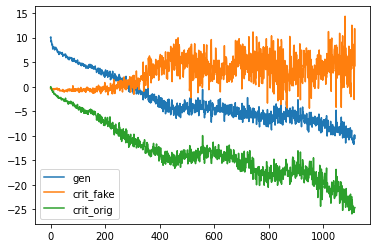

d loss fake  9.530502319335938
d loss real  -27.398643493652344
[Epoch 3/100] [Batch 101/345] [D loss: -8.934071, acc:   0%] [G loss: -12.209022] [c1: -8.534212, c2: -8.738091, o: -23.431511, f: -8.125237] time: 0:44:07.797619
d loss fake  4.521967887878418
d loss real  -24.287425994873047
[Epoch 3/100] [Batch 102/345] [D loss: -9.882729, acc:   0%] [G loss: -9.682346] [c1: -5.153277, c2: -4.439081, o: -20.520370, f: -5.547791] time: 0:44:10.078430
d loss fake  7.286177635192871
d loss real  -25.423479080200195
[Epoch 3/100] [Batch 103/345] [D loss: -9.068651, acc:   0%] [G loss: -11.573822] [c1: -7.393298, c2: -5.692646, o: -21.267776, f: -7.661998] time: 0:44:12.353823
d loss fake  -2.591085433959961
d loss real  -24.191940307617188
[Epoch 3/100] [Batch 104/345] [D loss: -13.391513, acc:   0%] [G loss: -8.921516] [c1: 4.158453, c2: 1.208962, o: -20.428659, f: 3.830441] time: 0:44:14.638219
d loss fake  3.2271437644958496
d loss real  -24.146081924438477
[Epoch 3/100] [Batch 105/345] 

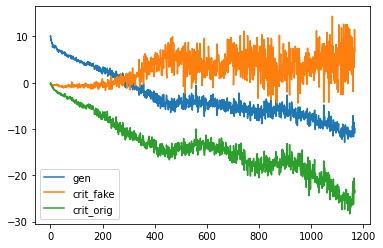

d loss fake  8.724325180053711
d loss real  -25.141231536865234
[Epoch 3/100] [Batch 151/345] [D loss: -8.208453, acc:   0%] [G loss: -11.456561] [c1: -8.822384, c2: -8.916612, o: -21.587917, f: -8.969909] time: 0:46:03.473841
d loss fake  7.965139389038086
d loss real  -22.166141510009766
[Epoch 3/100] [Batch 152/345] [D loss: -7.100501, acc:   0%] [G loss: -9.002550] [c1: -7.773747, c2: -7.881073, o: -19.390751, f: -7.767201] time: 0:46:05.761528
d loss fake  6.3083977699279785
d loss real  -23.333415985107422
[Epoch 3/100] [Batch 153/345] [D loss: -8.512509, acc:   0%] [G loss: -10.228077] [c1: -6.557336, c2: -6.949486, o: -21.151243, f: -6.839045] time: 0:46:08.046019
d loss fake  -4.9382405281066895
d loss real  -22.191696166992188
[Epoch 3/100] [Batch 154/345] [D loss: -13.564968, acc:   0%] [G loss: -6.749493] [c1: 7.260123, c2: 3.152907, o: -19.695810, f: 7.708323] time: 0:46:10.333279
d loss fake  10.101283073425293
d loss real  -24.6441650390625
[Epoch 3/100] [Batch 155/345] 

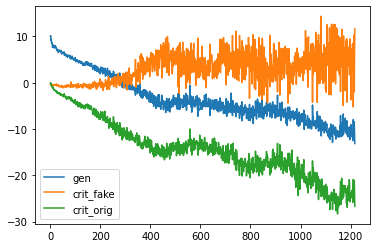

d loss fake  7.794960021972656
d loss real  -26.48762321472168
[Epoch 3/100] [Batch 201/345] [D loss: -9.346332, acc:   0%] [G loss: -13.172467] [c1: -7.500311, c2: -6.877228, o: -23.274067, f: -7.620373] time: 0:47:58.066409
d loss fake  2.6794605255126953
d loss real  -25.007946014404297
[Epoch 3/100] [Batch 202/345] [D loss: -11.164243, acc:   0%] [G loss: -11.725875] [c1: -2.925320, c2: -2.822774, o: -21.670122, f: -3.558817] time: 0:48:00.343897
d loss fake  2.6462953090667725
d loss real  -22.84888458251953
[Epoch 3/100] [Batch 203/345] [D loss: -10.101295, acc:   0%] [G loss: -9.862969] [c1: -3.604910, c2: -5.113708, o: -20.147488, f: -4.239612] time: 0:48:02.612256
d loss fake  1.365312933921814
d loss real  -22.50830841064453
[Epoch 3/100] [Batch 204/345] [D loss: -10.571498, acc:   0%] [G loss: -9.527576] [c1: -1.438701, c2: -3.366125, o: -20.874626, f: -1.784787] time: 0:48:04.898524
d loss fake  2.7968337535858154
d loss real  -23.13665008544922
[Epoch 3/100] [Batch 205/345

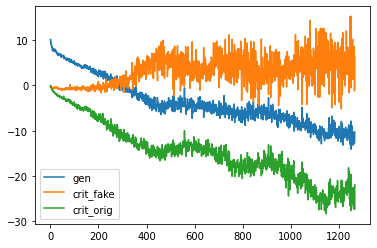

d loss fake  0.6186398267745972
d loss real  -19.441375732421875
[Epoch 3/100] [Batch 251/345] [D loss: -9.411368, acc:   0%] [G loss: -8.690366] [c1: -1.104170, c2: 0.861843, o: -18.006962, f: -1.556661] time: 0:49:53.728242
d loss fake  5.426116943359375
d loss real  -24.384449005126953
[Epoch 3/100] [Batch 252/345] [D loss: -9.479166, acc:   0%] [G loss: -11.819870] [c1: -2.494359, c2: -3.750047, o: -20.971027, f: -1.517174] time: 0:49:56.014177
d loss fake  -2.2505409717559814
d loss real  -24.34417724609375
[Epoch 3/100] [Batch 253/345] [D loss: -13.297359, acc:   0%] [G loss: -11.319365] [c1: 6.092272, c2: 5.618388, o: -21.355770, f: 7.332467] time: 0:49:58.290377
d loss fake  8.86257266998291
d loss real  -27.598373413085938
[Epoch 3/100] [Batch 254/345] [D loss: -9.367900, acc:   0%] [G loss: -12.456656] [c1: -7.947661, c2: -8.685287, o: -22.486702, f: -7.948734] time: 0:50:00.575379
d loss fake  3.7938897609710693
d loss real  -22.90740966796875
[Epoch 3/100] [Batch 255/345] [

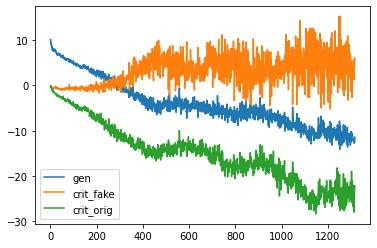

d loss fake  6.0321149826049805
d loss real  -25.56304168701172
[Epoch 3/100] [Batch 301/345] [D loss: -9.765463, acc:   0%] [G loss: -11.845556] [c1: -5.696058, c2: -3.908290, o: -22.178341, f: -6.025339] time: 0:51:49.394631
d loss fake  6.083498954772949
d loss real  -23.300878524780273
[Epoch 3/100] [Batch 302/345] [D loss: -8.608690, acc:   0%] [G loss: -13.124326] [c1: -4.744710, c2: -3.286766, o: -21.713558, f: -4.588276] time: 0:51:51.672624
d loss fake  1.2003268003463745
d loss real  -26.17478370666504
[Epoch 3/100] [Batch 303/345] [D loss: -12.487228, acc:   0%] [G loss: -12.400393] [c1: -0.314855, c2: -2.551046, o: -22.599491, f: -0.899895] time: 0:51:53.952367
d loss fake  3.2295637130737305
d loss real  -25.08791160583496
[Epoch 3/100] [Batch 304/345] [D loss: -10.929174, acc:   1%] [G loss: -13.349750] [c1: -0.594890, c2: -1.112921, o: -22.571865, f: -0.198051] time: 0:51:56.236108
d loss fake  3.5837044715881348
d loss real  -24.051204681396484
[Epoch 3/100] [Batch 305/

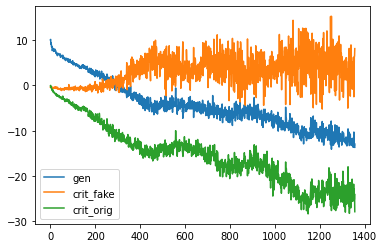

d loss fake  5.024544715881348
d loss real  -24.463253021240234
[Epoch 4/100] [Batch 1/345] [D loss: -9.719354, acc:   0%] [G loss: -12.637927] [c1: -5.067422, c2: -5.626719, o: -21.972172, f: -5.476658] time: 0:53:24.371757
d loss fake  3.953150749206543
d loss real  -25.040035247802734
[Epoch 4/100] [Batch 2/345] [D loss: -10.543442, acc:   0%] [G loss: -11.812760] [c1: -3.266332, c2: -8.091896, o: -22.910908, f: -3.750283] time: 0:53:26.667874
d loss fake  12.014854431152344
d loss real  -26.931364059448242
[Epoch 4/100] [Batch 3/345] [D loss: -7.458255, acc:   0%] [G loss: -12.524113] [c1: -11.718513, c2: -11.691236, o: -23.672512, f: -11.288081] time: 0:53:29.025132
d loss fake  7.458009243011475
d loss real  -25.857585906982422
[Epoch 4/100] [Batch 4/345] [D loss: -9.199788, acc:   0%] [G loss: -13.474166] [c1: -7.787376, c2: -4.635407, o: -22.893509, f: -7.996885] time: 0:53:31.361566
d loss fake  8.821207046508789
d loss real  -25.244380950927734
[Epoch 4/100] [Batch 5/345] [D 

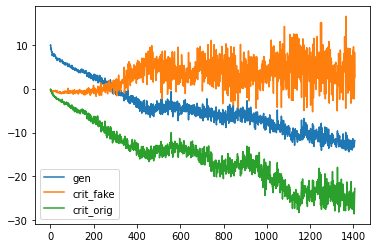

d loss fake  2.0958330631256104
d loss real  -25.967960357666016
[Epoch 4/100] [Batch 51/345] [D loss: -11.936064, acc:   0%] [G loss: -12.476098] [c1: -1.001693, c2: 2.129168, o: -22.992710, f: -0.978780] time: 0:55:19.237655
d loss fake  7.3787713050842285
d loss real  -27.8211669921875
[Epoch 4/100] [Batch 52/345] [D loss: -10.221198, acc:   0%] [G loss: -13.618260] [c1: -5.391997, c2: -4.297128, o: -23.926424, f: -5.193769] time: 0:55:21.505996
d loss fake  -0.062271952629089355
d loss real  -26.64521026611328
[Epoch 4/100] [Batch 53/345] [D loss: -13.353741, acc:   0%] [G loss: -13.269686] [c1: 1.292987, c2: 0.692494, o: -24.215834, f: 1.154963] time: 0:55:23.782036
d loss fake  4.778966903686523
d loss real  -27.10640525817871
[Epoch 4/100] [Batch 54/345] [D loss: -11.163719, acc:   0%] [G loss: -13.861295] [c1: -2.827402, c2: -5.923035, o: -24.029900, f: -2.243691] time: 0:55:26.053018
d loss fake  -2.934885025024414
d loss real  -26.376623153686523
[Epoch 4/100] [Batch 55/345] 

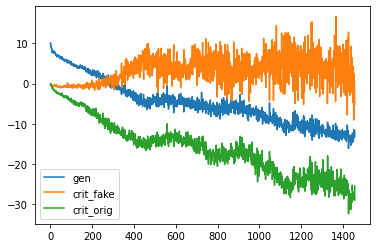

d loss fake  -2.0869851112365723
d loss real  -27.353069305419922
[Epoch 4/100] [Batch 101/345] [D loss: -14.720027, acc:   0%] [G loss: -12.472374] [c1: 4.895430, c2: 2.844303, o: -22.040318, f: 4.985847] time: 0:57:14.759303
d loss fake  -6.3802900314331055
d loss real  -28.5623779296875
[Epoch 4/100] [Batch 102/345] [D loss: -17.471334, acc:   0%] [G loss: -10.800362] [c1: 11.336514, c2: 8.820685, o: -22.936413, f: 12.750908] time: 0:57:17.035575
d loss fake  6.638689041137695
d loss real  -28.910053253173828
[Epoch 4/100] [Batch 103/345] [D loss: -11.135682, acc:   0%] [G loss: -14.127954] [c1: -5.819148, c2: -3.361366, o: -22.204332, f: -5.750717] time: 0:57:19.309258
d loss fake  1.4788297414779663
d loss real  -28.432695388793945
[Epoch 4/100] [Batch 104/345] [D loss: -13.476933, acc:   0%] [G loss: -13.789970] [c1: 0.367046, c2: 1.315736, o: -23.016205, f: 0.052103] time: 0:57:21.583905
d loss fake  6.093400001525879
d loss real  -30.246511459350586
[Epoch 4/100] [Batch 105/345

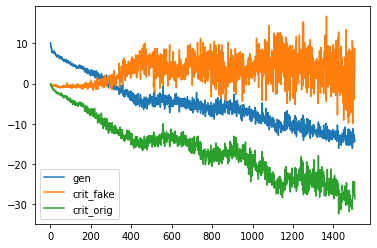

d loss fake  -1.299955129623413
d loss real  -24.722393035888672
[Epoch 4/100] [Batch 151/345] [D loss: -13.011174, acc:   0%] [G loss: -12.649940] [c1: 0.919911, c2: 2.228445, o: -22.932274, f: -0.128728] time: 0:59:10.438961
d loss fake  0.9859744310379028
d loss real  -27.13595199584961
[Epoch 4/100] [Batch 152/345] [D loss: -13.074989, acc:   0%] [G loss: -14.739912] [c1: 2.437705, c2: 4.481756, o: -22.879173, f: 3.189679] time: 0:59:12.713602
d loss fake  0.6697952747344971
d loss real  -27.823421478271484
[Epoch 4/100] [Batch 153/345] [D loss: -13.576813, acc:   0%] [G loss: -13.644232] [c1: 3.219578, c2: 2.439930, o: -23.909996, f: 3.924287] time: 0:59:14.989513
d loss fake  1.6455881595611572
d loss real  -24.191421508789062
[Epoch 4/100] [Batch 154/345] [D loss: -11.272917, acc:   0%] [G loss: -12.132750] [c1: -2.797894, c2: -2.882686, o: -22.075848, f: -3.445886] time: 0:59:17.279642
d loss fake  -10.274112701416016
d loss real  -26.260942459106445
[Epoch 4/100] [Batch 155/34

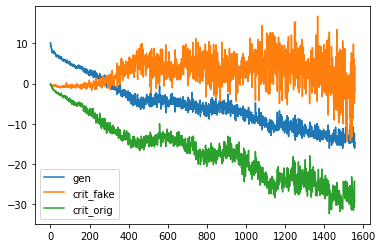

d loss fake  -0.17568755149841309
d loss real  -28.232868194580078
[Epoch 4/100] [Batch 201/345] [D loss: -14.204278, acc:   0%] [G loss: -14.317509] [c1: 1.557501, c2: 1.566188, o: -25.804893, f: 1.091935] time: 1:01:04.925419
d loss fake  -1.6556178331375122
d loss real  -29.35580825805664
[Epoch 4/100] [Batch 202/345] [D loss: -15.505713, acc:   0%] [G loss: -13.824178] [c1: 4.934836, c2: 1.705501, o: -24.959143, f: 5.170058] time: 1:01:07.209131
d loss fake  7.953393936157227
d loss real  -29.623661041259766
[Epoch 4/100] [Batch 203/345] [D loss: -10.835134, acc:   0%] [G loss: -15.066637] [c1: -6.489459, c2: -4.105832, o: -24.068455, f: -6.364983] time: 1:01:09.482138
d loss fake  5.16463565826416
d loss real  -31.401092529296875
[Epoch 4/100] [Batch 204/345] [D loss: -13.118228, acc:   0%] [G loss: -16.450788] [c1: -1.681396, c2: -3.021536, o: -26.438808, f: -1.143786] time: 1:01:11.765065
d loss fake  -2.342963695526123
d loss real  -28.721803665161133
[Epoch 4/100] [Batch 205/3

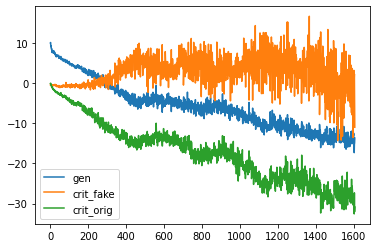

d loss fake  0.3854890465736389
d loss real  -29.271371841430664
[Epoch 4/100] [Batch 251/345] [D loss: -14.442941, acc:   0%] [G loss: -14.294143] [c1: 0.344591, c2: 1.429353, o: -22.506069, f: 0.083895] time: 1:03:00.579671
d loss fake  -2.390946388244629
d loss real  -28.6290340423584
[Epoch 4/100] [Batch 252/345] [D loss: -15.509990, acc:   0%] [G loss: -14.532225] [c1: 6.147331, c2: 5.287789, o: -23.306232, f: 6.321267] time: 1:03:02.861575
d loss fake  -4.472516059875488
d loss real  -28.943967819213867
[Epoch 4/100] [Batch 253/345] [D loss: -16.708242, acc:   0%] [G loss: -14.980230] [c1: 9.382222, c2: 11.436149, o: -22.736372, f: 9.418030] time: 1:03:05.141834
d loss fake  -4.86538553237915
d loss real  -30.394010543823242
[Epoch 4/100] [Batch 254/345] [D loss: -17.629698, acc:   0%] [G loss: -15.418291] [c1: 8.503016, c2: 10.294998, o: -25.507229, f: 8.392518] time: 1:03:07.422238
d loss fake  -4.0578718185424805
d loss real  -31.087995529174805
[Epoch 4/100] [Batch 255/345] [

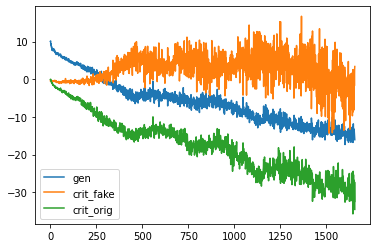

d loss fake  -3.358121395111084
d loss real  -26.1375732421875
[Epoch 4/100] [Batch 301/345] [D loss: -14.747847, acc:   1%] [G loss: -16.825499] [c1: 7.503535, c2: 9.255249, o: -24.710356, f: 8.134185] time: 1:04:55.980014
d loss fake  -7.0427703857421875
d loss real  -32.19358825683594
[Epoch 4/100] [Batch 302/345] [D loss: -19.618179, acc:   0%] [G loss: -14.843038] [c1: 8.843000, c2: 5.642732, o: -27.289055, f: 7.056246] time: 1:04:58.258272
d loss fake  -9.11536693572998
d loss real  -27.851837158203125
[Epoch 4/100] [Batch 303/345] [D loss: -18.483602, acc:   1%] [G loss: -13.966012] [c1: 14.531089, c2: 10.573053, o: -25.379168, f: 15.629120] time: 1:05:00.525842
d loss fake  -3.0442957878112793
d loss real  -31.346261978149414
[Epoch 4/100] [Batch 304/345] [D loss: -17.195279, acc:   0%] [G loss: -15.021133] [c1: 4.389586, c2: 4.337296, o: -25.277994, f: 3.306265] time: 1:05:02.820125
d loss fake  -6.816110610961914
d loss real  -31.603591918945312
[Epoch 4/100] [Batch 305/345] 

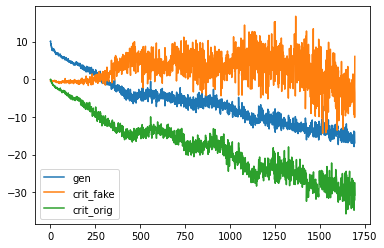

d loss fake  10.407243728637695
d loss real  -32.533203125
[Epoch 5/100] [Batch 1/345] [D loss: -11.062980, acc:   0%] [G loss: -17.600594] [c1: -9.598364, c2: -8.680368, o: -29.544287, f: -9.864887] time: 1:06:31.001420
d loss fake  3.8376781940460205
d loss real  -30.49481964111328
[Epoch 5/100] [Batch 2/345] [D loss: -13.328571, acc:   0%] [G loss: -16.216694] [c1: -3.948106, c2: -6.707343, o: -28.712660, f: -5.567908] time: 1:06:33.330793
d loss fake  3.9440388679504395
d loss real  -30.538639068603516
[Epoch 5/100] [Batch 3/345] [D loss: -13.297300, acc:   0%] [G loss: -17.398963] [c1: -3.259984, c2: -9.782679, o: -28.512474, f: -3.881125] time: 1:06:35.664867
d loss fake  7.217145919799805
d loss real  -30.201351165771484
[Epoch 5/100] [Batch 4/345] [D loss: -11.492103, acc:   0%] [G loss: -17.979751] [c1: -7.097600, c2: -7.971415, o: -27.898481, f: -7.868361] time: 1:06:37.983092
d loss fake  -12.04466438293457
d loss real  -30.12810707092285
[Epoch 5/100] [Batch 5/345] [D loss:

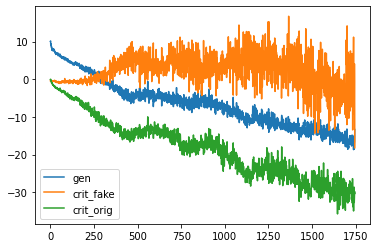

d loss fake  -2.401176929473877
d loss real  -31.03940200805664
[Epoch 5/100] [Batch 51/345] [D loss: -16.720289, acc:   0%] [G loss: -16.213765] [c1: 6.767903, c2: 3.995809, o: -23.598503, f: 7.202037] time: 1:08:25.677060
d loss fake  -6.308043956756592
d loss real  -31.38060760498047
[Epoch 5/100] [Batch 52/345] [D loss: -18.844326, acc:   0%] [G loss: -15.509956] [c1: 10.031633, c2: 8.485528, o: -25.369137, f: 10.699332] time: 1:08:27.949178
d loss fake  -4.18756628036499
d loss real  -33.70669937133789
[Epoch 5/100] [Batch 53/345] [D loss: -18.947133, acc:   0%] [G loss: -16.412846] [c1: 9.818773, c2: 14.465562, o: -25.044016, f: 10.491159] time: 1:08:30.227006
d loss fake  0.969577968120575
d loss real  -30.211101531982422
[Epoch 5/100] [Batch 54/345] [D loss: -14.620762, acc:   0%] [G loss: -15.139693] [c1: -3.143938, c2: -1.589063, o: -26.459660, f: -4.530545] time: 1:08:32.509471
d loss fake  -15.123908042907715
d loss real  -31.971939086914062
[Epoch 5/100] [Batch 55/345] [D 

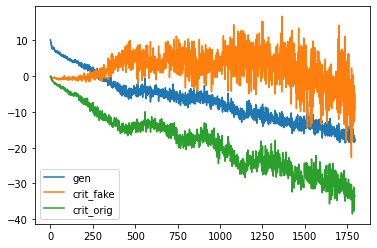

d loss fake  -13.053182601928711
d loss real  -32.877349853515625
[Epoch 5/100] [Batch 101/345] [D loss: -22.965266, acc:   0%] [G loss: -14.986656] [c1: 22.005867, c2: 22.676479, o: -25.735563, f: 23.287668] time: 1:10:21.363515
d loss fake  5.738614082336426
d loss real  -37.122737884521484
[Epoch 5/100] [Batch 102/345] [D loss: -15.692062, acc:   0%] [G loss: -17.968768] [c1: -1.407252, c2: 2.830911, o: -25.562258, f: -1.586947] time: 1:10:23.643712
d loss fake  -16.681495666503906
d loss real  -34.23175048828125
[Epoch 5/100] [Batch 103/345] [D loss: -25.456623, acc:   0%] [G loss: -13.729549] [c1: 24.860950, c2: 24.305145, o: -28.820763, f: 25.179083] time: 1:10:25.917990
d loss fake  -4.4930644035339355
d loss real  -33.32275390625
[Epoch 5/100] [Batch 104/345] [D loss: -18.907909, acc:   0%] [G loss: -15.189591] [c1: 13.750525, c2: 12.734865, o: -24.208948, f: 15.058156] time: 1:10:28.203825
d loss fake  -13.960481643676758
d loss real  -36.507835388183594
[Epoch 5/100] [Batch 1

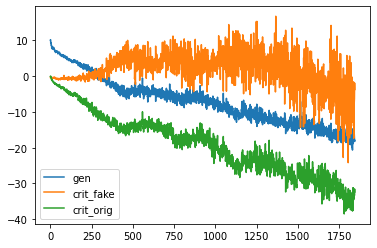

d loss fake  -3.9596376419067383
d loss real  -33.12835693359375
[Epoch 5/100] [Batch 151/345] [D loss: -18.543997, acc:   1%] [G loss: -17.877059] [c1: 4.135926, c2: 2.329029, o: -29.627460, f: 2.774631] time: 1:12:16.943197
d loss fake  -21.363903045654297
d loss real  -32.39757537841797
[Epoch 5/100] [Batch 152/345] [D loss: -26.880739, acc:   0%] [G loss: -13.427941] [c1: 46.845737, c2: 42.873528, o: -28.253258, f: 59.325825] time: 1:12:19.222870
d loss fake  -15.244783401489258
d loss real  -32.404693603515625
[Epoch 5/100] [Batch 153/345] [D loss: -23.824739, acc:   0%] [G loss: -14.389250] [c1: 25.774578, c2: 23.579578, o: -23.879938, f: 27.968956] time: 1:12:21.492912
d loss fake  -1.1657280921936035
d loss real  -32.668514251708984
[Epoch 5/100] [Batch 154/345] [D loss: -16.917121, acc:   1%] [G loss: -16.800248] [c1: 3.360519, c2: 2.259209, o: -23.034906, f: 2.579931] time: 1:12:23.775083
d loss fake  -2.1685588359832764
d loss real  -31.669797897338867
[Epoch 5/100] [Batch 1

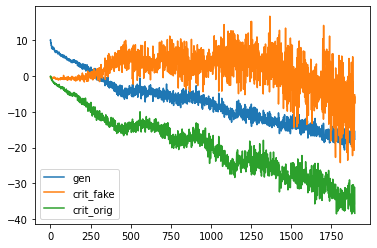

d loss fake  -9.748882293701172
d loss real  -34.89118576049805
[Epoch 5/100] [Batch 201/345] [D loss: -22.320034, acc:   0%] [G loss: -17.358501] [c1: 16.635643, c2: 12.368900, o: -27.546215, f: 17.019344] time: 1:14:11.691971
d loss fake  -7.084512710571289
d loss real  -36.56224060058594
[Epoch 5/100] [Batch 202/345] [D loss: -21.823377, acc:   0%] [G loss: -18.749323] [c1: 8.890444, c2: 5.149375, o: -29.610664, f: 7.654329] time: 1:14:13.973723
d loss fake  -0.8574258089065552
d loss real  -35.701141357421875
[Epoch 5/100] [Batch 203/345] [D loss: -18.279284, acc:   0%] [G loss: -19.813562] [c1: 2.785594, c2: 0.359515, o: -29.744650, f: 1.823581] time: 1:14:16.251182
d loss fake  2.5483860969543457
d loss real  -37.730072021484375
[Epoch 5/100] [Batch 204/345] [D loss: -17.590843, acc:   0%] [G loss: -19.357274] [c1: -1.034133, c2: 0.940204, o: -31.449772, f: -2.085734] time: 1:14:18.539275
d loss fake  -11.096113204956055
d loss real  -34.020599365234375
[Epoch 5/100] [Batch 205/3

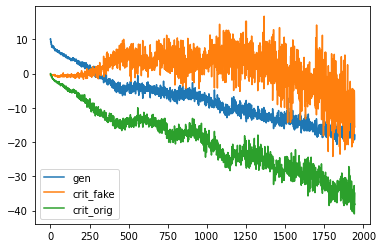

d loss fake  -11.043777465820312
d loss real  -34.47753143310547
[Epoch 5/100] [Batch 251/345] [D loss: -22.760654, acc:   0%] [G loss: -19.202268] [c1: 15.400126, c2: 13.666604, o: -27.001278, f: 15.357306] time: 1:16:07.375289
d loss fake  -6.801036357879639
d loss real  -31.373653411865234
[Epoch 5/100] [Batch 252/345] [D loss: -19.087345, acc:   3%] [G loss: -18.347700] [c1: 7.251335, c2: 9.883180, o: -26.370350, f: 6.042142] time: 1:16:09.665022
d loss fake  -12.458663940429688
d loss real  -36.99388885498047
[Epoch 5/100] [Batch 253/345] [D loss: -24.726276, acc:   3%] [G loss: -19.335005] [c1: 18.450329, c2: 18.758999, o: -29.097958, f: 18.545275] time: 1:16:11.939886
d loss fake  -20.30392074584961
d loss real  -42.54383850097656
[Epoch 5/100] [Batch 254/345] [D loss: -31.423880, acc:   0%] [G loss: -18.153048] [c1: 39.431896, c2: 37.950539, o: -27.396444, f: 44.072227] time: 1:16:14.227036
d loss fake  -17.662065505981445
d loss real  -40.752872467041016
[Epoch 5/100] [Batch 2

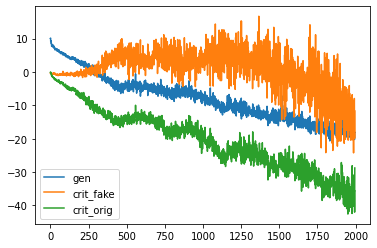

d loss fake  -10.706446647644043
d loss real  -43.75776672363281
[Epoch 5/100] [Batch 301/345] [D loss: -27.232107, acc:   0%] [G loss: -19.461156] [c1: 15.646717, c2: 14.134206, o: -28.825077, f: 15.004198] time: 1:18:03.459356
d loss fake  -12.213544845581055
d loss real  -41.666603088378906
[Epoch 5/100] [Batch 302/345] [D loss: -26.940074, acc:   0%] [G loss: -19.983462] [c1: 18.180321, c2: 20.728085, o: -29.845039, f: 17.686779] time: 1:18:05.753921
d loss fake  -8.238006591796875
d loss real  -35.397708892822266
[Epoch 5/100] [Batch 303/345] [D loss: -21.817858, acc:   3%] [G loss: -18.865459] [c1: 12.153808, c2: 16.402290, o: -27.383938, f: 11.755062] time: 1:18:08.035786
d loss fake  -12.474396705627441
d loss real  -31.884592056274414
[Epoch 5/100] [Batch 304/345] [D loss: -22.179494, acc:   3%] [G loss: -21.040177] [c1: 12.330287, c2: 14.293652, o: -28.506498, f: 10.624195] time: 1:18:10.327574
d loss fake  -19.313039779663086
d loss real  -35.31657409667969
[Epoch 5/100] [Ba

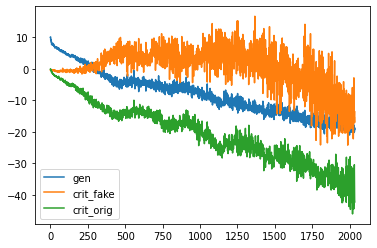

d loss fake  -10.550837516784668
d loss real  -41.77804183959961
[Epoch 6/100] [Batch 1/345] [D loss: -26.164440, acc:   0%] [G loss: -19.068955] [c1: 12.267664, c2: 14.094298, o: -29.488556, f: 11.683512] time: 1:19:40.884160
d loss fake  -10.14709186553955
d loss real  -43.28155517578125
[Epoch 6/100] [Batch 2/345] [D loss: -26.714324, acc:   0%] [G loss: -20.245138] [c1: 15.965235, c2: 17.478212, o: -31.863794, f: 16.053938] time: 1:19:43.198642
d loss fake  -4.808147430419922
d loss real  -40.09910583496094
[Epoch 6/100] [Batch 3/345] [D loss: -22.453627, acc:   0%] [G loss: -21.273028] [c1: 4.250115, c2: 5.627506, o: -32.392509, f: 2.021226] time: 1:19:45.517071
d loss fake  -17.392559051513672
d loss real  -41.17223358154297
[Epoch 6/100] [Batch 4/345] [D loss: -29.282396, acc:   0%] [G loss: -18.500446] [c1: 28.946756, c2: 12.463011, o: -32.491508, f: 31.600288] time: 1:19:47.908261
d loss fake  9.46218490600586
d loss real  -39.39277267456055
[Epoch 6/100] [Batch 5/345] [D loss

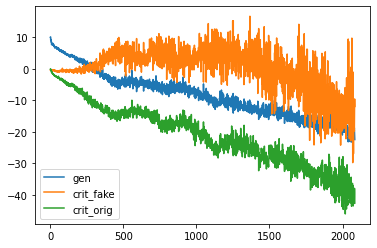

d loss fake  -17.660104751586914
d loss real  -41.16503143310547
[Epoch 6/100] [Batch 51/345] [D loss: -29.412568, acc:   0%] [G loss: -21.126124] [c1: 25.146553, c2: 32.516739, o: -31.565374, f: 25.793167] time: 1:21:36.149193
d loss fake  -25.750946044921875
d loss real  -41.7879524230957
[Epoch 6/100] [Batch 52/345] [D loss: -33.769449, acc:   0%] [G loss: -20.012330] [c1: 40.676575, c2: 37.781662, o: -33.053505, f: 43.792534] time: 1:21:38.425793
d loss fake  -27.808216094970703
d loss real  -43.18750762939453
[Epoch 6/100] [Batch 53/345] [D loss: -35.497862, acc:   0%] [G loss: -18.713190] [c1: 42.751503, c2: 30.874382, o: -28.375826, f: 45.026031] time: 1:21:40.704084
d loss fake  -23.677915573120117
d loss real  -40.98632049560547
[Epoch 6/100] [Batch 54/345] [D loss: -32.332118, acc:   0%] [G loss: -17.343407] [c1: 32.895676, c2: 28.250526, o: -23.498814, f: 32.680473] time: 1:21:42.977182
d loss fake  -20.907421112060547
d loss real  -45.277366638183594
[Epoch 6/100] [Batch 55

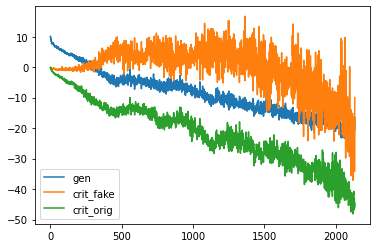

d loss fake  -29.166717529296875
d loss real  -44.779747009277344
[Epoch 6/100] [Batch 101/345] [D loss: -36.973232, acc:   0%] [G loss: -17.809956] [c1: 50.969254, c2: 53.260590, o: -29.200550, f: 57.597992] time: 1:23:32.262909
d loss fake  -27.829612731933594
d loss real  -47.130714416503906
[Epoch 6/100] [Batch 102/345] [D loss: -37.480164, acc:   0%] [G loss: -19.825826] [c1: 37.200966, c2: 40.988831, o: -25.580624, f: 36.368950] time: 1:23:34.554966
d loss fake  -26.322662353515625
d loss real  -45.249267578125
[Epoch 6/100] [Batch 103/345] [D loss: -35.785965, acc:   0%] [G loss: -20.892969] [c1: 34.739491, c2: 40.994411, o: -28.130295, f: 33.381863] time: 1:23:36.833511
d loss fake  -23.00152587890625
d loss real  -50.05291748046875
[Epoch 6/100] [Batch 104/345] [D loss: -36.527222, acc:   0%] [G loss: -19.789718] [c1: 38.261997, c2: 37.345306, o: -27.868618, f: 41.007675] time: 1:23:39.116503
d loss fake  -21.80661392211914
d loss real  -45.36224365234375
[Epoch 6/100] [Batch 

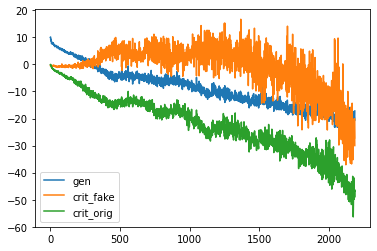

d loss fake  -31.465728759765625
d loss real  -47.252166748046875
[Epoch 6/100] [Batch 151/345] [D loss: -39.358948, acc:   0%] [G loss: -15.364612] [c1: 58.888275, c2: 58.622257, o: -21.885357, f: 68.967484] time: 1:25:28.398952
d loss fake  -23.44851303100586
d loss real  -44.985076904296875
[Epoch 6/100] [Batch 152/345] [D loss: -34.216795, acc:   0%] [G loss: -18.407861] [c1: 23.794056, c2: 24.857248, o: -21.571676, f: 21.460299] time: 1:25:30.685901
d loss fake  -17.386157989501953
d loss real  -48.05972671508789
[Epoch 6/100] [Batch 153/345] [D loss: -32.722942, acc:   0%] [G loss: -16.934914] [c1: 21.202518, c2: 26.764462, o: -24.126884, f: 20.071035] time: 1:25:32.956548
d loss fake  -22.0131893157959
d loss real  -45.060123443603516
[Epoch 6/100] [Batch 154/345] [D loss: -33.536656, acc:   0%] [G loss: -20.339112] [c1: 25.117702, c2: 23.371811, o: -26.797052, f: 23.651054] time: 1:25:35.238773
d loss fake  -26.031295776367188
d loss real  -52.9389533996582
[Epoch 6/100] [Batch

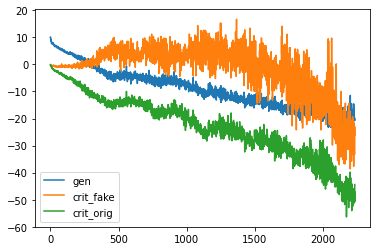

d loss fake  -29.056446075439453
d loss real  -44.966209411621094
[Epoch 6/100] [Batch 201/345] [D loss: -37.011328, acc:   3%] [G loss: -19.032159] [c1: 36.080559, c2: 29.420387, o: -28.303612, f: 36.264114] time: 1:27:23.271562
d loss fake  -37.110260009765625
d loss real  -53.093406677246094
[Epoch 6/100] [Batch 202/345] [D loss: -45.101833, acc:   0%] [G loss: -15.357544] [c1: 68.619904, c2: 59.390137, o: -25.813482, f: 81.676224] time: 1:27:25.569354
d loss fake  -28.901866912841797
d loss real  -46.3799934387207
[Epoch 6/100] [Batch 203/345] [D loss: -37.640930, acc:   0%] [G loss: -17.465326] [c1: 26.943594, c2: 24.527588, o: -20.418316, f: 24.037441] time: 1:27:27.857198
d loss fake  -17.512815475463867
d loss real  -45.81285858154297
[Epoch 6/100] [Batch 204/345] [D loss: -31.662837, acc:   1%] [G loss: -19.088884] [c1: 18.490803, c2: 27.544804, o: -21.776148, f: 17.752768] time: 1:27:30.157396
d loss fake  -33.42472839355469
d loss real  -51.655521392822266
[Epoch 6/100] [Bat

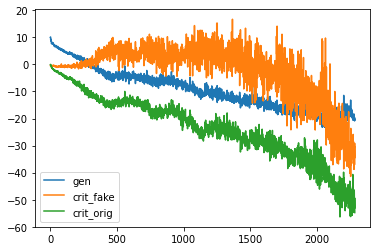

d loss fake  -36.93271255493164
d loss real  -56.58717346191406
[Epoch 6/100] [Batch 251/345] [D loss: -46.759943, acc:   0%] [G loss: -17.522317] [c1: 56.486580, c2: 52.696625, o: -21.959572, f: 60.524326] time: 1:29:19.361081
d loss fake  -38.28265380859375
d loss real  -54.53268814086914
[Epoch 6/100] [Batch 252/345] [D loss: -46.407671, acc:   0%] [G loss: -17.741933] [c1: 53.074066, c2: 55.802605, o: -19.002823, f: 54.808609] time: 1:29:21.651769
d loss fake  -33.857444763183594
d loss real  -54.65097427368164
[Epoch 6/100] [Batch 253/345] [D loss: -44.254210, acc:   0%] [G loss: -17.691026] [c1: 42.244278, c2: 47.479172, o: -19.282600, f: 41.449272] time: 1:29:23.931267
d loss fake  -38.68004608154297
d loss real  -56.331695556640625
[Epoch 6/100] [Batch 254/345] [D loss: -47.505871, acc:   0%] [G loss: -18.005385] [c1: 55.072311, c2: 53.058430, o: -22.040850, f: 56.228935] time: 1:29:26.217558
d loss fake  -38.904624938964844
d loss real  -56.895572662353516
[Epoch 6/100] [Batch

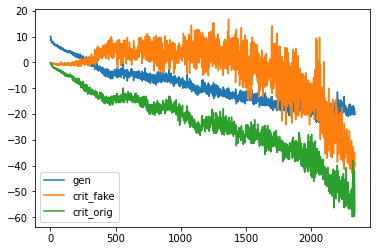

d loss fake  -37.45396423339844
d loss real  -55.005821228027344
[Epoch 6/100] [Batch 301/345] [D loss: -46.229893, acc:   1%] [G loss: -20.463255] [c1: 41.238457, c2: 44.745529, o: -19.870140, f: 39.563984] time: 1:31:15.180841
d loss fake  -38.88434600830078
d loss real  -59.88234329223633
[Epoch 6/100] [Batch 302/345] [D loss: -49.383345, acc:   0%] [G loss: -19.231403] [c1: 47.480328, c2: 43.972984, o: -22.497250, f: 46.595367] time: 1:31:17.485452
d loss fake  -39.67601776123047
d loss real  -54.73128890991211
[Epoch 6/100] [Batch 303/345] [D loss: -47.203653, acc:   0%] [G loss: -19.795500] [c1: 44.776100, c2: 38.877365, o: -21.263462, f: 42.453194] time: 1:31:19.775617
d loss fake  -39.85173034667969
d loss real  -59.69505310058594
[Epoch 6/100] [Batch 304/345] [D loss: -49.773392, acc:   0%] [G loss: -20.726110] [c1: 50.912933, c2: 54.411491, o: -23.045839, f: 51.479713] time: 1:31:22.058384
d loss fake  -36.33171081542969
d loss real  -47.0129280090332
[Epoch 6/100] [Batch 305

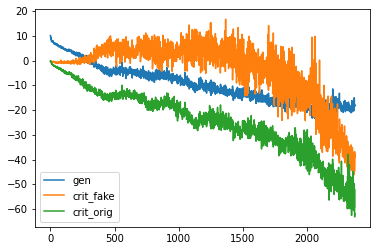

d loss fake  -41.704200744628906
d loss real  -60.10975646972656
[Epoch 7/100] [Batch 1/345] [D loss: -50.906979, acc:   0%] [G loss: -21.556075] [c1: 42.710373, c2: 41.126041, o: -21.591537, f: 39.324234] time: 1:32:50.995025
d loss fake  -25.410165786743164
d loss real  -54.97772216796875
[Epoch 7/100] [Batch 2/345] [D loss: -40.193944, acc:   0%] [G loss: -23.170157] [c1: 19.516960, c2: 20.804016, o: -23.262796, f: 16.276907] time: 1:32:53.331489
d loss fake  -33.96098709106445
d loss real  -59.55451583862305
[Epoch 7/100] [Batch 3/345] [D loss: -46.757751, acc:   0%] [G loss: -23.117217] [c1: 39.806168, c2: 37.604408, o: -27.735716, f: 40.570602] time: 1:32:55.676424
d loss fake  -45.62269592285156
d loss real  -62.137603759765625
[Epoch 7/100] [Batch 4/345] [D loss: -53.880150, acc:   0%] [G loss: -18.562727] [c1: 63.308449, c2: 61.165791, o: -23.073704, f: 68.837570] time: 1:32:58.007147
d loss fake  -36.84772491455078
d loss real  -55.375179290771484
[Epoch 7/100] [Batch 5/345] 

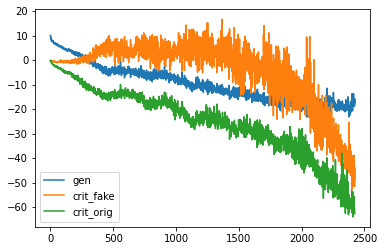

d loss fake  -47.37977981567383
d loss real  -61.42742919921875
[Epoch 7/100] [Batch 51/345] [D loss: -54.403605, acc:   0%] [G loss: -17.387783] [c1: 49.674305, c2: 49.578171, o: -15.264612, f: 47.527550] time: 1:34:46.195828
d loss fake  -47.69816589355469
d loss real  -62.187435150146484
[Epoch 7/100] [Batch 52/345] [D loss: -54.942801, acc:   0%] [G loss: -17.556325] [c1: 52.311440, c2: 52.498604, o: -15.836184, f: 51.836021] time: 1:34:48.484833
d loss fake  -45.12070846557617
d loss real  -60.71580123901367
[Epoch 7/100] [Batch 53/345] [D loss: -52.918255, acc:   0%] [G loss: -19.884851] [c1: 47.241135, c2: 45.979355, o: -16.440973, f: 46.022446] time: 1:34:50.763533
d loss fake  -47.76305389404297
d loss real  -59.361637115478516
[Epoch 7/100] [Batch 54/345] [D loss: -53.562346, acc:   0%] [G loss: -19.204714] [c1: 57.401031, c2: 56.234066, o: -18.403461, f: 58.073711] time: 1:34:53.060980
d loss fake  -45.79585266113281
d loss real  -60.854820251464844
[Epoch 7/100] [Batch 55/3

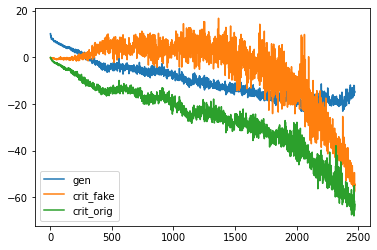

d loss fake  -56.7656364440918
d loss real  -67.06576538085938
[Epoch 7/100] [Batch 101/345] [D loss: -61.915701, acc:   0%] [G loss: -12.270099] [c1: 69.321487, c2: 63.306744, o: 1.266291, f: 74.539261] time: 1:36:42.336110
d loss fake  -52.96297073364258
d loss real  -62.74771499633789
[Epoch 7/100] [Batch 102/345] [D loss: -57.855343, acc:   0%] [G loss: -14.317545] [c1: 54.575058, c2: 55.229431, o: 3.435796, f: 51.723621] time: 1:36:44.622802
d loss fake  -53.511268615722656
d loss real  -64.2166519165039
[Epoch 7/100] [Batch 103/345] [D loss: -58.863960, acc:   0%] [G loss: -15.075760] [c1: 54.640942, c2: 58.657936, o: -0.039987, f: 51.521442] time: 1:36:46.897406
d loss fake  -54.8298225402832
d loss real  -67.02242279052734
[Epoch 7/100] [Batch 104/345] [D loss: -60.926123, acc:   0%] [G loss: -13.908377] [c1: 64.573280, c2: 62.234638, o: -1.201961, f: 67.265144] time: 1:36:49.187720
d loss fake  -58.68895721435547
d loss real  -68.8841323852539
[Epoch 7/100] [Batch 105/345] [D 

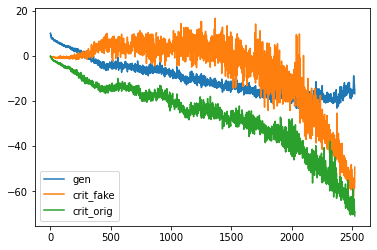

d loss fake  -55.84529113769531
d loss real  -63.2268180847168
[Epoch 7/100] [Batch 151/345] [D loss: -59.536055, acc:   0%] [G loss: -17.006515] [c1: 54.669617, c2: 54.505692, o: -11.255116, f: 53.251732] time: 1:38:38.262248
d loss fake  -56.22081756591797
d loss real  -63.1962776184082
[Epoch 7/100] [Batch 152/345] [D loss: -59.708548, acc:   0%] [G loss: -17.551885] [c1: 60.136154, c2: 60.009697, o: -11.148342, f: 59.965187] time: 1:38:40.556488
d loss fake  -57.12433624267578
d loss real  -66.46484375
[Epoch 7/100] [Batch 153/345] [D loss: -61.794590, acc:   0%] [G loss: -16.829336] [c1: 60.181580, c2: 66.480118, o: -9.478554, f: 59.775791] time: 1:38:42.836519
d loss fake  -56.11225891113281
d loss real  -67.87649536132812
[Epoch 7/100] [Batch 154/345] [D loss: -61.994377, acc:   0%] [G loss: -17.614550] [c1: 57.386436, c2: 59.490822, o: -7.165028, f: 57.945892] time: 1:38:45.131558
d loss fake  -56.93290710449219
d loss real  -67.67594909667969
[Epoch 7/100] [Batch 155/345] [D l

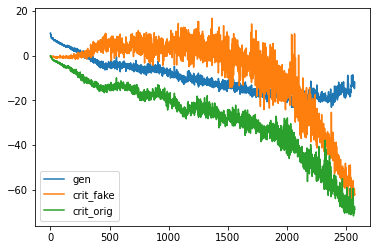

d loss fake  -63.567466735839844
d loss real  -71.75822448730469
[Epoch 7/100] [Batch 201/345] [D loss: -67.662846, acc:   0%] [G loss: -12.125327] [c1: 71.405159, c2: 73.786728, o: 3.514660, f: 75.070862] time: 1:40:33.264711
d loss fake  -65.58673095703125
d loss real  -71.604248046875
[Epoch 7/100] [Batch 202/345] [D loss: -68.595490, acc:   0%] [G loss: -9.591616] [c1: 78.422142, c2: 77.829193, o: 6.564841, f: 82.580444] time: 1:40:35.548614
d loss fake  -61.173316955566406
d loss real  -67.84272766113281
[Epoch 7/100] [Batch 203/345] [D loss: -64.508022, acc:   0%] [G loss: -12.761757] [c1: 56.365463, c2: 60.576294, o: 9.422116, f: 55.456329] time: 1:40:37.828530
d loss fake  -59.24309539794922
d loss real  -70.14827728271484
[Epoch 7/100] [Batch 204/345] [D loss: -64.695686, acc:   0%] [G loss: -11.629966] [c1: 53.368813, c2: 58.752712, o: 7.542441, f: 53.483887] time: 1:40:40.111281
d loss fake  -65.58941650390625
d loss real  -71.80331420898438
[Epoch 7/100] [Batch 205/345] [D 

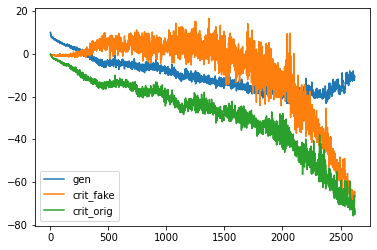

d loss fake  -67.26929473876953
d loss real  -69.84042358398438
[Epoch 7/100] [Batch 251/345] [D loss: -68.554859, acc:   0%] [G loss: -10.297755] [c1: 64.168472, c2: 61.852379, o: 9.925509, f: 62.290359] time: 1:42:29.003420
d loss fake  -65.00961303710938
d loss real  -71.81511688232422
[Epoch 7/100] [Batch 252/345] [D loss: -68.412365, acc:   0%] [G loss: -12.407516] [c1: 54.918007, c2: 58.640205, o: 12.515402, f: 54.630203] time: 1:42:31.295606
d loss fake  -66.44711303710938
d loss real  -71.5689697265625
[Epoch 7/100] [Batch 253/345] [D loss: -69.008041, acc:   0%] [G loss: -11.029126] [c1: 60.638863, c2: 60.923744, o: 5.473474, f: 58.806648] time: 1:42:33.575575
d loss fake  -63.59972381591797
d loss real  -73.68436431884766
[Epoch 7/100] [Batch 254/345] [D loss: -68.642044, acc:   0%] [G loss: -14.315959] [c1: 60.099136, c2: 65.897575, o: 9.933888, f: 61.825890] time: 1:42:35.869975
d loss fake  -64.29534912109375
d loss real  -72.6896743774414
[Epoch 7/100] [Batch 255/345] [D 

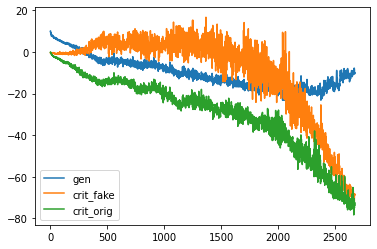

d loss fake  -71.15077209472656
d loss real  -77.57688903808594
[Epoch 7/100] [Batch 301/345] [D loss: -74.363831, acc:   0%] [G loss: -10.155373] [c1: 68.049698, c2: 66.329712, o: 17.652874, f: 70.534149] time: 1:44:24.895814
d loss fake  -68.77605438232422
d loss real  -73.0775146484375
[Epoch 7/100] [Batch 302/345] [D loss: -70.926785, acc:   1%] [G loss: -10.295119] [c1: 59.050667, c2: 57.106392, o: 16.467749, f: 57.859219] time: 1:44:27.180670
d loss fake  -67.24305725097656
d loss real  -74.18959045410156
[Epoch 7/100] [Batch 303/345] [D loss: -70.716324, acc:   0%] [G loss: -10.069188] [c1: 56.286724, c2: 55.722054, o: 15.910860, f: 56.264942] time: 1:44:29.462096
d loss fake  -70.05126953125
d loss real  -69.8541030883789
[Epoch 7/100] [Batch 304/345] [D loss: -69.952686, acc:   3%] [G loss: -8.694152] [c1: 67.813736, c2: 65.431267, o: 17.008467, f: 68.127563] time: 1:44:31.742272
d loss fake  -69.12307739257812
d loss real  -74.2175521850586
[Epoch 7/100] [Batch 305/345] [D lo

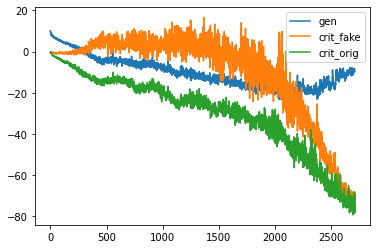

d loss fake  -67.70561218261719
d loss real  -77.19779205322266
[Epoch 8/100] [Batch 1/345] [D loss: -72.451702, acc:   0%] [G loss: -11.689198] [c1: 48.213585, c2: 47.615788, o: 11.845013, f: 47.639824] time: 1:46:00.879369
d loss fake  -69.56486511230469
d loss real  -75.49181365966797
[Epoch 8/100] [Batch 2/345] [D loss: -72.528339, acc:   0%] [G loss: -10.851537] [c1: 56.221489, c2: 56.630840, o: 14.773176, f: 55.752327] time: 1:46:03.236864
d loss fake  -71.3193130493164
d loss real  -75.33443450927734
[Epoch 8/100] [Batch 3/345] [D loss: -73.326874, acc:   0%] [G loss: -11.753709] [c1: 62.631973, c2: 65.773781, o: 10.968979, f: 61.685085] time: 1:46:05.567893
d loss fake  -70.92950439453125
d loss real  -74.61322021484375
[Epoch 8/100] [Batch 4/345] [D loss: -72.771362, acc:   0%] [G loss: -11.744912] [c1: 57.156754, c2: 56.319809, o: 12.126862, f: 54.559448] time: 1:46:07.912785
d loss fake  -70.36773681640625
d loss real  -77.58592224121094
[Epoch 8/100] [Batch 5/345] [D loss: 

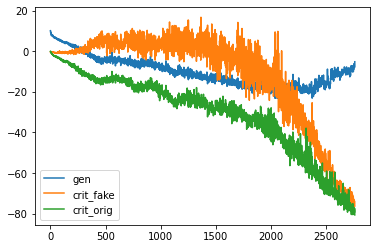

d loss fake  -76.05003356933594
d loss real  -80.73249816894531
[Epoch 8/100] [Batch 51/345] [D loss: -78.391266, acc:   0%] [G loss: -5.815923] [c1: 63.975788, c2: 66.414330, o: 21.956894, f: 64.151779] time: 1:47:55.925600
d loss fake  -73.57911682128906
d loss real  -78.13917541503906
[Epoch 8/100] [Batch 52/345] [D loss: -75.859146, acc:   0%] [G loss: -6.204338] [c1: 60.217834, c2: 61.223343, o: 21.072407, f: 60.058697] time: 1:47:58.210167
d loss fake  -75.49224853515625
d loss real  -79.88185119628906
[Epoch 8/100] [Batch 53/345] [D loss: -77.687050, acc:   0%] [G loss: -6.619701] [c1: 58.278133, c2: 61.758499, o: 23.479717, f: 56.881435] time: 1:48:00.493084
d loss fake  -76.06079864501953
d loss real  -79.26026153564453
[Epoch 8/100] [Batch 54/345] [D loss: -77.660530, acc:   0%] [G loss: -7.795401] [c1: 64.181755, c2: 65.728561, o: 20.468319, f: 63.754055] time: 1:48:02.770386
d loss fake  -76.14414978027344
d loss real  -79.25798034667969
[Epoch 8/100] [Batch 55/345] [D loss

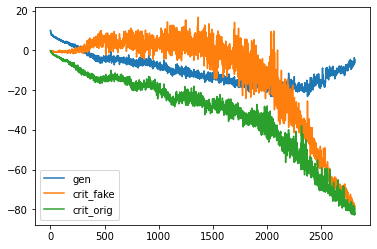

d loss fake  -75.58838653564453
d loss real  -80.29624938964844
[Epoch 8/100] [Batch 101/345] [D loss: -77.942318, acc:   0%] [G loss: -6.311153] [c1: 54.362022, c2: 57.566620, o: 25.722136, f: 52.938736] time: 1:49:51.954893
d loss fake  -78.89572143554688
d loss real  -83.24365234375
[Epoch 8/100] [Batch 102/345] [D loss: -81.069687, acc:   0%] [G loss: -4.803355] [c1: 81.881248, c2: 83.967316, o: 24.823196, f: 86.876175] time: 1:49:54.250819
d loss fake  -79.29287719726562
d loss real  -79.4515609741211
[Epoch 8/100] [Batch 103/345] [D loss: -79.372219, acc:   0%] [G loss: -6.760482] [c1: 66.503288, c2: 68.071053, o: 26.345257, f: 64.460548] time: 1:49:56.533370
d loss fake  -78.32032012939453
d loss real  -79.60208892822266
[Epoch 8/100] [Batch 104/345] [D loss: -78.961205, acc:   0%] [G loss: -5.160607] [c1: 78.412849, c2: 76.363632, o: 25.682732, f: 80.557137] time: 1:49:58.826493
d loss fake  -79.69989013671875
d loss real  -80.80955505371094
[Epoch 8/100] [Batch 105/345] [D los

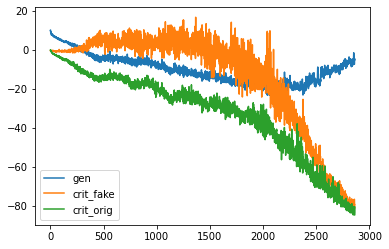

d loss fake  -77.87801361083984
d loss real  -83.34444427490234
[Epoch 8/100] [Batch 151/345] [D loss: -80.611229, acc:   0%] [G loss: -4.459304] [c1: 55.759987, c2: 54.809940, o: 26.946613, f: 55.509930] time: 1:51:48.179247
d loss fake  -77.38148498535156
d loss real  -81.94258117675781
[Epoch 8/100] [Batch 152/345] [D loss: -79.662033, acc:   0%] [G loss: -7.004783] [c1: 52.392853, c2: 54.102303, o: 23.407951, f: 50.734692] time: 1:51:50.458444
d loss fake  -79.64212036132812
d loss real  -82.95512390136719
[Epoch 8/100] [Batch 153/345] [D loss: -81.298622, acc:   0%] [G loss: -5.379103] [c1: 72.893204, c2: 73.492981, o: 19.370220, f: 75.747086] time: 1:51:52.731437
d loss fake  -79.6380615234375
d loss real  -84.03976440429688
[Epoch 8/100] [Batch 154/345] [D loss: -81.838913, acc:   0%] [G loss: -5.387690] [c1: 63.175240, c2: 62.835339, o: 23.149727, f: 63.795658] time: 1:51:55.018656
d loss fake  -80.48187255859375
d loss real  -83.02206420898438
[Epoch 8/100] [Batch 155/345] [D 

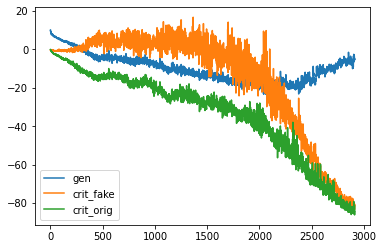

d loss fake  -79.58763885498047
d loss real  -83.05025482177734
[Epoch 8/100] [Batch 201/345] [D loss: -81.318947, acc:   0%] [G loss: -5.284901] [c1: 58.897282, c2: 61.969082, o: 26.491215, f: 58.329498] time: 1:53:43.061964
d loss fake  -81.14761352539062
d loss real  -84.84603881835938
[Epoch 8/100] [Batch 202/345] [D loss: -82.996826, acc:   0%] [G loss: -7.227557] [c1: 56.602356, c2: 54.903084, o: 23.246132, f: 55.988407] time: 1:53:45.356253
d loss fake  -81.04965209960938
d loss real  -86.25489807128906
[Epoch 8/100] [Batch 203/345] [D loss: -83.652275, acc:   0%] [G loss: -7.908128] [c1: 62.690025, c2: 63.429459, o: 21.946012, f: 64.007339] time: 1:53:47.643422
d loss fake  -82.00541687011719
d loss real  -83.40950012207031
[Epoch 8/100] [Batch 204/345] [D loss: -82.707458, acc:   0%] [G loss: -5.371492] [c1: 65.747307, c2: 67.184753, o: 20.949255, f: 65.502060] time: 1:53:49.934130
d loss fake  -81.44033813476562
d loss real  -83.74626159667969
[Epoch 8/100] [Batch 205/345] [D

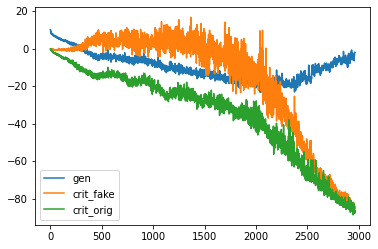

d loss fake  -85.0166015625
d loss real  -88.98188018798828
[Epoch 8/100] [Batch 251/345] [D loss: -86.999241, acc:   0%] [G loss: -4.087992] [c1: 65.675690, c2: 67.608147, o: 29.725328, f: 67.856628] time: 1:55:39.223553
d loss fake  -84.4545669555664
d loss real  -87.15725708007812
[Epoch 8/100] [Batch 252/345] [D loss: -85.805912, acc:   0%] [G loss: -2.149903] [c1: 65.369507, c2: 62.826115, o: 29.827847, f: 63.820770] time: 1:55:41.518920
d loss fake  -85.14832305908203
d loss real  -87.88067626953125
[Epoch 8/100] [Batch 253/345] [D loss: -86.514500, acc:   0%] [G loss: -1.998343] [c1: 67.009781, c2: 65.992958, o: 29.840019, f: 68.634346] time: 1:55:43.806488
d loss fake  -84.75201416015625
d loss real  -85.36750793457031
[Epoch 8/100] [Batch 254/345] [D loss: -85.059761, acc:   0%] [G loss: -4.066788] [c1: 66.130005, c2: 68.125572, o: 30.171337, f: 64.126984] time: 1:55:46.090547
d loss fake  -85.72218322753906
d loss real  -85.71578216552734
[Epoch 8/100] [Batch 255/345] [D loss

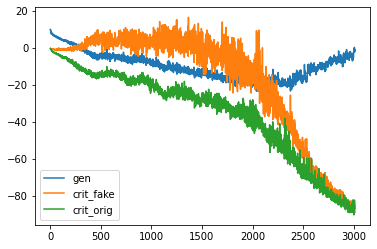

d loss fake  -85.92130279541016
d loss real  -83.49462890625
[Epoch 8/100] [Batch 301/345] [D loss: -84.707966, acc:   0%] [G loss: -2.655887] [c1: 61.497189, c2: 60.835487, o: 32.631329, f: 59.751564] time: 1:57:35.190147
d loss fake  -86.27983093261719
d loss real  -87.80226135253906
[Epoch 8/100] [Batch 302/345] [D loss: -87.041046, acc:   0%] [G loss: -2.452509] [c1: 69.077454, c2: 67.484253, o: 33.930870, f: 69.736778] time: 1:57:37.478711
d loss fake  -86.24066162109375
d loss real  -89.53612518310547
[Epoch 8/100] [Batch 303/345] [D loss: -87.888393, acc:   0%] [G loss: -2.538894] [c1: 64.151291, c2: 63.898491, o: 30.943480, f: 66.032242] time: 1:57:39.770096
d loss fake  -85.86967468261719
d loss real  -88.62741088867188
[Epoch 8/100] [Batch 304/345] [D loss: -87.248543, acc:   0%] [G loss: -1.986928] [c1: 63.785530, c2: 63.732140, o: 30.297295, f: 63.746628] time: 1:57:42.064985
d loss fake  -85.73140716552734
d loss real  -89.30317687988281
[Epoch 8/100] [Batch 305/345] [D lo

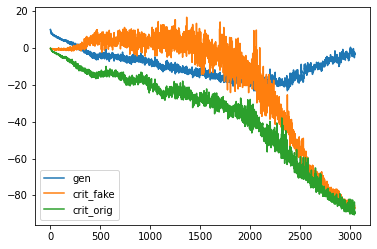

d loss fake  -87.37982177734375
d loss real  -90.36061096191406
[Epoch 9/100] [Batch 1/345] [D loss: -88.870216, acc:   0%] [G loss: -2.998446] [c1: 67.600365, c2: 67.579407, o: 25.283472, f: 67.109474] time: 1:59:12.534064
d loss fake  -87.1317138671875
d loss real  -89.48511505126953
[Epoch 9/100] [Batch 2/345] [D loss: -88.308414, acc:   0%] [G loss: -0.697451] [c1: 70.022964, c2: 70.006927, o: 27.807264, f: 69.809891] time: 1:59:14.879251
d loss fake  -88.12864685058594
d loss real  -89.57823181152344
[Epoch 9/100] [Batch 3/345] [D loss: -88.853439, acc:   0%] [G loss: -1.433609] [c1: 69.206528, c2: 67.501472, o: 29.166067, f: 67.252090] time: 1:59:17.252731
d loss fake  -85.822265625
d loss real  -89.27786254882812
[Epoch 9/100] [Batch 4/345] [D loss: -87.550064, acc:   0%] [G loss: -2.054648] [c1: 58.847401, c2: 58.944252, o: 27.502840, f: 58.707256] time: 1:59:19.618566
d loss fake  -87.02877807617188
d loss real  -88.58929443359375
[Epoch 9/100] [Batch 5/345] [D loss: -87.80903

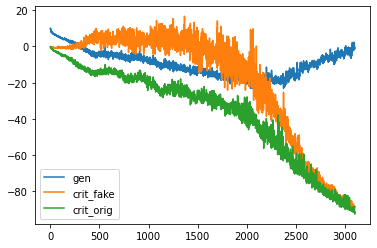

d loss fake  -89.0300064086914
d loss real  -92.2207260131836
[Epoch 9/100] [Batch 51/345] [D loss: -90.625366, acc:   0%] [G loss: -1.100353] [c1: 67.674400, c2: 66.965057, o: 26.180140, f: 66.768433] time: 2:01:07.718238
d loss fake  -89.14812469482422
d loss real  -91.16497802734375
[Epoch 9/100] [Batch 52/345] [D loss: -90.156551, acc:   0%] [G loss: 0.131694] [c1: 68.233192, c2: 66.574867, o: 26.472292, f: 67.950439] time: 2:01:10.000434
d loss fake  -89.20982360839844
d loss real  -92.04022216796875
[Epoch 9/100] [Batch 53/345] [D loss: -90.625023, acc:   0%] [G loss: 0.403310] [c1: 60.834660, c2: 59.934231, o: 25.022697, f: 60.352970] time: 2:01:12.276180
d loss fake  -88.17096710205078
d loss real  -91.56263732910156
[Epoch 9/100] [Batch 54/345] [D loss: -89.866802, acc:   0%] [G loss: -2.001482] [c1: 60.274303, c2: 61.456772, o: 22.794571, f: 59.126900] time: 2:01:14.560353
d loss fake  -87.02396392822266
d loss real  -90.24185180664062
[Epoch 9/100] [Batch 55/345] [D loss: -8

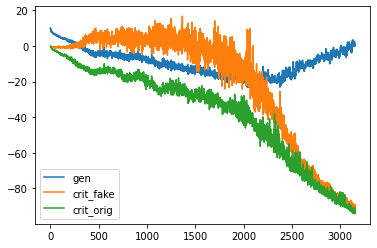

d loss fake  -90.3511962890625
d loss real  -92.76013946533203
[Epoch 9/100] [Batch 101/345] [D loss: -91.555668, acc:   0%] [G loss: -0.406145] [c1: 65.749298, c2: 67.820107, o: 31.195541, f: 64.689194] time: 2:03:04.029030
d loss fake  -89.89462280273438
d loss real  -90.59213256835938
[Epoch 9/100] [Batch 102/345] [D loss: -90.243378, acc:   0%] [G loss: -1.702867] [c1: 68.772247, c2: 68.476974, o: 26.426401, f: 65.826324] time: 2:03:06.322830
d loss fake  -91.9981689453125
d loss real  -93.21119689941406
[Epoch 9/100] [Batch 103/345] [D loss: -92.604683, acc:   0%] [G loss: 3.147949] [c1: 74.020370, c2: 69.861893, o: 28.829967, f: 76.236053] time: 2:03:08.604741
d loss fake  -90.51416015625
d loss real  -92.99508666992188
[Epoch 9/100] [Batch 104/345] [D loss: -91.754623, acc:   0%] [G loss: 1.877518] [c1: 68.174667, c2: 65.665421, o: 33.984608, f: 67.272430] time: 2:03:10.888677
d loss fake  -89.56024169921875
d loss real  -92.34364318847656
[Epoch 9/100] [Batch 105/345] [D loss: 

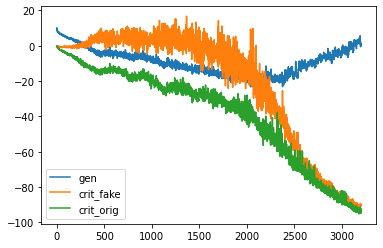

d loss fake  -92.49409484863281
d loss real  -94.78404235839844
[Epoch 9/100] [Batch 151/345] [D loss: -93.639069, acc:   0%] [G loss: 1.415039] [c1: 68.085243, c2: 69.100395, o: 28.437288, f: 68.113976] time: 2:04:59.986616
d loss fake  -91.56859588623047
d loss real  -93.9034652709961
[Epoch 9/100] [Batch 152/345] [D loss: -92.736031, acc:   0%] [G loss: 1.917804] [c1: 62.456688, c2: 63.738384, o: 32.164406, f: 63.703705] time: 2:05:02.273100
d loss fake  -90.87513732910156
d loss real  -93.33844757080078
[Epoch 9/100] [Batch 153/345] [D loss: -92.106792, acc:   0%] [G loss: 0.518962] [c1: 58.010616, c2: 60.335011, o: 28.539085, f: 55.743820] time: 2:05:04.553546
d loss fake  -89.94642639160156
d loss real  -94.36363220214844
[Epoch 9/100] [Batch 154/345] [D loss: -92.155029, acc:   0%] [G loss: 0.447927] [c1: 56.200806, c2: 57.809093, o: 30.655170, f: 57.818180] time: 2:05:06.844699
d loss fake  -91.73014831542969
d loss real  -94.66668701171875
[Epoch 9/100] [Batch 155/345] [D loss

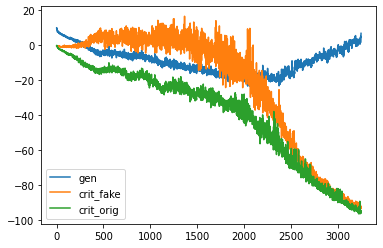

d loss fake  -93.59628295898438
d loss real  -96.02173614501953
[Epoch 9/100] [Batch 201/345] [D loss: -94.809010, acc:   0%] [G loss: 6.674699] [c1: 67.648224, c2: 66.728767, o: 35.854862, f: 68.006569] time: 2:06:54.929902
d loss fake  -93.7646484375
d loss real  -94.74530029296875
[Epoch 9/100] [Batch 202/345] [D loss: -94.254974, acc:   0%] [G loss: 4.699955] [c1: 65.666145, c2: 66.034683, o: 35.258171, f: 64.017761] time: 2:06:57.227981
d loss fake  -94.09506225585938
d loss real  -93.96994018554688
[Epoch 9/100] [Batch 203/345] [D loss: -94.032501, acc:   0%] [G loss: 5.727004] [c1: 67.548851, c2: 67.058258, o: 38.271492, f: 66.708160] time: 2:06:59.520590
d loss fake  -93.49470520019531
d loss real  -94.97647094726562
[Epoch 9/100] [Batch 204/345] [D loss: -94.235588, acc:   0%] [G loss: 4.631808] [c1: 67.758926, c2: 67.005508, o: 37.692680, f: 67.206444] time: 2:07:01.810131
d loss fake  -93.38660430908203
d loss real  -96.94261169433594
[Epoch 9/100] [Batch 205/345] [D loss: -

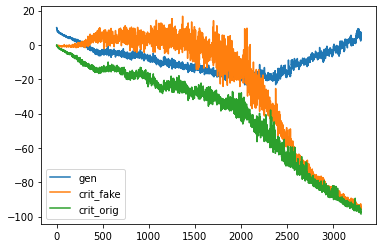

d loss fake  -94.76437377929688
d loss real  -95.27010345458984
[Epoch 9/100] [Batch 251/345] [D loss: -95.017239, acc:   0%] [G loss: 6.161806] [c1: 66.316002, c2: 65.792236, o: 35.832993, f: 63.955460] time: 2:08:50.477112
d loss fake  -94.46903991699219
d loss real  -97.60649108886719
[Epoch 9/100] [Batch 252/345] [D loss: -96.037766, acc:   0%] [G loss: 4.835150] [c1: 61.830341, c2: 62.379684, o: 37.911461, f: 62.993324] time: 2:08:52.755602
d loss fake  -94.59208679199219
d loss real  -95.37095642089844
[Epoch 9/100] [Batch 253/345] [D loss: -94.981522, acc:   0%] [G loss: 4.098646] [c1: 61.591393, c2: 61.711666, o: 35.958889, f: 59.561100] time: 2:08:55.042453
d loss fake  -96.29556274414062
d loss real  -96.89056396484375
[Epoch 9/100] [Batch 254/345] [D loss: -96.593063, acc:   0%] [G loss: 7.388936] [c1: 75.244461, c2: 74.353699, o: 36.159611, f: 76.800293] time: 2:08:57.332117
d loss fake  -94.70964813232422
d loss real  -95.98490905761719
[Epoch 9/100] [Batch 255/345] [D los

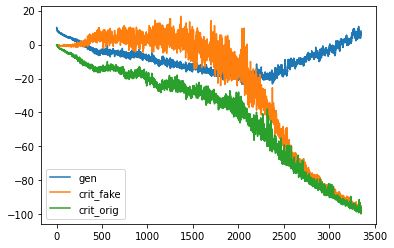

d loss fake  -96.32957458496094
d loss real  -98.61129760742188
[Epoch 9/100] [Batch 301/345] [D loss: -97.470436, acc:   0%] [G loss: 6.426810] [c1: 63.144428, c2: 64.163536, o: 43.856441, f: 62.926506] time: 2:10:46.233869
d loss fake  -96.230712890625
d loss real  -98.34889221191406
[Epoch 9/100] [Batch 302/345] [D loss: -97.289803, acc:   0%] [G loss: 5.546313] [c1: 60.188240, c2: 61.216682, o: 42.795914, f: 59.442303] time: 2:10:48.519946
d loss fake  -96.21307373046875
d loss real  -99.04452514648438
[Epoch 9/100] [Batch 303/345] [D loss: -97.628799, acc:   0%] [G loss: 6.625431] [c1: 61.948593, c2: 60.974106, o: 40.887028, f: 61.790009] time: 2:10:50.795745
d loss fake  -96.3958969116211
d loss real  -95.95661926269531
[Epoch 9/100] [Batch 304/345] [D loss: -96.176258, acc:   0%] [G loss: 7.270725] [c1: 63.001995, c2: 61.074089, o: 39.524658, f: 60.741570] time: 2:10:53.077593
d loss fake  -96.05125427246094
d loss real  -95.37295532226562
[Epoch 9/100] [Batch 305/345] [D loss: 

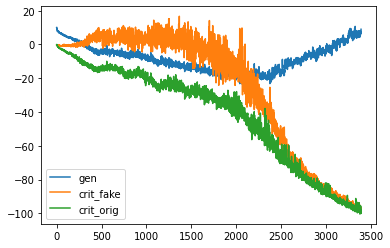

d loss fake  -97.89134979248047
d loss real  -98.94390869140625
[Epoch 10/100] [Batch 1/345] [D loss: -98.417629, acc:   0%] [G loss: 9.661089] [c1: 70.040222, c2: 70.431870, o: 40.407806, f: 70.387131] time: 2:12:21.292407
d loss fake  -97.32563018798828
d loss real  -99.66559600830078
[Epoch 10/100] [Batch 2/345] [D loss: -98.495613, acc:   0%] [G loss: 9.042253] [c1: 59.950829, c2: 59.271721, o: 36.940094, f: 59.959480] time: 2:12:23.591800
d loss fake  -97.27899169921875
d loss real  -99.33663940429688
[Epoch 10/100] [Batch 3/345] [D loss: -98.307816, acc:   0%] [G loss: 8.270613] [c1: 63.849171, c2: 61.758167, o: 37.830585, f: 64.458771] time: 2:12:25.969787
d loss fake  -96.75444030761719
d loss real  -98.50187683105469
[Epoch 10/100] [Batch 4/345] [D loss: -97.628159, acc:   0%] [G loss: 7.829705] [c1: 61.393238, c2: 60.010662, o: 39.522972, f: 59.438972] time: 2:12:28.331858
d loss fake  -97.66421508789062
d loss real  -100.01628875732422
[Epoch 10/100] [Batch 5/345] [D loss: -

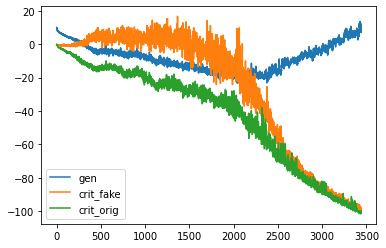

d loss fake  -98.47401428222656
d loss real  -100.8599853515625
[Epoch 10/100] [Batch 51/345] [D loss: -99.667000, acc:   0%] [G loss: 11.192629] [c1: 62.402367, c2: 60.931084, o: 39.315300, f: 61.549141] time: 2:14:16.375867
d loss fake  -99.18936157226562
d loss real  -100.94146728515625
[Epoch 10/100] [Batch 52/345] [D loss: -100.065414, acc:   0%] [G loss: 9.545858] [c1: 63.969177, c2: 63.301048, o: 35.290749, f: 62.254555] time: 2:14:18.657058
d loss fake  -98.02720642089844
d loss real  -99.13134765625
[Epoch 10/100] [Batch 53/345] [D loss: -98.579277, acc:   0%] [G loss: 10.626744] [c1: 61.484406, c2: 61.772186, o: 40.378387, f: 60.246635] time: 2:14:20.931719
d loss fake  -98.51982116699219
d loss real  -101.02436828613281
[Epoch 10/100] [Batch 54/345] [D loss: -99.772095, acc:   0%] [G loss: 9.976824] [c1: 59.900059, c2: 61.204620, o: 38.016724, f: 60.878609] time: 2:14:23.209231
d loss fake  -99.00249481201172
d loss real  -101.56757354736328
[Epoch 10/100] [Batch 55/345] [D 

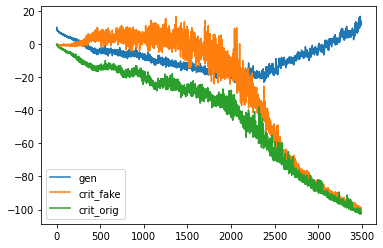

d loss fake  -99.31298828125
d loss real  -101.9527587890625
[Epoch 10/100] [Batch 101/345] [D loss: -100.632874, acc:   0%] [G loss: 11.225704] [c1: 58.620464, c2: 58.244148, o: 41.215336, f: 58.192955] time: 2:16:12.235845
d loss fake  -98.51956176757812
d loss real  -99.63846588134766
[Epoch 10/100] [Batch 102/345] [D loss: -99.079014, acc:   0%] [G loss: 10.266504] [c1: 56.314705, c2: 56.899475, o: 37.598621, f: 54.823475] time: 2:16:14.521861
d loss fake  -101.22398376464844
d loss real  -102.150634765625
[Epoch 10/100] [Batch 103/345] [D loss: -101.687309, acc:   0%] [G loss: 13.666049] [c1: 70.881607, c2: 70.413116, o: 45.021236, f: 72.689453] time: 2:16:16.808758
d loss fake  -100.50277709960938
d loss real  -101.46791076660156
[Epoch 10/100] [Batch 104/345] [D loss: -100.985344, acc:   0%] [G loss: 13.108484] [c1: 65.837936, c2: 65.012932, o: 45.401100, f: 66.393127] time: 2:16:19.096604
d loss fake  -100.81015014648438
d loss real  -102.3062973022461
[Epoch 10/100] [Batch 105

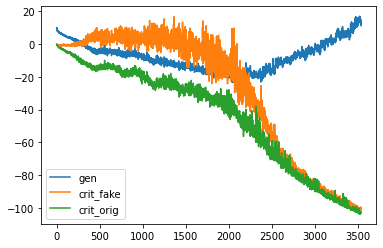

d loss fake  -100.0638427734375
d loss real  -102.54570007324219
[Epoch 10/100] [Batch 151/345] [D loss: -101.304771, acc:   0%] [G loss: 13.039380] [c1: 58.103416, c2: 56.256062, o: 40.326492, f: 56.542519] time: 2:18:08.409913
d loss fake  -98.91143798828125
d loss real  -101.1688461303711
[Epoch 10/100] [Batch 152/345] [D loss: -100.040142, acc:   0%] [G loss: 11.038271] [c1: 52.001678, c2: 51.823204, o: 40.784157, f: 51.471283] time: 2:18:10.697654
d loss fake  -100.12437438964844
d loss real  -103.5146484375
[Epoch 10/100] [Batch 153/345] [D loss: -101.819511, acc:   0%] [G loss: 13.770601] [c1: 57.469872, c2: 59.367176, o: 42.747627, f: 61.470947] time: 2:18:12.978633
d loss fake  -100.85538482666016
d loss real  -103.18416595458984
[Epoch 10/100] [Batch 154/345] [D loss: -102.019775, acc:   0%] [G loss: 12.715395] [c1: 59.655434, c2: 60.481274, o: 36.362991, f: 59.940025] time: 2:18:15.264207
d loss fake  -100.27426147460938
d loss real  -103.78517150878906
[Epoch 10/100] [Batch

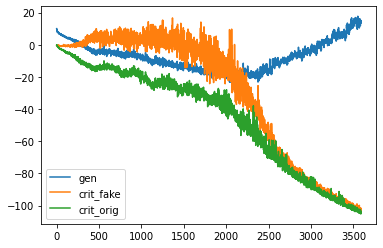

d loss fake  -102.23056030273438
d loss real  -103.51589965820312
[Epoch 10/100] [Batch 201/345] [D loss: -102.873230, acc:   0%] [G loss: 13.612197] [c1: 60.827621, c2: 61.078506, o: 40.927017, f: 60.249504] time: 2:20:03.276209
d loss fake  -102.94825744628906
d loss real  -103.93476104736328
[Epoch 10/100] [Batch 202/345] [D loss: -103.441509, acc:   0%] [G loss: 16.525246] [c1: 63.294502, c2: 64.089371, o: 44.457977, f: 66.111160] time: 2:20:05.567268
d loss fake  -102.4930648803711
d loss real  -104.7236328125
[Epoch 10/100] [Batch 203/345] [D loss: -103.608349, acc:   0%] [G loss: 13.483500] [c1: 61.545937, c2: 62.430649, o: 42.267895, f: 61.448578] time: 2:20:07.839752
d loss fake  -103.04325866699219
d loss real  -104.19873046875
[Epoch 10/100] [Batch 204/345] [D loss: -103.620995, acc:   0%] [G loss: 15.843267] [c1: 63.489807, c2: 64.935158, o: 42.606647, f: 63.834473] time: 2:20:10.126590
d loss fake  -102.09699249267578
d loss real  -104.16435241699219
[Epoch 10/100] [Batch 

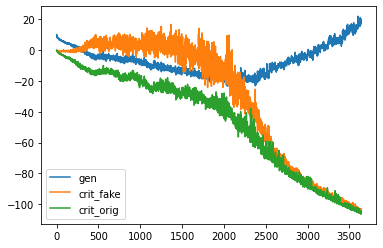

d loss fake  -104.79800415039062
d loss real  -105.41150665283203
[Epoch 10/100] [Batch 251/345] [D loss: -105.104755, acc:   0%] [G loss: 17.839788] [c1: 64.637512, c2: 63.939606, o: 50.175255, f: 64.374313] time: 2:21:59.206818
d loss fake  -104.75245666503906
d loss real  -104.57645416259766
[Epoch 10/100] [Batch 252/345] [D loss: -104.664455, acc:   0%] [G loss: 18.215864] [c1: 65.543762, c2: 66.455643, o: 48.150021, f: 64.291161] time: 2:22:01.492650
d loss fake  -104.7601318359375
d loss real  -103.84274291992188
[Epoch 10/100] [Batch 253/345] [D loss: -104.301437, acc:   0%] [G loss: 16.746439] [c1: 65.296989, c2: 66.884445, o: 49.900070, f: 63.815788] time: 2:22:03.777932
d loss fake  -104.2359619140625
d loss real  -104.25270080566406
[Epoch 10/100] [Batch 254/345] [D loss: -104.244331, acc:   0%] [G loss: 17.487631] [c1: 64.809929, c2: 65.952339, o: 51.363945, f: 64.162964] time: 2:22:06.066439
d loss fake  -105.33175659179688
d loss real  -106.72602844238281
[Epoch 10/100] [

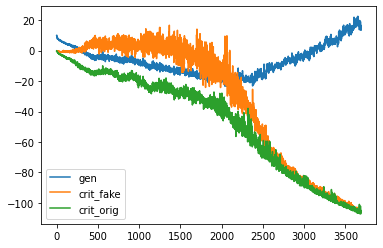

d loss fake  -105.24624633789062
d loss real  -107.12771606445312
[Epoch 10/100] [Batch 301/345] [D loss: -106.186981, acc:   0%] [G loss: 13.934328] [c1: 58.952698, c2: 58.664196, o: 47.202843, f: 58.554844] time: 2:23:54.792548
d loss fake  -105.65663146972656
d loss real  -106.4747314453125
[Epoch 10/100] [Batch 302/345] [D loss: -106.065681, acc:   0%] [G loss: 14.336639] [c1: 59.990997, c2: 59.680061, o: 45.903564, f: 61.013783] time: 2:23:57.079782
d loss fake  -106.4339370727539
d loss real  -106.25981140136719
[Epoch 10/100] [Batch 303/345] [D loss: -106.346874, acc:   0%] [G loss: 16.292694] [c1: 66.575729, c2: 67.054840, o: 45.446941, f: 67.410370] time: 2:23:59.363826
d loss fake  -105.03477478027344
d loss real  -105.73338317871094
[Epoch 10/100] [Batch 304/345] [D loss: -105.384079, acc:   0%] [G loss: 13.624880] [c1: 58.126644, c2: 58.922348, o: 47.473770, f: 58.239845] time: 2:24:01.647407
d loss fake  -105.82559204101562
d loss real  -107.29291534423828
[Epoch 10/100] [

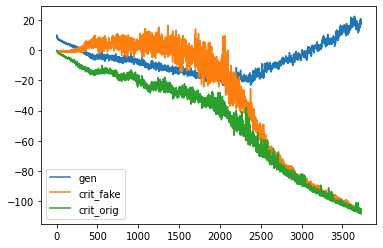

d loss fake  -106.80571746826172
d loss real  -106.50341796875
[Epoch 11/100] [Batch 1/345] [D loss: -106.654568, acc:   0%] [G loss: 19.110211] [c1: 66.570145, c2: 66.331299, o: 52.106377, f: 66.413940] time: 2:25:30.919006
d loss fake  -107.3850326538086
d loss real  -108.15950012207031
[Epoch 11/100] [Batch 2/345] [D loss: -107.772266, acc:   0%] [G loss: 20.736778] [c1: 66.292801, c2: 64.932281, o: 50.456177, f: 69.494812] time: 2:25:33.258752
d loss fake  -107.94084167480469
d loss real  -108.14407348632812
[Epoch 11/100] [Batch 3/345] [D loss: -108.042458, acc:   0%] [G loss: 18.378503] [c1: 69.174316, c2: 67.446259, o: 45.154545, f: 67.309891] time: 2:25:35.597550
d loss fake  -107.05380249023438
d loss real  -107.33863830566406
[Epoch 11/100] [Batch 4/345] [D loss: -107.196220, acc:   0%] [G loss: 17.668757] [c1: 64.170761, c2: 63.611771, o: 47.884064, f: 63.944565] time: 2:25:37.957302
d loss fake  -107.11309814453125
d loss real  -107.79991149902344
[Epoch 11/100] [Batch 5/34

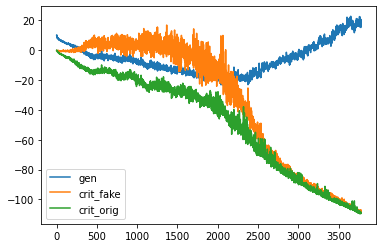

d loss fake  -107.54621887207031
d loss real  -109.23599243164062
[Epoch 11/100] [Batch 51/345] [D loss: -108.391106, acc:   0%] [G loss: 16.499927] [c1: 58.865376, c2: 59.778950, o: 43.980705, f: 58.794392] time: 2:27:25.545051
d loss fake  -107.78022766113281
d loss real  -109.67396545410156
[Epoch 11/100] [Batch 52/345] [D loss: -108.727097, acc:   0%] [G loss: 19.480953] [c1: 60.791901, c2: 61.836651, o: 45.168472, f: 63.779839] time: 2:27:27.831904
d loss fake  -107.66740417480469
d loss real  -108.03870391845703
[Epoch 11/100] [Batch 53/345] [D loss: -107.853054, acc:   0%] [G loss: 17.823875] [c1: 58.865753, c2: 58.495537, o: 44.120731, f: 57.197426] time: 2:27:30.102624
d loss fake  -107.86970520019531
d loss real  -108.0054931640625
[Epoch 11/100] [Batch 54/345] [D loss: -107.937599, acc:   0%] [G loss: 20.888945] [c1: 63.407410, c2: 62.662430, o: 46.171867, f: 63.176617] time: 2:27:32.376204
d loss fake  -108.66303253173828
d loss real  -108.72273254394531
[Epoch 11/100] [Bat

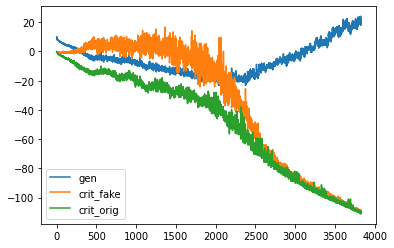

d loss fake  -109.55795288085938
d loss real  -109.96084594726562
[Epoch 11/100] [Batch 101/345] [D loss: -109.759399, acc:   0%] [G loss: 23.944466] [c1: 64.852272, c2: 65.019676, o: 54.739296, f: 62.991268] time: 2:29:21.194860
d loss fake  -109.2498550415039
d loss real  -109.19414520263672
[Epoch 11/100] [Batch 102/345] [D loss: -109.222000, acc:   0%] [G loss: 22.812880] [c1: 64.124931, c2: 63.136471, o: 53.580379, f: 62.260719] time: 2:29:23.481281
d loss fake  -109.67459106445312
d loss real  -110.370361328125
[Epoch 11/100] [Batch 103/345] [D loss: -110.022476, acc:   0%] [G loss: 23.803207] [c1: 67.758194, c2: 67.133934, o: 58.235794, f: 67.730774] time: 2:29:25.753585
d loss fake  -108.59413146972656
d loss real  -110.34552001953125
[Epoch 11/100] [Batch 104/345] [D loss: -109.469826, acc:   0%] [G loss: 21.661650] [c1: 57.699474, c2: 58.081841, o: 56.474609, f: 58.237648] time: 2:29:28.033075
d loss fake  -109.33771514892578
d loss real  -110.86917877197266
[Epoch 11/100] [B

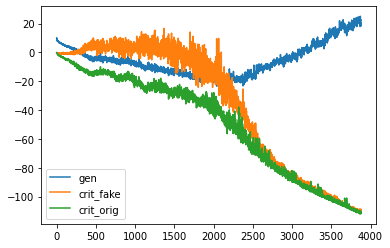

d loss fake  -109.50149536132812
d loss real  -110.68124389648438
[Epoch 11/100] [Batch 151/345] [D loss: -110.091370, acc:   0%] [G loss: 18.996623] [c1: 55.182083, c2: 54.717049, o: 42.828178, f: 53.805058] time: 2:31:16.970340
d loss fake  -109.41541290283203
d loss real  -111.68003845214844
[Epoch 11/100] [Batch 152/345] [D loss: -110.547726, acc:   0%] [G loss: 19.664094] [c1: 56.290466, c2: 56.027958, o: 44.048035, f: 58.884911] time: 2:31:19.253004
d loss fake  -108.84483337402344
d loss real  -111.1772232055664
[Epoch 11/100] [Batch 153/345] [D loss: -110.011028, acc:   0%] [G loss: 17.511396] [c1: 52.875217, c2: 52.910248, o: 40.326160, f: 51.524551] time: 2:31:21.529591
d loss fake  -109.4770278930664
d loss real  -110.70404052734375
[Epoch 11/100] [Batch 154/345] [D loss: -110.090534, acc:   0%] [G loss: 16.748571] [c1: 55.072483, c2: 55.166878, o: 40.657394, f: 54.057808] time: 2:31:23.814368
d loss fake  -109.90985107421875
d loss real  -111.31535339355469
[Epoch 11/100] [

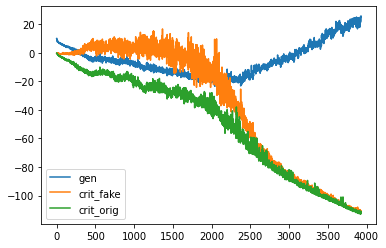

d loss fake  -112.25186157226562
d loss real  -113.11024475097656
[Epoch 11/100] [Batch 201/345] [D loss: -112.681053, acc:   0%] [G loss: 25.784974] [c1: 64.575417, c2: 64.144157, o: 56.175652, f: 66.016876] time: 2:33:11.800501
d loss fake  -110.73075103759766
d loss real  -111.78754425048828
[Epoch 11/100] [Batch 202/345] [D loss: -111.259148, acc:   0%] [G loss: 24.287015] [c1: 63.950268, c2: 63.547195, o: 55.798988, f: 63.136925] time: 2:33:14.076795
d loss fake  -110.55302429199219
d loss real  -111.83894348144531
[Epoch 11/100] [Batch 203/345] [D loss: -111.195984, acc:   0%] [G loss: 23.427336] [c1: 60.132252, c2: 60.178268, o: 53.761154, f: 58.679375] time: 2:33:16.351551
d loss fake  -111.22618103027344
d loss real  -112.37275695800781
[Epoch 11/100] [Batch 204/345] [D loss: -111.799469, acc:   0%] [G loss: 23.058641] [c1: 62.357094, c2: 62.341713, o: 53.889420, f: 63.622505] time: 2:33:18.631969
d loss fake  -111.88179016113281
d loss real  -112.06354522705078
[Epoch 11/100]

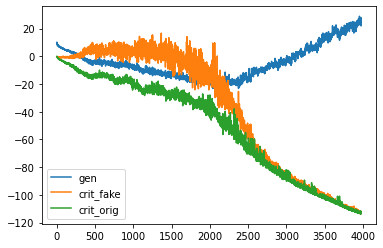

d loss fake  -112.97882843017578
d loss real  -113.79768371582031
[Epoch 11/100] [Batch 251/345] [D loss: -113.388256, acc:   0%] [G loss: 25.503084] [c1: 64.402298, c2: 63.504227, o: 56.373856, f: 65.317291] time: 2:35:07.441706
d loss fake  -111.93948364257812
d loss real  -113.34403991699219
[Epoch 11/100] [Batch 252/345] [D loss: -112.641762, acc:   0%] [G loss: 23.541229] [c1: 58.547096, c2: 59.605255, o: 54.102718, f: 57.792786] time: 2:35:09.725156
d loss fake  -113.21009826660156
d loss real  -112.87757873535156
[Epoch 11/100] [Batch 253/345] [D loss: -113.043839, acc:   0%] [G loss: 26.369363] [c1: 67.377647, c2: 67.221451, o: 54.434189, f: 65.531143] time: 2:35:11.990850
d loss fake  -113.06183624267578
d loss real  -113.8481674194336
[Epoch 11/100] [Batch 254/345] [D loss: -113.455002, acc:   0%] [G loss: 26.037076] [c1: 64.330002, c2: 64.267212, o: 58.772572, f: 65.424789] time: 2:35:14.270385
d loss fake  -112.59828186035156
d loss real  -112.92649841308594
[Epoch 11/100] 

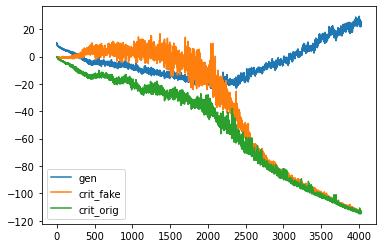

d loss fake  -113.08487701416016
d loss real  -113.69493103027344
[Epoch 11/100] [Batch 301/345] [D loss: -113.389904, acc:   0%] [G loss: 22.860202] [c1: 55.672798, c2: 55.409645, o: 51.898941, f: 55.331848] time: 2:37:03.001292
d loss fake  -113.3587417602539
d loss real  -114.47666931152344
[Epoch 11/100] [Batch 302/345] [D loss: -113.917706, acc:   0%] [G loss: 22.784569] [c1: 59.464432, c2: 58.738121, o: 51.488888, f: 59.971622] time: 2:37:05.288830
d loss fake  -113.67521667480469
d loss real  -113.36231994628906
[Epoch 11/100] [Batch 303/345] [D loss: -113.518768, acc:   0%] [G loss: 22.719860] [c1: 58.787209, c2: 58.617786, o: 48.157204, f: 57.597549] time: 2:37:07.561082
d loss fake  -113.6126708984375
d loss real  -113.1927719116211
[Epoch 11/100] [Batch 304/345] [D loss: -113.402721, acc:   0%] [G loss: 24.436972] [c1: 62.407814, c2: 62.879517, o: 51.965679, f: 64.176361] time: 2:37:09.850628
d loss fake  -113.69986724853516
d loss real  -114.94867706298828
[Epoch 11/100] [B

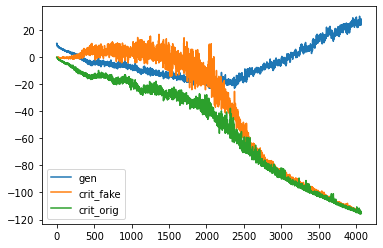

d loss fake  -114.3901596069336
d loss real  -114.80000305175781
[Epoch 12/100] [Batch 1/345] [D loss: -114.595081, acc:   0%] [G loss: 26.066501] [c1: 62.294098, c2: 62.343651, o: 55.076096, f: 61.602783] time: 2:38:38.666642
d loss fake  -114.57451629638672
d loss real  -114.69537353515625
[Epoch 12/100] [Batch 2/345] [D loss: -114.634945, acc:   0%] [G loss: 25.621134] [c1: 63.562424, c2: 63.034821, o: 53.197021, f: 61.584381] time: 2:38:40.999742
d loss fake  -114.0229721069336
d loss real  -115.412353515625
[Epoch 12/100] [Batch 3/345] [D loss: -114.717663, acc:   0%] [G loss: 23.725781] [c1: 58.143604, c2: 58.390251, o: 53.089424, f: 60.370163] time: 2:38:43.318832
d loss fake  -114.86844635009766
d loss real  -115.88935089111328
[Epoch 12/100] [Batch 4/345] [D loss: -115.378899, acc:   0%] [G loss: 25.894969] [c1: 62.874779, c2: 63.644749, o: 48.937057, f: 64.194962] time: 2:38:45.652081
d loss fake  -115.24861907958984
d loss real  -115.88571166992188
[Epoch 12/100] [Batch 5/34

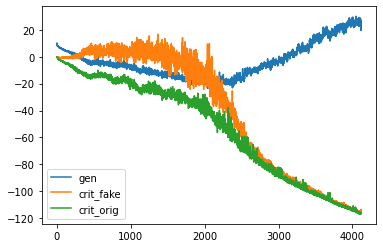

d loss fake  -115.57244110107422
d loss real  -115.98324584960938
[Epoch 12/100] [Batch 51/345] [D loss: -115.777843, acc:   0%] [G loss: 25.008384] [c1: 62.026855, c2: 62.173370, o: 46.842888, f: 60.820019] time: 2:40:33.475412
d loss fake  -115.69761657714844
d loss real  -116.10916137695312
[Epoch 12/100] [Batch 52/345] [D loss: -115.903389, acc:   0%] [G loss: 23.665349] [c1: 60.100445, c2: 59.899632, o: 47.587025, f: 58.141396] time: 2:40:35.753639
d loss fake  -116.07485961914062
d loss real  -116.61923217773438
[Epoch 12/100] [Batch 53/345] [D loss: -116.347046, acc:   0%] [G loss: 24.520695] [c1: 61.882927, c2: 61.005806, o: 48.789890, f: 61.904106] time: 2:40:38.031267
d loss fake  -115.96052551269531
d loss real  -115.90049743652344
[Epoch 12/100] [Batch 54/345] [D loss: -115.930511, acc:   0%] [G loss: 27.186451] [c1: 63.308426, c2: 62.387756, o: 49.917595, f: 62.793465] time: 2:40:40.299128
d loss fake  -114.96488952636719
d loss real  -115.86932373046875
[Epoch 12/100] [Ba

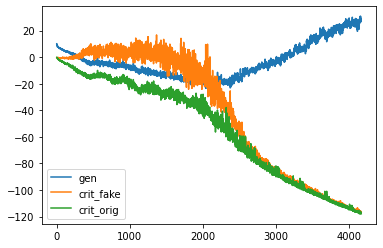

d loss fake  -117.24483489990234
d loss real  -117.55093383789062
[Epoch 12/100] [Batch 101/345] [D loss: -117.397884, acc:   0%] [G loss: 30.102593] [c1: 66.591637, c2: 65.705452, o: 51.794983, f: 65.085587] time: 2:42:28.865285
d loss fake  -116.43350219726562
d loss real  -117.16383361816406
[Epoch 12/100] [Batch 102/345] [D loss: -116.798668, acc:   0%] [G loss: 27.687664] [c1: 57.644768, c2: 57.381989, o: 54.527496, f: 56.422745] time: 2:42:31.156194
d loss fake  -116.72889709472656
d loss real  -117.18075561523438
[Epoch 12/100] [Batch 103/345] [D loss: -116.954826, acc:   0%] [G loss: 28.722333] [c1: 61.154995, c2: 61.026730, o: 55.535767, f: 60.411823] time: 2:42:33.436816
d loss fake  -116.82577514648438
d loss real  -118.37113952636719
[Epoch 12/100] [Batch 104/345] [D loss: -117.598457, acc:   0%] [G loss: 28.751132] [c1: 61.079388, c2: 61.275982, o: 56.102409, f: 64.679657] time: 2:42:35.736178
d loss fake  -116.7642822265625
d loss real  -117.19639587402344
[Epoch 12/100] 

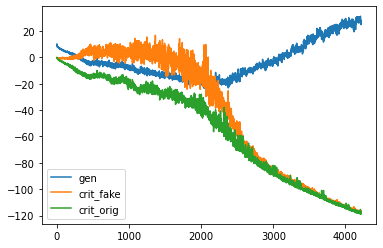

d loss fake  -117.38510131835938
d loss real  -118.84515380859375
[Epoch 12/100] [Batch 151/345] [D loss: -118.115128, acc:   0%] [G loss: 26.284638] [c1: 57.343128, c2: 56.894043, o: 49.441147, f: 58.516415] time: 2:44:25.031828
d loss fake  -117.62764739990234
d loss real  -118.42769622802734
[Epoch 12/100] [Batch 152/345] [D loss: -118.027672, acc:   0%] [G loss: 24.266059] [c1: 58.419998, c2: 57.149452, o: 46.249855, f: 56.659470] time: 2:44:27.330334
d loss fake  -117.04640197753906
d loss real  -117.4394760131836
[Epoch 12/100] [Batch 153/345] [D loss: -117.242939, acc:   0%] [G loss: 26.079488] [c1: 57.595001, c2: 56.781185, o: 46.393829, f: 54.817410] time: 2:44:29.617711
d loss fake  -116.78623962402344
d loss real  -117.69004821777344
[Epoch 12/100] [Batch 154/345] [D loss: -117.238144, acc:   0%] [G loss: 25.100256] [c1: 54.434380, c2: 54.244953, o: 50.147293, f: 56.069221] time: 2:44:31.908785
d loss fake  -116.15229797363281
d loss real  -117.58231353759766
[Epoch 12/100] 

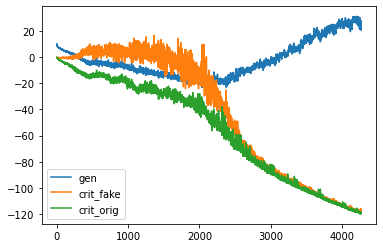

d loss fake  -118.33818054199219
d loss real  -118.36268615722656
[Epoch 12/100] [Batch 201/345] [D loss: -118.350433, acc:   0%] [G loss: 25.467248] [c1: 62.394428, c2: 61.281860, o: 47.228775, f: 60.678497] time: 2:46:19.904231
d loss fake  -117.1299819946289
d loss real  -119.11282348632812
[Epoch 12/100] [Batch 202/345] [D loss: -118.121403, acc:   0%] [G loss: 25.020257] [c1: 56.849892, c2: 56.277306, o: 47.912193, f: 58.502426] time: 2:46:22.187496
d loss fake  -118.22940063476562
d loss real  -119.7187728881836
[Epoch 12/100] [Batch 203/345] [D loss: -118.974087, acc:   0%] [G loss: 27.684716] [c1: 59.914833, c2: 60.920746, o: 45.393124, f: 60.983208] time: 2:46:24.472071
d loss fake  -117.74798583984375
d loss real  -119.29934692382812
[Epoch 12/100] [Batch 204/345] [D loss: -118.523666, acc:   0%] [G loss: 23.954821] [c1: 55.649307, c2: 55.700871, o: 45.437447, f: 56.973969] time: 2:46:26.754564
d loss fake  -118.51544189453125
d loss real  -119.08871459960938
[Epoch 12/100] [

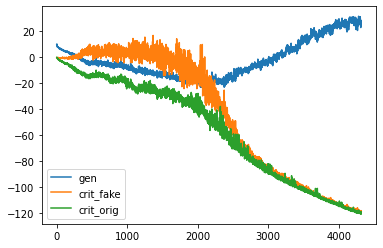

d loss fake  -117.98408508300781
d loss real  -119.47569274902344
[Epoch 12/100] [Batch 251/345] [D loss: -118.729889, acc:   0%] [G loss: 19.709347] [c1: 53.678764, c2: 55.401505, o: 39.792938, f: 53.482018] time: 2:48:15.793445
d loss fake  -119.95850372314453
d loss real  -120.24942016601562
[Epoch 12/100] [Batch 252/345] [D loss: -120.103962, acc:   0%] [G loss: 26.700915] [c1: 64.599960, c2: 62.737614, o: 42.330021, f: 63.112167] time: 2:48:18.084905
d loss fake  -119.5725326538086
d loss real  -120.43785095214844
[Epoch 12/100] [Batch 253/345] [D loss: -120.005192, acc:   0%] [G loss: 27.238833] [c1: 62.184319, c2: 60.534279, o: 47.915909, f: 63.512234] time: 2:48:20.357170
d loss fake  -117.3641357421875
d loss real  -118.30364990234375
[Epoch 12/100] [Batch 254/345] [D loss: -117.833893, acc:   0%] [G loss: 20.943130] [c1: 54.585674, c2: 53.997192, o: 44.515717, f: 54.666328] time: 2:48:22.644750
d loss fake  -118.56971740722656
d loss real  -120.6718978881836
[Epoch 12/100] [B

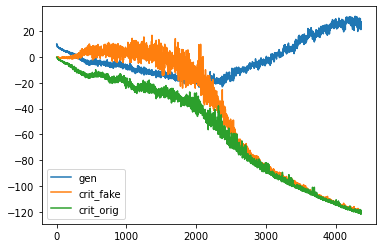

d loss fake  -120.07560729980469
d loss real  -118.26618957519531
[Epoch 12/100] [Batch 301/345] [D loss: -119.170898, acc:   0%] [G loss: 26.244803] [c1: 60.228027, c2: 60.334961, o: 45.560822, f: 58.681137] time: 2:50:11.482044
d loss fake  -120.58027648925781
d loss real  -120.88826751708984
[Epoch 12/100] [Batch 302/345] [D loss: -120.734272, acc:   0%] [G loss: 25.097568] [c1: 60.224922, c2: 60.363384, o: 48.837418, f: 60.974571] time: 2:50:13.767901
d loss fake  -120.15864562988281
d loss real  -120.72956085205078
[Epoch 12/100] [Batch 303/345] [D loss: -120.444103, acc:   0%] [G loss: 22.998598] [c1: 55.969940, c2: 56.277390, o: 47.929100, f: 56.430798] time: 2:50:16.051829
d loss fake  -120.85692596435547
d loss real  -119.3643798828125
[Epoch 12/100] [Batch 304/345] [D loss: -120.110653, acc:   0%] [G loss: 25.674701] [c1: 61.930161, c2: 61.629143, o: 46.345226, f: 60.282036] time: 2:50:18.337538
d loss fake  -120.08116149902344
d loss real  -121.48704528808594
[Epoch 12/100] 

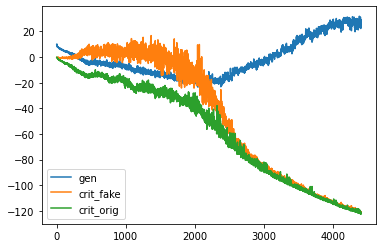

d loss fake  -121.41188049316406
d loss real  -122.81974029541016
[Epoch 13/100] [Batch 1/345] [D loss: -122.115810, acc:   0%] [G loss: 25.128818] [c1: 58.861397, c2: 59.087479, o: 44.071327, f: 61.774246] time: 2:51:46.762914
d loss fake  -121.73681640625
d loss real  -122.33798217773438
[Epoch 13/100] [Batch 2/345] [D loss: -122.037399, acc:   0%] [G loss: 27.143473] [c1: 61.831825, c2: 60.794872, o: 40.470337, f: 61.682877] time: 2:51:49.082791
d loss fake  -120.97162628173828
d loss real  -121.96369171142578
[Epoch 13/100] [Batch 3/345] [D loss: -121.467659, acc:   0%] [G loss: 25.911597] [c1: 59.047791, c2: 58.540138, o: 41.990776, f: 58.389000] time: 2:51:51.419541
d loss fake  -121.24441528320312
d loss real  -121.97480773925781
[Epoch 13/100] [Batch 4/345] [D loss: -121.609612, acc:   0%] [G loss: 23.709120] [c1: 57.125443, c2: 57.071033, o: 42.696152, f: 58.020908] time: 2:51:53.750847
d loss fake  -121.25772094726562
d loss real  -121.74984741210938
[Epoch 13/100] [Batch 5/3

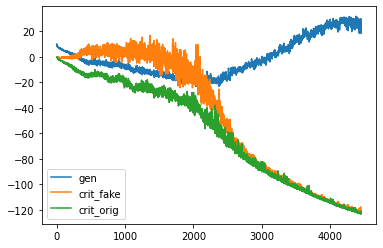

d loss fake  -121.80209350585938
d loss real  -121.6622314453125
[Epoch 13/100] [Batch 51/345] [D loss: -121.732162, acc:   0%] [G loss: 20.261733] [c1: 59.346931, c2: 58.313820, o: 39.675880, f: 57.178879] time: 2:53:41.661792
d loss fake  -122.2138442993164
d loss real  -122.88246154785156
[Epoch 13/100] [Batch 52/345] [D loss: -122.548153, acc:   0%] [G loss: 22.654030] [c1: 58.794655, c2: 58.420319, o: 42.847923, f: 59.488548] time: 2:53:43.944106
d loss fake  -120.7501220703125
d loss real  -123.16270446777344
[Epoch 13/100] [Batch 53/345] [D loss: -121.956413, acc:   0%] [G loss: 19.877823] [c1: 51.005676, c2: 50.942730, o: 40.643921, f: 53.700905] time: 2:53:46.219927
d loss fake  -122.19474792480469
d loss real  -122.59494018554688
[Epoch 13/100] [Batch 54/345] [D loss: -122.394844, acc:   0%] [G loss: 22.695091] [c1: 56.972622, c2: 56.171104, o: 37.352062, f: 56.692635] time: 2:53:48.506412
d loss fake  -119.85127258300781
d loss real  -121.99612426757812
[Epoch 13/100] [Batch

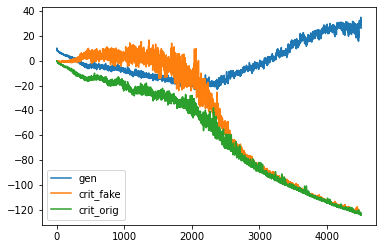

d loss fake  -123.5508804321289
d loss real  -123.62478637695312
[Epoch 13/100] [Batch 101/345] [D loss: -123.587833, acc:   0%] [G loss: 27.357689] [c1: 62.139137, c2: 60.292526, o: 47.272453, f: 60.563641] time: 2:55:37.652224
d loss fake  -123.22808837890625
d loss real  -123.8097152709961
[Epoch 13/100] [Batch 102/345] [D loss: -123.518902, acc:   0%] [G loss: 28.850511] [c1: 62.058372, c2: 60.775101, o: 49.500595, f: 61.290699] time: 2:55:39.934469
d loss fake  -123.1924819946289
d loss real  -123.82756805419922
[Epoch 13/100] [Batch 103/345] [D loss: -123.510025, acc:   0%] [G loss: 26.953066] [c1: 60.637863, c2: 59.931965, o: 47.988953, f: 60.230106] time: 2:55:42.210481
d loss fake  -123.59368133544922
d loss real  -124.44454956054688
[Epoch 13/100] [Batch 104/345] [D loss: -124.019115, acc:   0%] [G loss: 27.973902] [c1: 60.853413, c2: 60.323166, o: 50.991730, f: 62.954174] time: 2:55:44.487502
d loss fake  -123.1338119506836
d loss real  -123.75741577148438
[Epoch 13/100] [Ba

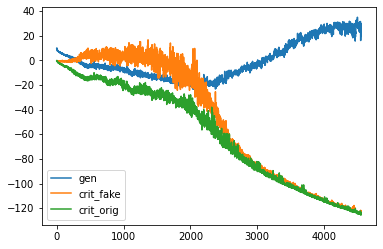

d loss fake  -122.36857604980469
d loss real  -124.79458618164062
[Epoch 13/100] [Batch 151/345] [D loss: -123.581581, acc:   0%] [G loss: 20.749505] [c1: 51.982124, c2: 52.655998, o: 43.587196, f: 54.913368] time: 2:57:33.252939
d loss fake  -123.09243774414062
d loss real  -123.75527954101562
[Epoch 13/100] [Batch 152/345] [D loss: -123.423859, acc:   0%] [G loss: 19.477689] [c1: 50.119732, c2: 51.129456, o: 33.171860, f: 46.780853] time: 2:57:35.543742
d loss fake  -124.00806427001953
d loss real  -124.20283508300781
[Epoch 13/100] [Batch 153/345] [D loss: -124.105450, acc:   0%] [G loss: 24.411888] [c1: 59.267303, c2: 59.380474, o: 40.819057, f: 57.600071] time: 2:57:37.814867
d loss fake  -123.42068481445312
d loss real  -124.28121948242188
[Epoch 13/100] [Batch 154/345] [D loss: -123.850952, acc:   0%] [G loss: 21.251376] [c1: 55.972855, c2: 55.568787, o: 42.753700, f: 56.874054] time: 2:57:40.096665
d loss fake  -123.77073669433594
d loss real  -125.04164123535156
[Epoch 13/100]

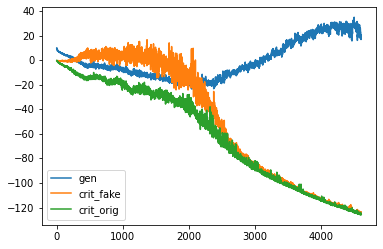

d loss fake  -125.45811462402344
d loss real  -125.45468139648438
[Epoch 13/100] [Batch 201/345] [D loss: -125.456398, acc:   0%] [G loss: 19.214838] [c1: 58.053665, c2: 55.729195, o: 29.807274, f: 53.632076] time: 2:59:28.202156
d loss fake  -125.15587615966797
d loss real  -125.9328842163086
[Epoch 13/100] [Batch 202/345] [D loss: -125.544380, acc:   0%] [G loss: 20.546517] [c1: 57.431744, c2: 57.610878, o: 37.352859, f: 57.577805] time: 2:59:30.476704
d loss fake  -124.80611419677734
d loss real  -125.76924133300781
[Epoch 13/100] [Batch 203/345] [D loss: -125.287678, acc:   0%] [G loss: 22.289326] [c1: 56.138664, c2: 55.789574, o: 37.698997, f: 55.102638] time: 2:59:32.745810
d loss fake  -124.51420593261719
d loss real  -125.23765563964844
[Epoch 13/100] [Batch 204/345] [D loss: -124.875931, acc:   0%] [G loss: 21.081228] [c1: 58.376678, c2: 59.416355, o: 36.944016, f: 58.349136] time: 2:59:35.035683
d loss fake  -124.61841583251953
d loss real  -124.84212493896484
[Epoch 13/100] 

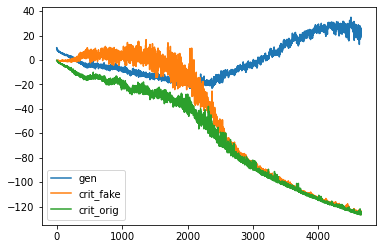

d loss fake  -125.97386169433594
d loss real  -126.93487548828125
[Epoch 13/100] [Batch 251/345] [D loss: -126.454369, acc:   0%] [G loss: 19.814158] [c1: 58.322922, c2: 57.545593, o: 41.480385, f: 62.216908] time: 3:01:23.836800
d loss fake  -126.33305358886719
d loss real  -126.69985961914062
[Epoch 13/100] [Batch 252/345] [D loss: -126.516457, acc:   0%] [G loss: 21.280824] [c1: 59.095558, c2: 58.033897, o: 39.677719, f: 58.326172] time: 3:01:26.126602
d loss fake  -126.34243774414062
d loss real  -125.94110107421875
[Epoch 13/100] [Batch 253/345] [D loss: -126.141769, acc:   0%] [G loss: 21.909289] [c1: 60.098026, c2: 59.385193, o: 40.703522, f: 57.587433] time: 3:01:28.399847
d loss fake  -126.5927505493164
d loss real  -126.61753845214844
[Epoch 13/100] [Batch 254/345] [D loss: -126.605145, acc:   0%] [G loss: 28.407101] [c1: 67.102585, c2: 65.652969, o: 47.992020, f: 66.506912] time: 3:01:30.680126
d loss fake  -125.710205078125
d loss real  -125.01272583007812
[Epoch 13/100] [B

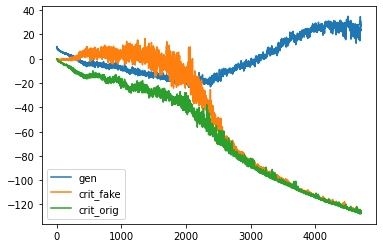

d loss fake  -127.44486999511719
d loss real  -127.88024139404297
[Epoch 13/100] [Batch 301/345] [D loss: -127.662556, acc:   0%] [G loss: 24.118640] [c1: 62.018810, c2: 61.885109, o: 53.515884, f: 63.419510] time: 3:03:19.464450
d loss fake  -126.91366577148438
d loss real  -127.70098114013672
[Epoch 13/100] [Batch 302/345] [D loss: -127.307323, acc:   0%] [G loss: 22.418832] [c1: 56.267040, c2: 54.715061, o: 48.972168, f: 58.153847] time: 3:03:21.745509
d loss fake  -126.6652603149414
d loss real  -127.54568481445312
[Epoch 13/100] [Batch 303/345] [D loss: -127.105473, acc:   0%] [G loss: 21.939566] [c1: 57.295177, c2: 55.683784, o: 46.047745, f: 58.338985] time: 3:03:24.014977
d loss fake  -127.18846130371094
d loss real  -127.45549011230469
[Epoch 13/100] [Batch 304/345] [D loss: -127.321976, acc:   0%] [G loss: 21.852598] [c1: 57.633305, c2: 57.083519, o: 41.113949, f: 56.284096] time: 3:03:26.286555
d loss fake  -126.56072998046875
d loss real  -126.53257751464844
[Epoch 13/100] 

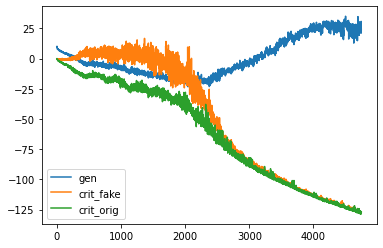

d loss fake  -126.75221252441406
d loss real  -128.2147979736328
[Epoch 14/100] [Batch 1/345] [D loss: -127.483505, acc:   0%] [G loss: 18.490938] [c1: 51.522690, c2: 53.050484, o: 38.634407, f: 54.598320] time: 3:04:54.190968
d loss fake  -127.57994842529297
d loss real  -128.1925506591797
[Epoch 14/100] [Batch 2/345] [D loss: -127.886250, acc:   0%] [G loss: 20.030526] [c1: 55.595207, c2: 58.017914, o: 35.425537, f: 53.836750] time: 3:04:56.537955
d loss fake  -128.03968811035156
d loss real  -128.17742919921875
[Epoch 14/100] [Batch 3/345] [D loss: -128.108559, acc:   0%] [G loss: 23.840853] [c1: 61.956085, c2: 62.012970, o: 41.376881, f: 61.076771] time: 3:04:58.876580
d loss fake  -128.05349731445312
d loss real  -128.52149963378906
[Epoch 14/100] [Batch 4/345] [D loss: -128.287498, acc:   0%] [G loss: 22.897607] [c1: 61.882500, c2: 59.939125, o: 40.220016, f: 62.186901] time: 3:05:01.235532
d loss fake  -127.5055923461914
d loss real  -128.61358642578125
[Epoch 14/100] [Batch 5/3

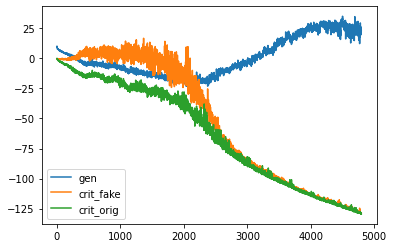

d loss fake  -128.59750366210938
d loss real  -129.4940185546875
[Epoch 14/100] [Batch 51/345] [D loss: -129.045761, acc:   0%] [G loss: 21.183560] [c1: 52.280552, c2: 53.175732, o: 46.374496, f: 54.507145] time: 3:06:49.277656
d loss fake  -128.56527709960938
d loss real  -127.61492919921875
[Epoch 14/100] [Batch 52/345] [D loss: -128.090103, acc:   0%] [G loss: 21.539991] [c1: 58.827934, c2: 59.635498, o: 41.803154, f: 54.937935] time: 3:06:51.555777
d loss fake  -125.86721801757812
d loss real  -128.88894653320312
[Epoch 14/100] [Batch 53/345] [D loss: -127.378082, acc:   0%] [G loss: 17.453406] [c1: 50.602737, c2: 52.416828, o: 47.192066, f: 56.234135] time: 3:06:53.831714
d loss fake  -129.12371826171875
d loss real  -128.7708282470703
[Epoch 14/100] [Batch 54/345] [D loss: -128.947273, acc:   0%] [G loss: 28.540248] [c1: 64.286285, c2: 63.142948, o: 39.999447, f: 56.488487] time: 3:06:56.111929
d loss fake  -129.01959228515625
d loss real  -128.75155639648438
[Epoch 14/100] [Batc

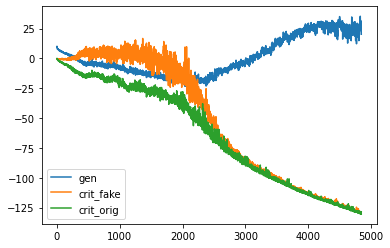

d loss fake  -129.65126037597656
d loss real  -129.80902099609375
[Epoch 14/100] [Batch 101/345] [D loss: -129.730141, acc:   0%] [G loss: 26.076777] [c1: 66.043945, c2: 66.079582, o: 40.620876, f: 61.713463] time: 3:08:44.989110
d loss fake  -129.365478515625
d loss real  -129.92697143554688
[Epoch 14/100] [Batch 102/345] [D loss: -129.646225, acc:   0%] [G loss: 24.974149] [c1: 60.940430, c2: 59.271355, o: 50.235703, f: 62.503326] time: 3:08:47.276502
d loss fake  -130.0067138671875
d loss real  -130.177490234375
[Epoch 14/100] [Batch 103/345] [D loss: -130.092102, acc:   0%] [G loss: 27.632205] [c1: 63.408215, c2: 62.168694, o: 49.189781, f: 61.032722] time: 3:08:49.571109
d loss fake  -130.06480407714844
d loss real  -130.2760467529297
[Epoch 14/100] [Batch 104/345] [D loss: -130.170425, acc:   0%] [G loss: 26.520908] [c1: 62.877934, c2: 63.027481, o: 50.996254, f: 63.009987] time: 3:08:51.863747
d loss fake  -129.5831298828125
d loss real  -129.91763305664062
[Epoch 14/100] [Batch

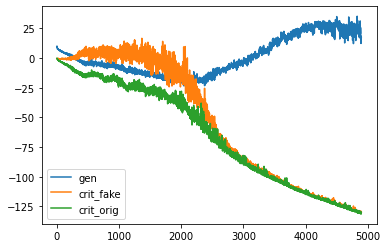

d loss fake  -130.70533752441406
d loss real  -130.86839294433594
[Epoch 14/100] [Batch 151/345] [D loss: -130.786865, acc:   0%] [G loss: 20.249037] [c1: 60.566654, c2: 58.737228, o: 34.510509, f: 57.707275] time: 3:10:41.129084
d loss fake  -130.5799560546875
d loss real  -131.24655151367188
[Epoch 14/100] [Batch 152/345] [D loss: -130.913254, acc:   0%] [G loss: 18.467351] [c1: 59.154526, c2: 55.133041, o: 40.948921, f: 60.437469] time: 3:10:43.418551
d loss fake  -130.3533172607422
d loss real  -130.29684448242188
[Epoch 14/100] [Batch 153/345] [D loss: -130.325081, acc:   0%] [G loss: 22.335323] [c1: 58.875568, c2: 59.334305, o: 35.352394, f: 54.389526] time: 3:10:45.698741
d loss fake  -130.72088623046875
d loss real  -130.5838623046875
[Epoch 14/100] [Batch 154/345] [D loss: -130.652374, acc:   0%] [G loss: 26.862671] [c1: 65.331497, c2: 65.310356, o: 42.780354, f: 62.299728] time: 3:10:47.985247
d loss fake  -130.74270629882812
d loss real  -130.59568786621094
[Epoch 14/100] [B

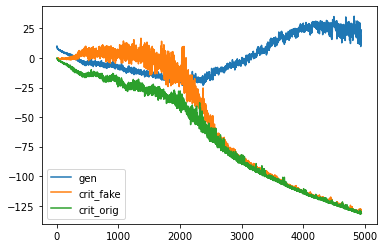

d loss fake  -130.83651733398438
d loss real  -131.32919311523438
[Epoch 14/100] [Batch 201/345] [D loss: -131.082855, acc:   0%] [G loss: 21.870541] [c1: 61.353821, c2: 63.439659, o: 45.609028, f: 61.005589] time: 3:12:35.819682
d loss fake  -130.65582275390625
d loss real  -131.0736541748047
[Epoch 14/100] [Batch 202/345] [D loss: -130.864738, acc:   0%] [G loss: 19.582004] [c1: 61.280827, c2: 60.566830, o: 43.803104, f: 63.405968] time: 3:12:38.101296
d loss fake  -131.58270263671875
d loss real  -132.256591796875
[Epoch 14/100] [Batch 203/345] [D loss: -131.919647, acc:   0%] [G loss: 20.362955] [c1: 58.618469, c2: 55.469868, o: 43.474182, f: 62.953426] time: 3:12:40.383225
d loss fake  -130.94168090820312
d loss real  -130.920166015625
[Epoch 14/100] [Batch 204/345] [D loss: -130.930923, acc:   0%] [G loss: 26.331871] [c1: 61.438961, c2: 60.651009, o: 38.997158, f: 53.667149] time: 3:12:42.672421
d loss fake  -130.80316162109375
d loss real  -130.49951171875
[Epoch 14/100] [Batch 

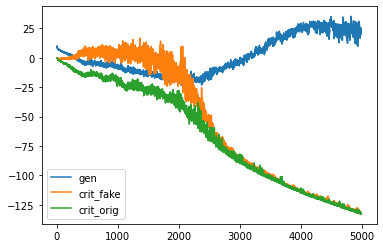

d loss fake  -132.53607177734375
d loss real  -131.84039306640625
[Epoch 14/100] [Batch 251/345] [D loss: -132.188232, acc:   0%] [G loss: 24.707172] [c1: 63.494587, c2: 63.540253, o: 43.220787, f: 61.330467] time: 3:14:31.912555
d loss fake  -132.02162170410156
d loss real  -129.51901245117188
[Epoch 14/100] [Batch 252/345] [D loss: -130.770317, acc:   0%] [G loss: 23.202565] [c1: 65.379807, c2: 66.282455, o: 46.230583, f: 61.950069] time: 3:14:34.188066
d loss fake  -130.29954528808594
d loss real  -131.2225799560547
[Epoch 14/100] [Batch 253/345] [D loss: -130.761063, acc:   0%] [G loss: 19.438192] [c1: 58.248539, c2: 60.942829, o: 49.488190, f: 64.461075] time: 3:14:36.466254
d loss fake  -132.44271850585938
d loss real  -132.59625244140625
[Epoch 14/100] [Batch 254/345] [D loss: -132.519485, acc:   0%] [G loss: 21.598972] [c1: 65.510948, c2: 63.564610, o: 43.605392, f: 64.952881] time: 3:14:38.754303
d loss fake  -132.23660278320312
d loss real  -132.53515625
[Epoch 14/100] [Batch

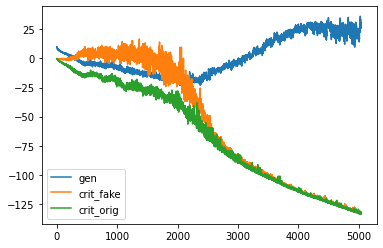

d loss fake  -133.40869140625
d loss real  -133.47125244140625
[Epoch 14/100] [Batch 301/345] [D loss: -133.439972, acc:   0%] [G loss: 32.561195] [c1: 70.673355, c2: 70.315948, o: 59.340912, f: 69.769310] time: 3:16:27.631490
d loss fake  -133.62799072265625
d loss real  -133.84922790527344
[Epoch 14/100] [Batch 302/345] [D loss: -133.738609, acc:   0%] [G loss: 31.610940] [c1: 69.438690, c2: 68.434471, o: 63.107155, f: 70.720612] time: 3:16:29.920421
d loss fake  -133.6883544921875
d loss real  -133.73284912109375
[Epoch 14/100] [Batch 303/345] [D loss: -133.710602, acc:   0%] [G loss: 31.999130] [c1: 68.035133, c2: 67.559998, o: 60.128990, f: 68.008347] time: 3:16:32.200459
d loss fake  -133.68804931640625
d loss real  -133.47120666503906
[Epoch 14/100] [Batch 304/345] [D loss: -133.579628, acc:   0%] [G loss: 33.513924] [c1: 69.812256, c2: 70.047241, o: 59.694252, f: 67.587860] time: 3:16:34.486438
d loss fake  -133.67507934570312
d loss real  -133.5963592529297
[Epoch 14/100] [Bat

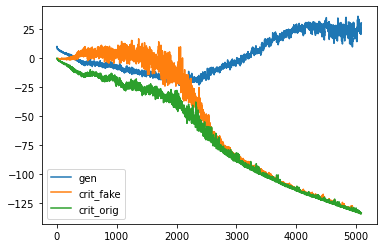

d loss fake  -134.1100616455078
d loss real  -134.4007568359375
[Epoch 15/100] [Batch 1/345] [D loss: -134.255409, acc:   0%] [G loss: 25.368600] [c1: 60.869179, c2: 61.883156, o: 51.386612, f: 62.209869] time: 3:18:03.770565
d loss fake  -134.17355346679688
d loss real  -134.66458129882812
[Epoch 15/100] [Batch 2/345] [D loss: -134.419067, acc:   0%] [G loss: 29.429536] [c1: 64.837914, c2: 64.661179, o: 54.145111, f: 68.472221] time: 3:18:06.074465
d loss fake  -132.656982421875
d loss real  -134.6420440673828
[Epoch 15/100] [Batch 3/345] [D loss: -133.649513, acc:   0%] [G loss: 19.074804] [c1: 52.114231, c2: 51.930870, o: 46.750721, f: 59.105553] time: 3:18:08.426912
d loss fake  -134.32757568359375
d loss real  -134.64752197265625
[Epoch 15/100] [Batch 4/345] [D loss: -134.487549, acc:   0%] [G loss: 21.180164] [c1: 57.348011, c2: 57.013916, o: 36.463043, f: 53.536644] time: 3:18:10.807270
d loss fake  -133.4770965576172
d loss real  -134.05226135253906
[Epoch 15/100] [Batch 5/345]

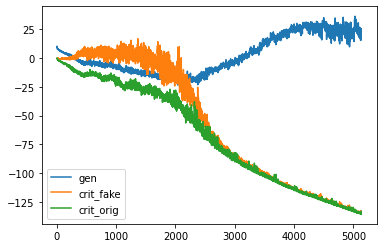

d loss fake  -135.02459716796875
d loss real  -134.9040985107422
[Epoch 15/100] [Batch 51/345] [D loss: -134.964348, acc:   0%] [G loss: 27.515468] [c1: 62.006981, c2: 60.947388, o: 47.329224, f: 58.370182] time: 3:19:58.874995
d loss fake  -133.53994750976562
d loss real  -134.65359497070312
[Epoch 15/100] [Batch 52/345] [D loss: -134.096771, acc:   0%] [G loss: 21.194711] [c1: 54.718628, c2: 55.693764, o: 51.721233, f: 58.055840] time: 3:20:01.167260
d loss fake  -133.87100219726562
d loss real  -135.49755859375
[Epoch 15/100] [Batch 53/345] [D loss: -134.684280, acc:   0%] [G loss: 15.681638] [c1: 45.046013, c2: 47.626801, o: 46.553135, f: 51.720955] time: 3:20:03.445293
d loss fake  -134.5074005126953
d loss real  -134.86276245117188
[Epoch 15/100] [Batch 54/345] [D loss: -134.685081, acc:   0%] [G loss: 15.465467] [c1: 51.751141, c2: 50.349415, o: 38.672050, f: 49.804634] time: 3:20:05.722152
d loss fake  -135.0669403076172
d loss real  -134.8692626953125
[Epoch 15/100] [Batch 55/

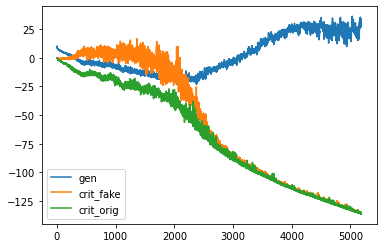

d loss fake  -135.57144165039062
d loss real  -135.90933227539062
[Epoch 15/100] [Batch 101/345] [D loss: -135.740387, acc:   0%] [G loss: 27.934744] [c1: 60.327248, c2: 60.168602, o: 55.724655, f: 60.698032] time: 3:21:54.833498
d loss fake  -135.822509765625
d loss real  -136.40892028808594
[Epoch 15/100] [Batch 102/345] [D loss: -136.115715, acc:   0%] [G loss: 25.574927] [c1: 55.720455, c2: 56.121681, o: 54.051994, f: 63.100151] time: 3:21:57.119867
d loss fake  -135.0419464111328
d loss real  -135.533447265625
[Epoch 15/100] [Batch 103/345] [D loss: -135.287697, acc:   0%] [G loss: 21.935816] [c1: 53.196304, c2: 54.630112, o: 47.062370, f: 52.577259] time: 3:21:59.397093
d loss fake  -135.80654907226562
d loss real  -135.18992614746094
[Epoch 15/100] [Batch 104/345] [D loss: -135.498238, acc:   0%] [G loss: 22.487140] [c1: 60.624786, c2: 62.149658, o: 44.102737, f: 56.142635] time: 3:22:01.670837
d loss fake  -135.9320068359375
d loss real  -135.504150390625
[Epoch 15/100] [Batch 

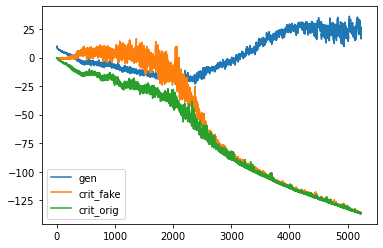

d loss fake  -136.17013549804688
d loss real  -136.41616821289062
[Epoch 15/100] [Batch 151/345] [D loss: -136.293152, acc:   0%] [G loss: 22.376159] [c1: 58.696239, c2: 58.688431, o: 44.642723, f: 57.357750] time: 3:23:50.529842
d loss fake  -135.74481201171875
d loss real  -136.689453125
[Epoch 15/100] [Batch 152/345] [D loss: -136.217133, acc:   0%] [G loss: 19.998161] [c1: 54.137409, c2: 56.005562, o: 46.098560, f: 58.953415] time: 3:23:52.813157
d loss fake  -136.67660522460938
d loss real  -137.11422729492188
[Epoch 15/100] [Batch 153/345] [D loss: -136.895416, acc:   0%] [G loss: 21.582378] [c1: 58.156124, c2: 58.532467, o: 44.990334, f: 59.332970] time: 3:23:55.080074
d loss fake  -136.507080078125
d loss real  -136.3293914794922
[Epoch 15/100] [Batch 154/345] [D loss: -136.418236, acc:   0%] [G loss: 21.490940] [c1: 57.104965, c2: 56.766670, o: 40.110695, f: 54.055443] time: 3:23:57.360545
d loss fake  -136.317138671875
d loss real  -136.8354034423828
[Epoch 15/100] [Batch 155

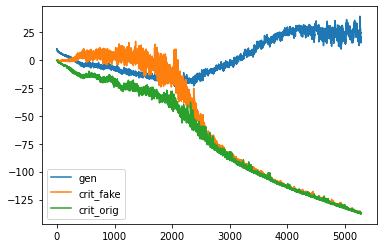

d loss fake  -136.42068481445312
d loss real  -138.09793090820312
[Epoch 15/100] [Batch 201/345] [D loss: -137.259308, acc:   0%] [G loss: 13.495877] [c1: 49.471138, c2: 49.534084, o: 41.913925, f: 57.429596] time: 3:25:45.342586
d loss fake  -137.44180297851562
d loss real  -137.67630004882812
[Epoch 15/100] [Batch 202/345] [D loss: -137.559052, acc:   0%] [G loss: 22.833250] [c1: 61.623890, c2: 62.431808, o: 30.416130, f: 52.184074] time: 3:25:47.628103
d loss fake  -137.4755401611328
d loss real  -137.7235107421875
[Epoch 15/100] [Batch 203/345] [D loss: -137.599525, acc:   0%] [G loss: 27.028269] [c1: 63.080139, c2: 62.684601, o: 48.643303, f: 60.951416] time: 3:25:49.913171
d loss fake  -137.32431030273438
d loss real  -137.31985473632812
[Epoch 15/100] [Batch 204/345] [D loss: -137.322083, acc:   0%] [G loss: 26.148463] [c1: 62.510178, c2: 62.357918, o: 50.160526, f: 61.643963] time: 3:25:52.198305
d loss fake  -137.16058349609375
d loss real  -137.12973022460938
[Epoch 15/100] [

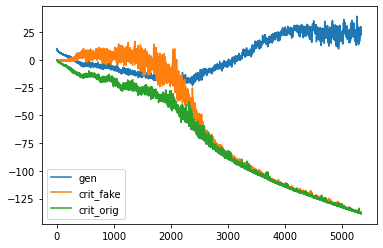

d loss fake  -138.25961303710938
d loss real  -138.3289794921875
[Epoch 15/100] [Batch 251/345] [D loss: -138.294296, acc:   0%] [G loss: 20.586263] [c1: 56.894310, c2: 57.725014, o: 47.914188, f: 56.092468] time: 3:27:41.142055
d loss fake  -138.1885986328125
d loss real  -138.232421875
[Epoch 15/100] [Batch 252/345] [D loss: -138.210510, acc:   0%] [G loss: 30.114387] [c1: 67.070351, c2: 66.117180, o: 51.341125, f: 61.834587] time: 3:27:43.433885
d loss fake  -138.3094482421875
d loss real  -138.72947692871094
[Epoch 15/100] [Batch 253/345] [D loss: -138.519463, acc:   0%] [G loss: 28.112286] [c1: 61.633751, c2: 61.710312, o: 61.226349, f: 64.259697] time: 3:27:45.717651
d loss fake  -138.00833129882812
d loss real  -138.43142700195312
[Epoch 15/100] [Batch 254/345] [D loss: -138.219879, acc:   0%] [G loss: 23.940989] [c1: 57.748833, c2: 58.633766, o: 54.733078, f: 61.454651] time: 3:27:47.998553
d loss fake  -138.36598205566406
d loss real  -138.72279357910156
[Epoch 15/100] [Batch 

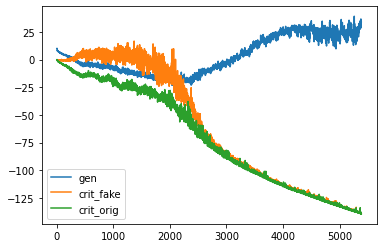

d loss fake  -138.90411376953125
d loss real  -139.02073669433594
[Epoch 15/100] [Batch 301/345] [D loss: -138.962425, acc:   0%] [G loss: 29.753171] [c1: 64.042671, c2: 64.240219, o: 62.262001, f: 66.023209] time: 3:29:37.153563
d loss fake  -139.01260375976562
d loss real  -139.056640625
[Epoch 15/100] [Batch 302/345] [D loss: -139.034622, acc:   0%] [G loss: 29.535750] [c1: 63.874340, c2: 64.237267, o: 58.675186, f: 63.780807] time: 3:29:39.442242
d loss fake  -139.25559997558594
d loss real  -138.586181640625
[Epoch 15/100] [Batch 303/345] [D loss: -138.920891, acc:   0%] [G loss: 34.141680] [c1: 69.321075, c2: 70.018692, o: 63.232738, f: 65.516174] time: 3:29:41.727187
d loss fake  -139.12109375
d loss real  -139.27450561523438
[Epoch 15/100] [Batch 304/345] [D loss: -139.197800, acc:   0%] [G loss: 31.481721] [c1: 67.969971, c2: 67.942940, o: 65.069412, f: 68.456848] time: 3:29:44.020529
d loss fake  -139.37576293945312
d loss real  -139.58843994140625
[Epoch 15/100] [Batch 305/3

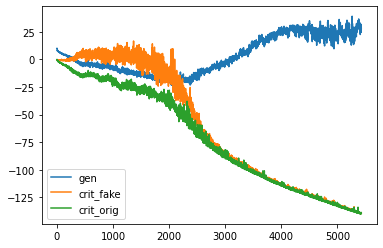

d loss fake  -139.718505859375
d loss real  -140.24481201171875
[Epoch 16/100] [Batch 1/345] [D loss: -139.981659, acc:   0%] [G loss: 26.237232] [c1: 62.662220, c2: 61.846558, o: 55.547047, f: 67.718163] time: 3:31:12.319422
d loss fake  -139.4154815673828
d loss real  -139.93270874023438
[Epoch 16/100] [Batch 2/345] [D loss: -139.674095, acc:   0%] [G loss: 22.293834] [c1: 56.422104, c2: 56.623646, o: 45.962383, f: 56.611916] time: 3:31:14.655083
d loss fake  -139.68157958984375
d loss real  -139.3791046142578
[Epoch 16/100] [Batch 3/345] [D loss: -139.530342, acc:   0%] [G loss: 25.956480] [c1: 62.214310, c2: 61.423908, o: 45.508198, f: 58.600616] time: 3:31:16.988568
d loss fake  -139.25399780273438
d loss real  -139.57044982910156
[Epoch 16/100] [Batch 4/345] [D loss: -139.412224, acc:   0%] [G loss: 22.451946] [c1: 60.072235, c2: 59.040131, o: 49.330853, f: 62.727165] time: 3:31:19.340091
d loss fake  -139.6251983642578
d loss real  -139.89279174804688
[Epoch 16/100] [Batch 5/345

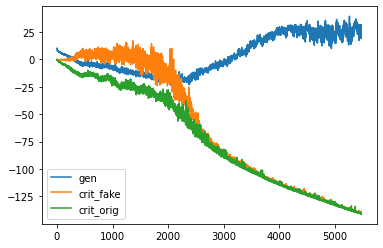

d loss fake  -137.91317749023438
d loss real  -138.9613800048828
[Epoch 16/100] [Batch 51/345] [D loss: -138.437279, acc:   0%] [G loss: 20.400363] [c1: 55.210732, c2: 56.893600, o: 51.522320, f: 57.570549] time: 3:33:07.852587
d loss fake  -140.59144592285156
d loss real  -139.5657958984375
[Epoch 16/100] [Batch 52/345] [D loss: -140.078621, acc:   0%] [G loss: 26.865462] [c1: 67.896896, c2: 68.403915, o: 48.891384, f: 58.459354] time: 3:33:10.140720
d loss fake  -140.64663696289062
d loss real  -140.53256225585938
[Epoch 16/100] [Batch 53/345] [D loss: -140.589600, acc:   0%] [G loss: 30.702097] [c1: 68.566254, c2: 67.730957, o: 64.607666, f: 69.488235] time: 3:33:12.430717
d loss fake  -140.6240234375
d loss real  -140.60031127929688
[Epoch 16/100] [Batch 54/345] [D loss: -140.612167, acc:   0%] [G loss: 29.311663] [c1: 64.217651, c2: 63.386200, o: 60.832542, f: 66.178963] time: 3:33:14.714477
d loss fake  -140.41290283203125
d loss real  -140.7560272216797
[Epoch 16/100] [Batch 55/

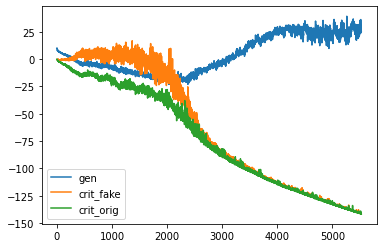

d loss fake  -141.3900604248047
d loss real  -141.33287048339844
[Epoch 16/100] [Batch 101/345] [D loss: -141.361465, acc:   0%] [G loss: 27.260800] [c1: 60.902397, c2: 61.396706, o: 55.208839, f: 58.864120] time: 3:35:03.932547
d loss fake  -141.34335327148438
d loss real  -141.22967529296875
[Epoch 16/100] [Batch 102/345] [D loss: -141.286514, acc:   0%] [G loss: 30.610131] [c1: 66.213669, c2: 66.021591, o: 56.496525, f: 63.548256] time: 3:35:06.216226
d loss fake  -141.3781280517578
d loss real  -141.16026306152344
[Epoch 16/100] [Batch 103/345] [D loss: -141.269196, acc:   0%] [G loss: 30.186559] [c1: 67.289627, c2: 65.383606, o: 60.334114, f: 66.455948] time: 3:35:08.499468
d loss fake  -141.4944305419922
d loss real  -141.74676513671875
[Epoch 16/100] [Batch 104/345] [D loss: -141.620598, acc:   0%] [G loss: 31.921960] [c1: 65.357681, c2: 64.817871, o: 63.926064, f: 68.996262] time: 3:35:10.791259
d loss fake  -141.16281127929688
d loss real  -141.43118286132812
[Epoch 16/100] [B

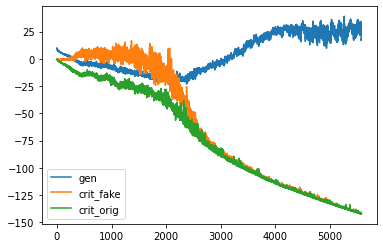

d loss fake  -141.83660888671875
d loss real  -142.08404541015625
[Epoch 16/100] [Batch 151/345] [D loss: -141.960327, acc:   0%] [G loss: 28.753528] [c1: 64.812943, c2: 65.007858, o: 41.657555, f: 57.096512] time: 3:37:00.040276
d loss fake  -141.37966918945312
d loss real  -142.14675903320312
[Epoch 16/100] [Batch 152/345] [D loss: -141.763214, acc:   0%] [G loss: 22.295682] [c1: 57.065388, c2: 58.489120, o: 50.500870, f: 61.155109] time: 3:37:02.335291
d loss fake  -140.18096923828125
d loss real  -142.4820556640625
[Epoch 16/100] [Batch 153/345] [D loss: -141.331512, acc:   0%] [G loss: 16.929427] [c1: 48.672920, c2: 46.813232, o: 47.299465, f: 57.120537] time: 3:37:04.620009
d loss fake  -140.5234375
d loss real  -142.45933532714844
[Epoch 16/100] [Batch 154/345] [D loss: -141.491386, acc:   0%] [G loss: 11.594416] [c1: 46.068195, c2: 44.744171, o: 31.727585, f: 47.542286] time: 3:37:06.905817
d loss fake  -141.21246337890625
d loss real  -141.36282348632812
[Epoch 16/100] [Batch 

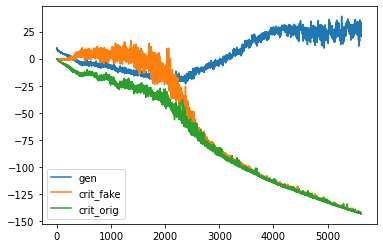

d loss fake  -142.61032104492188
d loss real  -142.85153198242188
[Epoch 16/100] [Batch 201/345] [D loss: -142.730927, acc:   0%] [G loss: 34.273729] [c1: 74.702637, c2: 72.532303, o: 53.213608, f: 68.724266] time: 3:38:54.978723
d loss fake  -141.36534118652344
d loss real  -142.6015625
[Epoch 16/100] [Batch 202/345] [D loss: -141.983452, acc:   0%] [G loss: 26.743370] [c1: 60.327934, c2: 60.470688, o: 59.982292, f: 66.474037] time: 3:38:57.274386
d loss fake  -142.7672119140625
d loss real  -143.06118774414062
[Epoch 16/100] [Batch 203/345] [D loss: -142.914200, acc:   0%] [G loss: 28.689377] [c1: 67.030212, c2: 66.244171, o: 56.249393, f: 65.931137] time: 3:38:59.555503
d loss fake  -138.699951171875
d loss real  -143.00662231445312
[Epoch 16/100] [Batch 204/345] [D loss: -140.853287, acc:   0%] [G loss: 20.051364] [c1: 52.848049, c2: 53.757835, o: 55.588200, f: 61.837143] time: 3:39:01.848809
d loss fake  -142.67996215820312
d loss real  -143.166748046875
[Epoch 16/100] [Batch 205/

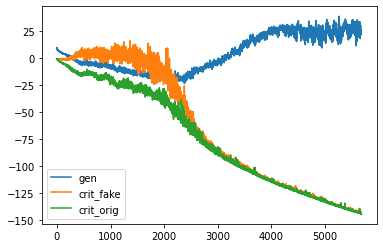

d loss fake  -143.27357482910156
d loss real  -142.90147399902344
[Epoch 16/100] [Batch 251/345] [D loss: -143.087524, acc:   0%] [G loss: 23.043268] [c1: 56.693657, c2: 57.828232, o: 44.317123, f: 52.764343] time: 3:40:51.237229
d loss fake  -143.47259521484375
d loss real  -142.9599151611328
[Epoch 16/100] [Batch 252/345] [D loss: -143.216255, acc:   0%] [G loss: 26.335474] [c1: 63.477993, c2: 64.091324, o: 51.257206, f: 59.965675] time: 3:40:53.518720
d loss fake  -143.7206573486328
d loss real  -143.70111083984375
[Epoch 16/100] [Batch 253/345] [D loss: -143.710884, acc:   0%] [G loss: 32.238989] [c1: 69.852882, c2: 68.747894, o: 58.404781, f: 67.898148] time: 3:40:55.797750
d loss fake  -143.26602172851562
d loss real  -143.23851013183594
[Epoch 16/100] [Batch 254/345] [D loss: -143.252266, acc:   0%] [G loss: 29.202997] [c1: 62.789833, c2: 63.230618, o: 62.155762, f: 64.293488] time: 3:40:58.083183
d loss fake  -143.60751342773438
d loss real  -143.07867431640625
[Epoch 16/100] [

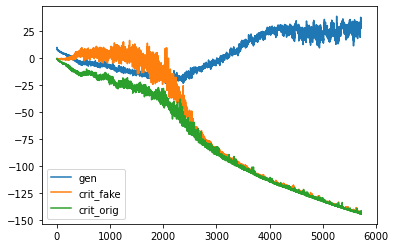

d loss fake  -144.3284149169922
d loss real  -144.51785278320312
[Epoch 16/100] [Batch 301/345] [D loss: -144.423134, acc:   0%] [G loss: 31.043120] [c1: 65.011879, c2: 64.769211, o: 64.237297, f: 68.738060] time: 3:42:47.070848
d loss fake  -144.39404296875
d loss real  -144.49105834960938
[Epoch 16/100] [Batch 302/345] [D loss: -144.442551, acc:   0%] [G loss: 29.488285] [c1: 62.943810, c2: 63.104263, o: 62.073185, f: 64.102859] time: 3:42:49.360810
d loss fake  -144.264892578125
d loss real  -144.0731964111328
[Epoch 16/100] [Batch 303/345] [D loss: -144.169044, acc:   0%] [G loss: 32.931889] [c1: 64.735733, c2: 65.751778, o: 63.391518, f: 61.126389] time: 3:42:51.642968
d loss fake  -144.2862548828125
d loss real  -144.619384765625
[Epoch 16/100] [Batch 304/345] [D loss: -144.452820, acc:   0%] [G loss: 35.183969] [c1: 70.465759, c2: 70.073563, o: 64.890137, f: 70.929466] time: 3:42:53.944378
d loss fake  -144.22509765625
d loss real  -143.30633544921875
[Epoch 16/100] [Batch 305/3

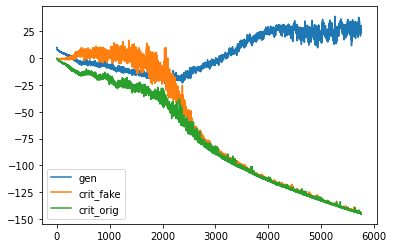

d loss fake  -143.4095458984375
d loss real  -145.07040405273438
[Epoch 17/100] [Batch 1/345] [D loss: -144.239975, acc:   0%] [G loss: 15.973419] [c1: 50.772907, c2: 50.445686, o: 39.184319, f: 52.940903] time: 3:44:22.462005
d loss fake  -144.8931427001953
d loss real  -144.79627990722656
[Epoch 17/100] [Batch 2/345] [D loss: -144.844711, acc:   0%] [G loss: 22.253823] [c1: 58.616375, c2: 56.538956, o: 39.915680, f: 52.691433] time: 3:44:24.786466
d loss fake  -143.75608825683594
d loss real  -144.88522338867188
[Epoch 17/100] [Batch 3/345] [D loss: -144.320656, acc:   0%] [G loss: 18.454277] [c1: 51.328655, c2: 49.341660, o: 44.770237, f: 55.528687] time: 3:44:27.128635
d loss fake  -144.77508544921875
d loss real  -145.1280517578125
[Epoch 17/100] [Batch 4/345] [D loss: -144.951569, acc:   0%] [G loss: 22.226012] [c1: 54.561928, c2: 54.545700, o: 40.531322, f: 50.132420] time: 3:44:29.468695
d loss fake  -144.04762268066406
d loss real  -144.21417236328125
[Epoch 17/100] [Batch 5/3

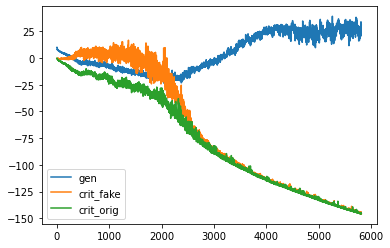

d loss fake  -145.6544647216797
d loss real  -145.62686157226562
[Epoch 17/100] [Batch 51/345] [D loss: -145.640663, acc:   0%] [G loss: 30.675643] [c1: 61.010654, c2: 61.132690, o: 65.382637, f: 63.016937] time: 3:46:17.591565
d loss fake  -145.37147521972656
d loss real  -145.3555145263672
[Epoch 17/100] [Batch 52/345] [D loss: -145.363495, acc:   0%] [G loss: 27.776108] [c1: 61.598221, c2: 62.419018, o: 61.515251, f: 61.765846] time: 3:46:19.879221
d loss fake  -145.72943115234375
d loss real  -145.552978515625
[Epoch 17/100] [Batch 53/345] [D loss: -145.641205, acc:   0%] [G loss: 29.635473] [c1: 65.052147, c2: 63.831474, o: 60.280884, f: 64.186356] time: 3:46:22.157567
d loss fake  -145.42434692382812
d loss real  -145.38165283203125
[Epoch 17/100] [Batch 54/345] [D loss: -145.403000, acc:   0%] [G loss: 25.118480] [c1: 63.154003, c2: 63.067760, o: 59.455948, f: 64.453720] time: 3:46:24.437715
d loss fake  -144.5759735107422
d loss real  -143.35894775390625
[Epoch 17/100] [Batch 5

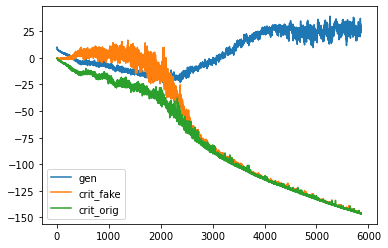

d loss fake  -146.2462615966797
d loss real  -146.552001953125
[Epoch 17/100] [Batch 101/345] [D loss: -146.399132, acc:   0%] [G loss: 26.870203] [c1: 57.761158, c2: 59.030979, o: 51.591049, f: 55.708725] time: 3:48:13.589241
d loss fake  -145.99517822265625
d loss real  -146.085205078125
[Epoch 17/100] [Batch 102/345] [D loss: -146.040192, acc:   0%] [G loss: 22.402192] [c1: 61.060326, c2: 61.775143, o: 52.435364, f: 62.621567] time: 3:48:15.876607
d loss fake  -146.43450927734375
d loss real  -146.595458984375
[Epoch 17/100] [Batch 103/345] [D loss: -146.514984, acc:   0%] [G loss: 29.614694] [c1: 66.371216, c2: 66.853516, o: 52.942089, f: 63.186390] time: 3:48:18.161421
d loss fake  -146.42080688476562
d loss real  -146.549560546875
[Epoch 17/100] [Batch 104/345] [D loss: -146.485184, acc:   0%] [G loss: 31.411214] [c1: 66.022964, c2: 63.358879, o: 58.963409, f: 65.368759] time: 3:48:20.453352
d loss fake  -146.14654541015625
d loss real  -146.7016143798828
[Epoch 17/100] [Batch 10

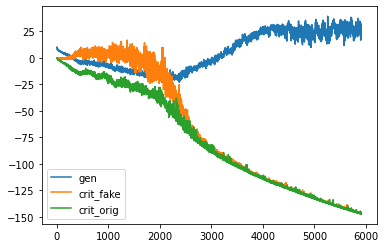

d loss fake  -146.485595703125
d loss real  -147.28219604492188
[Epoch 17/100] [Batch 151/345] [D loss: -146.883896, acc:   0%] [G loss: 16.865386] [c1: 47.890472, c2: 48.212078, o: 40.801224, f: 51.672962] time: 3:50:09.308509
d loss fake  -146.40011596679688
d loss real  -147.18067932128906
[Epoch 17/100] [Batch 152/345] [D loss: -146.790398, acc:   0%] [G loss: 15.037995] [c1: 48.127281, c2: 48.759422, o: 33.553780, f: 49.327415] time: 3:50:11.592647
d loss fake  -146.65863037109375
d loss real  -147.08851623535156
[Epoch 17/100] [Batch 153/345] [D loss: -146.873573, acc:   0%] [G loss: 15.304886] [c1: 47.544861, c2: 45.296318, o: 35.077980, f: 45.724201] time: 3:50:13.863866
d loss fake  -146.150634765625
d loss real  -146.8712921142578
[Epoch 17/100] [Batch 154/345] [D loss: -146.510963, acc:   0%] [G loss: 16.020509] [c1: 48.819260, c2: 48.206177, o: 31.793516, f: 46.932217] time: 3:50:16.141523
d loss fake  -146.013671875
d loss real  -147.3048095703125
[Epoch 17/100] [Batch 155

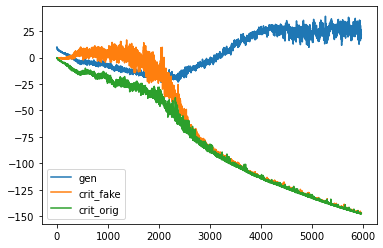

d loss fake  -147.107666015625
d loss real  -146.4734649658203
[Epoch 17/100] [Batch 201/345] [D loss: -146.790565, acc:   0%] [G loss: 21.288758] [c1: 55.948200, c2: 57.664276, o: 49.179825, f: 54.213097] time: 3:52:03.981428
d loss fake  -147.75613403320312
d loss real  -147.41839599609375
[Epoch 17/100] [Batch 202/345] [D loss: -147.587265, acc:   0%] [G loss: 24.986698] [c1: 66.914940, c2: 66.587875, o: 50.541763, f: 64.651855] time: 3:52:06.268415
d loss fake  -147.79330444335938
d loss real  -147.9503173828125
[Epoch 17/100] [Batch 203/345] [D loss: -147.871811, acc:   0%] [G loss: 29.620216] [c1: 70.461861, c2: 69.553207, o: 57.075256, f: 67.187645] time: 3:52:08.544209
d loss fake  -147.5384521484375
d loss real  -147.947998046875
[Epoch 17/100] [Batch 204/345] [D loss: -147.743225, acc:   0%] [G loss: 27.580356] [c1: 63.405910, c2: 63.298210, o: 61.522900, f: 67.881607] time: 3:52:10.817947
d loss fake  -147.7388916015625
d loss real  -148.1722869873047
[Epoch 17/100] [Batch 2

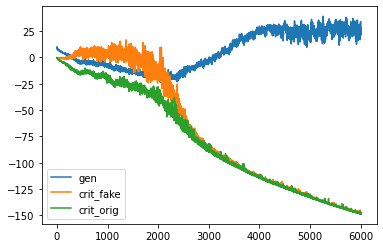

d loss fake  -148.269287109375
d loss real  -148.23089599609375
[Epoch 17/100] [Batch 251/345] [D loss: -148.250092, acc:   0%] [G loss: 28.674035] [c1: 65.025269, c2: 64.596481, o: 51.117477, f: 61.981052] time: 3:53:59.748635
d loss fake  -148.38906860351562
d loss real  -148.4178009033203
[Epoch 17/100] [Batch 252/345] [D loss: -148.403435, acc:   0%] [G loss: 30.662057] [c1: 65.879593, c2: 67.152390, o: 60.616493, f: 66.211395] time: 3:54:02.032397
d loss fake  -148.16749572753906
d loss real  -148.5513916015625
[Epoch 17/100] [Batch 253/345] [D loss: -148.359444, acc:   0%] [G loss: 28.323957] [c1: 61.108288, c2: 60.934952, o: 62.285618, f: 66.271484] time: 3:54:04.305238
d loss fake  -148.53855895996094
d loss real  -148.7535858154297
[Epoch 17/100] [Batch 254/345] [D loss: -148.646072, acc:   0%] [G loss: 24.192341] [c1: 60.185856, c2: 60.289272, o: 55.513340, f: 63.090557] time: 3:54:06.588112
d loss fake  -148.42471313476562
d loss real  -148.68475341796875
[Epoch 17/100] [Bat

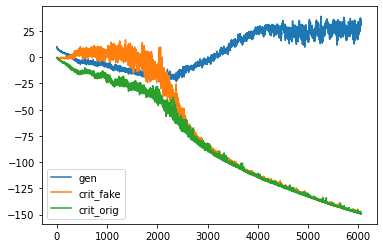

d loss fake  -148.7693634033203
d loss real  -146.72225952148438
[Epoch 17/100] [Batch 301/345] [D loss: -147.745811, acc:   0%] [G loss: 29.832749] [c1: 65.250595, c2: 65.939102, o: 53.610191, f: 64.128426] time: 3:55:55.521402
d loss fake  -149.0587158203125
d loss real  -148.5849151611328
[Epoch 17/100] [Batch 302/345] [D loss: -148.821815, acc:   0%] [G loss: 30.604834] [c1: 64.145737, c2: 65.243301, o: 61.840050, f: 64.721939] time: 3:55:57.813571
d loss fake  -149.09927368164062
d loss real  -149.2938232421875
[Epoch 17/100] [Batch 303/345] [D loss: -149.196548, acc:   0%] [G loss: 28.251107] [c1: 63.552540, c2: 62.709953, o: 62.012043, f: 68.226913] time: 3:56:00.086772
d loss fake  -148.9105224609375
d loss real  -149.22183227539062
[Epoch 17/100] [Batch 304/345] [D loss: -149.066177, acc:   0%] [G loss: 27.237366] [c1: 61.295277, c2: 60.330399, o: 56.078518, f: 60.031044] time: 3:56:02.374727
d loss fake  -149.21429443359375
d loss real  -149.27993774414062
[Epoch 17/100] [Bat

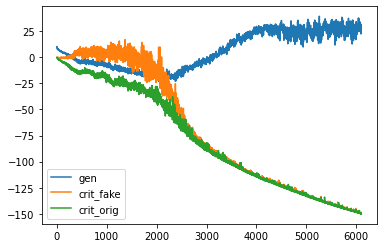

d loss fake  -149.04881286621094
d loss real  -149.84573364257812
[Epoch 18/100] [Batch 1/345] [D loss: -149.447273, acc:   0%] [G loss: 19.467567] [c1: 50.376942, c2: 51.077133, o: 44.619591, f: 52.796658] time: 3:57:30.688485
d loss fake  -149.51744079589844
d loss real  -149.81414794921875
[Epoch 18/100] [Batch 2/345] [D loss: -149.665794, acc:   0%] [G loss: 20.640393] [c1: 54.297359, c2: 55.493122, o: 41.211098, f: 50.774754] time: 3:57:33.021785
d loss fake  -149.23272705078125
d loss real  -149.27066040039062
[Epoch 18/100] [Batch 3/345] [D loss: -149.251694, acc:   0%] [G loss: 21.654526] [c1: 54.314114, c2: 54.112282, o: 42.062706, f: 51.105705] time: 3:57:35.370644
d loss fake  -149.88168334960938
d loss real  -149.9319305419922
[Epoch 18/100] [Batch 4/345] [D loss: -149.906807, acc:   0%] [G loss: 28.486287] [c1: 67.824921, c2: 66.531372, o: 46.020462, f: 62.348866] time: 3:57:37.737077
d loss fake  -149.51220703125
d loss real  -149.8785858154297
[Epoch 18/100] [Batch 5/345

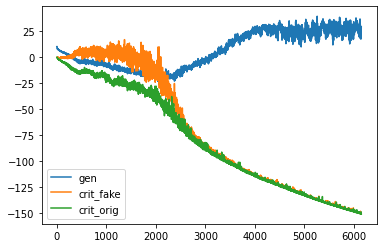

d loss fake  -149.9862060546875
d loss real  -150.4815673828125
[Epoch 18/100] [Batch 51/345] [D loss: -150.233887, acc:   0%] [G loss: 21.231264] [c1: 53.602303, c2: 54.305641, o: 50.685982, f: 56.235374] time: 3:59:25.980227
d loss fake  -150.2446746826172
d loss real  -150.10011291503906
[Epoch 18/100] [Batch 52/345] [D loss: -150.172394, acc:   0%] [G loss: 30.121771] [c1: 63.715061, c2: 62.683105, o: 51.053516, f: 56.910530] time: 3:59:28.261417
d loss fake  -149.92469787597656
d loss real  -149.52369689941406
[Epoch 18/100] [Batch 53/345] [D loss: -149.724197, acc:   0%] [G loss: 27.348543] [c1: 60.998440, c2: 61.044701, o: 59.384953, f: 64.190109] time: 3:59:30.550716
d loss fake  -150.20938110351562
d loss real  -150.3955535888672
[Epoch 18/100] [Batch 54/345] [D loss: -150.302467, acc:   0%] [G loss: 23.767743] [c1: 58.958191, c2: 60.333298, o: 56.813148, f: 61.937195] time: 3:59:32.831723
d loss fake  -150.37867736816406
d loss real  -150.49807739257812
[Epoch 18/100] [Batch 

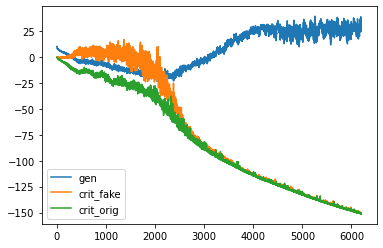

d loss fake  -150.7890625
d loss real  -151.10841369628906
[Epoch 18/100] [Batch 101/345] [D loss: -150.948738, acc:   0%] [G loss: 24.368557] [c1: 57.435097, c2: 58.383137, o: 52.988136, f: 58.755707] time: 4:01:21.878759
d loss fake  -150.89785766601562
d loss real  -151.19393920898438
[Epoch 18/100] [Batch 102/345] [D loss: -151.045898, acc:   0%] [G loss: 22.066106] [c1: 57.311794, c2: 58.208302, o: 49.654205, f: 55.993805] time: 4:01:24.168411
d loss fake  -150.94424438476562
d loss real  -151.00125122070312
[Epoch 18/100] [Batch 103/345] [D loss: -150.972748, acc:   0%] [G loss: 32.509466] [c1: 68.934799, c2: 68.111282, o: 55.551117, f: 63.671196] time: 4:01:26.444453
d loss fake  -151.04257202148438
d loss real  -151.31304931640625
[Epoch 18/100] [Batch 104/345] [D loss: -151.177811, acc:   0%] [G loss: 29.709216] [c1: 62.445755, c2: 64.444099, o: 58.291344, f: 64.149857] time: 4:01:28.738434
d loss fake  -151.09793090820312
d loss real  -151.02395629882812
[Epoch 18/100] [Batch

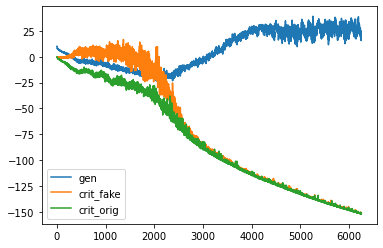

d loss fake  -151.0122528076172
d loss real  -151.65225219726562
[Epoch 18/100] [Batch 151/345] [D loss: -151.332253, acc:   0%] [G loss: 18.332790] [c1: 51.423874, c2: 53.288513, o: 37.308281, f: 50.699310] time: 4:03:18.137820
d loss fake  -150.80340576171875
d loss real  -151.31634521484375
[Epoch 18/100] [Batch 152/345] [D loss: -151.059875, acc:   0%] [G loss: 16.820642] [c1: 53.422272, c2: 53.677589, o: 38.014477, f: 53.134281] time: 4:03:20.424693
d loss fake  -151.53932189941406
d loss real  -151.83688354492188
[Epoch 18/100] [Batch 153/345] [D loss: -151.688103, acc:   0%] [G loss: 20.127497] [c1: 54.016151, c2: 52.559669, o: 40.044926, f: 52.496269] time: 4:03:22.694513
d loss fake  -151.4133758544922
d loss real  -151.65652465820312
[Epoch 18/100] [Batch 154/345] [D loss: -151.534950, acc:   0%] [G loss: 21.763865] [c1: 52.725521, c2: 52.766953, o: 45.505302, f: 51.312309] time: 4:03:24.968966
d loss fake  -151.47409057617188
d loss real  -151.55447387695312
[Epoch 18/100] [

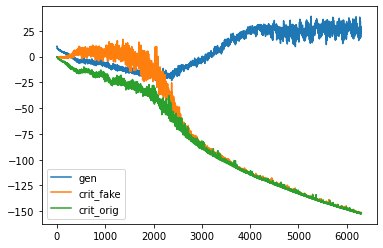

d loss fake  -151.96279907226562
d loss real  -152.53384399414062
[Epoch 18/100] [Batch 201/345] [D loss: -152.248322, acc:   0%] [G loss: 22.475349] [c1: 58.283676, c2: 58.668510, o: 53.014198, f: 62.865913] time: 4:05:12.956799
d loss fake  -152.21258544921875
d loss real  -152.74232482910156
[Epoch 18/100] [Batch 202/345] [D loss: -152.477455, acc:   0%] [G loss: 21.134065] [c1: 57.682449, c2: 54.959419, o: 49.522652, f: 61.653748] time: 4:05:15.259539
d loss fake  -152.0882110595703
d loss real  -152.1422119140625
[Epoch 18/100] [Batch 203/345] [D loss: -152.115211, acc:   0%] [G loss: 21.414954] [c1: 56.920971, c2: 55.747185, o: 41.615128, f: 53.594940] time: 4:05:17.536909
d loss fake  -152.3220977783203
d loss real  -152.44189453125
[Epoch 18/100] [Batch 204/345] [D loss: -152.381996, acc:   0%] [G loss: 23.402096] [c1: 58.073605, c2: 57.767418, o: 49.558273, f: 58.011154] time: 4:05:19.839899
d loss fake  -152.17642211914062
d loss real  -152.60308837890625
[Epoch 18/100] [Batc

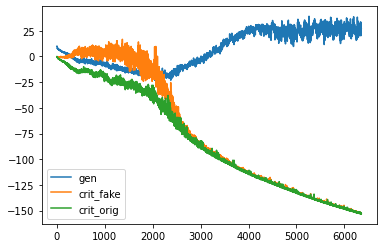

d loss fake  -152.93081665039062
d loss real  -153.04339599609375
[Epoch 18/100] [Batch 251/345] [D loss: -152.987106, acc:   0%] [G loss: 28.941178] [c1: 58.652058, c2: 58.652344, o: 63.082523, f: 63.854507] time: 4:07:09.109355
d loss fake  -152.64453125
d loss real  -151.86294555664062
[Epoch 18/100] [Batch 252/345] [D loss: -152.253738, acc:   0%] [G loss: 27.000247] [c1: 59.169044, c2: 59.153290, o: 50.438274, f: 54.992180] time: 4:07:11.393232
d loss fake  -152.80450439453125
d loss real  -151.885986328125
[Epoch 18/100] [Batch 253/345] [D loss: -152.345245, acc:   0%] [G loss: 29.469056] [c1: 64.226501, c2: 63.709198, o: 51.644501, f: 58.486488] time: 4:07:13.676760
d loss fake  -152.38299560546875
d loss real  -152.33441162109375
[Epoch 18/100] [Batch 254/345] [D loss: -152.358704, acc:   0%] [G loss: 26.672476] [c1: 62.718796, c2: 63.119987, o: 57.754951, f: 66.901855] time: 4:07:15.961226
d loss fake  -152.7301483154297
d loss real  -153.1226043701172
[Epoch 18/100] [Batch 25

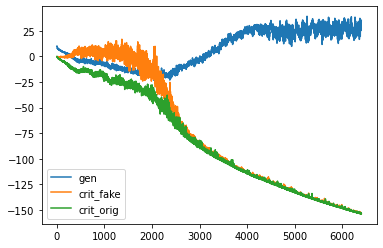

d loss fake  -153.39984130859375
d loss real  -153.82327270507812
[Epoch 18/100] [Batch 301/345] [D loss: -153.611557, acc:   0%] [G loss: 29.848606] [c1: 59.050217, c2: 58.950687, o: 60.050819, f: 61.577816] time: 4:09:04.690472
d loss fake  -153.2655029296875
d loss real  -152.51904296875
[Epoch 18/100] [Batch 302/345] [D loss: -152.892273, acc:   0%] [G loss: 30.487173] [c1: 60.368103, c2: 61.751396, o: 57.428619, f: 61.777985] time: 4:09:06.969066
d loss fake  -153.53135681152344
d loss real  -153.90362548828125
[Epoch 18/100] [Batch 303/345] [D loss: -153.717491, acc:   0%] [G loss: 27.615788] [c1: 58.513756, c2: 59.196846, o: 61.852821, f: 63.326195] time: 4:09:09.249905
d loss fake  -153.7185821533203
d loss real  -153.8083038330078
[Epoch 18/100] [Batch 304/345] [D loss: -153.763443, acc:   0%] [G loss: 27.443194] [c1: 60.995575, c2: 61.110538, o: 54.095295, f: 59.760529] time: 4:09:11.543795
d loss fake  -153.75991821289062
d loss real  -153.9759521484375
[Epoch 18/100] [Batch

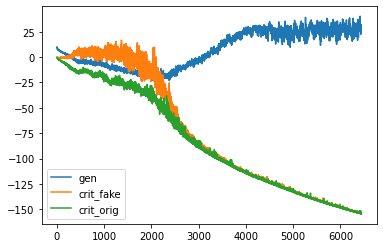

d loss fake  -154.21136474609375
d loss real  -154.17417907714844
[Epoch 19/100] [Batch 1/345] [D loss: -154.192772, acc:   0%] [G loss: 33.301787] [c1: 65.176651, c2: 63.770748, o: 60.149330, f: 63.628784] time: 4:10:40.982100
d loss fake  -153.9170684814453
d loss real  -154.41046142578125
[Epoch 19/100] [Batch 2/345] [D loss: -154.163765, acc:   0%] [G loss: 26.141739] [c1: 53.568672, c2: 54.262703, o: 60.347172, f: 61.123032] time: 4:10:43.339891
d loss fake  -153.39852905273438
d loss real  -154.43405151367188
[Epoch 19/100] [Batch 3/345] [D loss: -153.916290, acc:   0%] [G loss: 19.630897] [c1: 47.943909, c2: 49.136330, o: 51.149414, f: 55.220207] time: 4:10:45.684741
d loss fake  -154.17312622070312
d loss real  -154.30142211914062
[Epoch 19/100] [Batch 4/345] [D loss: -154.237274, acc:   0%] [G loss: 23.447172] [c1: 52.517406, c2: 52.560135, o: 40.411709, f: 46.983978] time: 4:10:48.014038
d loss fake  -152.6031951904297
d loss real  -154.3885955810547
[Epoch 19/100] [Batch 5/3

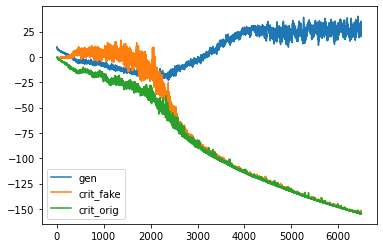

d loss fake  -154.7019805908203
d loss real  -154.97146606445312
[Epoch 19/100] [Batch 51/345] [D loss: -154.836723, acc:   0%] [G loss: 33.885460] [c1: 70.264160, c2: 69.947754, o: 58.678066, f: 64.546051] time: 4:12:35.871037
d loss fake  -154.0631103515625
d loss real  -154.54705810546875
[Epoch 19/100] [Batch 52/345] [D loss: -154.305084, acc:   0%] [G loss: 26.558078] [c1: 60.326538, c2: 60.403408, o: 64.799934, f: 67.573654] time: 4:12:38.155537
d loss fake  -154.57101440429688
d loss real  -153.65609741210938
[Epoch 19/100] [Batch 53/345] [D loss: -154.113556, acc:   0%] [G loss: 28.011583] [c1: 60.795647, c2: 62.923592, o: 55.494598, f: 58.203171] time: 4:12:40.429636
d loss fake  -154.7147674560547
d loss real  -154.99166870117188
[Epoch 19/100] [Batch 54/345] [D loss: -154.853218, acc:   0%] [G loss: 38.356410] [c1: 73.435722, c2: 72.977943, o: 66.111938, f: 65.355820] time: 4:12:42.706757
d loss fake  -154.74343872070312
d loss real  -154.95535278320312
[Epoch 19/100] [Batch

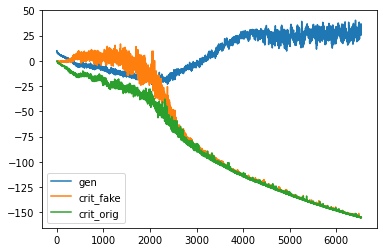

d loss fake  -155.40911865234375
d loss real  -155.7694549560547
[Epoch 19/100] [Batch 101/345] [D loss: -155.589287, acc:   0%] [G loss: 28.999936] [c1: 61.547047, c2: 62.016388, o: 65.503899, f: 70.629395] time: 4:14:31.806721
d loss fake  -155.5680389404297
d loss real  -155.6431884765625
[Epoch 19/100] [Batch 102/345] [D loss: -155.605614, acc:   0%] [G loss: 32.789567] [c1: 63.324329, c2: 62.892368, o: 58.614227, f: 61.456291] time: 4:14:34.083499
d loss fake  -155.21023559570312
d loss real  -155.22283935546875
[Epoch 19/100] [Batch 103/345] [D loss: -155.216537, acc:   0%] [G loss: 31.515726] [c1: 65.141197, c2: 64.963654, o: 59.256294, f: 63.644257] time: 4:14:36.365586
d loss fake  -154.1304931640625
d loss real  -155.881103515625
[Epoch 19/100] [Batch 104/345] [D loss: -155.005798, acc:   0%] [G loss: 21.739922] [c1: 54.521351, c2: 52.564034, o: 61.384109, f: 67.352310] time: 4:14:38.649264
d loss fake  -155.13394165039062
d loss real  -155.52200317382812
[Epoch 19/100] [Batc

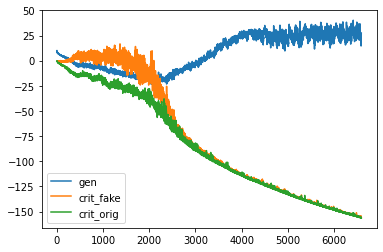

d loss fake  -155.79701232910156
d loss real  -155.7841033935547
[Epoch 19/100] [Batch 151/345] [D loss: -155.790558, acc:   0%] [G loss: 26.718882] [c1: 57.086864, c2: 58.209431, o: 51.897480, f: 57.280476] time: 4:16:27.438251
d loss fake  -155.29470825195312
d loss real  -155.79525756835938
[Epoch 19/100] [Batch 152/345] [D loss: -155.544983, acc:   0%] [G loss: 23.897454] [c1: 55.661667, c2: 55.718994, o: 49.132317, f: 57.849098] time: 4:16:29.718825
d loss fake  -155.7416534423828
d loss real  -156.2245330810547
[Epoch 19/100] [Batch 153/345] [D loss: -155.983093, acc:   0%] [G loss: 22.687963] [c1: 54.596054, c2: 53.272518, o: 48.354454, f: 56.764511] time: 4:16:31.992902
d loss fake  -154.2275390625
d loss real  -155.77780151367188
[Epoch 19/100] [Batch 154/345] [D loss: -155.002670, acc:   0%] [G loss: 17.331229] [c1: 44.716393, c2: 44.145565, o: 40.242889, f: 47.665234] time: 4:16:34.280437
d loss fake  -155.67715454101562
d loss real  -155.02684020996094
[Epoch 19/100] [Batch

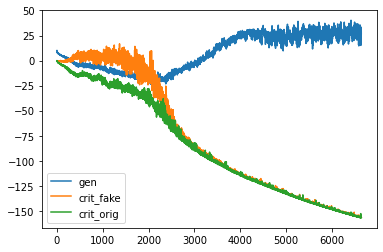

d loss fake  -156.42706298828125
d loss real  -156.830322265625
[Epoch 19/100] [Batch 201/345] [D loss: -156.628693, acc:   0%] [G loss: 33.591529] [c1: 68.475090, c2: 67.735062, o: 58.896694, f: 67.318527] time: 4:18:22.347840
d loss fake  -156.37545776367188
d loss real  -154.55418395996094
[Epoch 19/100] [Batch 202/345] [D loss: -155.464821, acc:   0%] [G loss: 32.116210] [c1: 64.077782, c2: 64.743530, o: 58.399502, f: 62.988636] time: 4:18:24.640955
d loss fake  -156.4495849609375
d loss real  -156.77870178222656
[Epoch 19/100] [Batch 203/345] [D loss: -156.614143, acc:   0%] [G loss: 28.143724] [c1: 63.050045, c2: 63.429276, o: 59.161259, f: 67.514969] time: 4:18:26.927757
d loss fake  -156.44480895996094
d loss real  -156.641845703125
[Epoch 19/100] [Batch 204/345] [D loss: -156.543327, acc:   0%] [G loss: 25.186994] [c1: 59.799400, c2: 58.825417, o: 56.021820, f: 63.643330] time: 4:18:29.220256
d loss fake  -155.70315551757812
d loss real  -155.83555603027344
[Epoch 19/100] [Bat

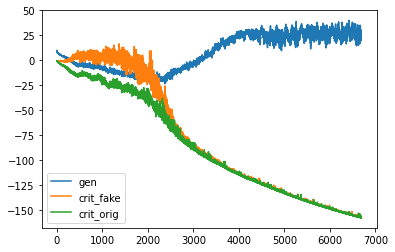

d loss fake  -156.98458862304688
d loss real  -157.43446350097656
[Epoch 19/100] [Batch 251/345] [D loss: -157.209526, acc:   0%] [G loss: 20.896073] [c1: 52.107430, c2: 51.618877, o: 50.299156, f: 58.125706] time: 4:20:18.153614
d loss fake  -157.33889770507812
d loss real  -157.26531982421875
[Epoch 19/100] [Batch 252/345] [D loss: -157.302109, acc:   0%] [G loss: 25.920752] [c1: 57.355679, c2: 57.695290, o: 42.976082, f: 50.137253] time: 4:20:20.443954
d loss fake  -157.3807373046875
d loss real  -157.30836486816406
[Epoch 19/100] [Batch 253/345] [D loss: -157.344551, acc:   0%] [G loss: 27.824160] [c1: 64.600403, c2: 63.787109, o: 48.801342, f: 59.404037] time: 4:20:22.716959
d loss fake  -157.21273803710938
d loss real  -157.46832275390625
[Epoch 19/100] [Batch 254/345] [D loss: -157.340530, acc:   0%] [G loss: 27.050807] [c1: 59.309685, c2: 58.679085, o: 56.498760, f: 63.629845] time: 4:20:25.002828
d loss fake  -157.23709106445312
d loss real  -157.32070922851562
[Epoch 19/100] 

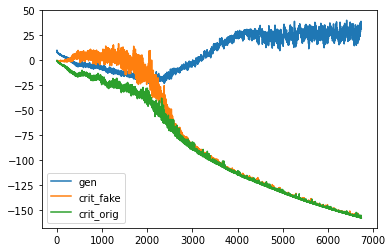

d loss fake  -157.78622436523438
d loss real  -158.09230041503906
[Epoch 19/100] [Batch 301/345] [D loss: -157.939262, acc:   0%] [G loss: 28.400866] [c1: 55.100021, c2: 55.918888, o: 58.612389, f: 62.585236] time: 4:22:14.033960
d loss fake  -157.48007202148438
d loss real  -158.0604705810547
[Epoch 19/100] [Batch 302/345] [D loss: -157.770271, acc:   0%] [G loss: 22.962695] [c1: 50.032310, c2: 51.437019, o: 49.274685, f: 52.976715] time: 4:22:16.317740
d loss fake  -157.8212890625
d loss real  -157.9008331298828
[Epoch 19/100] [Batch 303/345] [D loss: -157.861061, acc:   0%] [G loss: 23.345903] [c1: 54.406097, c2: 52.558571, o: 46.348198, f: 52.349735] time: 4:22:18.591135
d loss fake  -157.6615753173828
d loss real  -156.70578002929688
[Epoch 19/100] [Batch 304/345] [D loss: -157.183678, acc:   0%] [G loss: 27.841918] [c1: 55.987583, c2: 56.537758, o: 47.137695, f: 52.198494] time: 4:22:20.872926
d loss fake  -157.82823181152344
d loss real  -157.90786743164062
[Epoch 19/100] [Batch

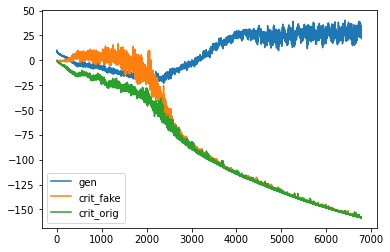

d loss fake  -158.37542724609375
d loss real  -158.5290069580078
[Epoch 20/100] [Batch 1/345] [D loss: -158.452217, acc:   0%] [G loss: 30.084555] [c1: 60.494839, c2: 60.161377, o: 47.774555, f: 54.236275] time: 4:23:49.223727
d loss fake  -158.4242401123047
d loss real  -158.28134155273438
[Epoch 20/100] [Batch 2/345] [D loss: -158.352791, acc:   0%] [G loss: 32.135012] [c1: 65.643188, c2: 64.923309, o: 54.929474, f: 60.451103] time: 4:23:51.555654
d loss fake  -158.056884765625
d loss real  -158.47732543945312
[Epoch 20/100] [Batch 3/345] [D loss: -158.267105, acc:   0%] [G loss: 28.406275] [c1: 59.485039, c2: 57.761940, o: 62.958359, f: 65.723297] time: 4:23:53.882178
d loss fake  -157.8357696533203
d loss real  -158.56130981445312
[Epoch 20/100] [Batch 4/345] [D loss: -158.198540, acc:   0%] [G loss: 24.197223] [c1: 52.226944, c2: 53.316940, o: 55.209053, f: 59.048401] time: 4:23:56.216687
d loss fake  -158.39305114746094
d loss real  -158.5252227783203
[Epoch 20/100] [Batch 5/345]

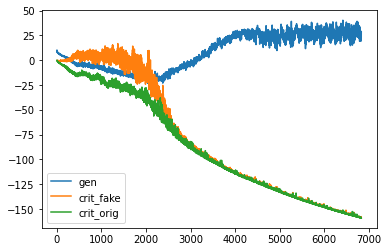

d loss fake  -158.42333984375
d loss real  -158.28240966796875
[Epoch 20/100] [Batch 51/345] [D loss: -158.352875, acc:   0%] [G loss: 23.942862] [c1: 58.467976, c2: 58.909813, o: 57.406754, f: 60.102818] time: 4:25:44.394454
d loss fake  -159.05511474609375
d loss real  -158.93154907226562
[Epoch 20/100] [Batch 52/345] [D loss: -158.993332, acc:   0%] [G loss: 28.872623] [c1: 63.168335, c2: 62.386784, o: 51.008408, f: 57.909969] time: 4:25:46.674660
d loss fake  -158.72955322265625
d loss real  -159.01019287109375
[Epoch 20/100] [Batch 53/345] [D loss: -158.869873, acc:   0%] [G loss: 25.980783] [c1: 58.975842, c2: 58.110512, o: 62.922482, f: 63.906525] time: 4:25:48.958367
d loss fake  -158.5976104736328
d loss real  -159.02371215820312
[Epoch 20/100] [Batch 54/345] [D loss: -158.810661, acc:   0%] [G loss: 23.957981] [c1: 55.697353, c2: 53.733334, o: 59.138893, f: 60.855915] time: 4:25:51.231178
d loss fake  -159.00271606445312
d loss real  -158.82986450195312
[Epoch 20/100] [Batch 

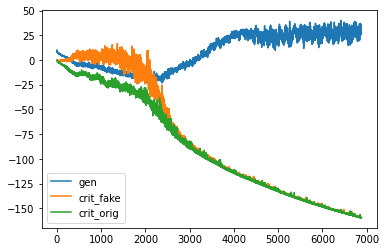

d loss fake  -158.70626831054688
d loss real  -159.4832763671875
[Epoch 20/100] [Batch 101/345] [D loss: -159.094772, acc:   0%] [G loss: 24.641846] [c1: 54.928379, c2: 54.957623, o: 57.376274, f: 59.719444] time: 4:27:40.022921
d loss fake  -159.51321411132812
d loss real  -159.56613159179688
[Epoch 20/100] [Batch 102/345] [D loss: -159.539673, acc:   0%] [G loss: 25.492665] [c1: 57.957531, c2: 57.170666, o: 49.894291, f: 53.851952] time: 4:27:42.302859
d loss fake  -159.54537963867188
d loss real  -159.72402954101562
[Epoch 20/100] [Batch 103/345] [D loss: -159.634705, acc:   0%] [G loss: 24.778955] [c1: 59.335739, c2: 59.039597, o: 52.235947, f: 60.383545] time: 4:27:44.573269
d loss fake  -159.49887084960938
d loss real  -159.42120361328125
[Epoch 20/100] [Batch 104/345] [D loss: -159.460037, acc:   0%] [G loss: 27.559121] [c1: 59.350182, c2: 59.605820, o: 50.184204, f: 55.458237] time: 4:27:46.850268
d loss fake  -159.57142639160156
d loss real  -159.80789184570312
[Epoch 20/100] 

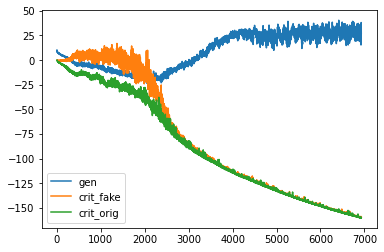

d loss fake  -159.46746826171875
d loss real  -159.96954345703125
[Epoch 20/100] [Batch 151/345] [D loss: -159.718506, acc:   0%] [G loss: 23.384742] [c1: 55.413063, c2: 54.495827, o: 50.760231, f: 57.399376] time: 4:29:35.987596
d loss fake  -159.75018310546875
d loss real  -159.9191436767578
[Epoch 20/100] [Batch 152/345] [D loss: -159.834663, acc:   0%] [G loss: 24.876377] [c1: 60.646343, c2: 59.871346, o: 48.785088, f: 58.924850] time: 4:29:38.292796
d loss fake  -159.6346435546875
d loss real  -159.58251953125
[Epoch 20/100] [Batch 153/345] [D loss: -159.608582, acc:   0%] [G loss: 25.822120] [c1: 57.780800, c2: 59.023628, o: 50.316036, f: 56.361252] time: 4:29:40.571919
d loss fake  -159.8675537109375
d loss real  -160.0465545654297
[Epoch 20/100] [Batch 154/345] [D loss: -159.957054, acc:   0%] [G loss: 24.122600] [c1: 59.330032, c2: 59.470345, o: 51.428246, f: 63.089851] time: 4:29:42.860296
d loss fake  -160.08975219726562
d loss real  -160.23562622070312
[Epoch 20/100] [Batch

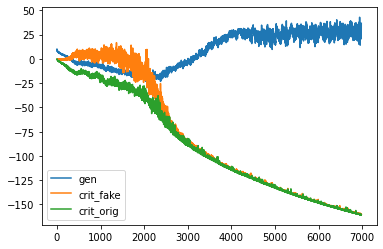

d loss fake  -160.05039978027344
d loss real  -160.76654052734375
[Epoch 20/100] [Batch 201/345] [D loss: -160.408470, acc:   0%] [G loss: 28.109629] [c1: 63.069321, c2: 63.839207, o: 69.434479, f: 73.782112] time: 4:31:30.935142
d loss fake  -160.55934143066406
d loss real  -160.71310424804688
[Epoch 20/100] [Batch 202/345] [D loss: -160.636223, acc:   0%] [G loss: 30.878125] [c1: 69.696411, c2: 68.364868, o: 56.901299, f: 66.566833] time: 4:31:33.225761
d loss fake  -160.5931854248047
d loss real  -160.90505981445312
[Epoch 20/100] [Batch 203/345] [D loss: -160.749123, acc:   0%] [G loss: 27.482822] [c1: 61.534996, c2: 60.359776, o: 58.082268, f: 65.696091] time: 4:31:35.497605
d loss fake  -160.57656860351562
d loss real  -160.74984741210938
[Epoch 20/100] [Batch 204/345] [D loss: -160.663208, acc:   0%] [G loss: 30.943246] [c1: 62.664440, c2: 63.139469, o: 51.570312, f: 58.502632] time: 4:31:37.789843
d loss fake  -160.39004516601562
d loss real  -160.5922393798828
[Epoch 20/100] [

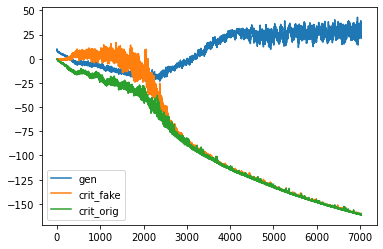

d loss fake  -161.14889526367188
d loss real  -161.36676025390625
[Epoch 20/100] [Batch 251/345] [D loss: -161.257828, acc:   0%] [G loss: 27.789300] [c1: 60.124344, c2: 59.419388, o: 54.871693, f: 63.885986] time: 4:33:27.076723
d loss fake  -160.53890991210938
d loss real  -161.14883422851562
[Epoch 20/100] [Batch 252/345] [D loss: -160.843872, acc:   0%] [G loss: 21.980137] [c1: 53.370869, c2: 53.637123, o: 49.600777, f: 58.077873] time: 4:33:29.359278
d loss fake  -161.20492553710938
d loss real  -161.41006469726562
[Epoch 20/100] [Batch 253/345] [D loss: -161.307495, acc:   0%] [G loss: 24.377443] [c1: 54.636368, c2: 54.147987, o: 48.732697, f: 54.745594] time: 4:33:31.646785
d loss fake  -161.33114624023438
d loss real  -161.28421020507812
[Epoch 20/100] [Batch 254/345] [D loss: -161.307678, acc:   0%] [G loss: 25.485729] [c1: 59.804588, c2: 59.372124, o: 45.876926, f: 56.484898] time: 4:33:33.937928
d loss fake  -161.2143096923828
d loss real  -160.56423950195312
[Epoch 20/100] 

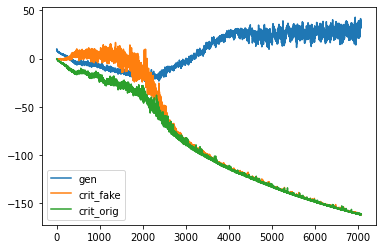

d loss fake  -161.82481384277344
d loss real  -161.52001953125
[Epoch 20/100] [Batch 301/345] [D loss: -161.672417, acc:   0%] [G loss: 37.207462] [c1: 69.480011, c2: 71.114204, o: 68.242355, f: 65.146454] time: 4:35:23.048685
d loss fake  -161.72215270996094
d loss real  -161.84259033203125
[Epoch 20/100] [Batch 302/345] [D loss: -161.782372, acc:   0%] [G loss: 33.819255] [c1: 67.493263, c2: 67.276031, o: 70.586105, f: 71.365700] time: 4:35:25.339016
d loss fake  -161.97935485839844
d loss real  -160.91787719726562
[Epoch 20/100] [Batch 303/345] [D loss: -161.448616, acc:   0%] [G loss: 37.046464] [c1: 69.995392, c2: 68.856979, o: 63.645859, f: 67.532135] time: 4:35:27.617304
d loss fake  -161.95703125
d loss real  -161.98687744140625
[Epoch 20/100] [Batch 304/345] [D loss: -161.971954, acc:   0%] [G loss: 35.136976] [c1: 66.474426, c2: 65.409775, o: 71.443977, f: 70.232620] time: 4:35:29.910770
d loss fake  -161.90127563476562
d loss real  -161.93350219726562
[Epoch 20/100] [Batch 3

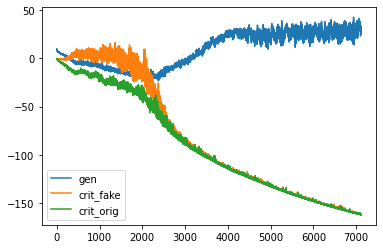

d loss fake  -161.83224487304688
d loss real  -162.4189453125
[Epoch 21/100] [Batch 1/345] [D loss: -162.125595, acc:   0%] [G loss: 24.013071] [c1: 52.445816, c2: 51.909790, o: 50.793198, f: 58.361153] time: 4:36:58.418202
d loss fake  -161.84828186035156
d loss real  -162.1843719482422
[Epoch 21/100] [Batch 2/345] [D loss: -162.016327, acc:   0%] [G loss: 22.204581] [c1: 54.611702, c2: 52.999035, o: 44.736481, f: 53.477741] time: 4:37:00.758688
d loss fake  -160.2023162841797
d loss real  -162.34910583496094
[Epoch 21/100] [Batch 3/345] [D loss: -161.275711, acc:   0%] [G loss: 16.769388] [c1: 48.137646, c2: 46.996841, o: 45.181107, f: 52.938717] time: 4:37:03.113392
d loss fake  -162.19265747070312
d loss real  -162.46807861328125
[Epoch 21/100] [Batch 4/345] [D loss: -162.330368, acc:   0%] [G loss: 18.707467] [c1: 46.843937, c2: 47.560883, o: 40.654121, f: 46.357647] time: 4:37:05.464791
d loss fake  -162.12765502929688
d loss real  -162.07830810546875
[Epoch 21/100] [Batch 5/345]

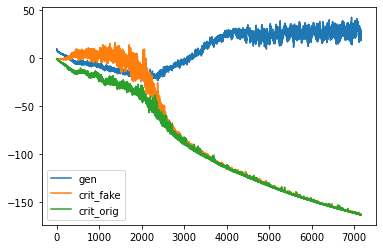

d loss fake  -162.78073120117188
d loss real  -162.90768432617188
[Epoch 21/100] [Batch 51/345] [D loss: -162.844208, acc:   0%] [G loss: 28.364209] [c1: 61.031059, c2: 60.452648, o: 59.805820, f: 62.303638] time: 4:38:53.718872
d loss fake  -162.75401306152344
d loss real  -162.97845458984375
[Epoch 21/100] [Batch 52/345] [D loss: -162.866234, acc:   0%] [G loss: 26.676984] [c1: 56.286903, c2: 57.634117, o: 60.223816, f: 62.227306] time: 4:38:56.010111
d loss fake  -162.91493225097656
d loss real  -162.88710021972656
[Epoch 21/100] [Batch 53/345] [D loss: -162.901016, acc:   0%] [G loss: 24.662835] [c1: 58.705887, c2: 57.954300, o: 52.004669, f: 56.683960] time: 4:38:58.292549
d loss fake  -162.81048583984375
d loss real  -163.1085205078125
[Epoch 21/100] [Batch 54/345] [D loss: -162.959503, acc:   0%] [G loss: 26.219310] [c1: 57.728622, c2: 56.469807, o: 58.812016, f: 60.232849] time: 4:39:00.586095
d loss fake  -162.90667724609375
d loss real  -162.8280487060547
[Epoch 21/100] [Batc

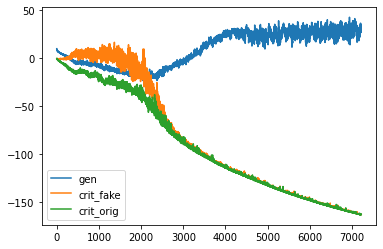

d loss fake  -163.4857635498047
d loss real  -163.33377075195312
[Epoch 21/100] [Batch 101/345] [D loss: -163.409767, acc:   0%] [G loss: 35.128336] [c1: 72.763672, c2: 72.044235, o: 62.112808, f: 66.670471] time: 4:40:49.978818
d loss fake  -163.42498779296875
d loss real  -163.3808135986328
[Epoch 21/100] [Batch 102/345] [D loss: -163.402901, acc:   0%] [G loss: 33.385586] [c1: 71.162788, c2: 70.146713, o: 66.319290, f: 72.611145] time: 4:40:52.269154
d loss fake  -163.3798828125
d loss real  -163.54071044921875
[Epoch 21/100] [Batch 103/345] [D loss: -163.460297, acc:   0%] [G loss: 27.229616] [c1: 58.328796, c2: 58.261272, o: 66.805847, f: 70.166245] time: 4:40:54.553560
d loss fake  -163.35595703125
d loss real  -163.4112548828125
[Epoch 21/100] [Batch 104/345] [D loss: -163.383606, acc:   0%] [G loss: 27.027701] [c1: 57.928406, c2: 58.179241, o: 53.156837, f: 56.881344] time: 4:40:56.845367
d loss fake  -163.4834442138672
d loss real  -163.5863800048828
[Epoch 21/100] [Batch 105/

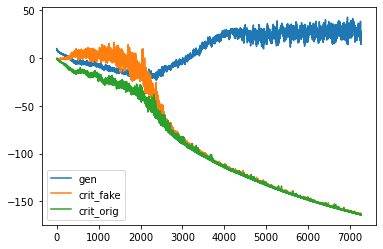

d loss fake  -163.64187622070312
d loss real  -163.87948608398438
[Epoch 21/100] [Batch 151/345] [D loss: -163.760681, acc:   0%] [G loss: 21.507736] [c1: 52.614006, c2: 51.707100, o: 38.356987, f: 50.547096] time: 4:42:45.829814
d loss fake  -163.8355712890625
d loss real  -163.91815185546875
[Epoch 21/100] [Batch 152/345] [D loss: -163.876862, acc:   0%] [G loss: 23.865400] [c1: 56.094063, c2: 55.883610, o: 45.383804, f: 53.129135] time: 4:42:48.122047
d loss fake  -163.0645751953125
d loss real  -163.7580108642578
[Epoch 21/100] [Batch 153/345] [D loss: -163.411293, acc:   0%] [G loss: 20.479275] [c1: 52.217331, c2: 50.962936, o: 44.856575, f: 53.509132] time: 4:42:50.403516
d loss fake  -163.5835723876953
d loss real  -164.04425048828125
[Epoch 21/100] [Batch 154/345] [D loss: -163.813911, acc:   0%] [G loss: 18.334446] [c1: 48.808578, c2: 49.407349, o: 41.145271, f: 52.580139] time: 4:42:52.688905
d loss fake  -163.75941467285156
d loss real  -164.12069702148438
[Epoch 21/100] [Ba

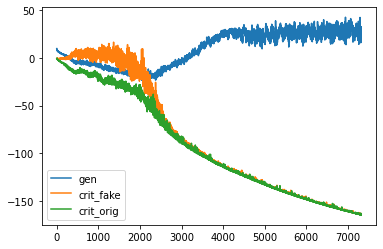

d loss fake  -164.08969116210938
d loss real  -164.4563751220703
[Epoch 21/100] [Batch 201/345] [D loss: -164.273033, acc:   0%] [G loss: 39.480743] [c1: 75.741318, c2: 74.849960, o: 61.333519, f: 66.873413] time: 4:44:41.042936
d loss fake  -163.96646118164062
d loss real  -164.13296508789062
[Epoch 21/100] [Batch 202/345] [D loss: -164.049713, acc:   0%] [G loss: 34.443340] [c1: 67.479950, c2: 67.658356, o: 72.914604, f: 73.387459] time: 4:44:43.326389
d loss fake  -163.95533752441406
d loss real  -164.6717071533203
[Epoch 21/100] [Batch 203/345] [D loss: -164.313522, acc:   0%] [G loss: 25.204463] [c1: 54.863121, c2: 57.208397, o: 65.495155, f: 67.544907] time: 4:44:45.603940
d loss fake  -164.12942504882812
d loss real  -164.39642333984375
[Epoch 21/100] [Batch 204/345] [D loss: -164.262924, acc:   0%] [G loss: 23.844553] [c1: 56.177563, c2: 56.280449, o: 48.609451, f: 55.606575] time: 4:44:47.887550
d loss fake  -164.41024780273438
d loss real  -164.68275451660156
[Epoch 21/100] [

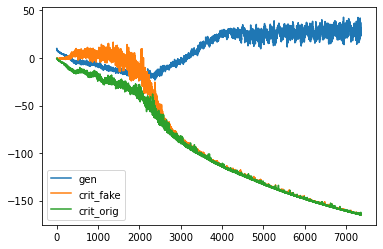

d loss fake  -164.92324829101562
d loss real  -164.80953979492188
[Epoch 21/100] [Batch 251/345] [D loss: -164.866394, acc:   0%] [G loss: 29.955018] [c1: 62.132458, c2: 61.434814, o: 56.142494, f: 61.253002] time: 4:46:36.723107
d loss fake  -164.68682861328125
d loss real  -165.17086791992188
[Epoch 21/100] [Batch 252/345] [D loss: -164.928848, acc:   0%] [G loss: 24.053585] [c1: 55.372566, c2: 54.279339, o: 56.052483, f: 63.833832] time: 4:46:39.003572
d loss fake  -164.97683715820312
d loss real  -165.17953491210938
[Epoch 21/100] [Batch 253/345] [D loss: -165.078186, acc:   0%] [G loss: 24.889776] [c1: 56.706982, c2: 55.425095, o: 49.403900, f: 57.350368] time: 4:46:41.282650
d loss fake  -165.04823303222656
d loss real  -165.1765594482422
[Epoch 21/100] [Batch 254/345] [D loss: -165.112396, acc:   0%] [G loss: 26.278195] [c1: 53.591393, c2: 53.555664, o: 48.551735, f: 52.670929] time: 4:46:43.565331
d loss fake  -165.0258331298828
d loss real  -164.7874755859375
[Epoch 21/100] [B

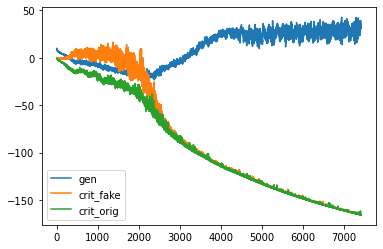

d loss fake  -165.36656188964844
d loss real  -165.5050811767578
[Epoch 21/100] [Batch 301/345] [D loss: -165.435822, acc:   0%] [G loss: 36.184725] [c1: 65.618065, c2: 66.086395, o: 61.283134, f: 62.105267] time: 4:48:32.461149
d loss fake  -165.54409790039062
d loss real  -165.6685028076172
[Epoch 21/100] [Batch 302/345] [D loss: -165.606300, acc:   0%] [G loss: 33.626373] [c1: 63.948311, c2: 63.066204, o: 64.339050, f: 67.166512] time: 4:48:34.749126
d loss fake  -165.28829956054688
d loss real  -165.68081665039062
[Epoch 21/100] [Batch 303/345] [D loss: -165.484558, acc:   0%] [G loss: 27.048022] [c1: 52.908611, c2: 53.033779, o: 59.936813, f: 60.447411] time: 4:48:37.037298
d loss fake  -165.44863891601562
d loss real  -165.7655029296875
[Epoch 21/100] [Batch 304/345] [D loss: -165.607071, acc:   0%] [G loss: 24.408636] [c1: 54.434185, c2: 53.259575, o: 51.102478, f: 55.201843] time: 4:48:39.314994
d loss fake  -165.46945190429688
d loss real  -165.59457397460938
[Epoch 21/100] [B

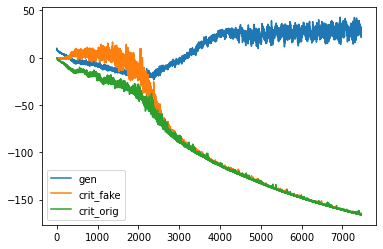

d loss fake  -165.89791870117188
d loss real  -166.07171630859375
[Epoch 22/100] [Batch 1/345] [D loss: -165.984818, acc:   0%] [G loss: 20.601555] [c1: 49.524155, c2: 48.356834, o: 45.054569, f: 48.585911] time: 4:50:07.593672
d loss fake  -165.9830322265625
d loss real  -165.99180603027344
[Epoch 22/100] [Batch 2/345] [D loss: -165.987419, acc:   0%] [G loss: 25.093405] [c1: 53.663799, c2: 51.984798, o: 42.601063, f: 46.885490] time: 4:50:09.911208
d loss fake  -165.36380004882812
d loss real  -165.8286895751953
[Epoch 22/100] [Batch 3/345] [D loss: -165.596245, acc:   0%] [G loss: 24.177100] [c1: 49.301224, c2: 49.037384, o: 50.835133, f: 51.916309] time: 4:50:12.235824
d loss fake  -164.68173217773438
d loss real  -166.06028747558594
[Epoch 22/100] [Batch 4/345] [D loss: -165.371010, acc:   0%] [G loss: 16.728351] [c1: 39.301567, c2: 39.832664, o: 47.006065, f: 47.482807] time: 4:50:14.563929
d loss fake  -165.9473876953125
d loss real  -165.73458862304688
[Epoch 22/100] [Batch 5/3

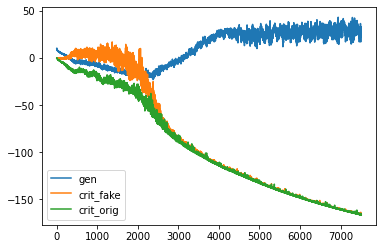

d loss fake  -166.3416290283203
d loss real  -166.08578491210938
[Epoch 22/100] [Batch 51/345] [D loss: -166.213707, acc:   0%] [G loss: 29.705169] [c1: 65.359764, c2: 64.458748, o: 62.746384, f: 65.957474] time: 4:52:02.623385
d loss fake  -166.40054321289062
d loss real  -166.45574951171875
[Epoch 22/100] [Batch 52/345] [D loss: -166.428146, acc:   0%] [G loss: 29.841521] [c1: 61.036331, c2: 62.340202, o: 62.848858, f: 63.111740] time: 4:52:04.898160
d loss fake  -166.35635375976562
d loss real  -166.36688232421875
[Epoch 22/100] [Batch 53/345] [D loss: -166.361618, acc:   0%] [G loss: 32.911119] [c1: 68.413010, c2: 69.107964, o: 58.172646, f: 62.176872] time: 4:52:07.180111
d loss fake  -166.4853057861328
d loss real  -166.5213623046875
[Epoch 22/100] [Batch 54/345] [D loss: -166.503334, acc:   0%] [G loss: 32.464610] [c1: 66.533363, c2: 66.838341, o: 67.890350, f: 68.478973] time: 4:52:09.464833
d loss fake  -166.2688446044922
d loss real  -166.54815673828125
[Epoch 22/100] [Batch 

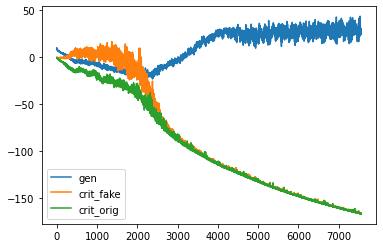

d loss fake  -166.9520263671875
d loss real  -167.064208984375
[Epoch 22/100] [Batch 101/345] [D loss: -167.008118, acc:   0%] [G loss: 29.467698] [c1: 66.601883, c2: 65.663635, o: 58.460285, f: 65.544449] time: 4:53:58.521055
d loss fake  -166.9686279296875
d loss real  -167.02572631835938
[Epoch 22/100] [Batch 102/345] [D loss: -166.997177, acc:   0%] [G loss: 28.649093] [c1: 61.434399, c2: 59.727814, o: 62.503841, f: 63.213318] time: 4:54:00.814522
d loss fake  -166.92449951171875
d loss real  -167.0206756591797
[Epoch 22/100] [Batch 103/345] [D loss: -166.972588, acc:   0%] [G loss: 30.207134] [c1: 61.546814, c2: 60.662094, o: 56.246037, f: 60.963234] time: 4:54:03.100840
d loss fake  -166.8468017578125
d loss real  -167.16342163085938
[Epoch 22/100] [Batch 104/345] [D loss: -167.005112, acc:   0%] [G loss: 26.204930] [c1: 55.699745, c2: 56.504230, o: 56.707649, f: 60.604477] time: 4:54:05.394231
d loss fake  -166.4909210205078
d loss real  -166.9013671875
[Epoch 22/100] [Batch 105

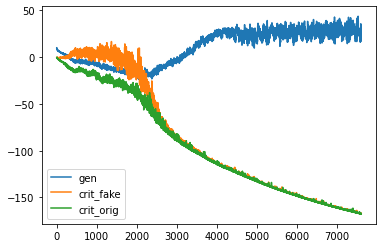

d loss fake  -167.23455810546875
d loss real  -167.5861358642578
[Epoch 22/100] [Batch 151/345] [D loss: -167.410347, acc:   0%] [G loss: 21.741230] [c1: 48.694893, c2: 48.728050, o: 49.480927, f: 53.413567] time: 4:55:54.632824
d loss fake  -167.28997802734375
d loss real  -167.62548828125
[Epoch 22/100] [Batch 152/345] [D loss: -167.457733, acc:   0%] [G loss: 23.001632] [c1: 48.603775, c2: 49.093567, o: 44.228813, f: 49.851685] time: 4:55:56.914061
d loss fake  -167.2342071533203
d loss real  -167.46176147460938
[Epoch 22/100] [Batch 153/345] [D loss: -167.347984, acc:   0%] [G loss: 29.768234] [c1: 61.604332, c2: 61.789162, o: 42.863731, f: 50.372719] time: 4:55:59.192916
d loss fake  -166.780517578125
d loss real  -167.63145446777344
[Epoch 22/100] [Batch 154/345] [D loss: -167.205986, acc:   0%] [G loss: 21.263314] [c1: 47.467201, c2: 48.005939, o: 55.103485, f: 58.080208] time: 4:56:01.481369
d loss fake  -166.51708984375
d loss real  -167.45526123046875
[Epoch 22/100] [Batch 15

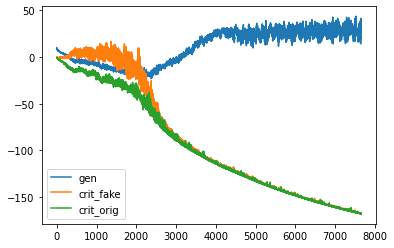

d loss fake  -167.94236755371094
d loss real  -168.06253051757812
[Epoch 22/100] [Batch 201/345] [D loss: -168.002449, acc:   0%] [G loss: 28.070637] [c1: 64.103607, c2: 63.794342, o: 56.796371, f: 65.157059] time: 4:57:49.383577
d loss fake  -167.4034423828125
d loss real  -167.66241455078125
[Epoch 22/100] [Batch 202/345] [D loss: -167.532928, acc:   0%] [G loss: 25.372517] [c1: 54.925419, c2: 55.813896, o: 56.802879, f: 57.804512] time: 4:57:51.671264
d loss fake  -167.76657104492188
d loss real  -167.8199462890625
[Epoch 22/100] [Batch 203/345] [D loss: -167.793259, acc:   0%] [G loss: 24.752562] [c1: 60.479992, c2: 60.431900, o: 52.064468, f: 59.842331] time: 4:57:53.942177
d loss fake  -167.17950439453125
d loss real  -167.96981811523438
[Epoch 22/100] [Batch 204/345] [D loss: -167.574661, acc:   0%] [G loss: 21.903488] [c1: 52.246944, c2: 50.563744, o: 54.446732, f: 59.358475] time: 4:57:56.224451
d loss fake  -167.5010986328125
d loss real  -167.84043884277344
[Epoch 22/100] [B

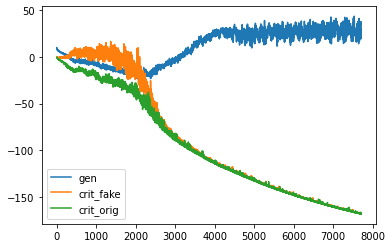

d loss fake  -168.31942749023438
d loss real  -168.40631103515625
[Epoch 22/100] [Batch 251/345] [D loss: -168.362869, acc:   0%] [G loss: 36.361994] [c1: 66.887299, c2: 66.456276, o: 65.500580, f: 68.978989] time: 4:59:45.147096
d loss fake  -168.42462158203125
d loss real  -168.4293212890625
[Epoch 22/100] [Batch 252/345] [D loss: -168.426971, acc:   0%] [G loss: 36.630592] [c1: 70.710526, c2: 70.228851, o: 65.629730, f: 67.527451] time: 4:59:47.440643
d loss fake  -168.32315063476562
d loss real  -168.42506408691406
[Epoch 22/100] [Batch 253/345] [D loss: -168.374107, acc:   0%] [G loss: 39.757169] [c1: 73.735619, c2: 73.034271, o: 66.664200, f: 70.518471] time: 4:59:49.727124
d loss fake  -168.44512939453125
d loss real  -168.54852294921875
[Epoch 22/100] [Batch 254/345] [D loss: -168.496826, acc:   0%] [G loss: 35.029377] [c1: 71.031769, c2: 70.768089, o: 71.306984, f: 75.053558] time: 4:59:52.008092
d loss fake  -168.49014282226562
d loss real  -168.52178955078125
[Epoch 22/100] 

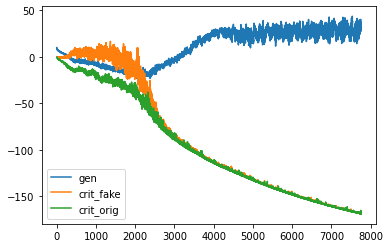

d loss fake  -168.88536071777344
d loss real  -169.08145141601562
[Epoch 22/100] [Batch 301/345] [D loss: -168.983406, acc:   0%] [G loss: 31.615873] [c1: 63.017616, c2: 63.028404, o: 61.094543, f: 61.567528] time: 5:01:40.760667
d loss fake  -168.79721069335938
d loss real  -167.98031616210938
[Epoch 22/100] [Batch 302/345] [D loss: -168.388763, acc:   0%] [G loss: 32.728816] [c1: 60.910927, c2: 62.192772, o: 58.830795, f: 59.816753] time: 5:01:43.043277
d loss fake  -168.53457641601562
d loss real  -168.74002075195312
[Epoch 22/100] [Batch 303/345] [D loss: -168.637299, acc:   0%] [G loss: 29.730452] [c1: 59.677528, c2: 59.504154, o: 60.603024, f: 63.050941] time: 5:01:45.322093
d loss fake  -168.71214294433594
d loss real  -168.9592742919922
[Epoch 22/100] [Batch 304/345] [D loss: -168.835709, acc:   0%] [G loss: 24.574012] [c1: 51.880936, c2: 51.431667, o: 57.181618, f: 59.360359] time: 5:01:47.599374
d loss fake  -168.97787475585938
d loss real  -168.88851928710938
[Epoch 22/100] 

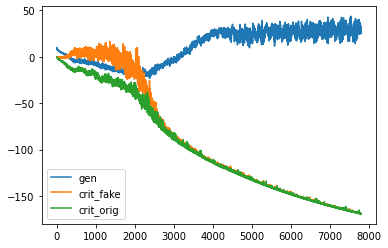

d loss fake  -169.26451110839844
d loss real  -169.47906494140625
[Epoch 23/100] [Batch 1/345] [D loss: -169.371788, acc:   0%] [G loss: 26.214315] [c1: 48.967682, c2: 48.703529, o: 51.967346, f: 53.271759] time: 5:03:17.229851
d loss fake  -168.48504638671875
d loss real  -169.38412475585938
[Epoch 23/100] [Batch 2/345] [D loss: -168.934586, acc:   0%] [G loss: 19.073598] [c1: 44.271416, c2: 44.026569, o: 45.886971, f: 49.151794] time: 5:03:19.608270
d loss fake  -169.05416870117188
d loss real  -169.4188995361328
[Epoch 23/100] [Batch 3/345] [D loss: -169.236534, acc:   0%] [G loss: 17.101727] [c1: 40.662071, c2: 40.964558, o: 42.207649, f: 45.019077] time: 5:03:21.953861
d loss fake  -168.90347290039062
d loss real  -169.4332275390625
[Epoch 23/100] [Batch 4/345] [D loss: -169.168350, acc:   0%] [G loss: 15.333906] [c1: 38.912159, c2: 39.451775, o: 32.153687, f: 38.135468] time: 5:03:24.284174
d loss fake  -168.7351531982422
d loss real  -168.95849609375
[Epoch 23/100] [Batch 5/345]

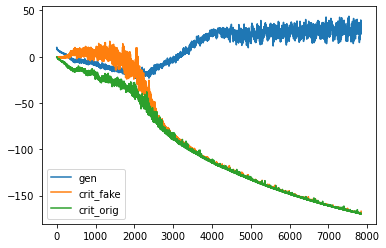

d loss fake  -169.68130493164062
d loss real  -169.72381591796875
[Epoch 23/100] [Batch 51/345] [D loss: -169.702560, acc:   0%] [G loss: 27.303205] [c1: 57.917259, c2: 57.449471, o: 55.439308, f: 59.838474] time: 5:05:12.135685
d loss fake  -169.4731903076172
d loss real  -168.47650146484375
[Epoch 23/100] [Batch 52/345] [D loss: -168.974846, acc:   0%] [G loss: 25.284921] [c1: 57.562229, c2: 57.783962, o: 47.259201, f: 53.964180] time: 5:05:14.432007
d loss fake  -169.7632293701172
d loss real  -169.80996704101562
[Epoch 23/100] [Batch 53/345] [D loss: -169.786598, acc:   0%] [G loss: 28.810046] [c1: 62.252663, c2: 61.993088, o: 52.832066, f: 59.873459] time: 5:05:16.722415
d loss fake  -169.62307739257812
d loss real  -169.79928588867188
[Epoch 23/100] [Batch 54/345] [D loss: -169.711182, acc:   0%] [G loss: 26.002775] [c1: 57.538776, c2: 56.778759, o: 57.330116, f: 60.825516] time: 5:05:19.004878
d loss fake  -168.783935546875
d loss real  -169.8453369140625
[Epoch 23/100] [Batch 5

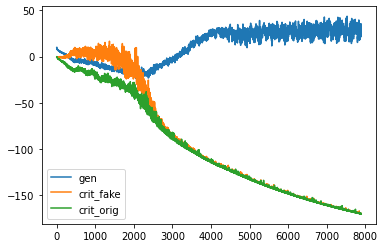

d loss fake  -170.14584350585938
d loss real  -170.25213623046875
[Epoch 23/100] [Batch 101/345] [D loss: -170.198990, acc:   0%] [G loss: 22.305959] [c1: 53.341194, c2: 53.525612, o: 44.989075, f: 51.144882] time: 5:07:08.211013
d loss fake  -170.19073486328125
d loss real  -170.26425170898438
[Epoch 23/100] [Batch 102/345] [D loss: -170.227493, acc:   0%] [G loss: 25.982155] [c1: 57.250343, c2: 56.117218, o: 53.018112, f: 54.148281] time: 5:07:10.497089
d loss fake  -170.01446533203125
d loss real  -170.16957092285156
[Epoch 23/100] [Batch 103/345] [D loss: -170.092018, acc:   0%] [G loss: 25.097139] [c1: 54.243416, c2: 53.870712, o: 51.752018, f: 53.265945] time: 5:07:12.771721
d loss fake  -170.09674072265625
d loss real  -170.01364135742188
[Epoch 23/100] [Batch 104/345] [D loss: -170.055191, acc:   0%] [G loss: 26.207358] [c1: 57.657070, c2: 57.954792, o: 52.859840, f: 55.730927] time: 5:07:15.060448
d loss fake  -169.74087524414062
d loss real  -169.7474365234375
[Epoch 23/100] 

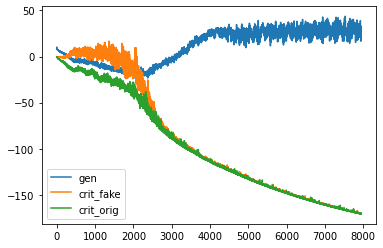

d loss fake  -170.42205810546875
d loss real  -170.62603759765625
[Epoch 23/100] [Batch 151/345] [D loss: -170.524048, acc:   0%] [G loss: 27.981384] [c1: 59.689182, c2: 58.859516, o: 52.224091, f: 60.111275] time: 5:09:03.904881
d loss fake  -170.52894592285156
d loss real  -170.8443603515625
[Epoch 23/100] [Batch 152/345] [D loss: -170.686653, acc:   0%] [G loss: 27.018269] [c1: 56.947472, c2: 58.212856, o: 55.809025, f: 59.035847] time: 5:09:06.189021
d loss fake  -170.5001678466797
d loss real  -170.75094604492188
[Epoch 23/100] [Batch 153/345] [D loss: -170.625557, acc:   0%] [G loss: 22.607545] [c1: 52.965725, c2: 52.194382, o: 49.128288, f: 57.761879] time: 5:09:08.461967
d loss fake  -170.14761352539062
d loss real  -170.60830688476562
[Epoch 23/100] [Batch 154/345] [D loss: -170.377960, acc:   0%] [G loss: 19.373087] [c1: 47.989006, c2: 47.971222, o: 45.498772, f: 49.979069] time: 5:09:10.739723
d loss fake  -170.20559692382812
d loss real  -170.71841430664062
[Epoch 23/100] [

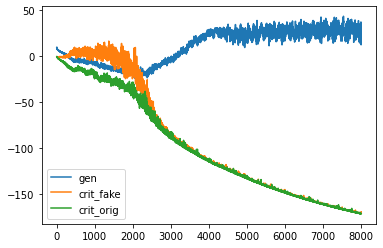

d loss fake  -170.85804748535156
d loss real  -171.14492797851562
[Epoch 23/100] [Batch 201/345] [D loss: -171.001488, acc:   0%] [G loss: 12.958294] [c1: 39.307060, c2: 38.382896, o: 31.774332, f: 36.441265] time: 5:10:58.872123
d loss fake  -170.95565795898438
d loss real  -171.11822509765625
[Epoch 23/100] [Batch 202/345] [D loss: -171.036942, acc:   0%] [G loss: 16.453229] [c1: 42.954041, c2: 42.307358, o: 33.821224, f: 38.802956] time: 5:11:01.164247
d loss fake  -170.94163513183594
d loss real  -171.16624450683594
[Epoch 23/100] [Batch 203/345] [D loss: -171.053940, acc:   0%] [G loss: 21.722743] [c1: 50.354439, c2: 50.213150, o: 34.342716, f: 42.745026] time: 5:11:03.437940
d loss fake  -170.8504180908203
d loss real  -170.52796936035156
[Epoch 23/100] [Batch 204/345] [D loss: -170.689194, acc:   0%] [G loss: 25.154028] [c1: 55.533215, c2: 54.598011, o: 43.278374, f: 52.151283] time: 5:11:05.722234
d loss fake  -170.31390380859375
d loss real  -171.04046630859375
[Epoch 23/100] 

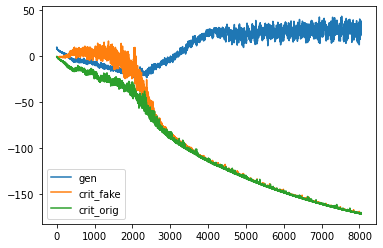

d loss fake  -171.4142608642578
d loss real  -171.54075622558594
[Epoch 23/100] [Batch 251/345] [D loss: -171.477509, acc:   0%] [G loss: 31.025575] [c1: 58.092255, c2: 58.414131, o: 57.746490, f: 57.931564] time: 5:12:55.042628
d loss fake  -171.47125244140625
d loss real  -171.48216247558594
[Epoch 23/100] [Batch 252/345] [D loss: -171.476707, acc:   0%] [G loss: 35.207386] [c1: 64.773682, c2: 64.799667, o: 57.971565, f: 57.911980] time: 5:12:57.333014
d loss fake  -171.49557495117188
d loss real  -171.65969848632812
[Epoch 23/100] [Batch 253/345] [D loss: -171.577637, acc:   0%] [G loss: 29.849797] [c1: 63.384796, c2: 63.185318, o: 64.821404, f: 68.805763] time: 5:12:59.623734
d loss fake  -171.5592498779297
d loss real  -171.46353149414062
[Epoch 23/100] [Batch 254/345] [D loss: -171.511391, acc:   0%] [G loss: 34.595131] [c1: 67.453247, c2: 67.894272, o: 57.761433, f: 61.332607] time: 5:13:01.919060
d loss fake  -171.3876190185547
d loss real  -171.6304931640625
[Epoch 23/100] [Ba

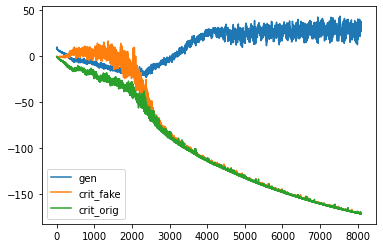

d loss fake  -171.91078186035156
d loss real  -172.0087890625
[Epoch 23/100] [Batch 301/345] [D loss: -171.959785, acc:   0%] [G loss: 31.684822] [c1: 63.767845, c2: 63.283199, o: 66.018845, f: 68.526077] time: 5:14:51.298858
d loss fake  -171.86109924316406
d loss real  -171.9442901611328
[Epoch 23/100] [Batch 302/345] [D loss: -171.902695, acc:   0%] [G loss: 34.309272] [c1: 65.049660, c2: 65.091232, o: 63.226547, f: 63.979347] time: 5:14:53.581010
d loss fake  -171.86529541015625
d loss real  -172.05455017089844
[Epoch 23/100] [Batch 303/345] [D loss: -171.959923, acc:   0%] [G loss: 28.256924] [c1: 58.214207, c2: 58.174309, o: 60.690121, f: 63.480293] time: 5:14:55.873227
d loss fake  -171.9491424560547
d loss real  -172.00965881347656
[Epoch 23/100] [Batch 304/345] [D loss: -171.979401, acc:   0%] [G loss: 33.270311] [c1: 63.497475, c2: 63.107899, o: 61.829353, f: 63.283108] time: 5:14:58.159554
d loss fake  -172.0425567626953
d loss real  -171.95901489257812
[Epoch 23/100] [Batch

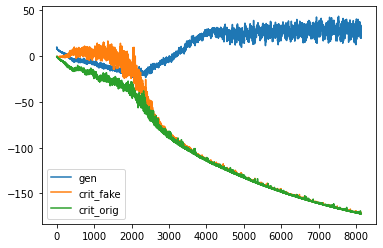

d loss fake  -171.6776885986328
d loss real  -172.38198852539062
[Epoch 24/100] [Batch 1/345] [D loss: -172.029839, acc:   0%] [G loss: 17.506410] [c1: 43.745247, c2: 41.536469, o: 36.894806, f: 42.361183] time: 5:16:26.464380
d loss fake  -171.90142822265625
d loss real  -172.30149841308594
[Epoch 24/100] [Batch 2/345] [D loss: -172.101463, acc:   0%] [G loss: 16.786555] [c1: 42.793896, c2: 41.779594, o: 36.699867, f: 40.633942] time: 5:16:28.822417
d loss fake  -170.9293212890625
d loss real  -171.89431762695312
[Epoch 24/100] [Batch 3/345] [D loss: -171.411819, acc:   0%] [G loss: 14.691494] [c1: 42.109840, c2: 42.485031, o: 34.340023, f: 42.177094] time: 5:16:31.192003
d loss fake  -172.21958923339844
d loss real  -172.4073486328125
[Epoch 24/100] [Batch 4/345] [D loss: -172.313469, acc:   0%] [G loss: 18.754546] [c1: 45.687084, c2: 46.116043, o: 39.898853, f: 43.435745] time: 5:16:33.576593
d loss fake  -172.27340698242188
d loss real  -171.91143798828125
[Epoch 24/100] [Batch 5/3

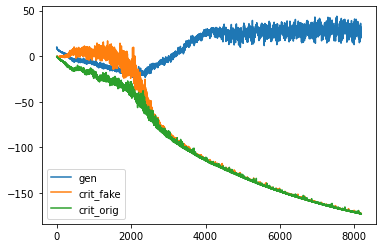

d loss fake  -172.3226318359375
d loss real  -172.27989196777344
[Epoch 24/100] [Batch 51/345] [D loss: -172.301262, acc:   0%] [G loss: 23.702441] [c1: 50.498901, c2: 51.984142, o: 49.826733, f: 49.853226] time: 5:18:22.031982
d loss fake  -172.72381591796875
d loss real  -172.841552734375
[Epoch 24/100] [Batch 52/345] [D loss: -172.782684, acc:   0%] [G loss: 28.569330] [c1: 63.907173, c2: 64.525421, o: 49.042427, f: 57.476181] time: 5:18:24.321285
d loss fake  -172.80613708496094
d loss real  -172.471435546875
[Epoch 24/100] [Batch 53/345] [D loss: -172.638786, acc:   0%] [G loss: 30.117555] [c1: 62.885536, c2: 62.769745, o: 59.211906, f: 60.130444] time: 5:18:26.607828
d loss fake  -172.72549438476562
d loss real  -172.8634490966797
[Epoch 24/100] [Batch 54/345] [D loss: -172.794472, acc:   0%] [G loss: 31.310278] [c1: 64.533875, c2: 64.570114, o: 65.372131, f: 64.841942] time: 5:18:28.891877
d loss fake  -172.7251434326172
d loss real  -172.80010986328125
[Epoch 24/100] [Batch 55/

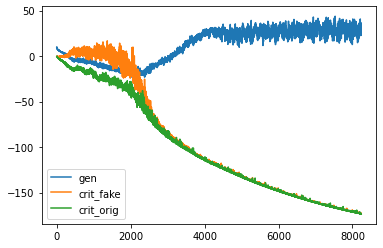

d loss fake  -173.0181884765625
d loss real  -173.3141326904297
[Epoch 24/100] [Batch 101/345] [D loss: -173.166161, acc:   0%] [G loss: 31.710128] [c1: 64.443810, c2: 63.525108, o: 47.159870, f: 53.291145] time: 5:20:18.072143
d loss fake  -172.93466186523438
d loss real  -173.30418395996094
[Epoch 24/100] [Batch 102/345] [D loss: -173.119423, acc:   0%] [G loss: 27.271596] [c1: 57.158707, c2: 57.286736, o: 62.255814, f: 61.086319] time: 5:20:20.370724
d loss fake  -173.05337524414062
d loss real  -173.18148803710938
[Epoch 24/100] [Batch 103/345] [D loss: -173.117432, acc:   0%] [G loss: 37.603443] [c1: 71.074570, c2: 71.241508, o: 56.600765, f: 59.615685] time: 5:20:22.652067
d loss fake  -173.0255584716797
d loss real  -171.88504028320312
[Epoch 24/100] [Batch 104/345] [D loss: -172.455299, acc:   0%] [G loss: 35.956233] [c1: 67.586670, c2: 67.676613, o: 68.793091, f: 67.580444] time: 5:20:24.954951
d loss fake  -173.12811279296875
d loss real  -173.29901123046875
[Epoch 24/100] [B

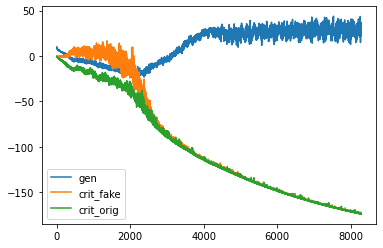

d loss fake  -173.33529663085938
d loss real  -173.5703582763672
[Epoch 24/100] [Batch 151/345] [D loss: -173.452827, acc:   0%] [G loss: 32.614007] [c1: 64.162468, c2: 65.007935, o: 47.438343, f: 52.380020] time: 5:22:14.200153
d loss fake  -173.2830047607422
d loss real  -173.73081970214844
[Epoch 24/100] [Batch 152/345] [D loss: -173.506912, acc:   0%] [G loss: 24.678235] [c1: 53.269760, c2: 53.606461, o: 59.502148, f: 65.230118] time: 5:22:16.483294
d loss fake  -173.41806030273438
d loss real  -173.6869659423828
[Epoch 24/100] [Batch 153/345] [D loss: -173.552513, acc:   0%] [G loss: 20.870463] [c1: 49.434307, c2: 47.155460, o: 46.875618, f: 53.765472] time: 5:22:18.760923
d loss fake  -173.37440490722656
d loss real  -173.54750061035156
[Epoch 24/100] [Batch 154/345] [D loss: -173.460953, acc:   0%] [G loss: 20.298228] [c1: 48.330925, c2: 46.910725, o: 40.156853, f: 46.591110] time: 5:22:21.041793
d loss fake  -173.3997802734375
d loss real  -173.7034912109375
[Epoch 24/100] [Bat

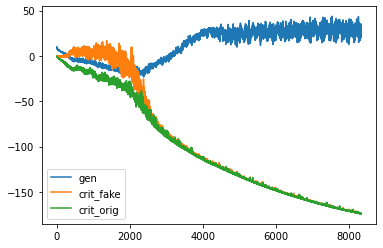

d loss fake  -173.355712890625
d loss real  -174.10110473632812
[Epoch 24/100] [Batch 201/345] [D loss: -173.728409, acc:   0%] [G loss: 19.231448] [c1: 46.211151, c2: 46.621094, o: 49.154770, f: 52.384445] time: 5:24:08.840236
d loss fake  -173.97483825683594
d loss real  -174.09849548339844
[Epoch 24/100] [Batch 202/345] [D loss: -174.036667, acc:   0%] [G loss: 23.499653] [c1: 54.054291, c2: 52.258247, o: 39.864880, f: 49.451630] time: 5:24:11.120968
d loss fake  -173.8072509765625
d loss real  -174.20574951171875
[Epoch 24/100] [Batch 203/345] [D loss: -174.006500, acc:   0%] [G loss: 20.211734] [c1: 44.567921, c2: 44.739960, o: 45.834702, f: 48.153851] time: 5:24:13.400139
d loss fake  -173.99452209472656
d loss real  -174.15151977539062
[Epoch 24/100] [Batch 204/345] [D loss: -174.073021, acc:   0%] [G loss: 24.187927] [c1: 51.226269, c2: 51.263912, o: 41.789024, f: 46.013023] time: 5:24:15.678285
d loss fake  -174.05288696289062
d loss real  -174.00140380859375
[Epoch 24/100] [B

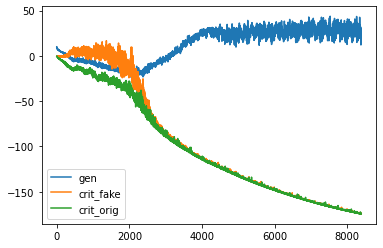

d loss fake  -174.35833740234375
d loss real  -174.4506378173828
[Epoch 24/100] [Batch 251/345] [D loss: -174.404488, acc:   0%] [G loss: 27.952824] [c1: 59.879723, c2: 58.886215, o: 55.411137, f: 59.635315] time: 5:26:04.953942
d loss fake  -174.27197265625
d loss real  -173.75331115722656
[Epoch 24/100] [Batch 252/345] [D loss: -174.012642, acc:   0%] [G loss: 31.681589] [c1: 60.320866, c2: 60.545685, o: 52.526382, f: 55.165901] time: 5:26:07.242698
d loss fake  -174.158447265625
d loss real  -174.55081176757812
[Epoch 24/100] [Batch 253/345] [D loss: -174.354630, acc:   0%] [G loss: 23.496463] [c1: 50.135750, c2: 51.409920, o: 63.011108, f: 61.102859] time: 5:26:09.531718
d loss fake  -174.41847229003906
d loss real  -174.4246063232422
[Epoch 24/100] [Batch 254/345] [D loss: -174.421539, acc:   0%] [G loss: 27.269350] [c1: 56.787109, c2: 56.225258, o: 50.101681, f: 53.974998] time: 5:26:11.814001
d loss fake  -174.3916015625
d loss real  -174.4146270751953
[Epoch 24/100] [Batch 255/

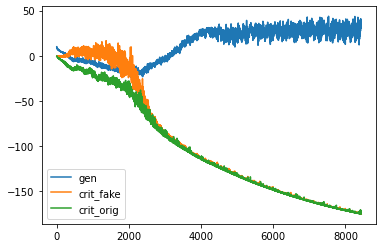

d loss fake  -174.87164306640625
d loss real  -174.94517517089844
[Epoch 24/100] [Batch 301/345] [D loss: -174.908409, acc:   0%] [G loss: 31.185298] [c1: 60.880966, c2: 59.712112, o: 62.089561, f: 63.102039] time: 5:28:00.510191
d loss fake  -174.76165771484375
d loss real  -174.8313446044922
[Epoch 24/100] [Batch 302/345] [D loss: -174.796501, acc:   0%] [G loss: 29.028335] [c1: 58.244236, c2: 57.396835, o: 59.678188, f: 58.076035] time: 5:28:02.779921
d loss fake  -174.8049774169922
d loss real  -174.91387939453125
[Epoch 24/100] [Batch 303/345] [D loss: -174.859428, acc:   0%] [G loss: 32.751430] [c1: 62.432663, c2: 61.325714, o: 56.933136, f: 61.416008] time: 5:28:05.054099
d loss fake  -174.7033233642578
d loss real  -174.84913635253906
[Epoch 24/100] [Batch 304/345] [D loss: -174.776230, acc:   0%] [G loss: 29.414953] [c1: 57.538464, c2: 57.187401, o: 55.330490, f: 58.586708] time: 5:28:07.322663
d loss fake  -174.7313232421875
d loss real  -174.8564453125
[Epoch 24/100] [Batch 

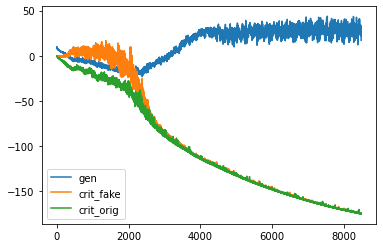

d loss fake  -173.27328491210938
d loss real  -175.1871337890625
[Epoch 25/100] [Batch 1/345] [D loss: -174.230209, acc:   0%] [G loss: 13.026485] [c1: 29.618744, c2: 30.945980, o: 35.562359, f: 34.069221] time: 5:29:35.466827
d loss fake  -175.1062469482422
d loss real  -175.11337280273438
[Epoch 25/100] [Batch 2/345] [D loss: -175.109810, acc:   0%] [G loss: 21.145541] [c1: 48.022606, c2: 47.607452, o: 31.584198, f: 35.552700] time: 5:29:37.813425
d loss fake  -174.78651428222656
d loss real  -174.967529296875
[Epoch 25/100] [Batch 3/345] [D loss: -174.877022, acc:   0%] [G loss: 19.756205] [c1: 46.835464, c2: 46.548775, o: 43.723354, f: 46.878166] time: 5:29:40.211653
d loss fake  -175.18814086914062
d loss real  -175.2379150390625
[Epoch 25/100] [Batch 4/345] [D loss: -175.213028, acc:   0%] [G loss: 23.736026] [c1: 51.607681, c2: 51.551018, o: 46.692719, f: 48.219692] time: 5:29:42.561663
d loss fake  -175.1309051513672
d loss real  -175.20907592773438
[Epoch 25/100] [Batch 5/345]

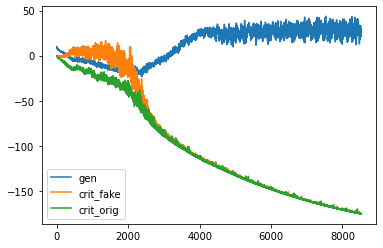

d loss fake  -175.24424743652344
d loss real  -175.47470092773438
[Epoch 25/100] [Batch 51/345] [D loss: -175.359474, acc:   0%] [G loss: 25.169835] [c1: 49.639069, c2: 49.995884, o: 54.616760, f: 52.471367] time: 5:31:30.535266
d loss fake  -175.39862060546875
d loss real  -175.53692626953125
[Epoch 25/100] [Batch 52/345] [D loss: -175.467773, acc:   0%] [G loss: 25.933475] [c1: 50.906853, c2: 51.210594, o: 56.012608, f: 50.280281] time: 5:31:32.824375
d loss fake  -175.53013610839844
d loss real  -175.69371032714844
[Epoch 25/100] [Batch 53/345] [D loss: -175.611923, acc:   0%] [G loss: 28.566799] [c1: 59.171524, c2: 59.706474, o: 54.733906, f: 54.678642] time: 5:31:35.099250
d loss fake  -175.511474609375
d loss real  -175.55657958984375
[Epoch 25/100] [Batch 54/345] [D loss: -175.534027, acc:   0%] [G loss: 31.155687] [c1: 63.926979, c2: 62.573376, o: 56.437462, f: 58.493553] time: 5:31:37.389249
d loss fake  -175.40048217773438
d loss real  -175.5782928466797
[Epoch 25/100] [Batch

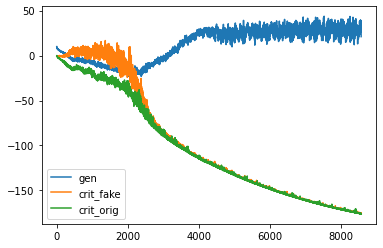

d loss fake  -175.75271606445312
d loss real  -176.00091552734375
[Epoch 25/100] [Batch 101/345] [D loss: -175.876816, acc:   0%] [G loss: 21.451637] [c1: 49.328125, c2: 49.791573, o: 45.646725, f: 46.193565] time: 5:33:26.687579
d loss fake  -175.9497833251953
d loss real  -176.1057586669922
[Epoch 25/100] [Batch 102/345] [D loss: -176.027771, acc:   0%] [G loss: 24.335565] [c1: 53.984386, c2: 53.341888, o: 50.927948, f: 52.853493] time: 5:33:28.991305
d loss fake  -175.81607055664062
d loss real  -176.0723114013672
[Epoch 25/100] [Batch 103/345] [D loss: -175.944191, acc:   0%] [G loss: 21.338506] [c1: 47.297546, c2: 46.512123, o: 51.382645, f: 54.476994] time: 5:33:31.280004
d loss fake  -175.86935424804688
d loss real  -176.056884765625
[Epoch 25/100] [Batch 104/345] [D loss: -175.963120, acc:   0%] [G loss: 26.518705] [c1: 54.510395, c2: 53.716759, o: 44.958115, f: 46.485390] time: 5:33:33.569027
d loss fake  -175.70748901367188
d loss real  -175.0001678466797
[Epoch 25/100] [Batc

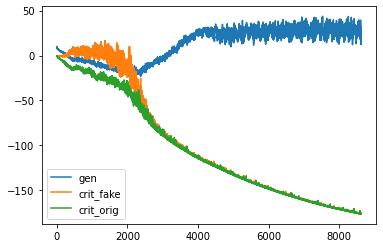

d loss fake  -175.93870544433594
d loss real  -176.3667449951172
[Epoch 25/100] [Batch 151/345] [D loss: -176.152725, acc:   0%] [G loss: 38.327936] [c1: 72.944870, c2: 73.086319, o: 50.745865, f: 58.460052] time: 5:35:22.780792
d loss fake  -175.82118225097656
d loss real  -176.23989868164062
[Epoch 25/100] [Batch 152/345] [D loss: -176.030540, acc:   0%] [G loss: 30.146585] [c1: 59.151375, c2: 58.016975, o: 68.517380, f: 68.897629] time: 5:35:25.083485
d loss fake  -175.78778076171875
d loss real  -176.40597534179688
[Epoch 25/100] [Batch 153/345] [D loss: -176.096878, acc:   0%] [G loss: 22.407659] [c1: 47.330154, c2: 46.832817, o: 58.138214, f: 57.364227] time: 5:35:27.371865
d loss fake  -175.79086303710938
d loss real  -176.343994140625
[Epoch 25/100] [Batch 154/345] [D loss: -176.067429, acc:   0%] [G loss: 18.450097] [c1: 42.191734, c2: 42.987156, o: 43.122997, f: 46.214897] time: 5:35:29.662984
d loss fake  -176.14593505859375
d loss real  -176.355712890625
[Epoch 25/100] [Bat

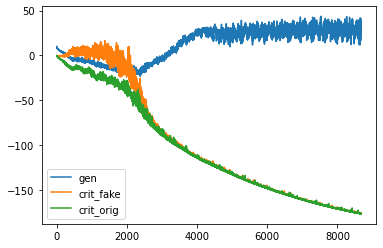

d loss fake  -175.45391845703125
d loss real  -176.83042907714844
[Epoch 25/100] [Batch 201/345] [D loss: -176.142174, acc:   0%] [G loss: 11.833121] [c1: 29.576511, c2: 29.666273, o: 37.161362, f: 37.758129] time: 5:37:17.856473
d loss fake  -176.56243896484375
d loss real  -176.7996368408203
[Epoch 25/100] [Batch 202/345] [D loss: -176.681038, acc:   0%] [G loss: 13.746628] [c1: 37.534859, c2: 36.469826, o: 29.796988, f: 34.228706] time: 5:37:20.154156
d loss fake  -175.74501037597656
d loss real  -176.76495361328125
[Epoch 25/100] [Batch 203/345] [D loss: -176.254982, acc:   0%] [G loss: 11.181297] [c1: 31.789553, c2: 31.846741, o: 32.850967, f: 33.986565] time: 5:37:22.432660
d loss fake  -176.19668579101562
d loss real  -175.43984985351562
[Epoch 25/100] [Batch 204/345] [D loss: -175.818268, acc:   0%] [G loss: 16.640879] [c1: 36.988838, c2: 36.595634, o: 26.700308, f: 28.174908] time: 5:37:24.714465
d loss fake  -176.3988037109375
d loss real  -176.7606964111328
[Epoch 25/100] [B

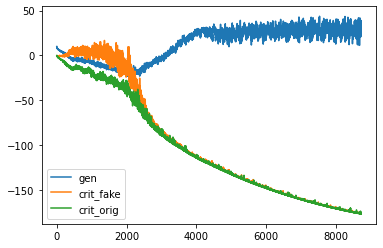

d loss fake  -176.98245239257812
d loss real  -177.08203125
[Epoch 25/100] [Batch 251/345] [D loss: -177.032242, acc:   0%] [G loss: 31.041314] [c1: 61.625607, c2: 61.092537, o: 57.356609, f: 62.648743] time: 5:39:13.707054
d loss fake  -176.70050048828125
d loss real  -177.06881713867188
[Epoch 25/100] [Batch 252/345] [D loss: -176.884659, acc:   0%] [G loss: 26.741523] [c1: 52.363194, c2: 52.289742, o: 58.628174, f: 58.716469] time: 5:39:15.997595
d loss fake  -176.86190795898438
d loss real  -176.96304321289062
[Epoch 25/100] [Batch 253/345] [D loss: -176.912476, acc:   0%] [G loss: 27.939839] [c1: 56.501205, c2: 55.480980, o: 50.785400, f: 54.463982] time: 5:39:18.269492
d loss fake  -176.83303833007812
d loss real  -177.11846923828125
[Epoch 25/100] [Batch 254/345] [D loss: -176.975754, acc:   0%] [G loss: 23.575488] [c1: 44.980370, c2: 46.313347, o: 55.435234, f: 54.181175] time: 5:39:20.563649
d loss fake  -176.84654235839844
d loss real  -177.14720153808594
[Epoch 25/100] [Batc

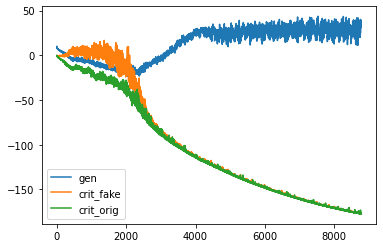

d loss fake  -177.3785400390625
d loss real  -177.39891052246094
[Epoch 25/100] [Batch 301/345] [D loss: -177.388725, acc:   0%] [G loss: 36.268339] [c1: 63.520622, c2: 63.394424, o: 64.594063, f: 65.621330] time: 5:41:09.599863
d loss fake  -177.48663330078125
d loss real  -177.49237060546875
[Epoch 25/100] [Batch 302/345] [D loss: -177.489502, acc:   0%] [G loss: 35.261041] [c1: 62.538570, c2: 62.205177, o: 65.450020, f: 62.737534] time: 5:41:11.892054
d loss fake  -177.13768005371094
d loss real  -177.43638610839844
[Epoch 25/100] [Batch 303/345] [D loss: -177.287033, acc:   0%] [G loss: 28.418572] [c1: 54.223343, c2: 54.278023, o: 59.974472, f: 61.092773] time: 5:41:14.179843
d loss fake  -177.2481231689453
d loss real  -177.13232421875
[Epoch 25/100] [Batch 304/345] [D loss: -177.190224, acc:   0%] [G loss: 28.181290] [c1: 54.402542, c2: 53.909927, o: 51.797390, f: 52.805977] time: 5:41:16.473606
d loss fake  -177.38861083984375
d loss real  -176.33888244628906
[Epoch 25/100] [Bat

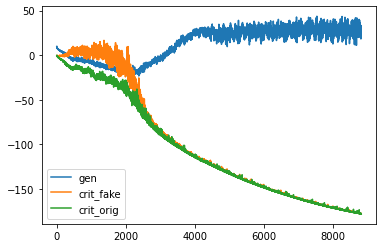

d loss fake  -177.451904296875
d loss real  -177.78126525878906
[Epoch 26/100] [Batch 1/345] [D loss: -177.616585, acc:   0%] [G loss: 21.157381] [c1: 45.451550, c2: 45.248932, o: 49.070633, f: 49.716095] time: 5:42:45.561229
d loss fake  -177.54489135742188
d loss real  -177.7720489501953
[Epoch 26/100] [Batch 2/345] [D loss: -177.658470, acc:   0%] [G loss: 21.935490] [c1: 42.748489, c2: 41.771973, o: 44.139908, f: 43.206886] time: 5:42:47.910148
d loss fake  -177.6122589111328
d loss real  -177.72830200195312
[Epoch 26/100] [Batch 3/345] [D loss: -177.670280, acc:   0%] [G loss: 19.966087] [c1: 42.658165, c2: 43.316696, o: 39.761139, f: 41.868454] time: 5:42:50.238610
d loss fake  -176.86155700683594
d loss real  -177.87579345703125
[Epoch 26/100] [Batch 4/345] [D loss: -177.368675, acc:   0%] [G loss: 15.587741] [c1: 34.509399, c2: 35.014511, o: 45.210400, f: 43.029823] time: 5:42:52.599135
d loss fake  -177.67234802246094
d loss real  -177.8499298095703
[Epoch 26/100] [Batch 5/345

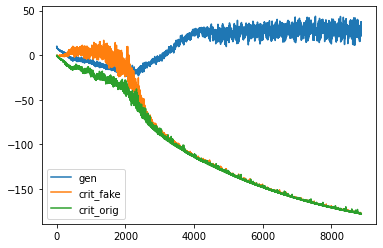

d loss fake  -177.79383850097656
d loss real  -178.08596801757812
[Epoch 26/100] [Batch 51/345] [D loss: -177.939903, acc:   0%] [G loss: 26.315201] [c1: 51.204323, c2: 51.112556, o: 57.542458, f: 53.564270] time: 5:44:40.780919
d loss fake  -177.94125366210938
d loss real  -178.17108154296875
[Epoch 26/100] [Batch 52/345] [D loss: -178.056168, acc:   0%] [G loss: 25.243721] [c1: 51.883614, c2: 53.371719, o: 54.984295, f: 55.019501] time: 5:44:43.057960
d loss fake  -177.83831787109375
d loss real  -177.81057739257812
[Epoch 26/100] [Batch 53/345] [D loss: -177.824448, acc:   0%] [G loss: 22.752309] [c1: 48.390297, c2: 49.094292, o: 49.349503, f: 48.734772] time: 5:44:45.343261
d loss fake  -178.0925750732422
d loss real  -178.20855712890625
[Epoch 26/100] [Batch 54/345] [D loss: -178.150566, acc:   0%] [G loss: 25.920217] [c1: 52.883862, c2: 53.575958, o: 51.769379, f: 50.888119] time: 5:44:47.619585
d loss fake  -178.15289306640625
d loss real  -178.20846557617188
[Epoch 26/100] [Bat

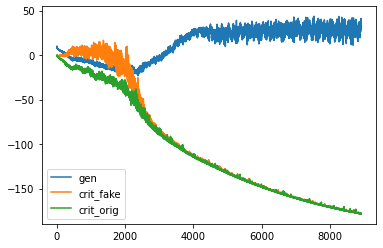

d loss fake  -178.4258575439453
d loss real  -178.59103393554688
[Epoch 26/100] [Batch 101/345] [D loss: -178.508446, acc:   0%] [G loss: 28.989116] [c1: 55.758453, c2: 55.211441, o: 59.981651, f: 56.394287] time: 5:46:36.521807
d loss fake  -178.4581298828125
d loss real  -178.48208618164062
[Epoch 26/100] [Batch 102/345] [D loss: -178.470108, acc:   0%] [G loss: 34.049814] [c1: 63.284973, c2: 64.974136, o: 57.676407, f: 56.754688] time: 5:46:38.811439
d loss fake  -178.46444702148438
d loss real  -178.57594299316406
[Epoch 26/100] [Batch 103/345] [D loss: -178.520195, acc:   0%] [G loss: 36.731944] [c1: 67.271072, c2: 68.860695, o: 68.465317, f: 66.779793] time: 5:46:41.092146
d loss fake  -178.39376831054688
d loss real  -178.50823974609375
[Epoch 26/100] [Batch 104/345] [D loss: -178.451004, acc:   0%] [G loss: 33.987258] [c1: 62.957111, c2: 62.416832, o: 65.792084, f: 65.182556] time: 5:46:43.376193
d loss fake  -178.39215087890625
d loss real  -178.54837036132812
[Epoch 26/100] [

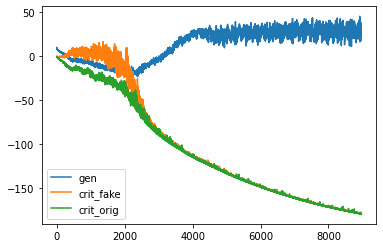

d loss fake  -178.72247314453125
d loss real  -178.48721313476562
[Epoch 26/100] [Batch 151/345] [D loss: -178.604843, acc:   0%] [G loss: 35.690762] [c1: 71.038864, c2: 68.765282, o: 49.183971, f: 57.046543] time: 5:48:32.233169
d loss fake  -178.67332458496094
d loss real  -178.8189697265625
[Epoch 26/100] [Batch 152/345] [D loss: -178.746147, acc:   0%] [G loss: 36.858850] [c1: 70.126297, c2: 70.429359, o: 69.120697, f: 68.180328] time: 5:48:34.504950
d loss fake  -178.77879333496094
d loss real  -178.89956665039062
[Epoch 26/100] [Batch 153/345] [D loss: -178.839180, acc:   0%] [G loss: 36.043644] [c1: 68.517868, c2: 68.258926, o: 68.453445, f: 70.917023] time: 5:48:36.775950
d loss fake  -178.77529907226562
d loss real  -178.90179443359375
[Epoch 26/100] [Batch 154/345] [D loss: -178.838547, acc:   0%] [G loss: 30.891741] [c1: 59.055550, c2: 58.414253, o: 65.843910, f: 67.114487] time: 5:48:39.048057
d loss fake  -178.43359375
d loss real  -178.8956756591797
[Epoch 26/100] [Batch 

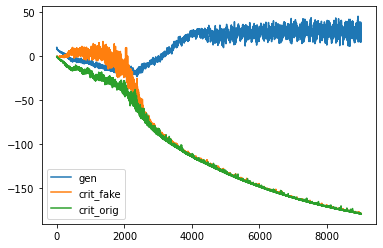

d loss fake  -179.0347137451172
d loss real  -178.56732177734375
[Epoch 26/100] [Batch 201/345] [D loss: -178.801018, acc:   0%] [G loss: 32.216420] [c1: 62.323898, c2: 62.685822, o: 53.784275, f: 55.559196] time: 5:50:26.771625
d loss fake  -178.85592651367188
d loss real  -179.28634643554688
[Epoch 26/100] [Batch 202/345] [D loss: -179.071136, acc:   0%] [G loss: 41.418690] [c1: 77.758743, c2: 77.685387, o: 65.642609, f: 66.432892] time: 5:50:29.063037
d loss fake  -179.1728515625
d loss real  -179.13571166992188
[Epoch 26/100] [Batch 203/345] [D loss: -179.154282, acc:   0%] [G loss: 40.147010] [c1: 74.370651, c2: 74.316742, o: 79.000900, f: 78.351639] time: 5:50:31.340759
d loss fake  -178.9261016845703
d loss real  -179.24978637695312
[Epoch 26/100] [Batch 204/345] [D loss: -179.087944, acc:   0%] [G loss: 31.840307] [c1: 61.200943, c2: 60.774311, o: 77.241661, f: 73.856010] time: 5:50:33.617878
d loss fake  -179.14962768554688
d loss real  -179.2548828125
[Epoch 26/100] [Batch 20

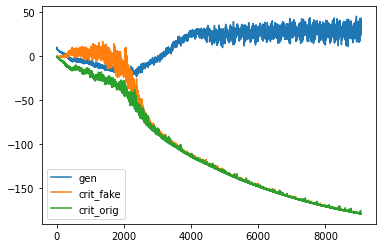

d loss fake  -179.34298706054688
d loss real  -179.2789306640625
[Epoch 26/100] [Batch 251/345] [D loss: -179.310959, acc:   0%] [G loss: 25.128413] [c1: 48.966576, c2: 48.522812, o: 52.583561, f: 48.604095] time: 5:52:22.699509
d loss fake  -179.3140106201172
d loss real  -179.52157592773438
[Epoch 26/100] [Batch 252/345] [D loss: -179.417793, acc:   0%] [G loss: 25.309571] [c1: 47.160072, c2: 47.473347, o: 52.397583, f: 48.652298] time: 5:52:24.992452
d loss fake  -179.3216094970703
d loss real  -179.65139770507812
[Epoch 26/100] [Batch 253/345] [D loss: -179.486504, acc:   0%] [G loss: 32.721314] [c1: 56.186691, c2: 56.658989, o: 55.798859, f: 48.857346] time: 5:52:27.266778
d loss fake  -179.41017150878906
d loss real  -179.2891845703125
[Epoch 26/100] [Batch 254/345] [D loss: -179.349678, acc:   0%] [G loss: 30.888281] [c1: 56.453644, c2: 56.454449, o: 60.912933, f: 55.994453] time: 5:52:29.556802
d loss fake  -179.42755126953125
d loss real  -179.4581298828125
[Epoch 26/100] [Bat

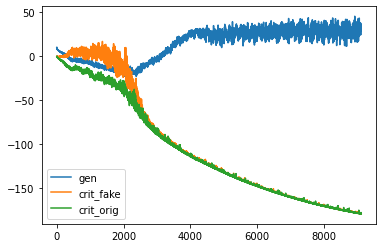

d loss fake  -179.779052734375
d loss real  -179.65460205078125
[Epoch 26/100] [Batch 301/345] [D loss: -179.716827, acc:   0%] [G loss: 30.342061] [c1: 57.149220, c2: 56.673073, o: 47.284184, f: 43.759109] time: 5:54:18.408456
d loss fake  -179.8223876953125
d loss real  -179.83551025390625
[Epoch 26/100] [Batch 302/345] [D loss: -179.828949, acc:   0%] [G loss: 28.998420] [c1: 52.780453, c2: 52.993580, o: 62.257572, f: 59.233459] time: 5:54:20.705174
d loss fake  -179.7609100341797
d loss real  -179.89456176757812
[Epoch 26/100] [Batch 303/345] [D loss: -179.827736, acc:   0%] [G loss: 22.932414] [c1: 42.597363, c2: 43.461285, o: 51.302567, f: 51.248859] time: 5:54:22.980612
d loss fake  -179.88665771484375
d loss real  -179.9075469970703
[Epoch 26/100] [Batch 304/345] [D loss: -179.897102, acc:   0%] [G loss: 23.489021] [c1: 46.108261, c2: 46.672066, o: 46.897568, f: 46.572227] time: 5:54:25.263013
d loss fake  -179.93692016601562
d loss real  -180.01156616210938
[Epoch 26/100] [Bat

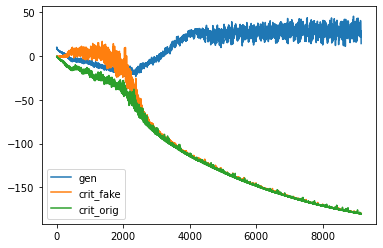

d loss fake  -180.11904907226562
d loss real  -180.25613403320312
[Epoch 27/100] [Batch 1/345] [D loss: -180.187592, acc:   0%] [G loss: 16.578049] [c1: 35.631073, c2: 34.904388, o: 30.304895, f: 31.437899] time: 5:55:53.773974
d loss fake  -179.4257049560547
d loss real  -179.77252197265625
[Epoch 27/100] [Batch 2/345] [D loss: -179.599113, acc:   0%] [G loss: 15.312526] [c1: 31.901886, c2: 31.962969, o: 30.160906, f: 30.726711] time: 5:55:56.135958
d loss fake  -179.59559631347656
d loss real  -179.94497680664062
[Epoch 27/100] [Batch 3/345] [D loss: -179.770287, acc:   0%] [G loss: 17.289510] [c1: 36.772533, c2: 36.275471, o: 38.650227, f: 34.005875] time: 5:55:58.482960
d loss fake  -179.3053741455078
d loss real  -180.16940307617188
[Epoch 27/100] [Batch 4/345] [D loss: -179.737389, acc:   0%] [G loss: 13.168069] [c1: 32.109695, c2: 31.847784, o: 38.981003, f: 34.172729] time: 5:56:00.841378
d loss fake  -180.09817504882812
d loss real  -179.97471618652344
[Epoch 27/100] [Batch 5/

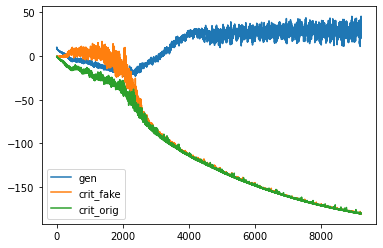

d loss fake  -180.30044555664062
d loss real  -180.41921997070312
[Epoch 27/100] [Batch 51/345] [D loss: -180.359833, acc:   0%] [G loss: 45.480183] [c1: 77.293137, c2: 77.372391, o: 81.065796, f: 71.728943] time: 5:57:49.148655
d loss fake  -180.2237548828125
d loss real  -180.25006103515625
[Epoch 27/100] [Batch 52/345] [D loss: -180.236908, acc:   0%] [G loss: 40.212831] [c1: 69.969498, c2: 70.130226, o: 84.977020, f: 77.702690] time: 5:57:51.438668
d loss fake  -180.46917724609375
d loss real  -180.52001953125
[Epoch 27/100] [Batch 53/345] [D loss: -180.494598, acc:   0%] [G loss: 39.756358] [c1: 70.842995, c2: 70.890274, o: 74.979195, f: 70.268143] time: 5:57:53.728286
d loss fake  -180.43353271484375
d loss real  -180.48902893066406
[Epoch 27/100] [Batch 54/345] [D loss: -180.461281, acc:   0%] [G loss: 39.517633] [c1: 69.768219, c2: 69.364975, o: 74.744888, f: 70.890381] time: 5:57:56.032764
d loss fake  -180.42425537109375
d loss real  -180.4462127685547
[Epoch 27/100] [Batch 5

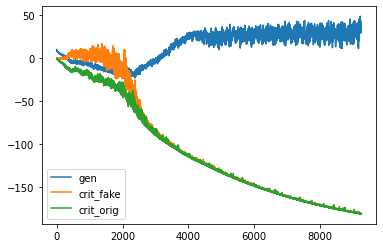

d loss fake  -180.76458740234375
d loss real  -180.91311645507812
[Epoch 27/100] [Batch 101/345] [D loss: -180.838852, acc:   0%] [G loss: 29.766316] [c1: 57.990494, c2: 57.052437, o: 61.348560, f: 58.325363] time: 5:59:45.504488
d loss fake  -179.96473693847656
d loss real  -180.79708862304688
[Epoch 27/100] [Batch 102/345] [D loss: -180.380913, acc:   0%] [G loss: 23.867805] [c1: 49.222000, c2: 49.886665, o: 56.891884, f: 54.107697] time: 5:59:47.792292
d loss fake  -180.8306427001953
d loss real  -180.8973388671875
[Epoch 27/100] [Batch 103/345] [D loss: -180.863991, acc:   0%] [G loss: 30.101179] [c1: 59.824249, c2: 58.703384, o: 54.241959, f: 53.210747] time: 5:59:50.077616
d loss fake  -180.38900756835938
d loss real  -179.79226684570312
[Epoch 27/100] [Batch 104/345] [D loss: -180.090637, acc:   0%] [G loss: 29.771317] [c1: 55.794216, c2: 56.888870, o: 57.235321, f: 54.331627] time: 5:59:52.367893
d loss fake  -180.77066040039062
d loss real  -180.92803955078125
[Epoch 27/100] [

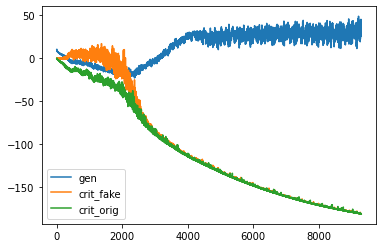

d loss fake  -181.07379150390625
d loss real  -181.2033233642578
[Epoch 27/100] [Batch 151/345] [D loss: -181.138557, acc:   0%] [G loss: 24.707554] [c1: 51.421928, c2: 51.369984, o: 59.511715, f: 61.377838] time: 6:01:41.851187
d loss fake  -181.12648010253906
d loss real  -181.17405700683594
[Epoch 27/100] [Batch 152/345] [D loss: -181.150269, acc:   0%] [G loss: 25.110527] [c1: 52.776569, c2: 52.612553, o: 45.778725, f: 49.548687] time: 6:01:44.132204
d loss fake  -181.02101135253906
d loss real  -181.05120849609375
[Epoch 27/100] [Batch 153/345] [D loss: -181.036110, acc:   0%] [G loss: 31.286696] [c1: 60.293533, c2: 61.434505, o: 51.913437, f: 52.957268] time: 6:01:46.424711
d loss fake  -181.0786590576172
d loss real  -181.23532104492188
[Epoch 27/100] [Batch 154/345] [D loss: -181.156990, acc:   0%] [G loss: 28.346543] [c1: 56.869614, c2: 56.247452, o: 59.524498, f: 60.004524] time: 6:01:48.716284
d loss fake  -181.02725219726562
d loss real  -181.16664123535156
[Epoch 27/100] [

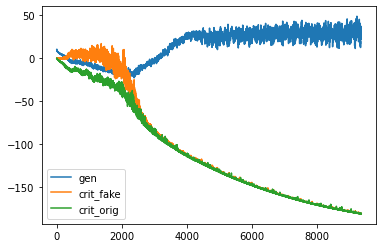

d loss fake  -181.33151245117188
d loss real  -181.34425354003906
[Epoch 27/100] [Batch 201/345] [D loss: -181.337883, acc:   0%] [G loss: 30.592008] [c1: 63.135078, c2: 61.421722, o: 53.553047, f: 54.731655] time: 6:03:37.154131
d loss fake  -181.19508361816406
d loss real  -181.30087280273438
[Epoch 27/100] [Batch 202/345] [D loss: -181.247978, acc:   0%] [G loss: 37.066381] [c1: 68.054169, c2: 68.044678, o: 59.394344, f: 60.831535] time: 6:03:39.441266
d loss fake  -181.31216430664062
d loss real  -181.26876831054688
[Epoch 27/100] [Batch 203/345] [D loss: -181.290466, acc:   0%] [G loss: 37.033672] [c1: 67.043594, c2: 67.221077, o: 68.031311, f: 68.886200] time: 6:03:41.730904
d loss fake  -181.3644256591797
d loss real  -181.40057373046875
[Epoch 27/100] [Batch 204/345] [D loss: -181.382500, acc:   0%] [G loss: 34.476437] [c1: 66.536835, c2: 66.461121, o: 71.037292, f: 68.306404] time: 6:03:44.020021
d loss fake  -181.331298828125
d loss real  -181.4047088623047
[Epoch 27/100] [Ba

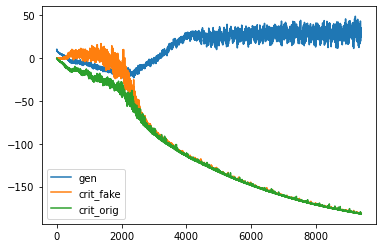

d loss fake  -180.68539428710938
d loss real  -181.60821533203125
[Epoch 27/100] [Batch 251/345] [D loss: -181.146805, acc:   0%] [G loss: 25.339541] [c1: 50.409248, c2: 50.785217, o: 60.341476, f: 59.854748] time: 6:05:33.381904
d loss fake  -181.08206176757812
d loss real  -181.7109375
[Epoch 27/100] [Batch 252/345] [D loss: -181.396500, acc:   0%] [G loss: 22.555516] [c1: 45.580379, c2: 46.111755, o: 54.265884, f: 48.810253] time: 6:05:35.679898
d loss fake  -181.54122924804688
d loss real  -181.53990173339844
[Epoch 27/100] [Batch 253/345] [D loss: -181.540565, acc:   0%] [G loss: 24.708204] [c1: 50.316799, c2: 51.922668, o: 52.105225, f: 47.170799] time: 6:05:37.956496
d loss fake  -181.7264404296875
d loss real  -181.55735778808594
[Epoch 27/100] [Batch 254/345] [D loss: -181.641899, acc:   0%] [G loss: 28.004934] [c1: 56.976784, c2: 55.984303, o: 54.538094, f: 53.267479] time: 6:05:40.241260
d loss fake  -181.6949920654297
d loss real  -181.92303466796875
[Epoch 27/100] [Batch 2

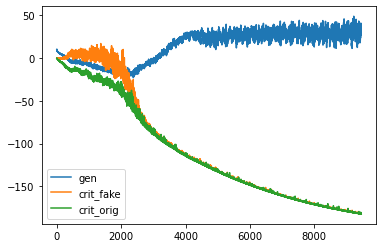

d loss fake  -181.93490600585938
d loss real  -182.12796020507812
[Epoch 27/100] [Batch 301/345] [D loss: -182.031433, acc:   0%] [G loss: 28.715211] [c1: 51.507523, c2: 51.612652, o: 54.935753, f: 52.310417] time: 6:07:29.564224
d loss fake  -182.01864624023438
d loss real  -181.7996826171875
[Epoch 27/100] [Batch 302/345] [D loss: -181.909164, acc:   0%] [G loss: 30.343590] [c1: 56.713703, c2: 56.511051, o: 55.023605, f: 52.458931] time: 6:07:31.859887
d loss fake  -182.0543212890625
d loss real  -182.1126708984375
[Epoch 27/100] [Batch 303/345] [D loss: -182.083496, acc:   0%] [G loss: 31.187200] [c1: 59.687592, c2: 60.198853, o: 61.790794, f: 57.549576] time: 6:07:34.132858
d loss fake  -181.89328002929688
d loss real  -182.09715270996094
[Epoch 27/100] [Batch 304/345] [D loss: -181.995216, acc:   0%] [G loss: 26.968953] [c1: 51.395702, c2: 51.103340, o: 59.168182, f: 59.046043] time: 6:07:36.412197
d loss fake  -182.0769500732422
d loss real  -181.974853515625
[Epoch 27/100] [Batc

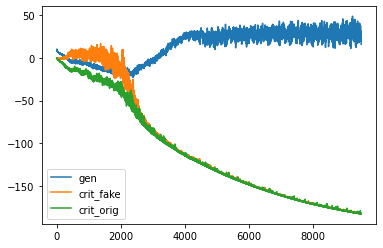

d loss fake  -181.55709838867188
d loss real  -182.39999389648438
[Epoch 28/100] [Batch 1/345] [D loss: -181.978546, acc:   0%] [G loss: 11.264450] [c1: 24.536356, c2: 24.372301, o: 35.347015, f: 32.077217] time: 6:09:04.752398
d loss fake  -181.77359008789062
d loss real  -182.3853759765625
[Epoch 28/100] [Batch 2/345] [D loss: -182.079483, acc:   0%] [G loss: 8.748473] [c1: 25.324312, c2: 25.420027, o: 24.957733, f: 23.613644] time: 6:09:07.055768
d loss fake  -181.58621215820312
d loss real  -182.3304443359375
[Epoch 28/100] [Batch 3/345] [D loss: -181.958328, acc:   0%] [G loss: 10.053182] [c1: 25.127216, c2: 26.616720, o: 31.258320, f: 25.815113] time: 6:09:09.416990
d loss fake  -182.1552734375
d loss real  -182.32232666015625
[Epoch 28/100] [Batch 4/345] [D loss: -182.238800, acc:   0%] [G loss: 14.150277] [c1: 31.625635, c2: 31.504616, o: 29.863926, f: 30.731647] time: 6:09:11.784440
d loss fake  -182.2091064453125
d loss real  -182.41067504882812
[Epoch 28/100] [Batch 5/345] [

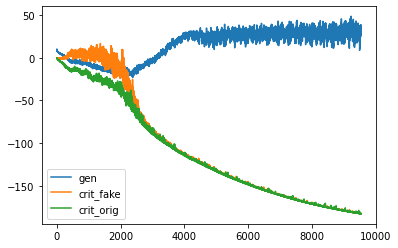

d loss fake  -182.27005004882812
d loss real  -182.6074981689453
[Epoch 28/100] [Batch 51/345] [D loss: -182.438774, acc:   0%] [G loss: 24.571814] [c1: 47.983265, c2: 49.157021, o: 57.941605, f: 50.502655] time: 6:10:59.840854
d loss fake  -182.54713439941406
d loss real  -182.62359619140625
[Epoch 28/100] [Batch 52/345] [D loss: -182.585365, acc:   0%] [G loss: 27.152411] [c1: 50.749245, c2: 51.134384, o: 52.097969, f: 52.712471] time: 6:11:02.120555
d loss fake  -182.2159423828125
d loss real  -182.70028686523438
[Epoch 28/100] [Batch 53/345] [D loss: -182.458115, acc:   0%] [G loss: 21.648462] [c1: 40.937405, c2: 40.653214, o: 53.963089, f: 48.580841] time: 6:11:04.404531
d loss fake  -182.64572143554688
d loss real  -182.50830078125
[Epoch 28/100] [Batch 54/345] [D loss: -182.577011, acc:   0%] [G loss: 24.301879] [c1: 49.104240, c2: 48.177162, o: 40.601364, f: 40.312500] time: 6:11:06.682156
d loss fake  -182.65365600585938
d loss real  -182.4743194580078
[Epoch 28/100] [Batch 55

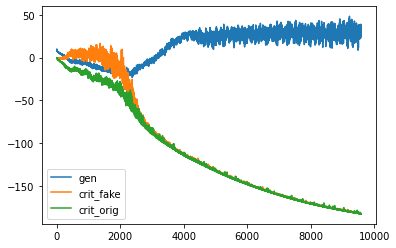

d loss fake  -182.8651885986328
d loss real  -182.8264617919922
[Epoch 28/100] [Batch 101/345] [D loss: -182.845825, acc:   0%] [G loss: 38.150482] [c1: 70.252533, c2: 70.650581, o: 62.995384, f: 60.065063] time: 6:12:55.784452
d loss fake  -182.81109619140625
d loss real  -182.93655395507812
[Epoch 28/100] [Batch 102/345] [D loss: -182.873825, acc:   0%] [G loss: 35.686138] [c1: 62.259781, c2: 62.079685, o: 74.971634, f: 67.460541] time: 6:12:58.078778
d loss fake  -182.71400451660156
d loss real  -182.85263061523438
[Epoch 28/100] [Batch 103/345] [D loss: -182.783318, acc:   0%] [G loss: 32.093805] [c1: 55.485806, c2: 54.332386, o: 71.710800, f: 59.167648] time: 6:13:00.351580
d loss fake  -182.86647033691406
d loss real  -182.9191436767578
[Epoch 28/100] [Batch 104/345] [D loss: -182.892807, acc:   0%] [G loss: 36.429636] [c1: 69.317635, c2: 69.032364, o: 64.011627, f: 61.943203] time: 6:13:02.638211
d loss fake  -182.59446716308594
d loss real  -182.61285400390625
[Epoch 28/100] [B

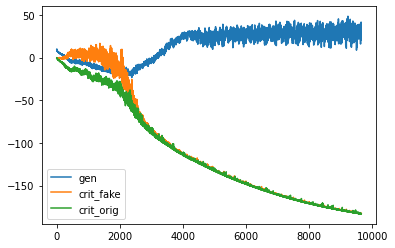

d loss fake  -183.15016174316406
d loss real  -183.16555786132812
[Epoch 28/100] [Batch 151/345] [D loss: -183.157860, acc:   0%] [G loss: 35.466906] [c1: 63.514618, c2: 61.688255, o: 69.605515, f: 66.155945] time: 6:14:51.627964
d loss fake  -183.0675048828125
d loss real  -183.2906494140625
[Epoch 28/100] [Batch 152/345] [D loss: -183.179077, acc:   0%] [G loss: 29.205246] [c1: 55.006447, c2: 54.912739, o: 66.465439, f: 63.265244] time: 6:14:53.911684
d loss fake  -183.10934448242188
d loss real  -183.26242065429688
[Epoch 28/100] [Batch 153/345] [D loss: -183.185883, acc:   0%] [G loss: 28.720791] [c1: 55.719582, c2: 54.190567, o: 62.334969, f: 58.036594] time: 6:14:56.178176
d loss fake  -182.32015991210938
d loss real  -183.1237335205078
[Epoch 28/100] [Batch 154/345] [D loss: -182.721947, acc:   0%] [G loss: 23.623223] [c1: 45.954224, c2: 46.473820, o: 53.529114, f: 51.825096] time: 6:14:58.460111
d loss fake  -183.046875
d loss real  -183.20860290527344
[Epoch 28/100] [Batch 155

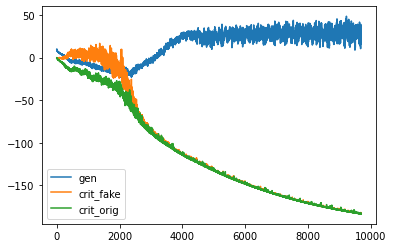

d loss fake  -183.37234497070312
d loss real  -183.55345153808594
[Epoch 28/100] [Batch 201/345] [D loss: -183.462898, acc:   0%] [G loss: 28.063119] [c1: 56.338242, c2: 56.325058, o: 65.881401, f: 61.924812] time: 6:16:46.077127
d loss fake  -183.2884521484375
d loss real  -183.3160858154297
[Epoch 28/100] [Batch 202/345] [D loss: -183.302269, acc:   0%] [G loss: 31.059709] [c1: 56.674591, c2: 56.911217, o: 57.082703, f: 54.254032] time: 6:16:48.362898
d loss fake  -183.2111053466797
d loss real  -183.014892578125
[Epoch 28/100] [Batch 203/345] [D loss: -183.112999, acc:   0%] [G loss: 29.142704] [c1: 54.165291, c2: 54.862442, o: 60.058121, f: 56.617294] time: 6:16:50.628006
d loss fake  -183.44937133789062
d loss real  -183.5814208984375
[Epoch 28/100] [Batch 204/345] [D loss: -183.515396, acc:   0%] [G loss: 29.513056] [c1: 59.217735, c2: 59.178120, o: 59.557991, f: 59.570160] time: 6:16:52.896096
d loss fake  -183.34378051757812
d loss real  -183.07666015625
[Epoch 28/100] [Batch 2

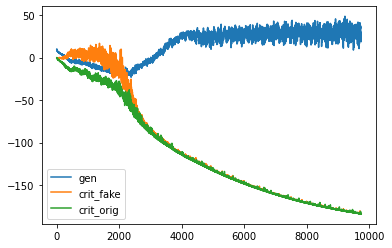

d loss fake  -183.64993286132812
d loss real  -183.62954711914062
[Epoch 28/100] [Batch 251/345] [D loss: -183.639740, acc:   0%] [G loss: 23.565284] [c1: 46.805649, c2: 47.983250, o: 42.021080, f: 37.171577] time: 6:18:41.670262
d loss fake  -183.58944702148438
d loss real  -183.67724609375
[Epoch 28/100] [Batch 252/345] [D loss: -183.633347, acc:   0%] [G loss: 30.195081] [c1: 58.842094, c2: 58.251865, o: 52.448631, f: 51.539993] time: 6:18:43.960129
d loss fake  -183.42800903320312
d loss real  -182.01910400390625
[Epoch 28/100] [Batch 253/345] [D loss: -182.723557, acc:   0%] [G loss: 29.631660] [c1: 55.468750, c2: 55.259949, o: 57.199860, f: 55.806599] time: 6:18:46.228371
d loss fake  -183.70993041992188
d loss real  -183.85276794433594
[Epoch 28/100] [Batch 254/345] [D loss: -183.781349, acc:   0%] [G loss: 27.094158] [c1: 50.886093, c2: 49.637978, o: 65.432304, f: 58.047413] time: 6:18:48.506368
d loss fake  -183.5780487060547
d loss real  -183.80894470214844
[Epoch 28/100] [Ba

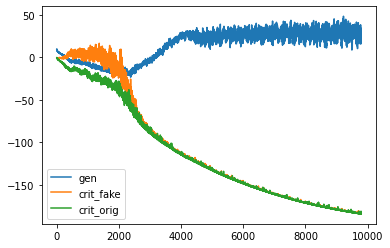

d loss fake  -183.949462890625
d loss real  -183.9996337890625
[Epoch 28/100] [Batch 301/345] [D loss: -183.974548, acc:   0%] [G loss: 24.490414] [c1: 46.015747, c2: 46.056446, o: 58.418926, f: 52.785408] time: 6:20:37.132518
d loss fake  -183.88458251953125
d loss real  -184.008544921875
[Epoch 28/100] [Batch 302/345] [D loss: -183.946564, acc:   0%] [G loss: 25.766100] [c1: 47.447945, c2: 47.297890, o: 46.445705, f: 45.683418] time: 6:20:39.415695
d loss fake  -183.93626403808594
d loss real  -183.4456787109375
[Epoch 28/100] [Batch 303/345] [D loss: -183.690971, acc:   0%] [G loss: 30.125277] [c1: 57.072998, c2: 56.684456, o: 48.618019, f: 47.811218] time: 6:20:41.685861
d loss fake  -183.99957275390625
d loss real  -184.0732421875
[Epoch 28/100] [Batch 304/345] [D loss: -184.036407, acc:   0%] [G loss: 30.248849] [c1: 55.153831, c2: 54.907494, o: 60.792824, f: 58.412651] time: 6:20:43.965520
d loss fake  -184.01620483398438
d loss real  -184.0334014892578
[Epoch 28/100] [Batch 305

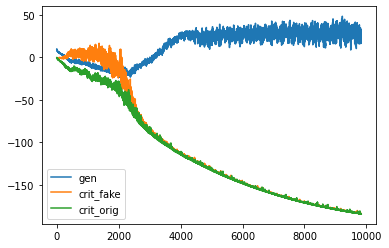

d loss fake  -184.20343017578125
d loss real  -184.34942626953125
[Epoch 29/100] [Batch 1/345] [D loss: -184.276428, acc:   0%] [G loss: 28.859957] [c1: 48.915985, c2: 50.424580, o: 56.429932, f: 49.260460] time: 6:22:12.759385
d loss fake  -183.85955810546875
d loss real  -184.3297576904297
[Epoch 29/100] [Batch 2/345] [D loss: -184.094658, acc:   0%] [G loss: 22.131430] [c1: 41.257710, c2: 41.696026, o: 57.567223, f: 50.695957] time: 6:22:15.091030
d loss fake  -184.16680908203125
d loss real  -184.29598999023438
[Epoch 29/100] [Batch 3/345] [D loss: -184.231400, acc:   0%] [G loss: 18.399505] [c1: 37.448280, c2: 37.223549, o: 44.216812, f: 40.214127] time: 6:22:17.444179
d loss fake  -184.15817260742188
d loss real  -184.3226318359375
[Epoch 29/100] [Batch 4/345] [D loss: -184.240402, acc:   0%] [G loss: 18.152970] [c1: 35.838871, c2: 34.946121, o: 37.753811, f: 35.460575] time: 6:22:19.777270
d loss fake  -184.08755493164062
d loss real  -184.3692626953125
[Epoch 29/100] [Batch 5/3

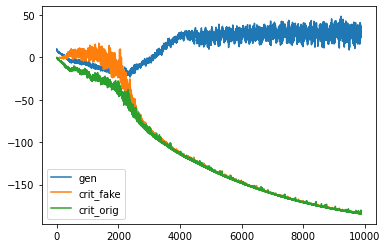

d loss fake  -184.4086456298828
d loss real  -184.5548858642578
[Epoch 29/100] [Batch 51/345] [D loss: -184.481766, acc:   0%] [G loss: 28.332530] [c1: 49.589821, c2: 49.847115, o: 61.741756, f: 52.285572] time: 6:24:07.786834
d loss fake  -184.54122924804688
d loss real  -184.60391235351562
[Epoch 29/100] [Batch 52/345] [D loss: -184.572571, acc:   0%] [G loss: 33.263661] [c1: 60.299683, c2: 60.838596, o: 58.002178, f: 53.700447] time: 6:24:10.070828
d loss fake  -184.437255859375
d loss real  -184.42453002929688
[Epoch 29/100] [Batch 53/345] [D loss: -184.430893, acc:   0%] [G loss: 34.690600] [c1: 58.845745, c2: 58.770370, o: 68.403008, f: 60.524288] time: 6:24:12.350279
d loss fake  -184.54104614257812
d loss real  -184.5482940673828
[Epoch 29/100] [Batch 54/345] [D loss: -184.544670, acc:   0%] [G loss: 34.514240] [c1: 55.544411, c2: 55.254181, o: 69.633728, f: 58.085934] time: 6:24:14.639538
d loss fake  -184.577392578125
d loss real  -184.54931640625
[Epoch 29/100] [Batch 55/345

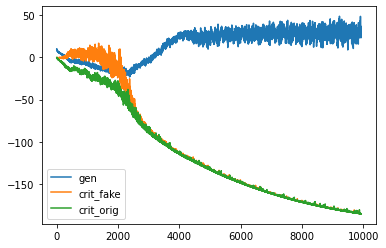

d loss fake  -184.74310302734375
d loss real  -184.89776611328125
[Epoch 29/100] [Batch 101/345] [D loss: -184.820435, acc:   0%] [G loss: 30.230304] [c1: 58.826393, c2: 57.839462, o: 65.287338, f: 62.116615] time: 6:26:04.035871
d loss fake  -184.83340454101562
d loss real  -184.91319274902344
[Epoch 29/100] [Batch 102/345] [D loss: -184.873299, acc:   0%] [G loss: 33.470650] [c1: 64.267128, c2: 63.298111, o: 64.703705, f: 61.484848] time: 6:26:06.329897
d loss fake  -184.8619384765625
d loss real  -184.78668212890625
[Epoch 29/100] [Batch 103/345] [D loss: -184.824310, acc:   0%] [G loss: 32.331015] [c1: 61.052990, c2: 61.175468, o: 67.549324, f: 59.421120] time: 6:26:08.611880
d loss fake  -184.73953247070312
d loss real  -184.84445190429688
[Epoch 29/100] [Batch 104/345] [D loss: -184.791992, acc:   0%] [G loss: 33.234910] [c1: 57.825417, c2: 57.759377, o: 69.348366, f: 60.886745] time: 6:26:10.889053
d loss fake  -184.84207153320312
d loss real  -184.88597106933594
[Epoch 29/100] 

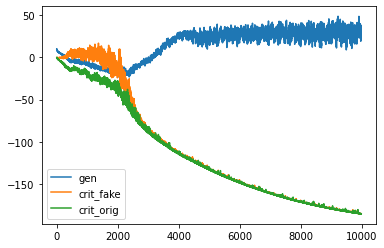

d loss fake  -184.94436645507812
d loss real  -185.19276428222656
[Epoch 29/100] [Batch 151/345] [D loss: -185.068565, acc:   0%] [G loss: 22.674600] [c1: 41.588863, c2: 41.210480, o: 62.590908, f: 56.507851] time: 6:28:00.088517
d loss fake  -185.01121520996094
d loss real  -185.11830139160156
[Epoch 29/100] [Batch 152/345] [D loss: -185.064758, acc:   0%] [G loss: 19.433143] [c1: 41.833946, c2: 41.011391, o: 43.349731, f: 44.110325] time: 6:28:02.377500
d loss fake  -185.0142364501953
d loss real  -185.13941955566406
[Epoch 29/100] [Batch 153/345] [D loss: -185.076828, acc:   0%] [G loss: 21.930437] [c1: 43.083763, c2: 42.860062, o: 38.298386, f: 38.402740] time: 6:28:04.649203
d loss fake  -184.76019287109375
d loss real  -185.15208435058594
[Epoch 29/100] [Batch 154/345] [D loss: -184.956139, acc:   0%] [G loss: 17.800721] [c1: 34.840897, c2: 34.298538, o: 44.889935, f: 42.105698] time: 6:28:06.937839
d loss fake  -184.9838104248047
d loss real  -185.16085815429688
[Epoch 29/100] [

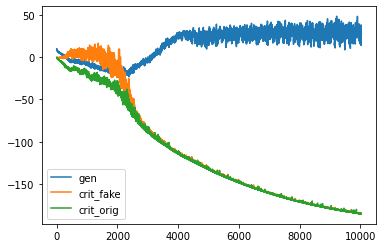

d loss fake  -184.61087036132812
d loss real  -185.36410522460938
[Epoch 29/100] [Batch 201/345] [D loss: -184.987488, acc:   0%] [G loss: 17.099023] [c1: 36.075581, c2: 35.997425, o: 51.311584, f: 43.242981] time: 6:29:55.236480
d loss fake  -185.17379760742188
d loss real  -185.26370239257812
[Epoch 29/100] [Batch 202/345] [D loss: -185.218750, acc:   0%] [G loss: 18.726437] [c1: 38.422073, c2: 38.424702, o: 37.811768, f: 32.323925] time: 6:29:57.522834
d loss fake  -185.09495544433594
d loss real  -185.3895721435547
[Epoch 29/100] [Batch 203/345] [D loss: -185.242264, acc:   0%] [G loss: 16.551807] [c1: 38.370026, c2: 38.919586, o: 45.788860, f: 41.166855] time: 6:29:59.798455
d loss fake  -185.14524841308594
d loss real  -184.80911254882812
[Epoch 29/100] [Batch 204/345] [D loss: -184.977180, acc:   0%] [G loss: 20.595643] [c1: 42.020988, c2: 43.323952, o: 41.696060, f: 34.518616] time: 6:30:02.095882
d loss fake  -184.9795379638672
d loss real  -185.32699584960938
[Epoch 29/100] [

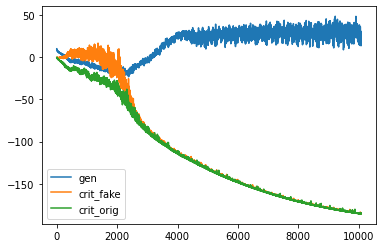

d loss fake  -185.37330627441406
d loss real  -185.56060791015625
[Epoch 29/100] [Batch 251/345] [D loss: -185.466957, acc:   0%] [G loss: 22.175540] [c1: 42.814095, c2: 43.264954, o: 49.813000, f: 46.008232] time: 6:31:51.206989
d loss fake  -185.141845703125
d loss real  -185.441162109375
[Epoch 29/100] [Batch 252/345] [D loss: -185.291504, acc:   0%] [G loss: 21.211357] [c1: 40.213890, c2: 40.492847, o: 48.533531, f: 41.345638] time: 6:31:53.496657
d loss fake  -185.30728149414062
d loss real  -185.05979919433594
[Epoch 29/100] [Batch 253/345] [D loss: -185.183540, acc:   0%] [G loss: 23.475131] [c1: 43.227543, c2: 42.430275, o: 47.216042, f: 40.425461] time: 6:31:55.775966
d loss fake  -185.42691040039062
d loss real  -185.5809326171875
[Epoch 29/100] [Batch 254/345] [D loss: -185.503922, acc:   0%] [G loss: 26.330724] [c1: 47.486137, c2: 48.204964, o: 55.015312, f: 44.399414] time: 6:31:58.061931
d loss fake  -185.40109252929688
d loss real  -184.7137451171875
[Epoch 29/100] [Batc

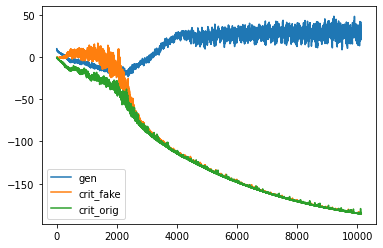

d loss fake  -185.8325653076172
d loss real  -185.69219970703125
[Epoch 29/100] [Batch 301/345] [D loss: -185.762383, acc:   0%] [G loss: 30.686917] [c1: 53.876762, c2: 51.443237, o: 44.211044, f: 40.398140] time: 6:33:47.103104
d loss fake  -185.62046813964844
d loss real  -185.73739624023438
[Epoch 29/100] [Batch 302/345] [D loss: -185.678932, acc:   0%] [G loss: 28.453690] [c1: 47.452744, c2: 46.494728, o: 58.354340, f: 49.423798] time: 6:33:49.397653
d loss fake  -185.64849853515625
d loss real  -185.84902954101562
[Epoch 29/100] [Batch 303/345] [D loss: -185.748764, acc:   0%] [G loss: 24.065183] [c1: 42.257317, c2: 43.568932, o: 56.605995, f: 47.685074] time: 6:33:51.674110
d loss fake  -185.64996337890625
d loss real  -185.83248901367188
[Epoch 29/100] [Batch 304/345] [D loss: -185.741226, acc:   0%] [G loss: 23.525318] [c1: 42.145660, c2: 43.582355, o: 52.878990, f: 42.119621] time: 6:33:53.966180
d loss fake  -185.77780151367188
d loss real  -185.84603881835938
[Epoch 29/100] 

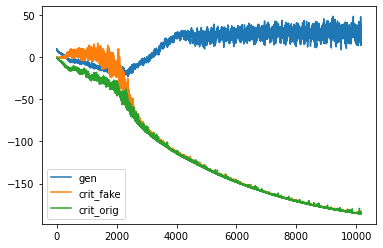

d loss fake  -185.01705932617188
d loss real  -186.06912231445312
[Epoch 30/100] [Batch 1/345] [D loss: -185.543091, acc:   0%] [G loss: 15.658927] [c1: 26.595701, c2: 27.935070, o: 39.727161, f: 28.504986] time: 6:35:22.165797
d loss fake  -185.912841796875
d loss real  -185.84889221191406
[Epoch 30/100] [Batch 2/345] [D loss: -185.880867, acc:   0%] [G loss: 22.567311] [c1: 43.372372, c2: 42.031303, o: 30.341610, f: 25.932262] time: 6:35:24.494987
d loss fake  -185.80206298828125
d loss real  -186.0681915283203
[Epoch 30/100] [Batch 3/345] [D loss: -185.935127, acc:   0%] [G loss: 21.479365] [c1: 35.705971, c2: 35.619026, o: 54.754059, f: 42.662537] time: 6:35:26.824814
d loss fake  -185.76016235351562
d loss real  -186.08326721191406
[Epoch 30/100] [Batch 4/345] [D loss: -185.921715, acc:   0%] [G loss: 16.303536] [c1: 27.201912, c2: 27.562679, o: 44.777916, f: 36.438515] time: 6:35:29.177492
d loss fake  -185.9510498046875
d loss real  -186.09461975097656
[Epoch 30/100] [Batch 5/34

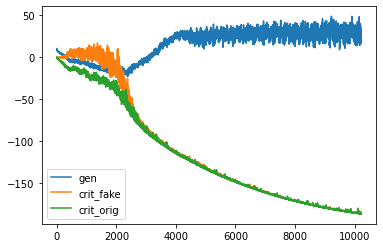

d loss fake  -186.14743041992188
d loss real  -186.23138427734375
[Epoch 30/100] [Batch 51/345] [D loss: -186.189407, acc:   0%] [G loss: 30.858934] [c1: 49.229187, c2: 49.108994, o: 60.844444, f: 49.610794] time: 6:37:17.198968
d loss fake  -185.6541290283203
d loss real  -186.33050537109375
[Epoch 30/100] [Batch 52/345] [D loss: -185.992317, acc:   0%] [G loss: 21.312188] [c1: 39.068924, c2: 39.910282, o: 57.237938, f: 49.110039] time: 6:37:19.482115
d loss fake  -185.94094848632812
d loss real  -186.13999938964844
[Epoch 30/100] [Batch 53/345] [D loss: -186.040474, acc:   0%] [G loss: 36.122343] [c1: 59.651825, c2: 58.963974, o: 48.848000, f: 42.097942] time: 6:37:21.760538
d loss fake  -186.20712280273438
d loss real  -186.28677368164062
[Epoch 30/100] [Batch 54/345] [D loss: -186.246948, acc:   0%] [G loss: 34.233517] [c1: 56.323013, c2: 55.365067, o: 68.220947, f: 59.439484] time: 6:37:24.038118
d loss fake  -186.0032196044922
d loss real  -185.90472412109375
[Epoch 30/100] [Batc

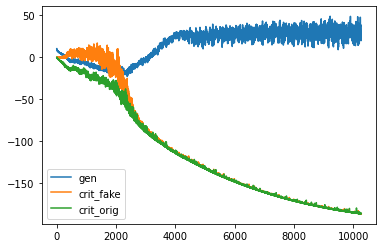

d loss fake  -186.39895629882812
d loss real  -186.58447265625
[Epoch 30/100] [Batch 101/345] [D loss: -186.491714, acc:   0%] [G loss: 38.134612] [c1: 63.791382, c2: 63.946186, o: 63.501297, f: 54.918949] time: 6:39:13.045494
d loss fake  -186.43142700195312
d loss real  -186.5513153076172
[Epoch 30/100] [Batch 102/345] [D loss: -186.491371, acc:   0%] [G loss: 41.483735] [c1: 66.091034, c2: 65.270615, o: 75.168900, f: 62.783127] time: 6:39:15.332778
d loss fake  -186.46270751953125
d loss real  -186.58871459960938
[Epoch 30/100] [Batch 103/345] [D loss: -186.525711, acc:   0%] [G loss: 38.839437] [c1: 61.607967, c2: 60.806240, o: 79.487198, f: 66.117096] time: 6:39:17.604631
d loss fake  -186.42739868164062
d loss real  -186.61239624023438
[Epoch 30/100] [Batch 104/345] [D loss: -186.519897, acc:   0%] [G loss: 29.911620] [c1: 50.886177, c2: 50.502174, o: 77.043907, f: 66.598038] time: 6:39:19.907573
d loss fake  -186.5076141357422
d loss real  -186.61767578125
[Epoch 30/100] [Batch 

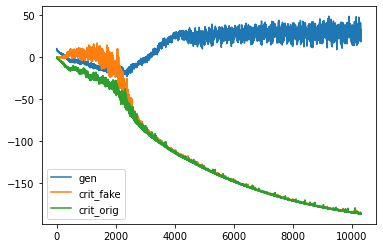

d loss fake  -186.69064331054688
d loss real  -186.6220703125
[Epoch 30/100] [Batch 151/345] [D loss: -186.656357, acc:   0%] [G loss: 29.819347] [c1: 54.309818, c2: 53.950222, o: 55.334824, f: 52.624134] time: 6:41:09.035817
d loss fake  -186.70333862304688
d loss real  -186.84576416015625
[Epoch 30/100] [Batch 152/345] [D loss: -186.774551, acc:   0%] [G loss: 29.100264] [c1: 53.410957, c2: 53.265968, o: 57.830109, f: 55.187889] time: 6:41:11.313586
d loss fake  -186.5234375
d loss real  -186.870849609375
[Epoch 30/100] [Batch 153/345] [D loss: -186.697144, acc:   0%] [G loss: 30.351038] [c1: 52.009129, c2: 52.647034, o: 57.396599, f: 52.286469] time: 6:41:13.580990
d loss fake  -185.80751037597656
d loss real  -186.84371948242188
[Epoch 30/100] [Batch 154/345] [D loss: -186.325615, acc:   0%] [G loss: 18.260429] [c1: 36.417931, c2: 35.745052, o: 53.198269, f: 51.157127] time: 6:41:15.858896
d loss fake  -186.32138061523438
d loss real  -186.725341796875
[Epoch 30/100] [Batch 155/345

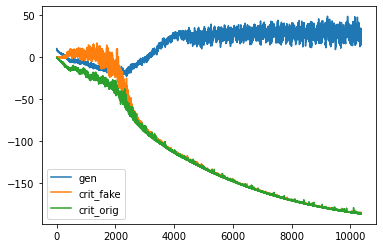

d loss fake  -186.73764038085938
d loss real  -186.92279052734375
[Epoch 30/100] [Batch 201/345] [D loss: -186.830215, acc:   0%] [G loss: 28.420231] [c1: 53.755249, c2: 51.962372, o: 44.008728, f: 41.189629] time: 6:43:03.573551
d loss fake  -186.84194946289062
d loss real  -186.87806701660156
[Epoch 30/100] [Batch 202/345] [D loss: -186.860008, acc:   0%] [G loss: 27.499105] [c1: 48.356689, c2: 47.757751, o: 57.602180, f: 49.586720] time: 6:43:05.850750
d loss fake  -186.6240692138672
d loss real  -187.02084350585938
[Epoch 30/100] [Batch 203/345] [D loss: -186.822456, acc:   0%] [G loss: 21.686663] [c1: 36.122803, c2: 37.892906, o: 59.917355, f: 48.700554] time: 6:43:08.134217
d loss fake  -186.79010009765625
d loss real  -187.07244873046875
[Epoch 30/100] [Batch 204/345] [D loss: -186.931274, acc:   0%] [G loss: 17.210238] [c1: 35.593639, c2: 34.682716, o: 44.165581, f: 38.349304] time: 6:43:10.422692
d loss fake  -186.91714477539062
d loss real  -186.78173828125
[Epoch 30/100] [Ba

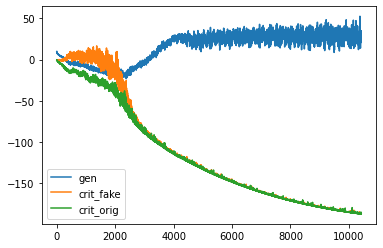

d loss fake  -187.02426147460938
d loss real  -186.75186157226562
[Epoch 30/100] [Batch 251/345] [D loss: -186.888062, acc:   0%] [G loss: 37.712079] [c1: 62.063278, c2: 62.572693, o: 57.323753, f: 50.650459] time: 6:44:59.833939
d loss fake  -187.02377319335938
d loss real  -187.02334594726562
[Epoch 30/100] [Batch 252/345] [D loss: -187.023560, acc:   0%] [G loss: 33.279325] [c1: 54.871056, c2: 55.404583, o: 71.651428, f: 59.159027] time: 6:45:02.114582
d loss fake  -187.10723876953125
d loss real  -187.18087768554688
[Epoch 30/100] [Batch 253/345] [D loss: -187.144058, acc:   0%] [G loss: 26.726407] [c1: 48.450089, c2: 49.457989, o: 64.771095, f: 57.986378] time: 6:45:04.403615
d loss fake  -186.78619384765625
d loss real  -187.142822265625
[Epoch 30/100] [Batch 254/345] [D loss: -186.964508, acc:   0%] [G loss: 24.735791] [c1: 40.632698, c2: 40.306522, o: 56.320572, f: 44.646416] time: 6:45:06.688098
d loss fake  -187.09100341796875
d loss real  -187.224853515625
[Epoch 30/100] [Ba

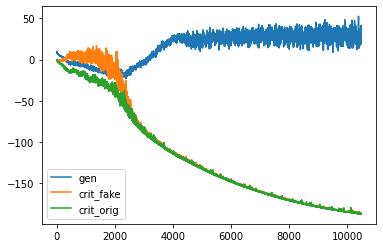

d loss fake  -187.35061645507812
d loss real  -187.26837158203125
[Epoch 30/100] [Batch 301/345] [D loss: -187.309494, acc:   0%] [G loss: 39.369273] [c1: 63.441139, c2: 63.425682, o: 67.797150, f: 57.137100] time: 6:46:55.619584
d loss fake  -186.952880859375
d loss real  -187.38885498046875
[Epoch 30/100] [Batch 302/345] [D loss: -187.170868, acc:   0%] [G loss: 30.781651] [c1: 48.920448, c2: 48.725021, o: 74.134399, f: 60.486263] time: 6:46:57.905052
d loss fake  -187.1596221923828
d loss real  -187.46018981933594
[Epoch 30/100] [Batch 303/345] [D loss: -187.309906, acc:   0%] [G loss: 25.832720] [c1: 40.637314, c2: 41.818726, o: 63.975464, f: 46.805920] time: 6:47:00.179104
d loss fake  -187.23635864257812
d loss real  -187.4079132080078
[Epoch 30/100] [Batch 304/345] [D loss: -187.322136, acc:   0%] [G loss: 33.749647] [c1: 59.900242, c2: 59.973198, o: 57.255234, f: 48.767117] time: 6:47:02.460523
d loss fake  -186.94813537597656
d loss real  -187.34979248046875
[Epoch 30/100] [Ba

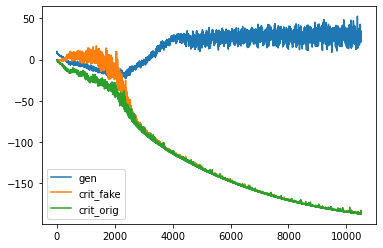

d loss fake  -187.45220947265625
d loss real  -187.43441772460938
[Epoch 31/100] [Batch 1/345] [D loss: -187.443314, acc:   0%] [G loss: 17.566969] [c1: 28.527962, c2: 28.277946, o: 46.965771, f: 36.489700] time: 6:48:32.117152
d loss fake  -187.4769744873047
d loss real  -187.6161346435547
[Epoch 31/100] [Batch 2/345] [D loss: -187.546555, acc:   0%] [G loss: 18.011039] [c1: 28.143440, c2: 28.909575, o: 36.678520, f: 28.046656] time: 6:48:34.480816
d loss fake  -187.05111694335938
d loss real  -187.63735961914062
[Epoch 31/100] [Batch 3/345] [D loss: -187.344238, acc:   0%] [G loss: 15.223395] [c1: 24.196848, c2: 24.607841, o: 37.685677, f: 29.017677] time: 6:48:36.849884
d loss fake  -187.4791259765625
d loss real  -187.5753173828125
[Epoch 31/100] [Batch 4/345] [D loss: -187.527222, acc:   0%] [G loss: 15.172133] [c1: 30.568527, c2: 31.314304, o: 28.736275, f: 23.299469] time: 6:48:39.156085
d loss fake  -187.55364990234375
d loss real  -187.61492919921875
[Epoch 31/100] [Batch 5/34

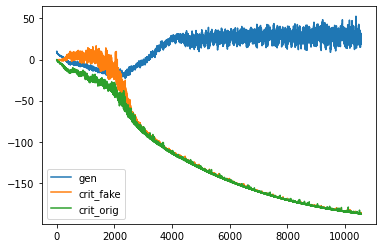

d loss fake  -187.79234313964844
d loss real  -187.83624267578125
[Epoch 31/100] [Batch 51/345] [D loss: -187.814293, acc:   0%] [G loss: 24.959416] [c1: 46.310478, c2: 47.126923, o: 42.801865, f: 36.689301] time: 6:50:27.060981
d loss fake  -187.7025146484375
d loss real  -187.6588134765625
[Epoch 31/100] [Batch 52/345] [D loss: -187.680664, acc:   0%] [G loss: 27.722434] [c1: 48.656715, c2: 47.345318, o: 56.910435, f: 46.478706] time: 6:50:29.357709
d loss fake  -187.72967529296875
d loss real  -187.70144653320312
[Epoch 31/100] [Batch 53/345] [D loss: -187.715561, acc:   0%] [G loss: 25.988070] [c1: 48.588432, c2: 47.794857, o: 59.460182, f: 46.043617] time: 6:50:31.641658
d loss fake  -187.62173461914062
d loss real  -187.81874084472656
[Epoch 31/100] [Batch 54/345] [D loss: -187.720238, acc:   0%] [G loss: 25.717595] [c1: 44.235855, c2: 44.757103, o: 60.243099, f: 45.256649] time: 6:50:33.925829
d loss fake  -187.65374755859375
d loss real  -187.73715209960938
[Epoch 31/100] [Batc

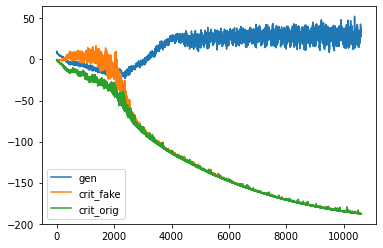

d loss fake  -187.91949462890625
d loss real  -188.07809448242188
[Epoch 31/100] [Batch 101/345] [D loss: -187.998795, acc:   0%] [G loss: 21.019420] [c1: 37.166229, c2: 35.868385, o: 57.912182, f: 48.239204] time: 6:52:22.956756
d loss fake  -187.96914672851562
d loss real  -188.10403442382812
[Epoch 31/100] [Batch 102/345] [D loss: -188.036591, acc:   0%] [G loss: 29.304398] [c1: 50.927555, c2: 50.091843, o: 47.393936, f: 37.718029] time: 6:52:25.241629
d loss fake  -187.6396026611328
d loss real  -188.01197814941406
[Epoch 31/100] [Batch 103/345] [D loss: -187.825790, acc:   0%] [G loss: 28.602202] [c1: 45.118004, c2: 44.973045, o: 63.361832, f: 46.899155] time: 6:52:27.517096
d loss fake  -187.9022216796875
d loss real  -188.04940795898438
[Epoch 31/100] [Batch 104/345] [D loss: -187.975815, acc:   0%] [G loss: 37.351242] [c1: 58.627949, c2: 59.986103, o: 58.923733, f: 48.321621] time: 6:52:29.799685
d loss fake  -187.86021423339844
d loss real  -188.11962890625
[Epoch 31/100] [Bat

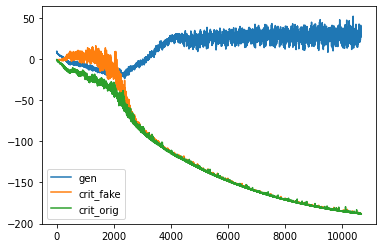

d loss fake  -187.85028076171875
d loss real  -188.229248046875
[Epoch 31/100] [Batch 151/345] [D loss: -188.039764, acc:   0%] [G loss: 42.924726] [c1: 72.423248, c2: 70.893677, o: 60.728008, f: 56.630550] time: 6:54:18.816718
d loss fake  -188.0855712890625
d loss real  -188.25723266601562
[Epoch 31/100] [Batch 152/345] [D loss: -188.171402, acc:   0%] [G loss: 42.194119] [c1: 68.851883, c2: 68.734787, o: 78.208824, f: 68.062317] time: 6:54:21.101390
d loss fake  -188.1715087890625
d loss real  -188.2660369873047
[Epoch 31/100] [Batch 153/345] [D loss: -188.218773, acc:   0%] [G loss: 38.492972] [c1: 63.341602, c2: 63.103897, o: 79.821411, f: 69.076210] time: 6:54:23.384286
d loss fake  -188.11581420898438
d loss real  -188.27890014648438
[Epoch 31/100] [Batch 154/345] [D loss: -188.197357, acc:   0%] [G loss: 37.263286] [c1: 62.309669, c2: 61.967876, o: 74.833817, f: 65.979950] time: 6:54:25.672371
d loss fake  -188.08474731445312
d loss real  -188.20298767089844
[Epoch 31/100] [Bat

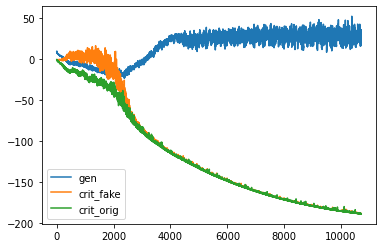

d loss fake  -187.79800415039062
d loss real  -188.39199829101562
[Epoch 31/100] [Batch 201/345] [D loss: -188.095001, acc:   0%] [G loss: 17.463572] [c1: 34.516407, c2: 35.168804, o: 46.929317, f: 38.032700] time: 6:56:13.844209
d loss fake  -187.8724822998047
d loss real  -188.50653076171875
[Epoch 31/100] [Batch 202/345] [D loss: -188.189507, acc:   0%] [G loss: 13.804985] [c1: 27.049187, c2: 26.973066, o: 46.290352, f: 33.809761] time: 6:56:16.131867
d loss fake  -188.21749877929688
d loss real  -187.54734802246094
[Epoch 31/100] [Batch 203/345] [D loss: -187.882423, acc:   0%] [G loss: 28.768331] [c1: 54.026596, c2: 53.076447, o: 35.258331, f: 33.459469] time: 6:56:18.406843
d loss fake  -188.205078125
d loss real  -188.1820068359375
[Epoch 31/100] [Batch 204/345] [D loss: -188.193542, acc:   0%] [G loss: 26.893733] [c1: 47.716949, c2: 48.218964, o: 62.176476, f: 52.806152] time: 6:56:20.691477
d loss fake  -188.12876892089844
d loss real  -188.18896484375
[Epoch 31/100] [Batch 20

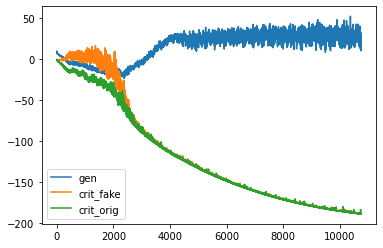

d loss fake  -188.28555297851562
d loss real  -188.5594482421875
[Epoch 31/100] [Batch 251/345] [D loss: -188.422501, acc:   0%] [G loss: 23.489841] [c1: 40.252300, c2: 40.041229, o: 53.898743, f: 43.246437] time: 6:58:09.682194
d loss fake  -188.25399780273438
d loss real  -188.62631225585938
[Epoch 31/100] [Batch 252/345] [D loss: -188.440155, acc:   0%] [G loss: 31.072883] [c1: 51.605659, c2: 50.216061, o: 51.895218, f: 44.479576] time: 6:58:11.973426
d loss fake  -188.51431274414062
d loss real  -188.62835693359375
[Epoch 31/100] [Batch 253/345] [D loss: -188.571335, acc:   0%] [G loss: 26.451886] [c1: 46.896034, c2: 46.482109, o: 57.019455, f: 49.608234] time: 6:58:14.257998
d loss fake  -188.42135620117188
d loss real  -188.71278381347656
[Epoch 31/100] [Batch 254/345] [D loss: -188.567070, acc:   0%] [G loss: 22.498140] [c1: 36.032806, c2: 36.330326, o: 55.981010, f: 42.746841] time: 6:58:16.543708
d loss fake  -188.3182373046875
d loss real  -187.8743133544922
[Epoch 31/100] [B

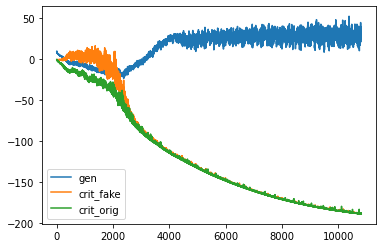

d loss fake  -188.75494384765625
d loss real  -188.77291870117188
[Epoch 31/100] [Batch 301/345] [D loss: -188.763931, acc:   0%] [G loss: 22.243263] [c1: 37.917915, c2: 38.933517, o: 49.355354, f: 36.895203] time: 7:00:05.723518
d loss fake  -188.68148803710938
d loss real  -188.33123779296875
[Epoch 31/100] [Batch 302/345] [D loss: -188.506363, acc:   0%] [G loss: 32.329961] [c1: 54.617714, c2: 54.897434, o: 47.388664, f: 39.473984] time: 7:00:08.005680
d loss fake  -188.7088623046875
d loss real  -188.80520629882812
[Epoch 31/100] [Batch 303/345] [D loss: -188.757034, acc:   0%] [G loss: 29.812617] [c1: 49.607002, c2: 48.753166, o: 63.992836, f: 53.772690] time: 7:00:10.283965
d loss fake  -188.7218780517578
d loss real  -188.74081420898438
[Epoch 31/100] [Batch 304/345] [D loss: -188.731346, acc:   0%] [G loss: 26.669998] [c1: 45.231812, c2: 44.453808, o: 60.388344, f: 48.892143] time: 7:00:12.566956
d loss fake  -188.5745849609375
d loss real  -187.71524047851562
[Epoch 31/100] [B

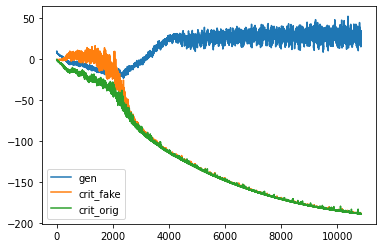

d loss fake  -188.76815795898438
d loss real  -189.03488159179688
[Epoch 32/100] [Batch 1/345] [D loss: -188.901520, acc:   0%] [G loss: 16.342425] [c1: 30.324978, c2: 29.623852, o: 41.789665, f: 33.487000] time: 7:01:40.688494
d loss fake  -188.6296844482422
d loss real  -188.97262573242188
[Epoch 32/100] [Batch 2/345] [D loss: -188.801155, acc:   0%] [G loss: 16.978253] [c1: 28.696194, c2: 27.468836, o: 40.561459, f: 29.176208] time: 7:01:43.014294
d loss fake  -187.81993103027344
d loss real  -189.0253143310547
[Epoch 32/100] [Batch 3/345] [D loss: -188.422623, acc:   0%] [G loss: 10.421137] [c1: 18.722391, c2: 17.919552, o: 40.072189, f: 28.243057] time: 7:01:45.329994
d loss fake  -188.82894897460938
d loss real  -189.02542114257812
[Epoch 32/100] [Batch 4/345] [D loss: -188.927185, acc:   0%] [G loss: 14.231450] [c1: 26.231503, c2: 26.373775, o: 28.585794, f: 18.799198] time: 7:01:47.665558
d loss fake  -188.5261993408203
d loss real  -189.05906677246094
[Epoch 32/100] [Batch 5/3

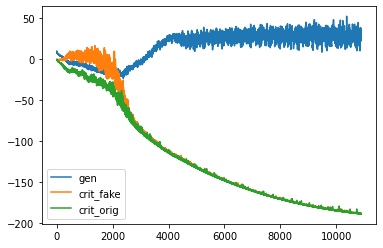

d loss fake  -189.05047607421875
d loss real  -189.17575073242188
[Epoch 32/100] [Batch 51/345] [D loss: -189.113113, acc:   0%] [G loss: 34.137575] [c1: 54.383011, c2: 53.705894, o: 61.357895, f: 51.221325] time: 7:03:35.870914
d loss fake  -188.87481689453125
d loss real  -189.23373413085938
[Epoch 32/100] [Batch 52/345] [D loss: -189.054276, acc:   0%] [G loss: 24.408090] [c1: 39.854256, c2: 39.015430, o: 63.825249, f: 51.059502] time: 7:03:38.150294
d loss fake  -188.98117065429688
d loss real  -189.16461181640625
[Epoch 32/100] [Batch 53/345] [D loss: -189.072891, acc:   0%] [G loss: 22.345851] [c1: 40.164009, c2: 40.538040, o: 52.014046, f: 38.163177] time: 7:03:40.430367
d loss fake  -189.14776611328125
d loss real  -189.05935668945312
[Epoch 32/100] [Batch 54/345] [D loss: -189.103561, acc:   0%] [G loss: 28.061086] [c1: 45.566425, c2: 45.824215, o: 53.862465, f: 39.168335] time: 7:03:42.707786
d loss fake  -189.01519775390625
d loss real  -188.94277954101562
[Epoch 32/100] [Ba

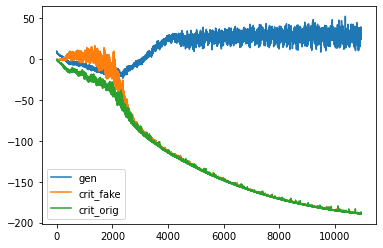

d loss fake  -189.0946044921875
d loss real  -189.3916015625
[Epoch 32/100] [Batch 101/345] [D loss: -189.243103, acc:   0%] [G loss: 21.297564] [c1: 36.442387, c2: 36.609276, o: 61.521732, f: 48.791603] time: 7:05:31.925462
d loss fake  -189.29104614257812
d loss real  -189.35598754882812
[Epoch 32/100] [Batch 102/345] [D loss: -189.323517, acc:   0%] [G loss: 20.193278] [c1: 37.151306, c2: 36.390518, o: 46.416210, f: 37.191063] time: 7:05:34.215661
d loss fake  -189.19952392578125
d loss real  -189.39300537109375
[Epoch 32/100] [Batch 103/345] [D loss: -189.296265, acc:   0%] [G loss: 20.519321] [c1: 34.384270, c2: 33.858448, o: 47.791866, f: 34.617645] time: 7:05:36.500622
d loss fake  -189.26583862304688
d loss real  -189.33880615234375
[Epoch 32/100] [Batch 104/345] [D loss: -189.302322, acc:   0%] [G loss: 27.183524] [c1: 42.797554, c2: 43.881165, o: 45.078377, f: 34.779102] time: 7:05:38.787807
d loss fake  -189.14559936523438
d loss real  -188.69798278808594
[Epoch 32/100] [Bat

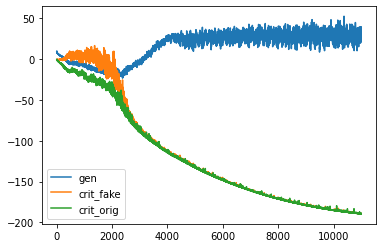

d loss fake  -189.43429565429688
d loss real  -189.5467529296875
[Epoch 32/100] [Batch 151/345] [D loss: -189.490524, acc:   0%] [G loss: 27.983714] [c1: 46.426746, c2: 46.072647, o: 74.099228, f: 61.437759] time: 7:07:28.113402
d loss fake  -189.32037353515625
d loss real  -189.45050048828125
[Epoch 32/100] [Batch 152/345] [D loss: -189.385437, acc:   0%] [G loss: 26.719649] [c1: 45.311531, c2: 44.623848, o: 52.030769, f: 45.848457] time: 7:07:30.409522
d loss fake  -189.4039306640625
d loss real  -189.39044189453125
[Epoch 32/100] [Batch 153/345] [D loss: -189.397186, acc:   0%] [G loss: 26.732047] [c1: 46.233955, c2: 46.933800, o: 54.285751, f: 45.079483] time: 7:07:32.703711
d loss fake  -189.30804443359375
d loss real  -189.56333923339844
[Epoch 32/100] [Batch 154/345] [D loss: -189.435692, acc:   0%] [G loss: 22.433400] [c1: 38.607754, c2: 39.939728, o: 56.317081, f: 45.055313] time: 7:07:34.996085
d loss fake  -189.41500854492188
d loss real  -189.58619689941406
[Epoch 32/100] [

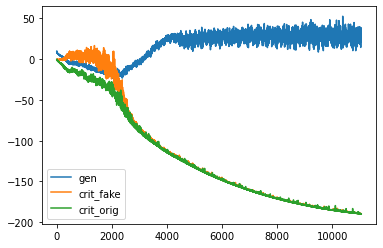

d loss fake  -189.66091918945312
d loss real  -189.74884033203125
[Epoch 32/100] [Batch 201/345] [D loss: -189.704880, acc:   0%] [G loss: 30.412593] [c1: 50.236755, c2: 51.676994, o: 64.309204, f: 50.458603] time: 7:09:23.060591
d loss fake  -189.35931396484375
d loss real  -189.777099609375
[Epoch 32/100] [Batch 202/345] [D loss: -189.568207, acc:   0%] [G loss: 21.147568] [c1: 39.503105, c2: 39.309631, o: 60.589558, f: 51.283188] time: 7:09:25.343647
d loss fake  -189.63619995117188
d loss real  -189.74822998046875
[Epoch 32/100] [Batch 203/345] [D loss: -189.692215, acc:   0%] [G loss: 27.837284] [c1: 49.888813, c2: 48.921345, o: 48.856785, f: 40.507305] time: 7:09:27.629589
d loss fake  -189.6279296875
d loss real  -189.79991149902344
[Epoch 32/100] [Batch 204/345] [D loss: -189.713921, acc:   0%] [G loss: 23.521038] [c1: 40.288494, c2: 39.737183, o: 56.154480, f: 45.838417] time: 7:09:29.921050
d loss fake  -189.63333129882812
d loss real  -189.76025390625
[Epoch 32/100] [Batch 2

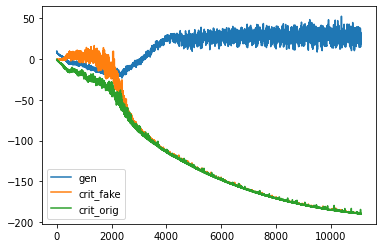

d loss fake  -189.5069580078125
d loss real  -189.44244384765625
[Epoch 32/100] [Batch 251/345] [D loss: -189.474701, acc:   0%] [G loss: 24.688413] [c1: 39.890263, c2: 39.141777, o: 49.665104, f: 38.225868] time: 7:11:19.283936
d loss fake  -189.61289978027344
d loss real  -189.23074340820312
[Epoch 32/100] [Batch 252/345] [D loss: -189.421822, acc:   0%] [G loss: 27.586439] [c1: 46.541580, c2: 45.648804, o: 49.955612, f: 42.212967] time: 7:11:21.577485
d loss fake  -189.7710418701172
d loss real  -189.7876739501953
[Epoch 32/100] [Batch 253/345] [D loss: -189.779358, acc:   0%] [G loss: 27.371995] [c1: 47.495255, c2: 47.402737, o: 58.194672, f: 48.415100] time: 7:11:23.856718
d loss fake  -189.11508178710938
d loss real  -189.79052734375
[Epoch 32/100] [Batch 254/345] [D loss: -189.452805, acc:   0%] [G loss: 20.825059] [c1: 37.820366, c2: 36.701691, o: 55.503510, f: 42.829998] time: 7:11:26.149544
d loss fake  -189.80227661132812
d loss real  -189.8831787109375
[Epoch 32/100] [Batch

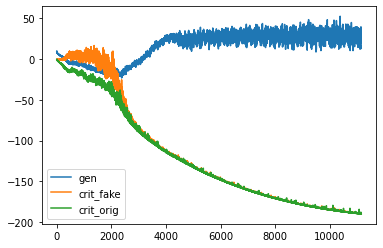

d loss fake  -189.92050170898438
d loss real  -189.94467163085938
[Epoch 32/100] [Batch 301/345] [D loss: -189.932587, acc:   0%] [G loss: 25.028695] [c1: 41.576794, c2: 40.869503, o: 37.043129, f: 27.662832] time: 7:13:15.101417
d loss fake  -190.018310546875
d loss real  -190.08612060546875
[Epoch 32/100] [Batch 302/345] [D loss: -190.052216, acc:   0%] [G loss: 20.593456] [c1: 34.644939, c2: 35.585178, o: 51.535500, f: 40.865341] time: 7:13:17.393906
d loss fake  -189.5081024169922
d loss real  -190.0735321044922
[Epoch 32/100] [Batch 303/345] [D loss: -189.790817, acc:   0%] [G loss: 16.559336] [c1: 24.461252, c2: 24.721474, o: 43.523396, f: 29.156178] time: 7:13:19.667295
d loss fake  -189.82293701171875
d loss real  -190.10833740234375
[Epoch 32/100] [Batch 304/345] [D loss: -189.965637, acc:   0%] [G loss: 15.121562] [c1: 26.588051, c2: 26.092039, o: 39.591980, f: 29.425568] time: 7:13:21.958121
d loss fake  -188.2845458984375
d loss real  -179.5829620361328
[Epoch 32/100] [Batc

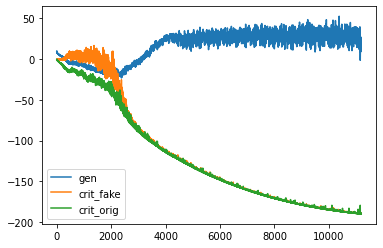

d loss fake  -188.87155151367188
d loss real  -190.13816833496094
[Epoch 33/100] [Batch 1/345] [D loss: -189.504860, acc:   0%] [G loss: 10.875168] [c1: 14.367141, c2: 14.039623, o: 46.759842, f: 26.518223] time: 7:14:50.465897
d loss fake  -189.46334838867188
d loss real  -190.15194702148438
[Epoch 33/100] [Batch 2/345] [D loss: -189.807648, acc:   0%] [G loss: 7.045560] [c1: 9.675291, c2: 9.472449, o: 30.275829, f: 14.983336] time: 7:14:52.802966
d loss fake  -189.93954467773438
d loss real  -189.98663330078125
[Epoch 33/100] [Batch 3/345] [D loss: -189.963089, acc:   0%] [G loss: 13.118590] [c1: 23.496347, c2: 21.609463, o: 25.830688, f: 13.788635] time: 7:14:55.145746
d loss fake  -189.39883422851562
d loss real  -190.00872802734375
[Epoch 33/100] [Batch 4/345] [D loss: -189.703781, acc:   0%] [G loss: 11.099043] [c1: 19.918644, c2: 18.892231, o: 33.663475, f: 21.430225] time: 7:14:57.460612
d loss fake  -189.20925903320312
d loss real  -190.25375366210938
[Epoch 33/100] [Batch 5/3

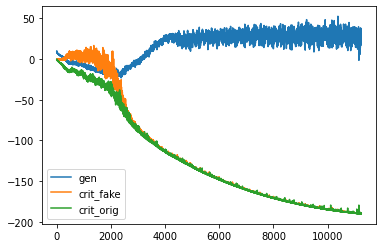

d loss fake  -190.22006225585938
d loss real  -190.39764404296875
[Epoch 33/100] [Batch 51/345] [D loss: -190.308853, acc:   0%] [G loss: 21.749761] [c1: 35.921432, c2: 38.636005, o: 49.939480, f: 35.632980] time: 7:16:45.601106
d loss fake  -190.28477478027344
d loss real  -190.3805694580078
[Epoch 33/100] [Batch 52/345] [D loss: -190.332672, acc:   0%] [G loss: 21.125556] [c1: 33.347706, c2: 31.836315, o: 48.433487, f: 35.550941] time: 7:16:47.897894
d loss fake  -190.09530639648438
d loss real  -190.29718017578125
[Epoch 33/100] [Batch 53/345] [D loss: -190.196243, acc:   0%] [G loss: 29.578095] [c1: 46.446598, c2: 43.767849, o: 50.769012, f: 40.571739] time: 7:16:50.174281
d loss fake  -190.26011657714844
d loss real  -190.4203338623047
[Epoch 33/100] [Batch 54/345] [D loss: -190.340225, acc:   0%] [G loss: 29.539018] [c1: 49.163490, c2: 47.163078, o: 54.723492, f: 43.652214] time: 7:16:52.450809
d loss fake  -189.18734741210938
d loss real  -190.3388671875
[Epoch 33/100] [Batch 55

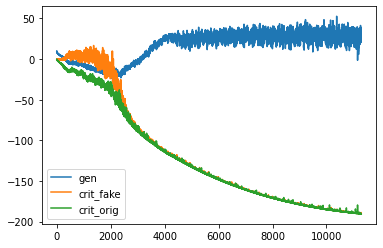

d loss fake  -190.53134155273438
d loss real  -190.6363983154297
[Epoch 33/100] [Batch 101/345] [D loss: -190.583870, acc:   0%] [G loss: 23.747157] [c1: 41.166237, c2: 39.990170, o: 53.515862, f: 42.474831] time: 7:18:41.674976
d loss fake  -190.43115234375
d loss real  -190.27410888671875
[Epoch 33/100] [Batch 102/345] [D loss: -190.352631, acc:   0%] [G loss: 29.985795] [c1: 46.114849, c2: 44.750271, o: 50.522217, f: 35.990288] time: 7:18:43.961537
d loss fake  -190.3668670654297
d loss real  -190.49722290039062
[Epoch 33/100] [Batch 103/345] [D loss: -190.432045, acc:   0%] [G loss: 29.899577] [c1: 44.121811, c2: 43.968151, o: 62.280506, f: 43.965508] time: 7:18:46.252377
d loss fake  -190.4017333984375
d loss real  -190.5297393798828
[Epoch 33/100] [Batch 104/345] [D loss: -190.465736, acc:   0%] [G loss: 27.372670] [c1: 44.343193, c2: 44.631836, o: 62.030781, f: 47.486351] time: 7:18:48.544455
d loss fake  -190.363037109375
d loss real  -190.4580078125
[Epoch 33/100] [Batch 105/3

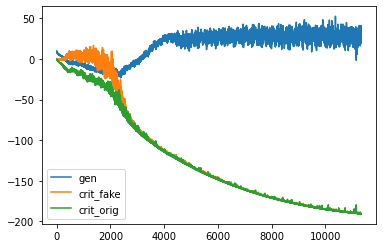

d loss fake  -190.57492065429688
d loss real  -190.72128295898438
[Epoch 33/100] [Batch 151/345] [D loss: -190.648102, acc:   0%] [G loss: 31.877554] [c1: 52.188786, c2: 50.519325, o: 61.751076, f: 53.941040] time: 7:20:37.549962
d loss fake  -190.63150024414062
d loss real  -190.67105102539062
[Epoch 33/100] [Batch 152/345] [D loss: -190.651276, acc:   0%] [G loss: 29.482159] [c1: 48.045193, c2: 47.947624, o: 61.534752, f: 51.479256] time: 7:20:39.841275
d loss fake  -190.61375427246094
d loss real  -190.68145751953125
[Epoch 33/100] [Batch 153/345] [D loss: -190.647606, acc:   0%] [G loss: 31.516644] [c1: 50.260033, c2: 50.537628, o: 57.374542, f: 46.841747] time: 7:20:42.119570
d loss fake  -190.53558349609375
d loss real  -190.6747283935547
[Epoch 33/100] [Batch 154/345] [D loss: -190.605156, acc:   0%] [G loss: 27.577607] [c1: 43.636742, c2: 45.646851, o: 57.242661, f: 49.814331] time: 7:20:44.416736
d loss fake  -190.58580017089844
d loss real  -190.73963928222656
[Epoch 33/100] 

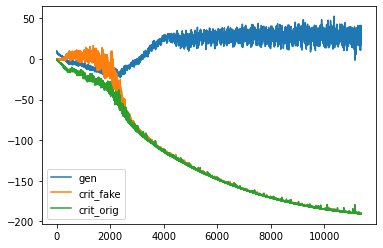

d loss fake  -190.76971435546875
d loss real  -190.89602661132812
[Epoch 33/100] [Batch 201/345] [D loss: -190.832870, acc:   0%] [G loss: 22.195863] [c1: 39.414879, c2: 38.788345, o: 57.018116, f: 43.849731] time: 7:22:32.294726
d loss fake  -190.35317993164062
d loss real  -190.9288787841797
[Epoch 33/100] [Batch 202/345] [D loss: -190.641029, acc:   0%] [G loss: 17.240987] [c1: 29.097095, c2: 29.064358, o: 49.782852, f: 36.551186] time: 7:22:34.563628
d loss fake  -190.6923828125
d loss real  -190.69961547851562
[Epoch 33/100] [Batch 203/345] [D loss: -190.695999, acc:   0%] [G loss: 21.081779] [c1: 35.904850, c2: 35.968666, o: 43.056110, f: 30.950289] time: 7:22:36.839880
d loss fake  -190.68527221679688
d loss real  -190.8177032470703
[Epoch 33/100] [Batch 204/345] [D loss: -190.751488, acc:   0%] [G loss: 20.299369] [c1: 36.018166, c2: 36.420425, o: 48.307949, f: 33.867474] time: 7:22:39.120270
d loss fake  -190.7912139892578
d loss real  -190.5762939453125
[Epoch 33/100] [Batch 

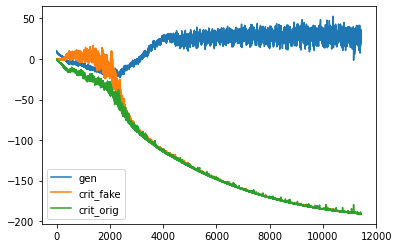

d loss fake  -190.93284606933594
d loss real  -190.9029541015625
[Epoch 33/100] [Batch 251/345] [D loss: -190.917900, acc:   0%] [G loss: 30.627309] [c1: 48.266212, c2: 48.833195, o: 61.640762, f: 47.323402] time: 7:24:27.833152
d loss fake  -190.9251708984375
d loss real  -191.03390502929688
[Epoch 33/100] [Batch 252/345] [D loss: -190.979538, acc:   0%] [G loss: 30.091248] [c1: 46.118546, c2: 45.013214, o: 71.413513, f: 52.463356] time: 7:24:30.113513
d loss fake  -190.7550506591797
d loss real  -191.05210876464844
[Epoch 33/100] [Batch 253/345] [D loss: -190.903580, acc:   0%] [G loss: 25.275626] [c1: 35.727623, c2: 36.360100, o: 58.807373, f: 39.786331] time: 7:24:32.385943
d loss fake  -190.97845458984375
d loss real  -190.96234130859375
[Epoch 33/100] [Batch 254/345] [D loss: -190.970398, acc:   0%] [G loss: 28.944608] [c1: 47.531914, c2: 47.375980, o: 54.938400, f: 41.921608] time: 7:24:34.660450
d loss fake  -190.8638153076172
d loss real  -191.05812072753906
[Epoch 33/100] [Ba

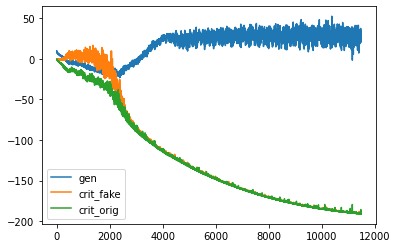

d loss fake  -191.1431427001953
d loss real  -191.17335510253906
[Epoch 33/100] [Batch 301/345] [D loss: -191.158249, acc:   0%] [G loss: 26.122851] [c1: 42.623962, c2: 42.347000, o: 49.983776, f: 38.147011] time: 7:26:23.308027
d loss fake  -190.9635467529297
d loss real  -190.6407470703125
[Epoch 33/100] [Batch 302/345] [D loss: -190.802147, acc:   0%] [G loss: 27.645207] [c1: 40.347824, c2: 40.198151, o: 53.409134, f: 40.143410] time: 7:26:25.578453
d loss fake  -191.11280822753906
d loss real  -191.1584014892578
[Epoch 33/100] [Batch 303/345] [D loss: -191.135605, acc:   0%] [G loss: 30.256054] [c1: 44.750198, c2: 44.424240, o: 60.101303, f: 41.039803] time: 7:26:27.859554
d loss fake  -191.10348510742188
d loss real  -190.95445251464844
[Epoch 33/100] [Batch 304/345] [D loss: -191.028969, acc:   0%] [G loss: 36.733574] [c1: 57.356506, c2: 55.916611, o: 58.811790, f: 46.949192] time: 7:26:30.126874
d loss fake  -191.0684051513672
d loss real  -191.1544647216797
[Epoch 33/100] [Batc

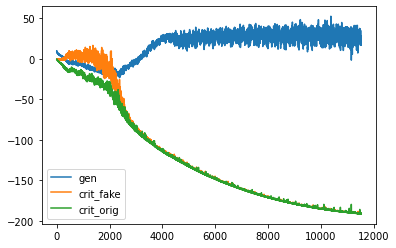

d loss fake  -190.79678344726562
d loss real  -191.32342529296875
[Epoch 34/100] [Batch 1/345] [D loss: -191.060104, acc:   0%] [G loss: 17.172393] [c1: 24.300598, c2: 24.827431, o: 48.689289, f: 30.176136] time: 7:27:59.760676
d loss fake  -190.9808349609375
d loss real  -191.28378295898438
[Epoch 34/100] [Batch 2/345] [D loss: -191.132309, acc:   0%] [G loss: 16.299959] [c1: 26.798241, c2: 26.096355, o: 39.124851, f: 25.318586] time: 7:28:02.114688
d loss fake  -191.14903259277344
d loss real  -191.23843383789062
[Epoch 34/100] [Batch 3/345] [D loss: -191.193733, acc:   0%] [G loss: 20.672204] [c1: 30.681992, c2: 30.877281, o: 43.594318, f: 25.510096] time: 7:28:04.450645
d loss fake  -190.2122802734375
d loss real  -191.2243194580078
[Epoch 34/100] [Batch 4/345] [D loss: -190.718300, acc:   0%] [G loss: 16.990374] [c1: 20.919937, c2: 21.214891, o: 50.743652, f: 27.549168] time: 7:28:06.790592
d loss fake  -191.17405700683594
d loss real  -191.29608154296875
[Epoch 34/100] [Batch 5/3

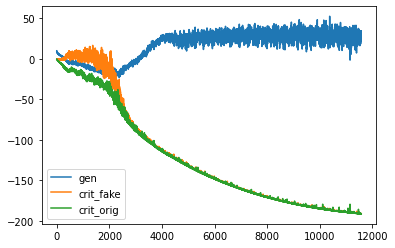

d loss fake  -191.3897705078125
d loss real  -191.2948760986328
[Epoch 34/100] [Batch 51/345] [D loss: -191.342323, acc:   0%] [G loss: 33.519552] [c1: 50.480721, c2: 49.945309, o: 67.561218, f: 50.699265] time: 7:29:54.689436
d loss fake  -191.26303100585938
d loss real  -191.29275512695312
[Epoch 34/100] [Batch 52/345] [D loss: -191.277893, acc:   0%] [G loss: 33.220853] [c1: 49.627964, c2: 49.844357, o: 71.348244, f: 51.395039] time: 7:29:56.975525
d loss fake  -191.39979553222656
d loss real  -191.49273681640625
[Epoch 34/100] [Batch 53/345] [D loss: -191.446266, acc:   0%] [G loss: 28.554673] [c1: 42.934677, c2: 44.067436, o: 70.714752, f: 49.614662] time: 7:29:59.263973
d loss fake  -191.16798400878906
d loss real  -191.54214477539062
[Epoch 34/100] [Batch 54/345] [D loss: -191.355064, acc:   0%] [G loss: 40.883974] [c1: 60.660248, c2: 59.420784, o: 61.892906, f: 47.155930] time: 7:30:01.538832
d loss fake  -191.42123413085938
d loss real  -191.4873046875
[Epoch 34/100] [Batch 55

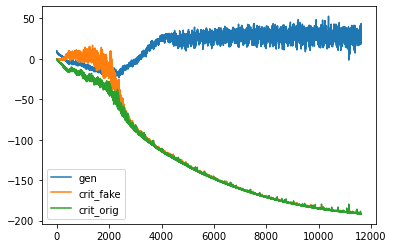

d loss fake  -191.4576873779297
d loss real  -191.7404327392578
[Epoch 34/100] [Batch 101/345] [D loss: -191.599060, acc:   0%] [G loss: 19.783847] [c1: 30.376278, c2: 30.961445, o: 56.217281, f: 37.041016] time: 7:31:50.499549
d loss fake  -191.57431030273438
d loss real  -191.74014282226562
[Epoch 34/100] [Batch 102/345] [D loss: -191.657227, acc:   0%] [G loss: 19.276820] [c1: 31.590637, c2: 29.886152, o: 47.346779, f: 34.253609] time: 7:31:52.779534
d loss fake  -191.62722778320312
d loss real  -191.68563842773438
[Epoch 34/100] [Batch 103/345] [D loss: -191.656433, acc:   0%] [G loss: 24.943229] [c1: 40.211838, c2: 39.309212, o: 44.396278, f: 29.275156] time: 7:31:55.056543
d loss fake  -191.53662109375
d loss real  -191.709716796875
[Epoch 34/100] [Batch 104/345] [D loss: -191.623169, acc:   0%] [G loss: 24.581330] [c1: 35.519928, c2: 35.403309, o: 56.529839, f: 38.988960] time: 7:31:57.336100
d loss fake  -191.4568328857422
d loss real  -191.226318359375
[Epoch 34/100] [Batch 10

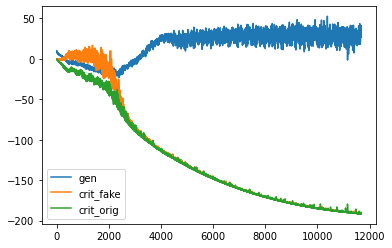

d loss fake  -191.66311645507812
d loss real  -191.82284545898438
[Epoch 34/100] [Batch 151/345] [D loss: -191.742981, acc:   0%] [G loss: 31.177518] [c1: 46.273079, c2: 44.855755, o: 77.679558, f: 60.175476] time: 7:33:46.253964
d loss fake  -191.70550537109375
d loss real  -191.87005615234375
[Epoch 34/100] [Batch 152/345] [D loss: -191.787781, acc:   0%] [G loss: 28.501584] [c1: 43.833054, c2: 42.953667, o: 65.121231, f: 52.058788] time: 7:33:48.543996
d loss fake  -191.67056274414062
d loss real  -191.82559204101562
[Epoch 34/100] [Batch 153/345] [D loss: -191.748077, acc:   0%] [G loss: 21.573433] [c1: 36.089172, c2: 35.971626, o: 53.494968, f: 40.714859] time: 7:33:50.813089
d loss fake  -191.288330078125
d loss real  -191.823486328125
[Epoch 34/100] [Batch 154/345] [D loss: -191.555908, acc:   0%] [G loss: 19.641580] [c1: 29.698284, c2: 30.498264, o: 46.142105, f: 33.537285] time: 7:33:53.092390
d loss fake  -191.6759033203125
d loss real  -191.88400268554688
[Epoch 34/100] [Bat

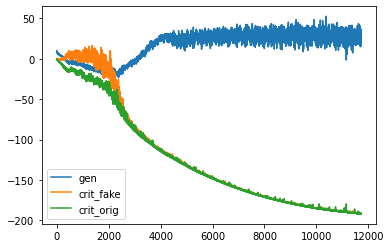

d loss fake  -191.5752716064453
d loss real  -191.990478515625
[Epoch 34/100] [Batch 201/345] [D loss: -191.782875, acc:   0%] [G loss: 35.596979] [c1: 56.389008, c2: 55.209225, o: 52.166481, f: 40.327991] time: 7:35:40.657707
d loss fake  -191.86251831054688
d loss real  -191.98385620117188
[Epoch 34/100] [Batch 202/345] [D loss: -191.923187, acc:   0%] [G loss: 29.751451] [c1: 47.129753, c2: 45.651451, o: 68.469475, f: 52.465065] time: 7:35:42.930026
d loss fake  -191.85418701171875
d loss real  -191.6070556640625
[Epoch 34/100] [Batch 203/345] [D loss: -191.730621, acc:   0%] [G loss: 32.494431] [c1: 52.786091, c2: 52.905602, o: 62.375893, f: 48.685249] time: 7:35:45.208998
d loss fake  -191.83287048339844
d loss real  -191.9779815673828
[Epoch 34/100] [Batch 204/345] [D loss: -191.905426, acc:   0%] [G loss: 29.853622] [c1: 42.919117, c2: 42.680576, o: 67.285248, f: 50.756767] time: 7:35:47.492986
d loss fake  -191.58450317382812
d loss real  -192.01048278808594
[Epoch 34/100] [Bat

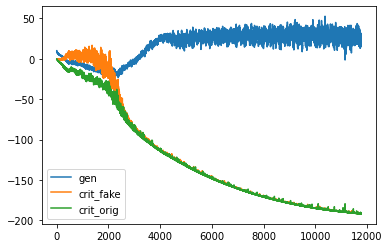

d loss fake  -191.91152954101562
d loss real  -192.06918334960938
[Epoch 34/100] [Batch 251/345] [D loss: -191.990356, acc:   0%] [G loss: 15.464812] [c1: 19.728279, c2: 21.701229, o: 54.364658, f: 34.073128] time: 7:37:36.430513
d loss fake  -191.95401000976562
d loss real  -191.96876525878906
[Epoch 34/100] [Batch 252/345] [D loss: -191.961388, acc:   0%] [G loss: 21.458261] [c1: 31.841118, c2: 31.739418, o: 34.949955, f: 20.106110] time: 7:37:38.704959
d loss fake  -191.91683959960938
d loss real  -191.79507446289062
[Epoch 34/100] [Batch 253/345] [D loss: -191.855957, acc:   0%] [G loss: 24.015655] [c1: 34.550480, c2: 33.796673, o: 49.055450, f: 31.190260] time: 7:37:40.990883
d loss fake  -192.01258850097656
d loss real  -192.1566619873047
[Epoch 34/100] [Batch 254/345] [D loss: -192.084625, acc:   0%] [G loss: 22.113178] [c1: 32.055840, c2: 30.374744, o: 54.003922, f: 36.609406] time: 7:37:43.264780
d loss fake  -191.92254638671875
d loss real  -192.07627868652344
[Epoch 34/100] 

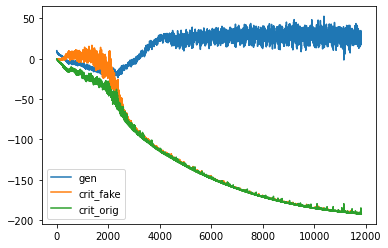

d loss fake  -192.16555786132812
d loss real  -192.27011108398438
[Epoch 34/100] [Batch 301/345] [D loss: -192.217834, acc:   0%] [G loss: 23.391545] [c1: 33.194420, c2: 33.609890, o: 45.977669, f: 29.669159] time: 7:39:31.875987
d loss fake  -192.11508178710938
d loss real  -192.24618530273438
[Epoch 34/100] [Batch 302/345] [D loss: -192.180634, acc:   0%] [G loss: 17.878265] [c1: 25.469730, c2: 26.140423, o: 47.029167, f: 32.512501] time: 7:39:34.154145
d loss fake  -192.18807983398438
d loss real  -192.21717834472656
[Epoch 34/100] [Batch 303/345] [D loss: -192.202629, acc:   0%] [G loss: 22.637731] [c1: 35.799049, c2: 35.486740, o: 44.005207, f: 30.362198] time: 7:39:36.430581
d loss fake  -192.16802978515625
d loss real  -192.21571350097656
[Epoch 34/100] [Batch 304/345] [D loss: -192.191872, acc:   0%] [G loss: 20.842875] [c1: 29.761900, c2: 29.005112, o: 49.038956, f: 33.740768] time: 7:39:38.713155
d loss fake  -191.44744873046875
d loss real  -192.3190155029297
[Epoch 34/100] 

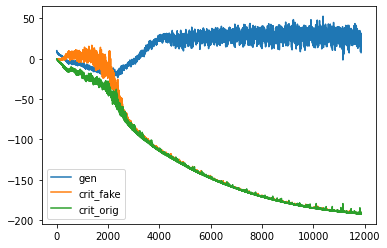

d loss fake  -191.87374877929688
d loss real  -192.37014770507812
[Epoch 35/100] [Batch 1/345] [D loss: -192.121948, acc:   0%] [G loss: 10.905760] [c1: 14.800019, c2: 13.709278, o: 29.175671, f: 12.336049] time: 7:41:08.099772
d loss fake  -192.07351684570312
d loss real  -192.28201293945312
[Epoch 35/100] [Batch 2/345] [D loss: -192.177765, acc:   0%] [G loss: 11.688021] [c1: 17.491669, c2: 15.300156, o: 29.218868, f: 13.100393] time: 7:41:10.443953
d loss fake  -192.19265747070312
d loss real  -192.3970184326172
[Epoch 35/100] [Batch 3/345] [D loss: -192.294838, acc:   0%] [G loss: 15.161339] [c1: 19.806494, c2: 19.240244, o: 37.906982, f: 17.560644] time: 7:41:12.783662
d loss fake  -190.92324829101562
d loss real  -192.33877563476562
[Epoch 35/100] [Batch 4/345] [D loss: -191.631012, acc:   0%] [G loss: 8.093561] [c1: 8.116417, c2: 8.334542, o: 38.466042, f: 17.921490] time: 7:41:15.094471
d loss fake  -192.1208038330078
d loss real  -192.32693481445312
[Epoch 35/100] [Batch 5/345

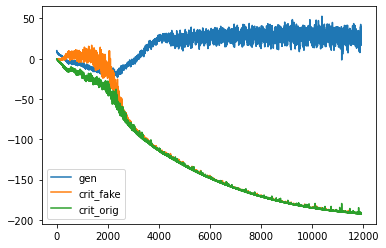

d loss fake  -192.42123413085938
d loss real  -192.60122680664062
[Epoch 35/100] [Batch 51/345] [D loss: -192.511230, acc:   0%] [G loss: 23.334821] [c1: 33.030567, c2: 33.373875, o: 60.802177, f: 42.298950] time: 7:43:02.931020
d loss fake  -192.45773315429688
d loss real  -192.57867431640625
[Epoch 35/100] [Batch 52/345] [D loss: -192.518204, acc:   0%] [G loss: 22.648521] [c1: 32.221111, c2: 31.965799, o: 51.278435, f: 31.721119] time: 7:43:05.218444
d loss fake  -192.23757934570312
d loss real  -192.5474853515625
[Epoch 35/100] [Batch 53/345] [D loss: -192.392532, acc:   0%] [G loss: 19.767422] [c1: 26.481434, c2: 26.533489, o: 51.394447, f: 31.279581] time: 7:43:07.498596
d loss fake  -192.42713928222656
d loss real  -192.4905242919922
[Epoch 35/100] [Batch 54/345] [D loss: -192.458832, acc:   0%] [G loss: 20.800117] [c1: 30.958429, c2: 30.979221, o: 44.157269, f: 26.042515] time: 7:43:09.790636
d loss fake  -192.4569091796875
d loss real  -192.58670043945312
[Epoch 35/100] [Batch

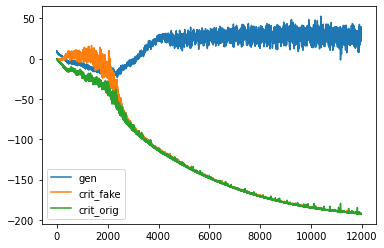

d loss fake  -192.62945556640625
d loss real  -192.723876953125
[Epoch 35/100] [Batch 101/345] [D loss: -192.676666, acc:   0%] [G loss: 26.379619] [c1: 38.821533, c2: 38.773983, o: 60.819008, f: 40.612740] time: 7:44:58.851799
d loss fake  -191.9768524169922
d loss real  -191.14633178710938
[Epoch 35/100] [Batch 102/345] [D loss: -191.561592, acc:   0%] [G loss: 26.258188] [c1: 36.913288, c2: 37.535263, o: 57.323402, f: 37.432945] time: 7:45:01.126640
d loss fake  -192.60691833496094
d loss real  -192.33993530273438
[Epoch 35/100] [Batch 103/345] [D loss: -192.473427, acc:   0%] [G loss: 32.724975] [c1: 45.179932, c2: 44.844772, o: 59.723022, f: 36.513168] time: 7:45:03.401542
d loss fake  -192.61111450195312
d loss real  -192.72763061523438
[Epoch 35/100] [Batch 104/345] [D loss: -192.669373, acc:   0%] [G loss: 29.297899] [c1: 44.800610, c2: 44.527035, o: 67.969727, f: 47.700089] time: 7:45:05.669646
d loss fake  -192.1680908203125
d loss real  -192.66880798339844
[Epoch 35/100] [Ba

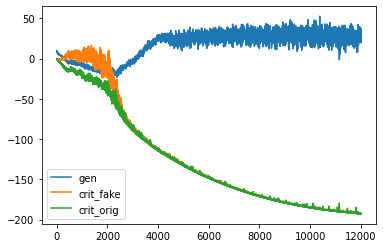

d loss fake  -192.65380859375
d loss real  -192.71405029296875
[Epoch 35/100] [Batch 151/345] [D loss: -192.683929, acc:   0%] [G loss: 28.146692] [c1: 44.361946, c2: 43.809486, o: 47.117493, f: 33.989838] time: 7:46:54.398048
d loss fake  -192.63710021972656
d loss real  -192.83273315429688
[Epoch 35/100] [Batch 152/345] [D loss: -192.734917, acc:   0%] [G loss: 23.836272] [c1: 34.444084, c2: 35.000809, o: 58.914318, f: 41.696682] time: 7:46:56.684588
d loss fake  -192.71237182617188
d loss real  -192.84744262695312
[Epoch 35/100] [Batch 153/345] [D loss: -192.779907, acc:   0%] [G loss: 25.086788] [c1: 38.526924, c2: 39.429287, o: 51.578629, f: 39.324562] time: 7:46:58.961968
d loss fake  -192.541259765625
d loss real  -192.7771453857422
[Epoch 35/100] [Batch 154/345] [D loss: -192.659203, acc:   0%] [G loss: 20.837597] [c1: 30.822992, c2: 31.553654, o: 51.208679, f: 33.585026] time: 7:47:01.243537
d loss fake  -192.77108764648438
d loss real  -192.891845703125
[Epoch 35/100] [Batch 

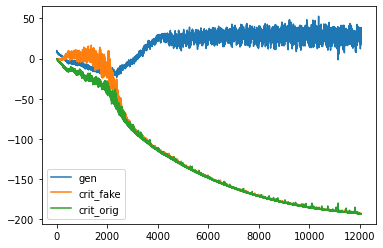

d loss fake  -192.80703735351562
d loss real  -192.98167419433594
[Epoch 35/100] [Batch 201/345] [D loss: -192.894356, acc:   0%] [G loss: 24.713827] [c1: 38.362450, c2: 37.228279, o: 46.562149, f: 33.822552] time: 7:48:49.053053
d loss fake  -192.57992553710938
d loss real  -192.87234497070312
[Epoch 35/100] [Batch 202/345] [D loss: -192.726135, acc:   0%] [G loss: 34.792852] [c1: 52.845085, c2: 52.177284, o: 53.688843, f: 37.190659] time: 7:48:51.326362
d loss fake  -192.84445190429688
d loss real  -192.97998046875
[Epoch 35/100] [Batch 203/345] [D loss: -192.912216, acc:   0%] [G loss: 30.612287] [c1: 45.278656, c2: 45.667557, o: 70.371178, f: 51.937759] time: 7:48:53.591737
d loss fake  -192.70225524902344
d loss real  -193.04989624023438
[Epoch 35/100] [Batch 204/345] [D loss: -192.876076, acc:   0%] [G loss: 22.691030] [c1: 32.963989, c2: 33.638687, o: 61.928043, f: 46.416702] time: 7:48:55.875154
d loss fake  -192.9004669189453
d loss real  -192.75096130371094
[Epoch 35/100] [Ba

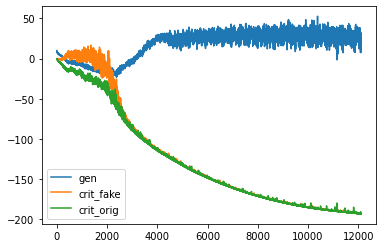

d loss fake  -192.94752502441406
d loss real  -191.9997100830078
[Epoch 35/100] [Batch 251/345] [D loss: -192.473618, acc:   0%] [G loss: 18.940841] [c1: 27.790737, c2: 27.499077, o: 27.061375, f: 11.649335] time: 7:50:44.598436
d loss fake  -193.04122924804688
d loss real  -193.06300354003906
[Epoch 35/100] [Batch 252/345] [D loss: -193.052116, acc:   0%] [G loss: 22.393652] [c1: 34.559700, c2: 35.146530, o: 53.091911, f: 30.512127] time: 7:50:46.884639
d loss fake  -192.97134399414062
d loss real  -192.80410766601562
[Epoch 35/100] [Batch 253/345] [D loss: -192.887726, acc:   0%] [G loss: 26.662417] [c1: 39.766941, c2: 40.273209, o: 49.259361, f: 34.145042] time: 7:50:49.167398
d loss fake  -192.90606689453125
d loss real  -193.16835021972656
[Epoch 35/100] [Batch 254/345] [D loss: -193.037209, acc:   0%] [G loss: 19.600729] [c1: 26.452885, c2: 26.721523, o: 61.129539, f: 41.916664] time: 7:50:51.449198
d loss fake  -192.89205932617188
d loss real  -193.17098999023438
[Epoch 35/100] 

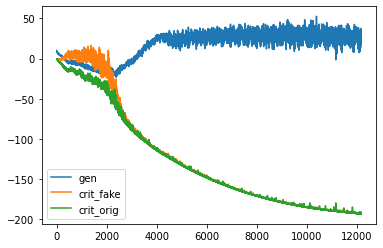

d loss fake  -193.10800170898438
d loss real  -193.24160766601562
[Epoch 35/100] [Batch 301/345] [D loss: -193.174805, acc:   0%] [G loss: 19.840359] [c1: 30.177380, c2: 28.688496, o: 50.632240, f: 32.941284] time: 7:52:40.219370
d loss fake  -192.61436462402344
d loss real  -193.1892852783203
[Epoch 35/100] [Batch 302/345] [D loss: -192.901825, acc:   0%] [G loss: 8.647583] [c1: 10.687206, c2: 11.334820, o: 44.833729, f: 23.113970] time: 7:52:42.498052
d loss fake  -193.10324096679688
d loss real  -192.91464233398438
[Epoch 35/100] [Batch 303/345] [D loss: -193.008942, acc:   0%] [G loss: 19.220632] [c1: 29.582592, c2: 29.262268, o: 31.221928, f: 14.251111] time: 7:52:44.773788
d loss fake  -193.0231475830078
d loss real  -192.49200439453125
[Epoch 35/100] [Batch 304/345] [D loss: -192.757576, acc:   0%] [G loss: 24.961376] [c1: 37.432301, c2: 35.492409, o: 43.969410, f: 31.434580] time: 7:52:47.056036
d loss fake  -193.0931396484375
d loss real  -192.718505859375
[Epoch 35/100] [Batc

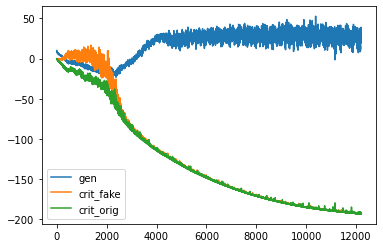

d loss fake  -192.65330505371094
d loss real  -193.34173583984375
[Epoch 36/100] [Batch 1/345] [D loss: -192.997520, acc:   0%] [G loss: 12.394688] [c1: 13.565105, c2: 12.374296, o: 54.050720, f: 34.910072] time: 7:54:15.034710
d loss fake  -193.08795166015625
d loss real  -193.0652313232422
[Epoch 36/100] [Batch 2/345] [D loss: -193.076591, acc:   0%] [G loss: 15.504575] [c1: 18.045694, c2: 17.705875, o: 27.902107, f: 9.128126] time: 7:54:17.411815
d loss fake  -193.0248260498047
d loss real  -192.90969848632812
[Epoch 36/100] [Batch 3/345] [D loss: -192.967262, acc:   0%] [G loss: 22.545625] [c1: 25.778038, c2: 26.483103, o: 40.434544, f: 17.402046] time: 7:54:19.785880
d loss fake  -192.58953857421875
d loss real  -193.33050537109375
[Epoch 36/100] [Batch 4/345] [D loss: -192.960022, acc:   0%] [G loss: 17.201791] [c1: 19.081005, c2: 21.087032, o: 52.380333, f: 27.355330] time: 7:54:22.164946
d loss fake  -193.0673828125
d loss real  -193.30172729492188
[Epoch 36/100] [Batch 5/345] 

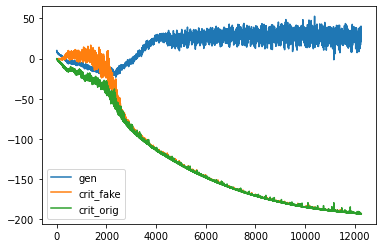

d loss fake  -193.33602905273438
d loss real  -193.51292419433594
[Epoch 36/100] [Batch 51/345] [D loss: -193.424477, acc:   0%] [G loss: 27.151845] [c1: 32.360313, c2: 31.697498, o: 59.973026, f: 34.625664] time: 7:56:10.221393
d loss fake  -193.43804931640625
d loss real  -193.44883728027344
[Epoch 36/100] [Batch 52/345] [D loss: -193.443443, acc:   0%] [G loss: 21.490456] [c1: 28.387314, c2: 27.752666, o: 56.873207, f: 36.217308] time: 7:56:12.484960
d loss fake  -193.32342529296875
d loss real  -193.5457000732422
[Epoch 36/100] [Batch 53/345] [D loss: -193.434563, acc:   0%] [G loss: 20.530467] [c1: 23.804039, c2: 23.041815, o: 45.398354, f: 25.132984] time: 7:56:14.767039
d loss fake  -193.430419921875
d loss real  -193.44627380371094
[Epoch 36/100] [Batch 54/345] [D loss: -193.438347, acc:   0%] [G loss: 27.182111] [c1: 37.215378, c2: 37.362549, o: 43.300022, f: 26.211924] time: 7:56:17.039701
d loss fake  -193.33706665039062
d loss real  -193.51959228515625
[Epoch 36/100] [Batch

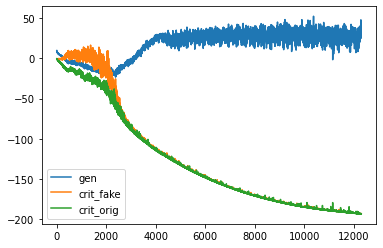

d loss fake  -193.31629943847656
d loss real  -193.4814453125
[Epoch 36/100] [Batch 101/345] [D loss: -193.398872, acc:   0%] [G loss: 26.556377] [c1: 36.725708, c2: 36.103706, o: 58.547733, f: 39.043175] time: 7:58:05.908044
d loss fake  -193.29220581054688
d loss real  -193.5943145751953
[Epoch 36/100] [Batch 102/345] [D loss: -193.443260, acc:   0%] [G loss: 24.788555] [c1: 31.376673, c2: 31.671146, o: 59.125252, f: 30.646040] time: 7:58:08.185517
d loss fake  -193.559326171875
d loss real  -193.61131286621094
[Epoch 36/100] [Batch 103/345] [D loss: -193.585320, acc:   0%] [G loss: 28.044314] [c1: 38.185204, c2: 39.189659, o: 59.027298, f: 33.442703] time: 7:58:10.457427
d loss fake  -193.3319091796875
d loss real  -193.65963745117188
[Epoch 36/100] [Batch 104/345] [D loss: -193.495773, acc:   0%] [G loss: 27.137064] [c1: 36.346878, c2: 36.060692, o: 61.814861, f: 39.430237] time: 7:58:12.747923
d loss fake  -193.541259765625
d loss real  -193.47901916503906
[Epoch 36/100] [Batch 10

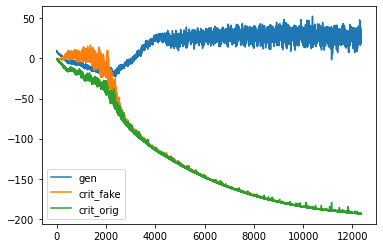

d loss fake  -193.67782592773438
d loss real  -193.78598022460938
[Epoch 36/100] [Batch 151/345] [D loss: -193.731903, acc:   0%] [G loss: 24.928230] [c1: 36.371498, c2: 34.642071, o: 52.154545, f: 35.617176] time: 8:00:01.704903
d loss fake  -193.5843505859375
d loss real  -193.79776000976562
[Epoch 36/100] [Batch 152/345] [D loss: -193.691055, acc:   0%] [G loss: 28.801714] [c1: 40.746155, c2: 40.439049, o: 51.509598, f: 35.167667] time: 8:00:03.984159
d loss fake  -193.55227661132812
d loss real  -193.8031005859375
[Epoch 36/100] [Batch 153/345] [D loss: -193.677689, acc:   0%] [G loss: 38.304919] [c1: 51.502007, c2: 53.710220, o: 58.535652, f: 40.622475] time: 8:00:06.261137
d loss fake  -193.68499755859375
d loss real  -193.69406127929688
[Epoch 36/100] [Batch 154/345] [D loss: -193.689529, acc:   0%] [G loss: 34.223276] [c1: 49.738289, c2: 50.580128, o: 70.905693, f: 54.078804] time: 8:00:08.536193
d loss fake  -193.68344116210938
d loss real  -193.81793212890625
[Epoch 36/100] [

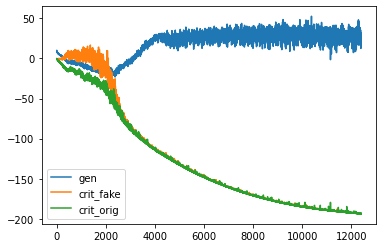

d loss fake  -193.8406982421875
d loss real  -193.96946716308594
[Epoch 36/100] [Batch 201/345] [D loss: -193.905083, acc:   0%] [G loss: 18.160536] [c1: 24.303186, c2: 24.562378, o: 48.642487, f: 27.545872] time: 8:01:56.349931
d loss fake  -193.7939453125
d loss real  -193.9767608642578
[Epoch 36/100] [Batch 202/345] [D loss: -193.885353, acc:   0%] [G loss: 18.382670] [c1: 26.548286, c2: 26.831709, o: 43.239483, f: 24.924198] time: 8:01:58.635926
d loss fake  -193.7936553955078
d loss real  -193.95059204101562
[Epoch 36/100] [Batch 203/345] [D loss: -193.872124, acc:   0%] [G loss: 21.797729] [c1: 30.753046, c2: 29.823994, o: 45.282066, f: 29.317421] time: 8:02:00.901075
d loss fake  -193.78634643554688
d loss real  -193.90328979492188
[Epoch 36/100] [Batch 204/345] [D loss: -193.844818, acc:   0%] [G loss: 21.323685] [c1: 31.849693, c2: 32.051613, o: 45.587967, f: 28.786175] time: 8:02:03.188154
d loss fake  -193.7790069580078
d loss real  -193.99282836914062
[Epoch 36/100] [Batch 

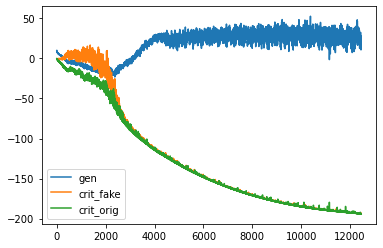

d loss fake  -193.93162536621094
d loss real  -194.0808868408203
[Epoch 36/100] [Batch 251/345] [D loss: -194.006256, acc:   0%] [G loss: 20.028796] [c1: 29.853302, c2: 28.268742, o: 39.408928, f: 20.936745] time: 8:03:52.006609
d loss fake  -193.82327270507812
d loss real  -192.34254455566406
[Epoch 36/100] [Batch 252/345] [D loss: -193.082909, acc:   0%] [G loss: 25.088347] [c1: 34.349522, c2: 33.421417, o: 49.306667, f: 27.073612] time: 8:03:54.273663
d loss fake  -193.52999877929688
d loss real  -194.0339813232422
[Epoch 36/100] [Batch 253/345] [D loss: -193.781990, acc:   0%] [G loss: 14.065911] [c1: 13.998163, c2: 15.814199, o: 52.840225, f: 32.016655] time: 8:03:56.539172
d loss fake  -193.84214782714844
d loss real  -193.98800659179688
[Epoch 36/100] [Batch 254/345] [D loss: -193.915077, acc:   0%] [G loss: 19.119014] [c1: 29.635881, c2: 30.900761, o: 38.668106, f: 20.388721] time: 8:03:58.808868
d loss fake  -193.98587036132812
d loss real  -194.08456420898438
[Epoch 36/100] [

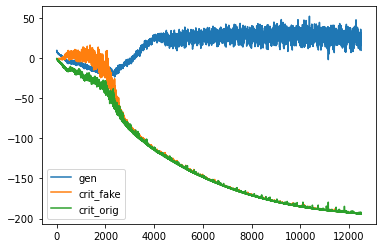

d loss fake  -194.025634765625
d loss real  -194.12879943847656
[Epoch 36/100] [Batch 301/345] [D loss: -194.077217, acc:   0%] [G loss: 12.132216] [c1: 16.048943, c2: 14.892586, o: 27.284096, f: 8.718307] time: 8:05:47.384486
d loss fake  -194.04806518554688
d loss real  -193.81021118164062
[Epoch 36/100] [Batch 302/345] [D loss: -193.929138, acc:   0%] [G loss: 17.910139] [c1: 27.123608, c2: 26.948479, o: 33.036774, f: 18.412836] time: 8:05:49.671573
d loss fake  -193.73876953125
d loss real  -194.22085571289062
[Epoch 36/100] [Batch 303/345] [D loss: -193.979813, acc:   0%] [G loss: 12.981746] [c1: 15.211816, c2: 16.168694, o: 45.645050, f: 23.056137] time: 8:05:51.945363
d loss fake  -193.93008422851562
d loss real  -194.23193359375
[Epoch 36/100] [Batch 304/345] [D loss: -194.081009, acc:   0%] [G loss: 14.353901] [c1: 16.474169, c2: 16.636436, o: 40.151791, f: 16.187881] time: 8:05:54.228847
d loss fake  -194.05404663085938
d loss real  -193.38282775878906
[Epoch 36/100] [Batch 3

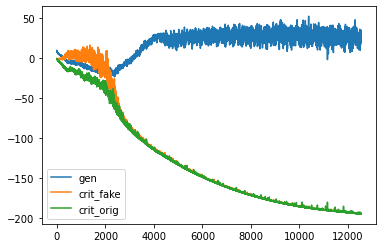

d loss fake  -193.59735107421875
d loss real  -194.36337280273438
[Epoch 37/100] [Batch 1/345] [D loss: -193.980362, acc:   0%] [G loss: 16.909601] [c1: 17.485683, c2: 17.217817, o: 50.181595, f: 25.149635] time: 8:07:22.844675
d loss fake  -194.029296875
d loss real  -194.291259765625
[Epoch 37/100] [Batch 2/345] [D loss: -194.160278, acc:   0%] [G loss: 17.142414] [c1: 24.136421, c2: 23.120272, o: 40.747326, f: 20.616299] time: 8:07:25.182810
d loss fake  -194.05270385742188
d loss real  -194.34246826171875
[Epoch 37/100] [Batch 3/345] [D loss: -194.197586, acc:   0%] [G loss: 14.392990] [c1: 19.627066, c2: 19.621708, o: 43.729660, f: 23.732065] time: 8:07:27.522947
d loss fake  -193.57107543945312
d loss real  -194.17095947265625
[Epoch 37/100] [Batch 4/345] [D loss: -193.871017, acc:   0%] [G loss: 17.513897] [c1: 16.121811, c2: 16.249891, o: 45.034615, f: 16.555611] time: 8:07:29.859008
d loss fake  -194.07752990722656
d loss real  -194.30059814453125
[Epoch 37/100] [Batch 5/345] 

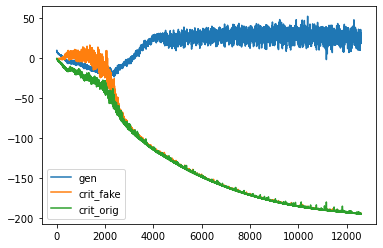

d loss fake  -194.35098266601562
d loss real  -194.42660522460938
[Epoch 37/100] [Batch 51/345] [D loss: -194.388794, acc:   0%] [G loss: 25.724637] [c1: 35.602051, c2: 36.116432, o: 56.526878, f: 33.918064] time: 8:09:17.659978
d loss fake  -194.3154296875
d loss real  -194.39630126953125
[Epoch 37/100] [Batch 52/345] [D loss: -194.355865, acc:   0%] [G loss: 28.700892] [c1: 41.411240, c2: 41.268845, o: 60.735016, f: 40.300526] time: 8:09:19.936668
d loss fake  -194.00131225585938
d loss real  -193.86941528320312
[Epoch 37/100] [Batch 53/345] [D loss: -193.935364, acc:   0%] [G loss: 26.158694] [c1: 35.351063, c2: 34.944534, o: 60.903393, f: 37.186256] time: 8:09:22.208094
d loss fake  -194.34608459472656
d loss real  -194.45494079589844
[Epoch 37/100] [Batch 54/345] [D loss: -194.400513, acc:   0%] [G loss: 29.321277] [c1: 43.363384, c2: 43.216408, o: 60.025444, f: 39.110535] time: 8:09:24.487720
d loss fake  -194.2794189453125
d loss real  -194.4795379638672
[Epoch 37/100] [Batch 55

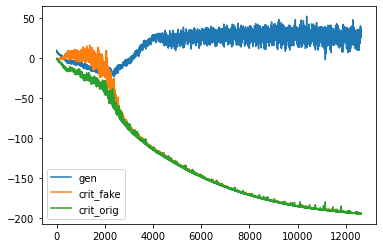

d loss fake  -194.39846801757812
d loss real  -194.44549560546875
[Epoch 37/100] [Batch 101/345] [D loss: -194.421982, acc:   0%] [G loss: 38.580801] [c1: 51.572941, c2: 52.563881, o: 61.902931, f: 40.123932] time: 8:11:13.517767
d loss fake  -194.5319366455078
d loss real  -194.60842895507812
[Epoch 37/100] [Batch 102/345] [D loss: -194.570183, acc:   0%] [G loss: 31.906539] [c1: 43.051323, c2: 42.701950, o: 77.827530, f: 52.699741] time: 8:11:15.804451
d loss fake  -194.49856567382812
d loss real  -194.34962463378906
[Epoch 37/100] [Batch 103/345] [D loss: -194.424095, acc:   0%] [G loss: 35.887720] [c1: 49.947441, c2: 48.641830, o: 66.033318, f: 43.128769] time: 8:11:18.088460
d loss fake  -194.34886169433594
d loss real  -194.5016326904297
[Epoch 37/100] [Batch 104/345] [D loss: -194.425247, acc:   0%] [G loss: 31.751312] [c1: 42.752628, c2: 42.339474, o: 70.831383, f: 46.037590] time: 8:11:20.385180
d loss fake  -194.2293243408203
d loss real  -194.5944061279297
[Epoch 37/100] [Ba

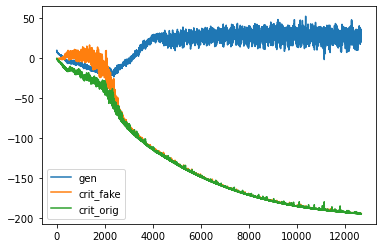

d loss fake  -194.546875
d loss real  -194.69583129882812
[Epoch 37/100] [Batch 151/345] [D loss: -194.621353, acc:   0%] [G loss: 28.770625] [c1: 38.819450, c2: 36.886131, o: 65.648224, f: 43.718407] time: 8:13:09.205636
d loss fake  -194.5632781982422
d loss real  -194.72015380859375
[Epoch 37/100] [Batch 152/345] [D loss: -194.641716, acc:   0%] [G loss: 26.171655] [c1: 33.823608, c2: 34.004219, o: 61.776428, f: 40.290359] time: 8:13:11.487343
d loss fake  -194.59136962890625
d loss real  -194.72955322265625
[Epoch 37/100] [Batch 153/345] [D loss: -194.660461, acc:   0%] [G loss: 22.219147] [c1: 30.172586, c2: 30.242016, o: 54.128593, f: 34.257095] time: 8:13:13.770684
d loss fake  -194.60330200195312
d loss real  -194.73800659179688
[Epoch 37/100] [Batch 154/345] [D loss: -194.670654, acc:   0%] [G loss: 18.408054] [c1: 25.293560, c2: 26.016937, o: 51.090324, f: 30.879366] time: 8:13:16.059997
d loss fake  -192.85043334960938
d loss real  -194.78433227539062
[Epoch 37/100] [Batch 1

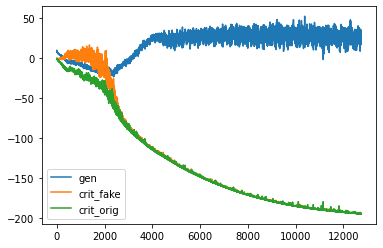

d loss fake  -194.58168029785156
d loss real  -194.08460998535156
[Epoch 37/100] [Batch 201/345] [D loss: -194.333145, acc:   0%] [G loss: 29.079456] [c1: 39.148453, c2: 39.899845, o: 54.815243, f: 35.327293] time: 8:15:04.134033
d loss fake  -194.69589233398438
d loss real  -194.83468627929688
[Epoch 37/100] [Batch 202/345] [D loss: -194.765289, acc:   0%] [G loss: 30.884473] [c1: 41.770615, c2: 43.653152, o: 65.666824, f: 39.860176] time: 8:15:06.417577
d loss fake  -194.74395751953125
d loss real  -194.85662841796875
[Epoch 37/100] [Batch 203/345] [D loss: -194.800293, acc:   0%] [G loss: 26.180947] [c1: 37.928238, c2: 38.146118, o: 65.657089, f: 44.609016] time: 8:15:08.700078
d loss fake  -194.77023315429688
d loss real  -194.9058074951172
[Epoch 37/100] [Batch 204/345] [D loss: -194.838020, acc:   0%] [G loss: 25.727803] [c1: 38.986069, c2: 37.554291, o: 57.787243, f: 38.943787] time: 8:15:10.979434
d loss fake  -194.68887329101562
d loss real  -194.5750274658203
[Epoch 37/100] [

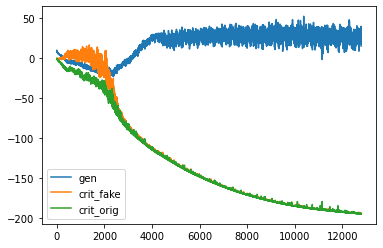

d loss fake  -194.78176879882812
d loss real  -194.91189575195312
[Epoch 37/100] [Batch 251/345] [D loss: -194.846832, acc:   0%] [G loss: 28.535549] [c1: 39.709274, c2: 39.116043, o: 39.584587, f: 18.520664] time: 8:17:00.089492
d loss fake  -194.8542022705078
d loss real  -194.72105407714844
[Epoch 37/100] [Batch 252/345] [D loss: -194.787628, acc:   0%] [G loss: 29.502938] [c1: 41.102585, c2: 40.678486, o: 59.933521, f: 37.613186] time: 8:17:02.381713
d loss fake  -194.77239990234375
d loss real  -194.9884033203125
[Epoch 37/100] [Batch 253/345] [D loss: -194.880402, acc:   0%] [G loss: 31.008944] [c1: 43.084145, c2: 42.625801, o: 66.026642, f: 44.603806] time: 8:17:04.672036
d loss fake  -194.78317260742188
d loss real  -194.94662475585938
[Epoch 37/100] [Batch 254/345] [D loss: -194.864899, acc:   0%] [G loss: 26.763444] [c1: 36.692402, c2: 36.424301, o: 65.660599, f: 43.735336] time: 8:17:06.969259
d loss fake  -194.85891723632812
d loss real  -195.044921875
[Epoch 37/100] [Batch

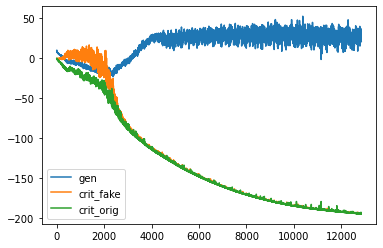

d loss fake  -194.6826934814453
d loss real  -195.03363037109375
[Epoch 37/100] [Batch 301/345] [D loss: -194.858162, acc:   0%] [G loss: 21.521931] [c1: 25.308439, c2: 26.373144, o: 48.460442, f: 24.937351] time: 8:18:56.311777
d loss fake  -194.84942626953125
d loss real  -195.09078979492188
[Epoch 37/100] [Batch 302/345] [D loss: -194.970108, acc:   0%] [G loss: 19.827426] [c1: 25.274551, c2: 24.475182, o: 47.169437, f: 27.918045] time: 8:18:58.600846
d loss fake  -194.9599609375
d loss real  -194.68997192382812
[Epoch 37/100] [Batch 303/345] [D loss: -194.824966, acc:   0%] [G loss: 27.306924] [c1: 35.141647, c2: 34.104805, o: 48.045876, f: 25.087807] time: 8:19:00.886637
d loss fake  -194.16610717773438
d loss real  -195.09202575683594
[Epoch 37/100] [Batch 304/345] [D loss: -194.629066, acc:   0%] [G loss: 13.901347] [c1: 9.818429, c2: 10.225265, o: 58.111046, f: 31.351637] time: 8:19:03.176533
d loss fake  -194.93023681640625
d loss real  -195.0811767578125
[Epoch 37/100] [Batch

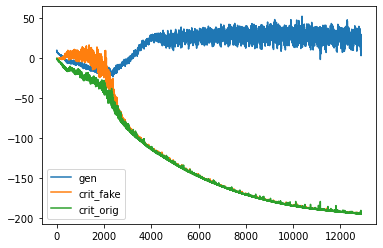

d loss fake  -194.99716186523438
d loss real  -195.1334686279297
[Epoch 38/100] [Batch 1/345] [D loss: -195.065315, acc:   0%] [G loss: 18.421271] [c1: 19.576294, c2: 19.880348, o: 39.236710, f: 11.470423] time: 8:20:31.698013
d loss fake  -194.0628662109375
d loss real  -195.15298461914062
[Epoch 38/100] [Batch 2/345] [D loss: -194.607925, acc:   0%] [G loss: 11.851538] [c1: 9.256856, c2: 9.475331, o: 46.667362, f: 20.048021] time: 8:20:34.050599
d loss fake  -194.5466766357422
d loss real  -195.22763061523438
[Epoch 38/100] [Batch 3/345] [D loss: -194.887154, acc:   0%] [G loss: 36.135065] [c1: 47.281868, c2: 46.859352, o: 34.520184, f: 17.874870] time: 8:20:36.373335
d loss fake  -193.7319793701172
d loss real  -194.8912353515625
[Epoch 38/100] [Batch 4/345] [D loss: -194.311607, acc:   0%] [G loss: 25.159070] [c1: 29.417513, c2: 28.423447, o: 67.552567, f: 40.389900] time: 8:20:38.722216
d loss fake  -194.71243286132812
d loss real  -194.13265991210938
[Epoch 38/100] [Batch 5/345] 

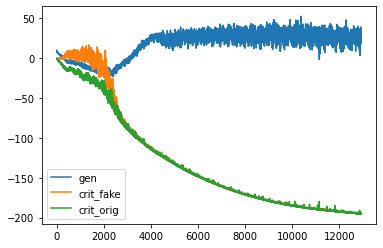

d loss fake  -195.15676879882812
d loss real  -195.29647827148438
[Epoch 38/100] [Batch 51/345] [D loss: -195.226624, acc:   0%] [G loss: 34.248069] [c1: 42.384563, c2: 40.219784, o: 61.575363, f: 39.454735] time: 8:22:26.906712
d loss fake  -195.1053466796875
d loss real  -195.30392456054688
[Epoch 38/100] [Batch 52/345] [D loss: -195.204636, acc:   0%] [G loss: 36.855609] [c1: 46.537663, c2: 46.211639, o: 68.363602, f: 40.236195] time: 8:22:29.189828
d loss fake  -194.54818725585938
d loss real  -195.33030700683594
[Epoch 38/100] [Batch 53/345] [D loss: -194.939247, acc:   0%] [G loss: 28.278283] [c1: 28.416307, c2: 29.318359, o: 74.935196, f: 44.171829] time: 8:22:31.474387
d loss fake  -195.1100616455078
d loss real  -194.43089294433594
[Epoch 38/100] [Batch 54/345] [D loss: -194.770477, acc:   0%] [G loss: 29.103700] [c1: 34.181892, c2: 36.064964, o: 56.287594, f: 28.359337] time: 8:22:33.755859
d loss fake  -195.248779296875
d loss real  -195.22512817382812
[Epoch 38/100] [Batch 

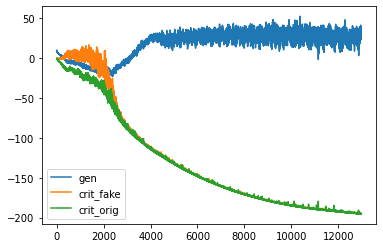

d loss fake  -195.378662109375
d loss real  -195.4425506591797
[Epoch 38/100] [Batch 101/345] [D loss: -195.410606, acc:   0%] [G loss: 29.613801] [c1: 38.256577, c2: 38.203979, o: 56.317917, f: 30.853127] time: 8:24:22.745842
d loss fake  -195.201904296875
d loss real  -195.38600158691406
[Epoch 38/100] [Batch 102/345] [D loss: -195.293953, acc:   0%] [G loss: 27.636232] [c1: 31.811813, c2: 31.021721, o: 61.638882, f: 31.908466] time: 8:24:25.035833
d loss fake  -195.171142578125
d loss real  -195.33506774902344
[Epoch 38/100] [Batch 103/345] [D loss: -195.253105, acc:   0%] [G loss: 28.800915] [c1: 34.655327, c2: 34.032009, o: 62.902805, f: 33.636971] time: 8:24:27.324511
d loss fake  -195.36129760742188
d loss real  -195.38107299804688
[Epoch 38/100] [Batch 104/345] [D loss: -195.371185, acc:   0%] [G loss: 35.241097] [c1: 44.287971, c2: 44.978027, o: 64.096786, f: 36.569817] time: 8:24:29.605197
d loss fake  -195.29904174804688
d loss real  -195.50360107421875
[Epoch 38/100] [Batch

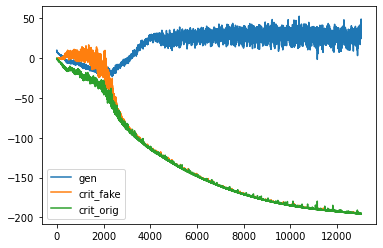

d loss fake  -195.39407348632812
d loss real  -195.56271362304688
[Epoch 38/100] [Batch 151/345] [D loss: -195.478394, acc:   0%] [G loss: 27.972910] [c1: 33.045181, c2: 32.315323, o: 84.186386, f: 58.939575] time: 8:26:18.884270
d loss fake  -195.39620971679688
d loss real  -195.60369873046875
[Epoch 38/100] [Batch 152/345] [D loss: -195.499954, acc:   0%] [G loss: 33.340414] [c1: 43.576012, c2: 43.235840, o: 55.171345, f: 34.847973] time: 8:26:21.171516
d loss fake  -195.47369384765625
d loss real  -195.5653076171875
[Epoch 38/100] [Batch 153/345] [D loss: -195.519501, acc:   0%] [G loss: 23.634620] [c1: 29.271162, c2: 28.367109, o: 64.465103, f: 42.512970] time: 8:26:23.458884
d loss fake  -195.46099853515625
d loss real  -195.4236297607422
[Epoch 38/100] [Batch 154/345] [D loss: -195.442314, acc:   0%] [G loss: 32.716801] [c1: 38.824173, c2: 39.325066, o: 48.849686, f: 26.391121] time: 8:26:25.732168
d loss fake  -195.51904296875
d loss real  -195.58322143554688
[Epoch 38/100] [Bat

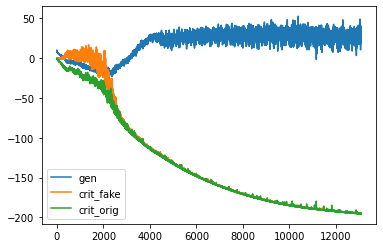

d loss fake  -195.6004638671875
d loss real  -195.744873046875
[Epoch 38/100] [Batch 201/345] [D loss: -195.672668, acc:   0%] [G loss: 25.504100] [c1: 33.902100, c2: 33.144650, o: 56.832542, f: 35.204720] time: 8:28:13.771830
d loss fake  -195.59585571289062
d loss real  -195.76678466796875
[Epoch 38/100] [Batch 202/345] [D loss: -195.681320, acc:   0%] [G loss: 27.607076] [c1: 37.458668, c2: 36.885696, o: 59.695374, f: 38.955799] time: 8:28:16.059843
d loss fake  -195.50787353515625
d loss real  -195.71803283691406
[Epoch 38/100] [Batch 203/345] [D loss: -195.612953, acc:   0%] [G loss: 20.421045] [c1: 24.758457, c2: 24.424519, o: 53.808044, f: 32.981529] time: 8:28:18.339630
d loss fake  -195.59439086914062
d loss real  -195.6967315673828
[Epoch 38/100] [Batch 204/345] [D loss: -195.645561, acc:   0%] [G loss: 26.606350] [c1: 35.910217, c2: 36.301285, o: 47.962067, f: 29.250025] time: 8:28:20.620398
d loss fake  -195.6287841796875
d loss real  -195.72573852539062
[Epoch 38/100] [Bat

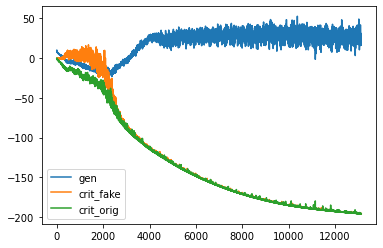

d loss fake  -195.7076416015625
d loss real  -195.85601806640625
[Epoch 38/100] [Batch 251/345] [D loss: -195.781830, acc:   0%] [G loss: 22.066879] [c1: 24.298595, c2: 25.458801, o: 58.694031, f: 33.702610] time: 8:30:09.775906
d loss fake  -195.6854248046875
d loss real  -195.90182495117188
[Epoch 38/100] [Batch 252/345] [D loss: -195.793625, acc:   0%] [G loss: 17.653944] [c1: 21.511732, c2: 20.895771, o: 45.690483, f: 26.425793] time: 8:30:12.049854
d loss fake  -195.7115936279297
d loss real  -195.83755493164062
[Epoch 38/100] [Batch 253/345] [D loss: -195.774574, acc:   0%] [G loss: 18.148045] [c1: 22.152225, c2: 20.426647, o: 37.642967, f: 17.725494] time: 8:30:14.317938
d loss fake  -195.77291870117188
d loss real  -195.91827392578125
[Epoch 38/100] [Batch 254/345] [D loss: -195.845596, acc:   0%] [G loss: 16.587986] [c1: 21.493496, c2: 21.516788, o: 45.700947, f: 23.209658] time: 8:30:16.592799
d loss fake  -195.7623291015625
d loss real  -195.78077697753906
[Epoch 38/100] [Ba

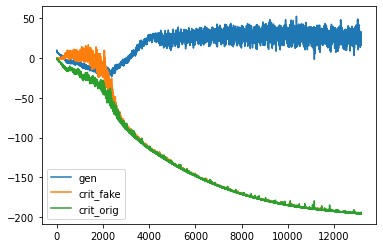

d loss fake  -195.7345428466797
d loss real  -195.25802612304688
[Epoch 38/100] [Batch 301/345] [D loss: -195.496284, acc:   0%] [G loss: 34.134855] [c1: 41.881111, c2: 42.914459, o: 61.659348, f: 33.263847] time: 8:32:05.654402
d loss fake  -195.14666748046875
d loss real  -195.8968505859375
[Epoch 38/100] [Batch 302/345] [D loss: -195.521759, acc:   0%] [G loss: 25.405545] [c1: 26.201284, c2: 28.342241, o: 68.383186, f: 39.657742] time: 8:32:07.944725
d loss fake  -195.6697998046875
d loss real  -194.0355224609375
[Epoch 38/100] [Batch 303/345] [D loss: -194.852661, acc:   0%] [G loss: 32.206983] [c1: 37.872269, c2: 37.975868, o: 51.506584, f: 28.213661] time: 8:32:10.240103
d loss fake  -195.66981506347656
d loss real  -195.4317626953125
[Epoch 38/100] [Batch 304/345] [D loss: -195.550789, acc:   0%] [G loss: 31.931275] [c1: 40.215622, c2: 38.364975, o: 64.533066, f: 38.610493] time: 8:32:12.533103
d loss fake  -193.86927795410156
d loss real  -195.31019592285156
[Epoch 38/100] [Bat

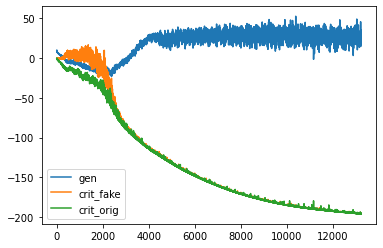

d loss fake  -195.91281127929688
d loss real  -196.01577758789062
[Epoch 39/100] [Batch 1/345] [D loss: -195.964294, acc:   0%] [G loss: 27.341403] [c1: 31.484880, c2: 30.353355, o: 55.544296, f: 29.595879] time: 8:33:40.857740
d loss fake  -194.87147521972656
d loss real  -195.35357666015625
[Epoch 39/100] [Batch 2/345] [D loss: -195.112526, acc:   0%] [G loss: 23.190135] [c1: 27.339710, c2: 26.457867, o: 54.647774, f: 32.755333] time: 8:33:43.192197
d loss fake  -195.906005859375
d loss real  -196.07476806640625
[Epoch 39/100] [Batch 3/345] [D loss: -195.990387, acc:   0%] [G loss: 23.176671] [c1: 27.194635, c2: 27.238884, o: 52.770592, f: 26.868477] time: 8:33:45.539079
d loss fake  -195.8784637451172
d loss real  -196.05165100097656
[Epoch 39/100] [Batch 4/345] [D loss: -195.965057, acc:   0%] [G loss: 19.211336] [c1: 19.544678, c2: 20.694286, o: 52.574715, f: 26.192389] time: 8:33:47.854466
d loss fake  -195.85711669921875
d loss real  -195.64633178710938
[Epoch 39/100] [Batch 5/3

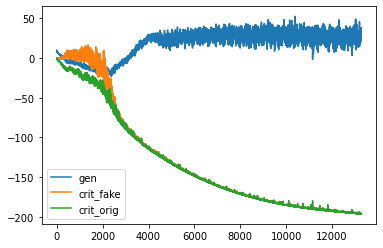

d loss fake  -196.0843048095703
d loss real  -196.03826904296875
[Epoch 39/100] [Batch 51/345] [D loss: -196.061287, acc:   0%] [G loss: 35.499679] [c1: 44.221710, c2: 44.197422, o: 73.395111, f: 46.627926] time: 8:35:35.898641
d loss fake  -196.1378631591797
d loss real  -196.1730499267578
[Epoch 39/100] [Batch 52/345] [D loss: -196.155457, acc:   0%] [G loss: 34.122397] [c1: 45.258453, c2: 45.253937, o: 68.149055, f: 44.264706] time: 8:35:38.191578
d loss fake  -196.09788513183594
d loss real  -195.752685546875
[Epoch 39/100] [Batch 53/345] [D loss: -195.925285, acc:   0%] [G loss: 35.674599] [c1: 45.361443, c2: 45.249844, o: 72.357468, f: 44.562885] time: 8:35:40.478091
d loss fake  -196.1416473388672
d loss real  -196.16806030273438
[Epoch 39/100] [Batch 54/345] [D loss: -196.154854, acc:   0%] [G loss: 37.032298] [c1: 46.958523, c2: 46.397522, o: 76.111488, f: 46.463066] time: 8:35:42.754153
d loss fake  -196.16334533691406
d loss real  -196.24984741210938
[Epoch 39/100] [Batch 55

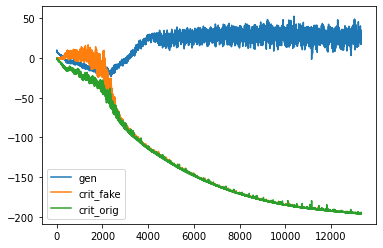

d loss fake  -196.19235229492188
d loss real  -196.287353515625
[Epoch 39/100] [Batch 101/345] [D loss: -196.239853, acc:   0%] [G loss: 31.088675] [c1: 40.941788, c2: 40.590263, o: 68.487511, f: 41.838226] time: 8:37:32.123989
d loss fake  -196.1304473876953
d loss real  -196.14146423339844
[Epoch 39/100] [Batch 102/345] [D loss: -196.135956, acc:   0%] [G loss: 30.899448] [c1: 39.043816, c2: 38.589066, o: 66.526123, f: 39.764519] time: 8:37:34.406908
d loss fake  -195.108642578125
d loss real  -196.30770874023438
[Epoch 39/100] [Batch 103/345] [D loss: -195.708176, acc:   0%] [G loss: 20.224336] [c1: 18.244169, c2: 20.265587, o: 70.634567, f: 36.138390] time: 8:37:36.680682
d loss fake  -196.19627380371094
d loss real  -196.02967834472656
[Epoch 39/100] [Batch 104/345] [D loss: -196.112976, acc:   0%] [G loss: 31.718385] [c1: 43.311218, c2: 40.959251, o: 48.546730, f: 23.476738] time: 8:37:38.960459
d loss fake  -196.14076232910156
d loss real  -196.2529296875
[Epoch 39/100] [Batch 1

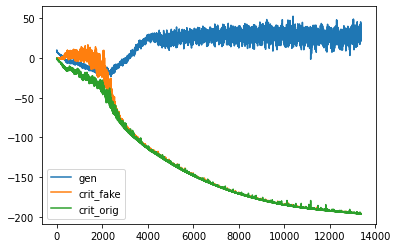

d loss fake  -196.21519470214844
d loss real  -196.45648193359375
[Epoch 39/100] [Batch 151/345] [D loss: -196.335838, acc:   0%] [G loss: 30.626620] [c1: 40.209229, c2: 39.345985, o: 76.479935, f: 51.982929] time: 8:39:27.807668
d loss fake  -196.2916717529297
d loss real  -196.4678192138672
[Epoch 39/100] [Batch 152/345] [D loss: -196.379745, acc:   0%] [G loss: 32.476441] [c1: 40.646332, c2: 39.928551, o: 65.605347, f: 39.358585] time: 8:39:30.092663
d loss fake  -196.11404418945312
d loss real  -196.39617919921875
[Epoch 39/100] [Batch 153/345] [D loss: -196.255112, acc:   0%] [G loss: 39.960049] [c1: 52.003197, c2: 52.121010, o: 66.083908, f: 41.279434] time: 8:39:32.368510
d loss fake  -196.2909393310547
d loss real  -196.43118286132812
[Epoch 39/100] [Batch 154/345] [D loss: -196.361061, acc:   0%] [G loss: 31.238127] [c1: 36.882637, c2: 37.153534, o: 78.321960, f: 50.561134] time: 8:39:34.647062
d loss fake  -196.32211303710938
d loss real  -196.31903076171875
[Epoch 39/100] [B

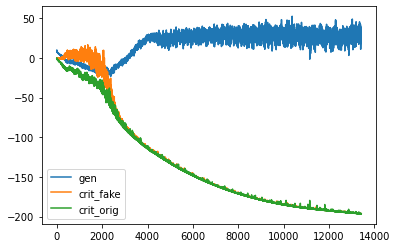

d loss fake  -196.51907348632812
d loss real  -196.57772827148438
[Epoch 39/100] [Batch 201/345] [D loss: -196.548401, acc:   0%] [G loss: 29.764874] [c1: 38.035339, c2: 36.904446, o: 60.797813, f: 39.119698] time: 8:41:22.690967
d loss fake  -196.4627685546875
d loss real  -196.56842041015625
[Epoch 39/100] [Batch 202/345] [D loss: -196.515594, acc:   0%] [G loss: 27.731657] [c1: 36.460987, c2: 35.427208, o: 56.477600, f: 36.119671] time: 8:41:24.972206
d loss fake  -196.45594787597656
d loss real  -196.62913513183594
[Epoch 39/100] [Batch 203/345] [D loss: -196.542542, acc:   0%] [G loss: 23.204405] [c1: 28.670553, c2: 29.876608, o: 59.074509, f: 34.228851] time: 8:41:27.254168
d loss fake  -196.43211364746094
d loss real  -196.60519409179688
[Epoch 39/100] [Batch 204/345] [D loss: -196.518654, acc:   0%] [G loss: 26.592207] [c1: 35.151833, c2: 34.709511, o: 50.513824, f: 31.040878] time: 8:41:29.535425
d loss fake  -196.2508544921875
d loss real  -196.55601501464844
[Epoch 39/100] [

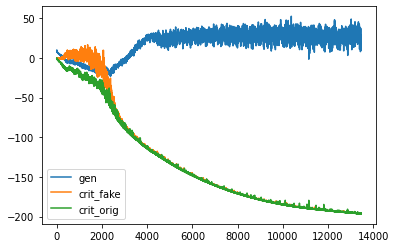

d loss fake  -196.50613403320312
d loss real  -196.65731811523438
[Epoch 39/100] [Batch 251/345] [D loss: -196.581726, acc:   0%] [G loss: 25.420469] [c1: 29.687119, c2: 30.472092, o: 57.001541, f: 35.197784] time: 8:43:18.523057
d loss fake  -196.08956909179688
d loss real  -196.589111328125
[Epoch 39/100] [Batch 252/345] [D loss: -196.339340, acc:   0%] [G loss: 20.395750] [c1: 20.879492, c2: 23.000061, o: 52.596161, f: 24.714752] time: 8:43:20.802977
d loss fake  -196.28948974609375
d loss real  -194.15057373046875
[Epoch 39/100] [Batch 253/345] [D loss: -195.220032, acc:   0%] [G loss: 27.850539] [c1: 28.219227, c2: 28.553310, o: 47.470123, f: 22.564049] time: 8:43:23.083076
d loss fake  -196.1397705078125
d loss real  -196.6010284423828
[Epoch 39/100] [Batch 254/345] [D loss: -196.370399, acc:   0%] [G loss: 21.705002] [c1: 24.038467, c2: 24.863964, o: 58.234478, f: 31.612249] time: 8:43:25.372933
d loss fake  -195.9656982421875
d loss real  -196.61404418945312
[Epoch 39/100] [Bat

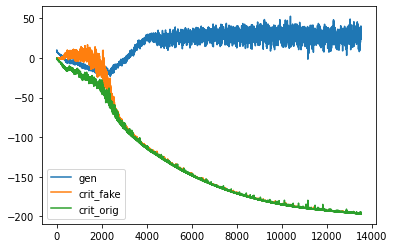

d loss fake  -196.68505859375
d loss real  -196.706298828125
[Epoch 39/100] [Batch 301/345] [D loss: -196.695679, acc:   0%] [G loss: 28.695339] [c1: 32.987724, c2: 33.205654, o: 53.578823, f: 24.667755] time: 8:45:14.461096
d loss fake  -196.02508544921875
d loss real  -195.5257568359375
[Epoch 39/100] [Batch 302/345] [D loss: -195.775421, acc:   0%] [G loss: 29.418741] [c1: 30.351885, c2: 31.291758, o: 60.139244, f: 32.227081] time: 8:45:16.754748
d loss fake  -196.67681884765625
d loss real  -196.7578582763672
[Epoch 39/100] [Batch 303/345] [D loss: -196.717339, acc:   0%] [G loss: 32.012397] [c1: 39.069763, c2: 39.292084, o: 61.878933, f: 36.696251] time: 8:45:19.041465
d loss fake  -196.7479248046875
d loss real  -196.68661499023438
[Epoch 39/100] [Batch 304/345] [D loss: -196.717270, acc:   0%] [G loss: 34.034624] [c1: 44.254311, c2: 43.739273, o: 60.641563, f: 38.885208] time: 8:45:21.326996
d loss fake  -196.71194458007812
d loss real  -196.79156494140625
[Epoch 39/100] [Batch 

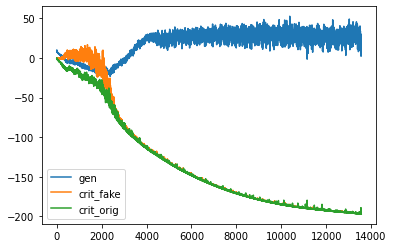

d loss fake  -196.29644775390625
d loss real  -196.8219757080078
[Epoch 40/100] [Batch 1/345] [D loss: -196.559212, acc:   0%] [G loss: 17.846588] [c1: 16.116924, c2: 16.780874, o: 45.582146, f: 19.561119] time: 8:46:51.003905
d loss fake  -196.64181518554688
d loss real  -196.79776000976562
[Epoch 40/100] [Batch 2/345] [D loss: -196.719788, acc:   0%] [G loss: 22.067279] [c1: 27.750299, c2: 27.197563, o: 38.427429, f: 22.757908] time: 8:46:53.354279
d loss fake  -196.69407653808594
d loss real  -196.84706115722656
[Epoch 40/100] [Batch 3/345] [D loss: -196.770569, acc:   0%] [G loss: 21.876809] [c1: 24.693996, c2: 24.028526, o: 45.758789, f: 23.744724] time: 8:46:55.678685
d loss fake  -196.36862182617188
d loss real  -196.8092041015625
[Epoch 40/100] [Batch 4/345] [D loss: -196.588913, acc:   0%] [G loss: 19.505870] [c1: 18.407576, c2: 18.362354, o: 46.191578, f: 23.789326] time: 8:46:57.967921
d loss fake  -196.59466552734375
d loss real  -196.85073852539062
[Epoch 40/100] [Batch 5/

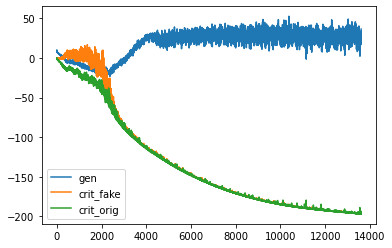

d loss fake  -196.83306884765625
d loss real  -196.93980407714844
[Epoch 40/100] [Batch 51/345] [D loss: -196.886436, acc:   0%] [G loss: 40.353994] [c1: 46.442024, c2: 46.465263, o: 76.302536, f: 41.428806] time: 8:48:46.035122
d loss fake  -196.7854766845703
d loss real  -196.66708374023438
[Epoch 40/100] [Batch 52/345] [D loss: -196.726280, acc:   0%] [G loss: 36.936470] [c1: 41.231323, c2: 41.503250, o: 78.723251, f: 45.690208] time: 8:48:48.314505
d loss fake  -196.84368896484375
d loss real  -197.03085327148438
[Epoch 40/100] [Batch 53/345] [D loss: -196.937271, acc:   0%] [G loss: 34.782915] [c1: 41.430820, c2: 41.453041, o: 77.000999, f: 47.959003] time: 8:48:50.591885
d loss fake  -196.84185791015625
d loss real  -196.99459838867188
[Epoch 40/100] [Batch 54/345] [D loss: -196.918228, acc:   0%] [G loss: 29.235773] [c1: 32.210991, c2: 32.256729, o: 70.329025, f: 36.241974] time: 8:48:52.867757
d loss fake  -196.819091796875
d loss real  -196.66746520996094
[Epoch 40/100] [Batch

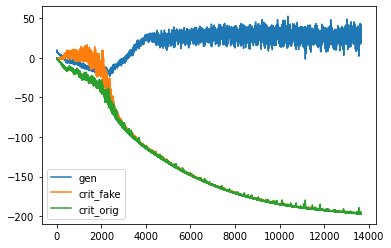

d loss fake  -196.92855834960938
d loss real  -197.09075927734375
[Epoch 40/100] [Batch 101/345] [D loss: -197.009659, acc:   0%] [G loss: 29.601836] [c1: 36.027824, c2: 35.586708, o: 69.849701, f: 40.420227] time: 8:50:41.740716
d loss fake  -196.92391967773438
d loss real  -197.1770477294922
[Epoch 40/100] [Batch 102/345] [D loss: -197.050484, acc:   0%] [G loss: 22.303126] [c1: 24.776211, c2: 24.511654, o: 63.853638, f: 35.003807] time: 8:50:44.037739
d loss fake  -196.94708251953125
d loss real  -196.93231201171875
[Epoch 40/100] [Batch 103/345] [D loss: -196.939697, acc:   0%] [G loss: 23.266764] [c1: 25.870632, c2: 25.784977, o: 49.695461, f: 22.986721] time: 8:50:46.314428
d loss fake  -197.03427124023438
d loss real  -197.09970092773438
[Epoch 40/100] [Batch 104/345] [D loss: -197.066986, acc:   0%] [G loss: 25.600676] [c1: 29.077925, c2: 28.379314, o: 58.146645, f: 26.361950] time: 8:50:48.591628
d loss fake  -197.00277709960938
d loss real  -197.1143798828125
[Epoch 40/100] [

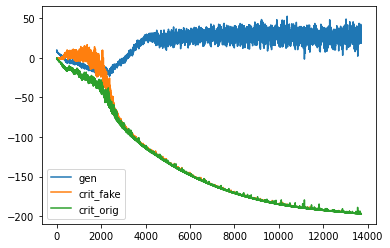

d loss fake  -197.12213134765625
d loss real  -197.1548309326172
[Epoch 40/100] [Batch 151/345] [D loss: -197.138481, acc:   0%] [G loss: 27.221576] [c1: 32.809212, c2: 31.962584, o: 48.729271, f: 28.130949] time: 8:52:37.584457
d loss fake  -197.02069091796875
d loss real  -197.2723388671875
[Epoch 40/100] [Batch 152/345] [D loss: -197.146515, acc:   0%] [G loss: 22.058231] [c1: 21.597178, c2: 20.725658, o: 53.010994, f: 29.505924] time: 8:52:39.858681
d loss fake  -197.0499267578125
d loss real  -197.06590270996094
[Epoch 40/100] [Batch 153/345] [D loss: -197.057915, acc:   0%] [G loss: 24.867883] [c1: 27.187286, c2: 28.086683, o: 46.602417, f: 21.827812] time: 8:52:42.119183
d loss fake  -197.1152801513672
d loss real  -197.28146362304688
[Epoch 40/100] [Batch 154/345] [D loss: -197.198372, acc:   0%] [G loss: 21.977725] [c1: 24.161180, c2: 23.704556, o: 50.329563, f: 28.846331] time: 8:52:44.398387
d loss fake  -197.04928588867188
d loss real  -197.08999633789062
[Epoch 40/100] [Ba

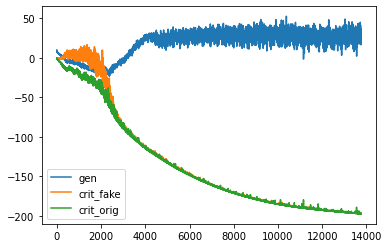

d loss fake  -197.26956176757812
d loss real  -197.32894897460938
[Epoch 40/100] [Batch 201/345] [D loss: -197.299255, acc:   0%] [G loss: 28.188984] [c1: 36.510773, c2: 36.543217, o: 48.391953, f: 25.541540] time: 8:54:32.277981
d loss fake  -197.23907470703125
d loss real  -196.50367736816406
[Epoch 40/100] [Batch 202/345] [D loss: -196.871376, acc:   0%] [G loss: 37.825437] [c1: 49.720688, c2: 48.888027, o: 57.521339, f: 35.474796] time: 8:54:34.562896
d loss fake  -197.22210693359375
d loss real  -197.34585571289062
[Epoch 40/100] [Batch 203/345] [D loss: -197.283981, acc:   0%] [G loss: 41.466160] [c1: 56.274311, c2: 55.272717, o: 77.747879, f: 51.325943] time: 8:54:36.839595
d loss fake  -197.27374267578125
d loss real  -197.3734130859375
[Epoch 40/100] [Batch 204/345] [D loss: -197.323578, acc:   0%] [G loss: 29.675858] [c1: 34.332153, c2: 34.039711, o: 82.182373, f: 53.390739] time: 8:54:39.126690
d loss fake  -197.35061645507812
d loss real  -197.4601593017578
[Epoch 40/100] [

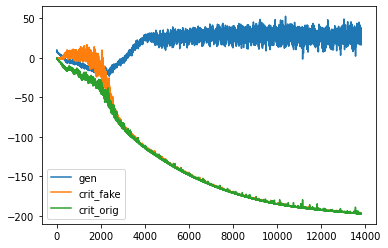

d loss fake  -197.33078002929688
d loss real  -196.56114196777344
[Epoch 40/100] [Batch 251/345] [D loss: -196.945961, acc:   0%] [G loss: 28.629893] [c1: 36.418304, c2: 36.457878, o: 46.362320, f: 22.829617] time: 8:56:28.575705
d loss fake  -197.37759399414062
d loss real  -197.48768615722656
[Epoch 40/100] [Batch 252/345] [D loss: -197.432640, acc:   0%] [G loss: 29.568297] [c1: 35.271416, c2: 33.467667, o: 61.418602, f: 35.305969] time: 8:56:30.868758
d loss fake  -197.2740020751953
d loss real  -197.5145263671875
[Epoch 40/100] [Batch 253/345] [D loss: -197.394264, acc:   0%] [G loss: 25.240155] [c1: 28.234520, c2: 27.159369, o: 61.992836, f: 35.822189] time: 8:56:33.143619
d loss fake  -196.84487915039062
d loss real  -197.43101501464844
[Epoch 40/100] [Batch 254/345] [D loss: -197.137947, acc:   0%] [G loss: 19.717009] [c1: 18.883757, c2: 19.165201, o: 52.846607, f: 26.243158] time: 8:56:35.432134
d loss fake  -197.34426879882812
d loss real  -197.5045166015625
[Epoch 40/100] [B

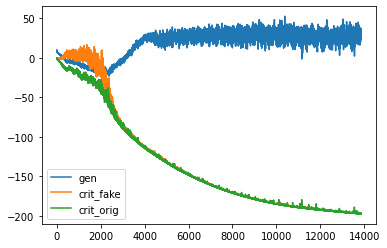

d loss fake  -197.45635986328125
d loss real  -197.5878143310547
[Epoch 40/100] [Batch 301/345] [D loss: -197.522087, acc:   0%] [G loss: 25.964369] [c1: 31.786114, c2: 32.235191, o: 61.820004, f: 38.597725] time: 8:58:24.363696
d loss fake  -197.447998046875
d loss real  -197.57940673828125
[Epoch 40/100] [Batch 302/345] [D loss: -197.513702, acc:   0%] [G loss: 18.322103] [c1: 15.948222, c2: 17.029303, o: 55.057899, f: 28.415491] time: 8:58:26.639794
d loss fake  -197.1377410888672
d loss real  -197.54217529296875
[Epoch 40/100] [Batch 303/345] [D loss: -197.339958, acc:   0%] [G loss: 16.822718] [c1: 17.112003, c2: 17.115582, o: 37.267052, f: 14.702256] time: 8:58:28.908985
d loss fake  -197.48013305664062
d loss real  -197.59320068359375
[Epoch 40/100] [Batch 304/345] [D loss: -197.536667, acc:   0%] [G loss: 27.489528] [c1: 31.719765, c2: 31.049454, o: 41.189278, f: 18.656258] time: 8:58:31.186457
d loss fake  -197.3269500732422
d loss real  -197.58612060546875
[Epoch 40/100] [Bat

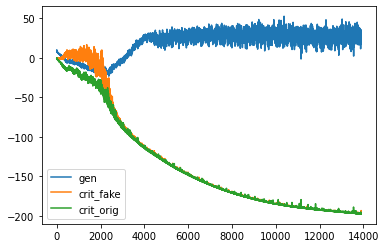

d loss fake  -196.20822143554688
d loss real  -197.5923309326172
[Epoch 41/100] [Batch 1/345] [D loss: -196.900276, acc:   0%] [G loss: 16.553756] [c1: 11.627216, c2: 11.124660, o: 58.403305, f: 28.160067] time: 8:59:59.681806
d loss fake  -197.22567749023438
d loss real  -197.52137756347656
[Epoch 41/100] [Batch 2/345] [D loss: -197.373528, acc:   0%] [G loss: 16.350528] [c1: 14.160580, c2: 12.760769, o: 40.332558, f: 13.295301] time: 9:00:01.997068
d loss fake  -197.4698486328125
d loss real  -197.30703735351562
[Epoch 41/100] [Batch 3/345] [D loss: -197.388443, acc:   0%] [G loss: 21.797778] [c1: 21.741409, c2: 18.843903, o: 40.737072, f: 13.591284] time: 9:00:04.311767
d loss fake  -197.28529357910156
d loss real  -197.69650268554688
[Epoch 41/100] [Batch 4/345] [D loss: -197.490898, acc:   0%] [G loss: 16.072369] [c1: 10.963821, c2: 10.565302, o: 50.029560, f: 19.009739] time: 9:00:06.643957
d loss fake  -196.73397827148438
d loss real  -197.63873291015625
[Epoch 41/100] [Batch 5/

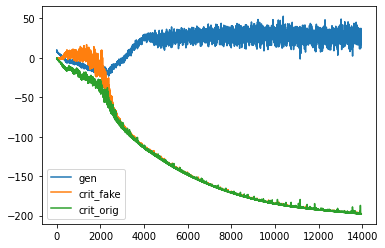

d loss fake  -197.76670837402344
d loss real  -197.9048614501953
[Epoch 41/100] [Batch 51/345] [D loss: -197.835785, acc:   0%] [G loss: 24.612278] [c1: 25.430418, c2: 25.543663, o: 54.673573, f: 27.554569] time: 9:01:54.685702
d loss fake  -197.78909301757812
d loss real  -197.8412322998047
[Epoch 41/100] [Batch 52/345] [D loss: -197.815163, acc:   0%] [G loss: 23.441769] [c1: 22.760939, c2: 22.343346, o: 51.091484, f: 24.181580] time: 9:01:56.962747
d loss fake  -197.77008056640625
d loss real  -197.89584350585938
[Epoch 41/100] [Batch 53/345] [D loss: -197.832962, acc:   0%] [G loss: 20.043604] [c1: 19.540676, c2: 18.562115, o: 46.687256, f: 21.275478] time: 9:01:59.240873
d loss fake  -197.71731567382812
d loss real  -197.82974243164062
[Epoch 41/100] [Batch 54/345] [D loss: -197.773529, acc:   0%] [G loss: 18.270211] [c1: 16.641186, c2: 16.684628, o: 46.621666, f: 20.018105] time: 9:02:01.522584
d loss fake  -197.73489379882812
d loss real  -197.87257385253906
[Epoch 41/100] [Batc

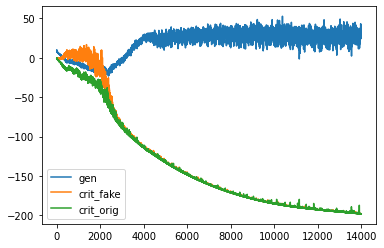

d loss fake  -197.71694946289062
d loss real  -197.93063354492188
[Epoch 41/100] [Batch 101/345] [D loss: -197.823792, acc:   0%] [G loss: 28.511311] [c1: 31.683060, c2: 32.230061, o: 62.890324, f: 34.089195] time: 9:03:51.035480
d loss fake  -197.93243408203125
d loss real  -198.00624084472656
[Epoch 41/100] [Batch 102/345] [D loss: -197.969337, acc:   0%] [G loss: 29.165400] [c1: 35.268082, c2: 35.050552, o: 61.745613, f: 33.703411] time: 9:03:53.330512
d loss fake  -197.91513061523438
d loss real  -197.99636840820312
[Epoch 41/100] [Batch 103/345] [D loss: -197.955750, acc:   0%] [G loss: 35.764599] [c1: 44.370117, c2: 44.822876, o: 64.915268, f: 37.325905] time: 9:03:55.624821
d loss fake  -197.88690185546875
d loss real  -197.74240112304688
[Epoch 41/100] [Batch 104/345] [D loss: -197.814651, acc:   0%] [G loss: 39.351035] [c1: 49.427448, c2: 49.576267, o: 69.499023, f: 40.777580] time: 9:03:57.916006
d loss fake  -197.8253936767578
d loss real  -198.00241088867188
[Epoch 41/100] 

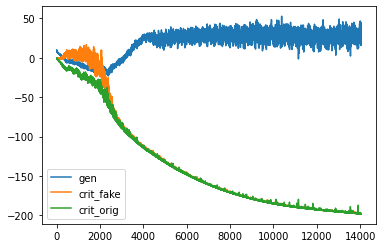

d loss fake  -198.01641845703125
d loss real  -198.10287475585938
[Epoch 41/100] [Batch 151/345] [D loss: -198.059647, acc:   0%] [G loss: 28.129581] [c1: 33.891930, c2: 33.978218, o: 60.594055, f: 38.262676] time: 9:05:47.547424
d loss fake  -197.7574005126953
d loss real  -198.12498474121094
[Epoch 41/100] [Batch 152/345] [D loss: -197.941193, acc:   0%] [G loss: 17.825853] [c1: 16.420387, c2: 16.754995, o: 54.153584, f: 29.654566] time: 9:05:49.843832
d loss fake  -197.91104125976562
d loss real  -198.0882568359375
[Epoch 41/100] [Batch 153/345] [D loss: -197.999649, acc:   0%] [G loss: 18.035596] [c1: 19.240486, c2: 17.584253, o: 37.671726, f: 17.119278] time: 9:05:52.132196
d loss fake  -197.97874450683594
d loss real  -198.12258911132812
[Epoch 41/100] [Batch 154/345] [D loss: -198.050667, acc:   0%] [G loss: 20.216661] [c1: 22.863260, c2: 21.610458, o: 40.055183, f: 18.556503] time: 9:05:54.432118
d loss fake  -197.90667724609375
d loss real  -198.12335205078125
[Epoch 41/100] [

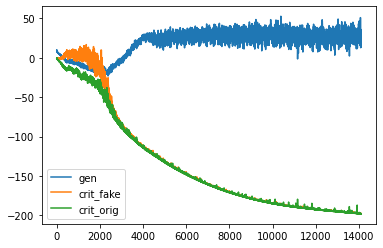

d loss fake  -198.05722045898438
d loss real  -198.22108459472656
[Epoch 41/100] [Batch 201/345] [D loss: -198.139153, acc:   0%] [G loss: 21.129961] [c1: 21.974550, c2: 22.367311, o: 45.167297, f: 21.178009] time: 9:07:43.315510
d loss fake  -198.1038055419922
d loss real  -197.96133422851562
[Epoch 41/100] [Batch 202/345] [D loss: -198.032570, acc:   0%] [G loss: 25.012983] [c1: 30.963390, c2: 30.268303, o: 42.692474, f: 23.379803] time: 9:07:45.613818
d loss fake  -197.95779418945312
d loss real  -198.2540283203125
[Epoch 41/100] [Batch 203/345] [D loss: -198.105911, acc:   0%] [G loss: 21.660793] [c1: 21.414299, c2: 22.915211, o: 53.636322, f: 27.846161] time: 9:07:47.907250
d loss fake  -198.00509643554688
d loss real  -198.24351501464844
[Epoch 41/100] [Batch 204/345] [D loss: -198.124306, acc:   0%] [G loss: 17.086103] [c1: 18.779617, c2: 18.694084, o: 45.937614, f: 23.102276] time: 9:07:50.206011
d loss fake  -198.03488159179688
d loss real  -198.1890106201172
[Epoch 41/100] [B

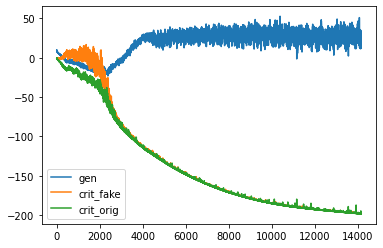

d loss fake  -198.16665649414062
d loss real  -198.24615478515625
[Epoch 41/100] [Batch 251/345] [D loss: -198.206406, acc:   0%] [G loss: 24.245773] [c1: 27.114641, c2: 26.378719, o: 49.237816, f: 22.698524] time: 9:09:39.920974
d loss fake  -198.12173461914062
d loss real  -198.32839965820312
[Epoch 41/100] [Batch 252/345] [D loss: -198.225067, acc:   0%] [G loss: 30.449774] [c1: 38.566685, c2: 38.162437, o: 53.501450, f: 29.017750] time: 9:09:42.219167
d loss fake  -198.1629638671875
d loss real  -197.9382781982422
[Epoch 41/100] [Batch 253/345] [D loss: -198.050621, acc:   0%] [G loss: 35.301461] [c1: 44.557419, c2: 43.729954, o: 61.379784, f: 39.259659] time: 9:09:44.519497
d loss fake  -197.67828369140625
d loss real  -198.3341064453125
[Epoch 41/100] [Batch 254/345] [D loss: -198.006195, acc:   0%] [G loss: 23.415517] [c1: 23.074167, c2: 23.764729, o: 69.895615, f: 41.579002] time: 9:09:46.829739
d loss fake  -198.18624877929688
d loss real  -198.3435821533203
[Epoch 41/100] [Ba

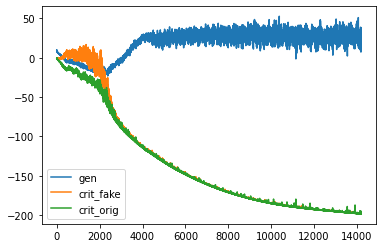

d loss fake  -198.19873046875
d loss real  -198.40951538085938
[Epoch 41/100] [Batch 301/345] [D loss: -198.304123, acc:   0%] [G loss: 14.799980] [c1: 13.342527, c2: 11.958626, o: 31.273979, f: 8.378764] time: 9:11:36.643443
d loss fake  -197.99143981933594
d loss real  -198.4596710205078
[Epoch 41/100] [Batch 302/345] [D loss: -198.225555, acc:   0%] [G loss: 10.611931] [c1: 4.235300, c2: 4.547786, o: 38.370361, f: 12.989481] time: 9:11:38.941516
d loss fake  -197.86007690429688
d loss real  -195.01348876953125
[Epoch 41/100] [Batch 303/345] [D loss: -196.436783, acc:   0%] [G loss: 20.482279] [c1: 15.065520, c2: 16.079927, o: 27.583292, f: 5.097865] time: 9:11:41.233175
d loss fake  -197.6142578125
d loss real  -198.41085815429688
[Epoch 41/100] [Batch 304/345] [D loss: -198.012558, acc:   0%] [G loss: 10.257370] [c1: -2.034920, c2: -0.835445, o: 42.499557, f: 11.497753] time: 9:11:43.539745
d loss fake  -198.01263427734375
d loss real  -198.3744354248047
[Epoch 41/100] [Batch 305/3

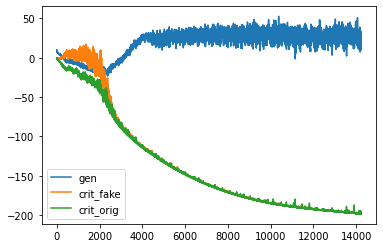

d loss fake  -194.0846405029297
d loss real  -198.45040893554688
[Epoch 42/100] [Batch 1/345] [D loss: -196.267525, acc:   0%] [G loss: -1.256287] [c1: -17.836584, c2: -16.981758, o: 30.134533, f: -0.835513] time: 9:13:12.169280
d loss fake  -195.56398010253906
d loss real  -198.27981567382812
[Epoch 42/100] [Batch 2/345] [D loss: -196.921898, acc:   0%] [G loss: 2.138377] [c1: -10.797724, c2: -9.707140, o: 10.044094, f: -16.779495] time: 9:13:14.480017
d loss fake  -198.126708984375
d loss real  -197.73892211914062
[Epoch 42/100] [Batch 3/345] [D loss: -197.932816, acc:   0%] [G loss: 16.559982] [c1: 10.846189, c2: 10.799898, o: 22.812115, f: -8.371910] time: 9:13:16.815501
d loss fake  -198.22694396972656
d loss real  -197.56585693359375
[Epoch 42/100] [Batch 4/345] [D loss: -197.896400, acc:   0%] [G loss: 26.727727] [c1: 30.997646, c2: 29.621414, o: 42.530106, f: 11.391701] time: 9:13:19.167697
d loss fake  -198.2537841796875
d loss real  -198.38180541992188
[Epoch 42/100] [Batch 5

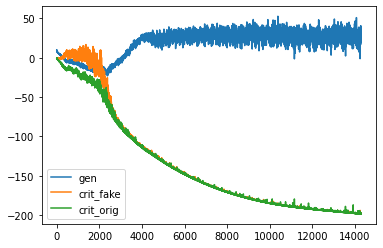

d loss fake  -198.23593139648438
d loss real  -198.61056518554688
[Epoch 42/100] [Batch 51/345] [D loss: -198.423248, acc:   0%] [G loss: 36.618220] [c1: 44.550343, c2: 43.317699, o: 64.750557, f: 34.187424] time: 9:15:08.106831
d loss fake  -198.42291259765625
d loss real  -197.2532196044922
[Epoch 42/100] [Batch 52/345] [D loss: -197.838066, acc:   0%] [G loss: 40.052252] [c1: 48.466305, c2: 47.610161, o: 73.409447, f: 44.393044] time: 9:15:10.395342
d loss fake  -198.3352508544922
d loss real  -198.46197509765625
[Epoch 42/100] [Batch 53/345] [D loss: -198.398613, acc:   0%] [G loss: 43.954481] [c1: 50.706470, c2: 52.373363, o: 74.963547, f: 43.971893] time: 9:15:12.689625
d loss fake  -198.4737548828125
d loss real  -198.4067840576172
[Epoch 42/100] [Batch 54/345] [D loss: -198.440269, acc:   0%] [G loss: 46.087841] [c1: 56.274403, c2: 56.690403, o: 87.454948, f: 54.070198] time: 9:15:14.979803
d loss fake  -198.47164916992188
d loss real  -197.6290740966797
[Epoch 42/100] [Batch 5

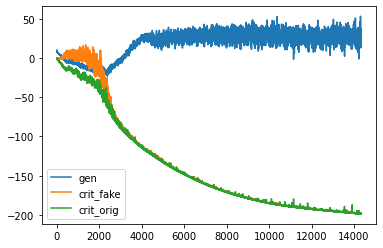

d loss fake  -198.60513305664062
d loss real  -198.75987243652344
[Epoch 42/100] [Batch 101/345] [D loss: -198.682503, acc:   0%] [G loss: 34.872649] [c1: 40.592522, c2: 40.454762, o: 61.820496, f: 31.250298] time: 9:17:04.698756
d loss fake  -198.578857421875
d loss real  -198.12913513183594
[Epoch 42/100] [Batch 102/345] [D loss: -198.353996, acc:   0%] [G loss: 40.798118] [c1: 48.369801, c2: 47.977604, o: 67.139832, f: 36.403542] time: 9:17:06.998402
d loss fake  -198.50506591796875
d loss real  -198.16322326660156
[Epoch 42/100] [Batch 103/345] [D loss: -198.334145, acc:   0%] [G loss: 41.157944] [c1: 46.943104, c2: 47.034115, o: 81.201477, f: 49.238327] time: 9:17:09.289133
d loss fake  -198.58526611328125
d loss real  -198.494384765625
[Epoch 42/100] [Batch 104/345] [D loss: -198.539825, acc:   0%] [G loss: 45.897074] [c1: 55.584175, c2: 54.533928, o: 79.332275, f: 49.058617] time: 9:17:11.589573
d loss fake  -198.54537963867188
d loss real  -198.48963928222656
[Epoch 42/100] [Ba

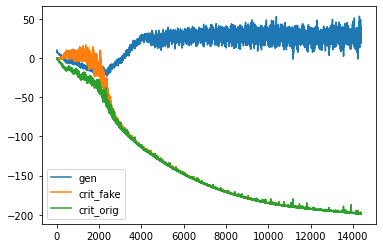

d loss fake  -198.67562866210938
d loss real  -198.71694946289062
[Epoch 42/100] [Batch 151/345] [D loss: -198.696289, acc:   0%] [G loss: 29.704332] [c1: 32.458458, c2: 33.012814, o: 49.375050, f: 22.496275] time: 9:19:01.532856
d loss fake  -198.6438446044922
d loss real  -198.8826904296875
[Epoch 42/100] [Batch 152/345] [D loss: -198.763268, acc:   0%] [G loss: 23.345192] [c1: 23.591827, c2: 23.753616, o: 58.670429, f: 33.627239] time: 9:19:03.835160
d loss fake  -198.65591430664062
d loss real  -198.79019165039062
[Epoch 42/100] [Batch 153/345] [D loss: -198.723053, acc:   0%] [G loss: 26.294472] [c1: 29.138233, c2: 28.524632, o: 46.556103, f: 22.009077] time: 9:19:06.125536
d loss fake  -198.74679565429688
d loss real  -198.8505859375
[Epoch 42/100] [Batch 154/345] [D loss: -198.798691, acc:   0%] [G loss: 28.928691] [c1: 32.807938, c2: 32.645874, o: 58.092781, f: 29.007198] time: 9:19:08.417893
d loss fake  -198.70196533203125
d loss real  -198.5296630859375
[Epoch 42/100] [Batch

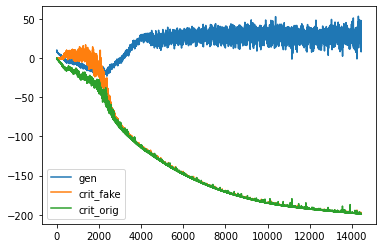

d loss fake  -198.61700439453125
d loss real  -199.0000457763672
[Epoch 42/100] [Batch 201/345] [D loss: -198.808525, acc:   0%] [G loss: 12.750468] [c1: 5.418844, c2: 5.104772, o: 36.586018, f: 6.513068] time: 9:20:57.046719
d loss fake  -198.81478881835938
d loss real  -198.68756103515625
[Epoch 42/100] [Batch 202/345] [D loss: -198.751175, acc:   0%] [G loss: 22.516392] [c1: 21.245960, c2: 22.717857, o: 34.972321, f: 7.830489] time: 9:20:59.359221
d loss fake  -198.7695770263672
d loss real  -198.75390625
[Epoch 42/100] [Batch 203/345] [D loss: -198.761742, acc:   0%] [G loss: 29.328154] [c1: 33.340065, c2: 33.107323, o: 50.968922, f: 23.196682] time: 9:21:01.647405
d loss fake  -198.6792755126953
d loss real  -198.99925231933594
[Epoch 42/100] [Batch 204/345] [D loss: -198.839264, acc:   0%] [G loss: 24.397804] [c1: 23.052719, c2: 22.567587, o: 64.093933, f: 32.264771] time: 9:21:03.938024
d loss fake  -198.6245880126953
d loss real  -198.84652709960938
[Epoch 42/100] [Batch 205/34

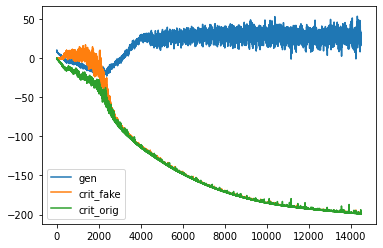

d loss fake  -198.943359375
d loss real  -198.95782470703125
[Epoch 42/100] [Batch 251/345] [D loss: -198.950592, acc:   0%] [G loss: 29.419343] [c1: 31.147526, c2: 30.519310, o: 52.720947, f: 21.886362] time: 9:22:53.847287
d loss fake  -198.919921875
d loss real  -198.82203674316406
[Epoch 42/100] [Batch 252/345] [D loss: -198.870979, acc:   0%] [G loss: 35.051032] [c1: 38.707256, c2: 37.806259, o: 62.383404, f: 33.088013] time: 9:22:56.146694
d loss fake  -198.8328857421875
d loss real  -199.0869903564453
[Epoch 42/100] [Batch 253/345] [D loss: -198.959938, acc:   0%] [G loss: 25.391446] [c1: 22.286243, c2: 21.737944, o: 69.894592, f: 38.368225] time: 9:22:58.441090
d loss fake  -198.9186553955078
d loss real  -199.00616455078125
[Epoch 42/100] [Batch 254/345] [D loss: -198.962410, acc:   0%] [G loss: 30.904261] [c1: 32.561668, c2: 32.151901, o: 50.863960, f: 23.448063] time: 9:23:00.739725
d loss fake  -198.81948852539062
d loss real  -198.9601593017578
[Epoch 42/100] [Batch 255/34

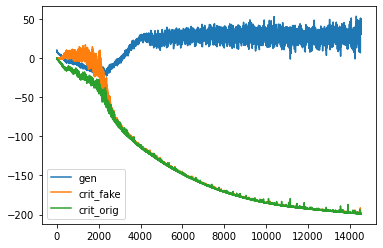

d loss fake  -198.99826049804688
d loss real  -198.89830017089844
[Epoch 42/100] [Batch 301/345] [D loss: -198.948280, acc:   0%] [G loss: 41.201211] [c1: 48.373390, c2: 48.545540, o: 81.752930, f: 52.808327] time: 9:24:50.399926
d loss fake  -198.963623046875
d loss real  -199.06756591796875
[Epoch 42/100] [Batch 302/345] [D loss: -199.015594, acc:   0%] [G loss: 39.980159] [c1: 48.008869, c2: 46.295380, o: 82.768784, f: 52.449692] time: 9:24:52.698007
d loss fake  -199.06349182128906
d loss real  -199.1536865234375
[Epoch 42/100] [Batch 303/345] [D loss: -199.108589, acc:   0%] [G loss: 36.037144] [c1: 39.127251, c2: 38.572128, o: 72.932281, f: 43.008057] time: 9:24:54.986914
d loss fake  -199.02828979492188
d loss real  -197.076904296875
[Epoch 42/100] [Batch 304/345] [D loss: -198.052597, acc:   0%] [G loss: 43.622045] [c1: 50.250145, c2: 50.254780, o: 65.809692, f: 40.317944] time: 9:24:57.285843
d loss fake  -198.74989318847656
d loss real  -199.10487365722656
[Epoch 42/100] [Bat

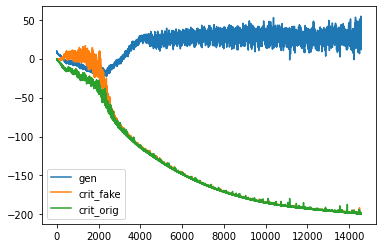

d loss fake  -199.069580078125
d loss real  -199.2671356201172
[Epoch 43/100] [Batch 1/345] [D loss: -199.168358, acc:   0%] [G loss: 36.501218] [c1: 42.961956, c2: 42.239380, o: 64.423576, f: 34.514729] time: 9:26:29.882513
d loss fake  -198.54006958007812
d loss real  -199.24301147460938
[Epoch 43/100] [Batch 2/345] [D loss: -198.891541, acc:   0%] [G loss: 25.892602] [c1: 23.313263, c2: 23.351368, o: 69.664848, f: 38.346046] time: 9:26:32.240536
d loss fake  -199.12899780273438
d loss real  -199.21963500976562
[Epoch 43/100] [Batch 3/345] [D loss: -199.174316, acc:   0%] [G loss: 38.846328] [c1: 41.258896, c2: 41.248016, o: 58.159012, f: 25.495758] time: 9:26:34.616940
d loss fake  -199.03265380859375
d loss real  -199.28512573242188
[Epoch 43/100] [Batch 4/345] [D loss: -199.158890, acc:   0%] [G loss: 31.777689] [c1: 31.703140, c2: 32.198002, o: 75.860703, f: 43.071335] time: 9:26:36.981523
d loss fake  -199.19686889648438
d loss real  -199.2837371826172
[Epoch 43/100] [Batch 5/34

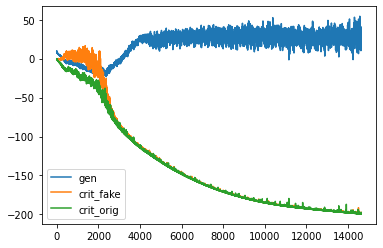

d loss fake  -199.19898986816406
d loss real  -199.39007568359375
[Epoch 43/100] [Batch 51/345] [D loss: -199.294533, acc:   0%] [G loss: 28.909783] [c1: 25.801748, c2: 26.209375, o: 51.541687, f: 12.048780] time: 9:28:25.072980
d loss fake  -199.107421875
d loss real  -198.93524169921875
[Epoch 43/100] [Batch 52/345] [D loss: -199.021332, acc:   0%] [G loss: 30.168819] [c1: 29.678223, c2: 29.354645, o: 61.138924, f: 27.637323] time: 9:28:27.356925
d loss fake  -199.23880004882812
d loss real  -199.275390625
[Epoch 43/100] [Batch 53/345] [D loss: -199.257095, acc:   0%] [G loss: 31.050671] [c1: 32.969654, c2: 32.875359, o: 62.037884, f: 32.272602] time: 9:28:29.635677
d loss fake  -198.98361206054688
d loss real  -199.39381408691406
[Epoch 43/100] [Batch 54/345] [D loss: -199.188713, acc:   0%] [G loss: 23.726272] [c1: 19.685509, c2: 19.631138, o: 66.659409, f: 30.910984] time: 9:28:31.909074
d loss fake  -199.238037109375
d loss real  -198.40499877929688
[Epoch 43/100] [Batch 55/345] 

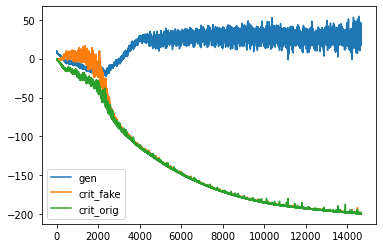

d loss fake  -199.3891143798828
d loss real  -199.4873046875
[Epoch 43/100] [Batch 101/345] [D loss: -199.438210, acc:   0%] [G loss: 21.470236] [c1: 15.525728, c2: 14.936276, o: 57.836075, f: 21.074944] time: 9:30:21.068661
d loss fake  -199.355224609375
d loss real  -199.52444458007812
[Epoch 43/100] [Batch 102/345] [D loss: -199.439835, acc:   0%] [G loss: 29.873784] [c1: 29.566648, c2: 29.274393, o: 48.364952, f: 14.898309] time: 9:30:23.351267
d loss fake  -199.35342407226562
d loss real  -199.50155639648438
[Epoch 43/100] [Batch 103/345] [D loss: -199.427490, acc:   0%] [G loss: 29.542392] [c1: 29.482088, c2: 28.682289, o: 63.568665, f: 30.848053] time: 9:30:25.636088
d loss fake  -198.813232421875
d loss real  -199.37408447265625
[Epoch 43/100] [Batch 104/345] [D loss: -199.093658, acc:   0%] [G loss: 25.069352] [c1: 18.544132, c2: 18.722542, o: 62.494026, f: 24.578671] time: 9:30:27.915164
d loss fake  -199.3265380859375
d loss real  -199.47265625
[Epoch 43/100] [Batch 105/345]

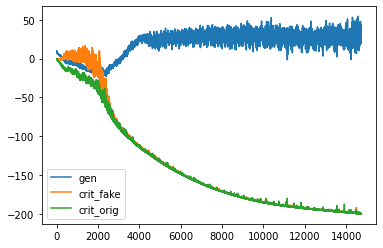

d loss fake  -199.47119140625
d loss real  -199.60830688476562
[Epoch 43/100] [Batch 151/345] [D loss: -199.539749, acc:   0%] [G loss: 20.747253] [c1: 15.774936, c2: 16.091579, o: 56.833870, f: 23.519066] time: 9:32:16.670074
d loss fake  -199.46990966796875
d loss real  -199.6249237060547
[Epoch 43/100] [Batch 152/345] [D loss: -199.547417, acc:   0%] [G loss: 21.895725] [c1: 19.366228, c2: 19.409307, o: 48.451488, f: 16.471643] time: 9:32:18.945946
d loss fake  -199.4019012451172
d loss real  -199.61309814453125
[Epoch 43/100] [Batch 153/345] [D loss: -199.507500, acc:   0%] [G loss: 31.101024] [c1: 33.559685, c2: 32.241035, o: 48.049637, f: 23.347347] time: 9:32:21.224787
d loss fake  -199.4875030517578
d loss real  -199.60601806640625
[Epoch 43/100] [Batch 154/345] [D loss: -199.546761, acc:   0%] [G loss: 24.419600] [c1: 21.856472, c2: 21.735117, o: 61.594269, f: 29.454674] time: 9:32:23.509834
d loss fake  -199.4615020751953
d loss real  -199.1431121826172
[Epoch 43/100] [Batch 

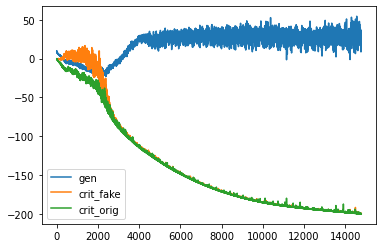

d loss fake  -199.49154663085938
d loss real  -198.16720581054688
[Epoch 43/100] [Batch 201/345] [D loss: -198.829376, acc:   0%] [G loss: 36.751913] [c1: 42.152996, c2: 40.467278, o: 52.486809, f: 22.785118] time: 9:34:11.752069
d loss fake  -199.5894775390625
d loss real  -199.47586059570312
[Epoch 43/100] [Batch 202/345] [D loss: -199.532669, acc:   0%] [G loss: 37.369331] [c1: 42.896416, c2: 42.370590, o: 73.104263, f: 41.817249] time: 9:34:14.055137
d loss fake  -199.534912109375
d loss real  -199.40362548828125
[Epoch 43/100] [Batch 203/345] [D loss: -199.469269, acc:   0%] [G loss: 34.988334] [c1: 36.429634, c2: 37.736332, o: 74.742554, f: 41.010426] time: 9:34:16.345852
d loss fake  -199.59938049316406
d loss real  -199.74288940429688
[Epoch 43/100] [Batch 204/345] [D loss: -199.671135, acc:   0%] [G loss: 35.136232] [c1: 36.625690, c2: 36.616692, o: 74.703957, f: 34.810413] time: 9:34:18.648633
d loss fake  -199.4598388671875
d loss real  -199.6083526611328
[Epoch 43/100] [Bat

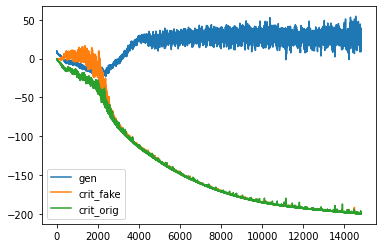

d loss fake  -199.404052734375
d loss real  -199.58984375
[Epoch 43/100] [Batch 251/345] [D loss: -199.496948, acc:   0%] [G loss: 21.382622] [c1: 17.749290, c2: 17.380142, o: 52.830711, f: 20.652536] time: 9:36:07.976820
d loss fake  -198.6976318359375
d loss real  -198.90728759765625
[Epoch 43/100] [Batch 252/345] [D loss: -198.802460, acc:   0%] [G loss: 24.092130] [c1: 18.869564, c2: 18.846626, o: 52.190819, f: 18.759951] time: 9:36:10.267891
d loss fake  -199.6624755859375
d loss real  -199.82388305664062
[Epoch 43/100] [Batch 253/345] [D loss: -199.743179, acc:   0%] [G loss: 17.757360] [c1: 12.898955, c2: 14.363968, o: 52.507744, f: 20.157082] time: 9:36:12.561034
d loss fake  -199.6427001953125
d loss real  -199.86253356933594
[Epoch 43/100] [Batch 254/345] [D loss: -199.752617, acc:   0%] [G loss: 22.439977] [c1: 24.870493, c2: 24.121529, o: 44.038471, f: 17.668095] time: 9:36:14.852915
d loss fake  -199.04739379882812
d loss real  -199.86248779296875
[Epoch 43/100] [Batch 255

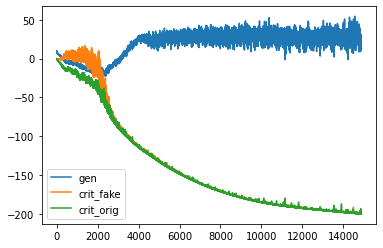

d loss fake  -199.70692443847656
d loss real  -199.11688232421875
[Epoch 43/100] [Batch 301/345] [D loss: -199.411903, acc:   0%] [G loss: 34.892450] [c1: 34.138535, c2: 32.942181, o: 57.554451, f: 25.914036] time: 9:38:04.136113
d loss fake  -199.73471069335938
d loss real  -199.86837768554688
[Epoch 43/100] [Batch 302/345] [D loss: -199.801544, acc:   0%] [G loss: 31.687009] [c1: 31.102745, c2: 30.491364, o: 67.868896, f: 34.396534] time: 9:38:06.419417
d loss fake  -199.28045654296875
d loss real  -199.98143005371094
[Epoch 43/100] [Batch 303/345] [D loss: -199.630943, acc:   0%] [G loss: 21.048972] [c1: 12.107819, c2: 12.219403, o: 61.773705, f: 27.853371] time: 9:38:08.703535
d loss fake  -199.4053192138672
d loss real  -199.95567321777344
[Epoch 43/100] [Batch 304/345] [D loss: -199.680496, acc:   0%] [G loss: 11.340616] [c1: -1.433905, c2: -1.481373, o: 45.322781, f: 12.196745] time: 9:38:10.984423
d loss fake  -199.75770568847656
d loss real  -199.8980712890625
[Epoch 43/100] [

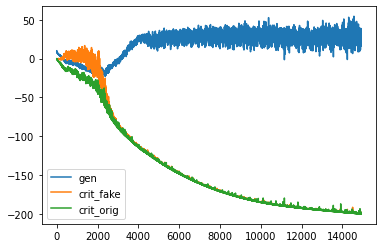

d loss fake  -198.23626708984375
d loss real  -199.9428253173828
[Epoch 44/100] [Batch 1/345] [D loss: -199.089546, acc:   0%] [G loss: 12.227757] [c1: 1.531574, c2: 2.031867, o: 46.710121, f: 13.884159] time: 9:39:39.406806
d loss fake  -199.78297424316406
d loss real  -199.7375030517578
[Epoch 44/100] [Batch 2/345] [D loss: -199.760239, acc:   0%] [G loss: 17.833709] [c1: 15.371670, c2: 15.211171, o: 39.041996, f: 4.510254] time: 9:39:41.717979
d loss fake  -199.76214599609375
d loss real  -200.01341247558594
[Epoch 44/100] [Batch 3/345] [D loss: -199.887779, acc:   0%] [G loss: 18.286385] [c1: 10.317669, c2: 10.450411, o: 53.513111, f: 15.936925] time: 9:39:44.044908
d loss fake  -198.79026794433594
d loss real  -200.03903198242188
[Epoch 44/100] [Batch 4/345] [D loss: -199.414650, acc:   0%] [G loss: 6.622114] [c1: -7.687169, c2: -7.362846, o: 40.489296, f: 6.494232] time: 9:39:46.394518
d loss fake  -199.8587646484375
d loss real  -200.0137939453125
[Epoch 44/100] [Batch 5/345] [D

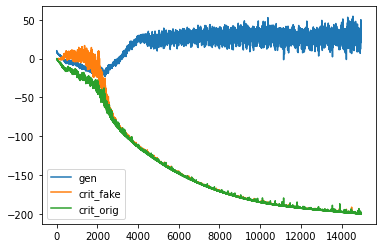

d loss fake  -199.5275421142578
d loss real  -200.1243438720703
[Epoch 44/100] [Batch 51/345] [D loss: -199.825943, acc:   0%] [G loss: 22.822358] [c1: 16.464136, c2: 17.412025, o: 69.482498, f: 32.675812] time: 9:41:34.830453
d loss fake  -199.5331268310547
d loss real  -199.99070739746094
[Epoch 44/100] [Batch 52/345] [D loss: -199.761917, acc:   0%] [G loss: 20.314950] [c1: 13.076060, c2: 13.316329, o: 51.163605, f: 13.377020] time: 9:41:37.112379
d loss fake  -200.0550537109375
d loss real  -200.1673126220703
[Epoch 44/100] [Batch 53/345] [D loss: -200.111183, acc:   0%] [G loss: 25.898402] [c1: 24.847313, c2: 23.356176, o: 53.373917, f: 18.248686] time: 9:41:39.396195
d loss fake  -199.56781005859375
d loss real  -199.83251953125
[Epoch 44/100] [Batch 54/345] [D loss: -199.700165, acc:   0%] [G loss: 25.140057] [c1: 19.453541, c2: 19.892715, o: 54.501282, f: 20.849585] time: 9:41:41.668300
d loss fake  -199.77523803710938
d loss real  -200.08712768554688
[Epoch 44/100] [Batch 55/3

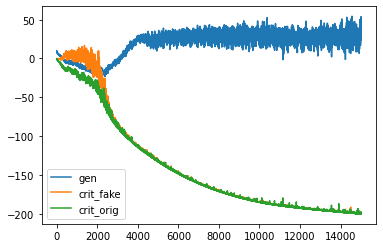

d loss fake  -200.01258850097656
d loss real  -200.23355102539062
[Epoch 44/100] [Batch 101/345] [D loss: -200.123070, acc:   0%] [G loss: 29.657379] [c1: 26.892208, c2: 25.894962, o: 74.498367, f: 34.631340] time: 9:43:30.607253
d loss fake  -199.9970703125
d loss real  -200.22206115722656
[Epoch 44/100] [Batch 102/345] [D loss: -200.109566, acc:   0%] [G loss: 27.208329] [c1: 21.549236, c2: 21.314520, o: 63.039257, f: 24.622990] time: 9:43:32.886713
d loss fake  -200.09954833984375
d loss real  -200.21116638183594
[Epoch 44/100] [Batch 103/345] [D loss: -200.155357, acc:   0%] [G loss: 25.786090] [c1: 19.768797, c2: 19.087654, o: 63.117672, f: 25.385902] time: 9:43:35.172144
d loss fake  -199.72244262695312
d loss real  -200.21511840820312
[Epoch 44/100] [Batch 104/345] [D loss: -199.968781, acc:   0%] [G loss: 15.178634] [c1: 6.196631, c2: 5.851476, o: 53.863945, f: 17.066399] time: 9:43:37.475384
d loss fake  -199.9497528076172
d loss real  -200.2571563720703
[Epoch 44/100] [Batch 

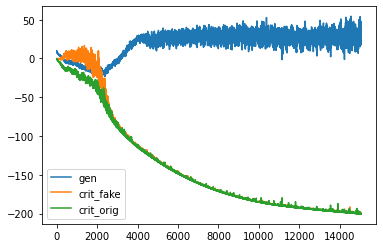

d loss fake  -200.1281280517578
d loss real  -199.52743530273438
[Epoch 44/100] [Batch 151/345] [D loss: -199.827782, acc:   0%] [G loss: 32.427575] [c1: 32.666443, c2: 32.623096, o: 44.503784, f: 16.043919] time: 9:45:26.608017
d loss fake  -200.2265167236328
d loss real  -200.310302734375
[Epoch 44/100] [Batch 152/345] [D loss: -200.268410, acc:   0%] [G loss: 26.930529] [c1: 24.180080, c2: 25.108114, o: 65.195877, f: 32.850441] time: 9:45:28.889604
d loss fake  -199.91954040527344
d loss real  -200.38876342773438
[Epoch 44/100] [Batch 153/345] [D loss: -200.154152, acc:   0%] [G loss: 20.762626] [c1: 11.195580, c2: 12.366497, o: 56.546234, f: 19.347193] time: 9:45:31.181126
d loss fake  -200.24050903320312
d loss real  -200.37179565429688
[Epoch 44/100] [Batch 154/345] [D loss: -200.306152, acc:   0%] [G loss: 21.038351] [c1: 17.589991, c2: 17.270123, o: 47.543621, f: 14.098175] time: 9:45:33.472956
d loss fake  -200.29315185546875
d loss real  -200.3758544921875
[Epoch 44/100] [Bat

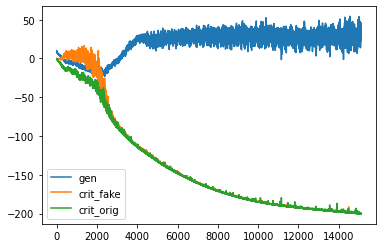

d loss fake  -200.31185913085938
d loss real  -200.20977783203125
[Epoch 44/100] [Batch 201/345] [D loss: -200.260818, acc:   0%] [G loss: 34.816800] [c1: 37.327927, c2: 37.300385, o: 61.991264, f: 33.896271] time: 9:47:21.066854
d loss fake  -200.31845092773438
d loss real  -200.41207885742188
[Epoch 44/100] [Batch 202/345] [D loss: -200.365265, acc:   0%] [G loss: 37.596986] [c1: 42.264301, c2: 42.183723, o: 67.551971, f: 37.307442] time: 9:47:23.350823
d loss fake  -200.32476806640625
d loss real  -200.5040283203125
[Epoch 44/100] [Batch 203/345] [D loss: -200.414398, acc:   0%] [G loss: 42.488039] [c1: 50.277981, c2: 50.852325, o: 78.642731, f: 44.477814] time: 9:47:25.622964
d loss fake  -200.04515075683594
d loss real  -200.34173583984375
[Epoch 44/100] [Batch 204/345] [D loss: -200.193443, acc:   0%] [G loss: 53.715611] [c1: 65.098709, c2: 65.619164, o: 81.385269, f: 46.996048] time: 9:47:27.898066
d loss fake  -200.29937744140625
d loss real  -200.33213806152344
[Epoch 44/100] 

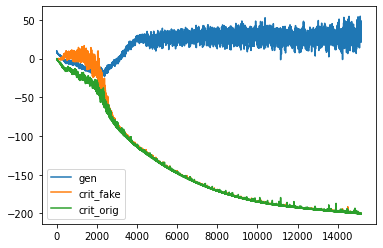

d loss fake  -200.37701416015625
d loss real  -200.58499145507812
[Epoch 44/100] [Batch 251/345] [D loss: -200.481003, acc:   0%] [G loss: 29.773306] [c1: 25.968748, c2: 26.566036, o: 66.539238, f: 30.110716] time: 9:49:16.974289
d loss fake  -200.3932647705078
d loss real  -200.37466430664062
[Epoch 44/100] [Batch 252/345] [D loss: -200.383965, acc:   0%] [G loss: 30.475018] [c1: 32.038708, c2: 34.367821, o: 59.416725, f: 29.481655] time: 9:49:19.265193
d loss fake  -200.5708770751953
d loss real  -200.6420440673828
[Epoch 44/100] [Batch 253/345] [D loss: -200.606461, acc:   0%] [G loss: 27.773285] [c1: 26.664280, c2: 26.019484, o: 63.613811, f: 31.264744] time: 9:49:21.532007
d loss fake  -200.54359436035156
d loss real  -200.65643310546875
[Epoch 44/100] [Batch 254/345] [D loss: -200.600014, acc:   0%] [G loss: 25.844166] [c1: 26.456108, c2: 25.863899, o: 58.901047, f: 27.670574] time: 9:49:23.813262
d loss fake  -200.49459838867188
d loss real  -200.52035522460938
[Epoch 44/100] [B

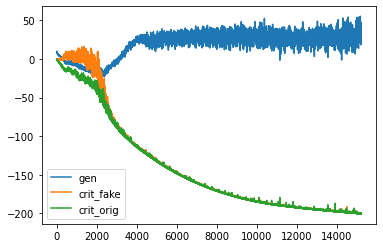

d loss fake  -200.54086303710938
d loss real  -198.96444702148438
[Epoch 44/100] [Batch 301/345] [D loss: -199.752655, acc:   0%] [G loss: 33.972007] [c1: 29.996399, c2: 30.660809, o: 51.861961, f: 16.221609] time: 9:51:12.547781
d loss fake  -200.5484619140625
d loss real  -200.64688110351562
[Epoch 44/100] [Batch 302/345] [D loss: -200.597672, acc:   0%] [G loss: 34.707443] [c1: 34.242119, c2: 34.040375, o: 70.655289, f: 33.242634] time: 9:51:14.828892
d loss fake  -200.58425903320312
d loss real  -200.55010986328125
[Epoch 44/100] [Batch 303/345] [D loss: -200.567184, acc:   0%] [G loss: 42.442202] [c1: 48.015236, c2: 46.479713, o: 72.253685, f: 36.276314] time: 9:51:17.102123
d loss fake  -200.5665283203125
d loss real  -200.66802978515625
[Epoch 44/100] [Batch 304/345] [D loss: -200.617279, acc:   0%] [G loss: 29.517436] [c1: 25.894985, c2: 25.446362, o: 84.145355, f: 42.802586] time: 9:51:19.389243
d loss fake  -200.61691284179688
d loss real  -200.66363525390625
[Epoch 44/100] [

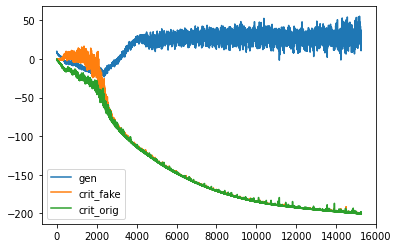

d loss fake  -200.1416473388672
d loss real  -200.7174530029297
[Epoch 45/100] [Batch 1/345] [D loss: -200.429550, acc:   0%] [G loss: 21.575762] [c1: 12.823265, c2: 13.467196, o: 55.516411, f: 21.200157] time: 9:52:47.717096
d loss fake  -200.3967742919922
d loss real  -200.7692413330078
[Epoch 45/100] [Batch 2/345] [D loss: -200.583008, acc:   0%] [G loss: 15.861050] [c1: 4.279127, c2: 4.616002, o: 49.425697, f: 14.989448] time: 9:52:50.009126
d loss fake  -199.7360382080078
d loss real  -200.6797332763672
[Epoch 45/100] [Batch 3/345] [D loss: -200.207886, acc:   0%] [G loss: 11.514595] [c1: -0.178613, c2: -0.810585, o: 37.567627, f: 2.040760] time: 9:52:52.342400
d loss fake  -200.00289916992188
d loss real  -200.74464416503906
[Epoch 45/100] [Batch 4/345] [D loss: -200.373772, acc:   0%] [G loss: 10.121777] [c1: 0.016178, c2: -0.162625, o: 34.964008, f: 0.859048] time: 9:52:54.650779
d loss fake  -200.66441345214844
d loss real  -200.71383666992188
[Epoch 45/100] [Batch 5/345] [D l

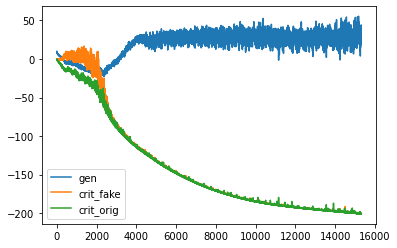

d loss fake  -200.80384826660156
d loss real  -200.6787109375
[Epoch 45/100] [Batch 51/345] [D loss: -200.741280, acc:   0%] [G loss: 43.773989] [c1: 46.416576, c2: 46.349552, o: 85.528641, f: 47.486565] time: 9:54:42.722402
d loss fake  -200.7568359375
d loss real  -200.93173217773438
[Epoch 45/100] [Batch 52/345] [D loss: -200.844284, acc:   0%] [G loss: 43.872940] [c1: 51.127087, c2: 51.214405, o: 85.081970, f: 47.826424] time: 9:54:45.007016
d loss fake  -200.8306427001953
d loss real  -200.85491943359375
[Epoch 45/100] [Batch 53/345] [D loss: -200.842781, acc:   0%] [G loss: 47.822687] [c1: 57.547302, c2: 57.370224, o: 89.605431, f: 54.535069] time: 9:54:47.292116
d loss fake  -200.8685302734375
d loss real  -200.931396484375
[Epoch 45/100] [Batch 54/345] [D loss: -200.899963, acc:   0%] [G loss: 41.444597] [c1: 45.803078, c2: 45.349693, o: 93.006134, f: 54.738605] time: 9:54:49.578457
d loss fake  -200.81434631347656
d loss real  -200.6274871826172
[Epoch 45/100] [Batch 55/345] [

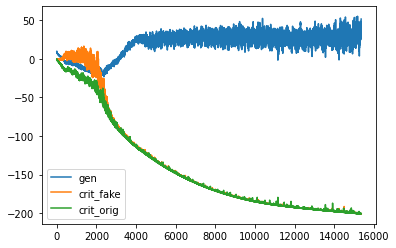

d loss fake  -200.94837951660156
d loss real  -200.94781494140625
[Epoch 45/100] [Batch 101/345] [D loss: -200.948097, acc:   0%] [G loss: 48.088953] [c1: 57.548843, c2: 57.373585, o: 99.887299, f: 63.559448] time: 9:56:38.947790
d loss fake  -200.9313507080078
d loss real  -201.04879760742188
[Epoch 45/100] [Batch 102/345] [D loss: -200.990074, acc:   0%] [G loss: 38.688201] [c1: 43.437897, c2: 43.266384, o: 93.076263, f: 58.302910] time: 9:56:41.232713
d loss fake  -200.99935913085938
d loss real  -201.0462188720703
[Epoch 45/100] [Batch 103/345] [D loss: -201.022789, acc:   0%] [G loss: 30.611033] [c1: 30.941277, c2: 30.785271, o: 80.458206, f: 42.725254] time: 9:56:43.508294
d loss fake  -201.010009765625
d loss real  -201.00318908691406
[Epoch 45/100] [Batch 104/345] [D loss: -201.006599, acc:   0%] [G loss: 36.829127] [c1: 41.262604, c2: 40.512199, o: 67.733055, f: 32.238911] time: 9:56:45.795956
d loss fake  -200.97378540039062
d loss real  -201.10940551757812
[Epoch 45/100] [Ba

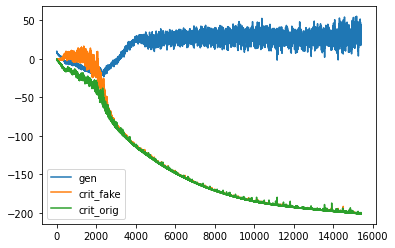

d loss fake  -201.05364990234375
d loss real  -201.09716796875
[Epoch 45/100] [Batch 151/345] [D loss: -201.075409, acc:   0%] [G loss: 36.145568] [c1: 36.878563, c2: 36.331032, o: 63.207191, f: 32.047035] time: 9:58:34.621588
d loss fake  -200.84619140625
d loss real  -201.15969848632812
[Epoch 45/100] [Batch 152/345] [D loss: -201.002945, acc:   0%] [G loss: 24.535398] [c1: 18.996193, c2: 18.849594, o: 70.464775, f: 37.404186] time: 9:58:36.917125
d loss fake  -201.02337646484375
d loss real  -201.1060028076172
[Epoch 45/100] [Batch 153/345] [D loss: -201.064690, acc:   0%] [G loss: 26.112673] [c1: 23.029076, c2: 23.544613, o: 50.012775, f: 18.941748] time: 9:58:39.182519
d loss fake  -200.97268676757812
d loss real  -201.14730834960938
[Epoch 45/100] [Batch 154/345] [D loss: -201.059998, acc:   0%] [G loss: 24.153120] [c1: 19.674923, c2: 19.637558, o: 52.515617, f: 21.475466] time: 9:58:41.472802
d loss fake  -200.89700317382812
d loss real  -201.17184448242188
[Epoch 45/100] [Batch

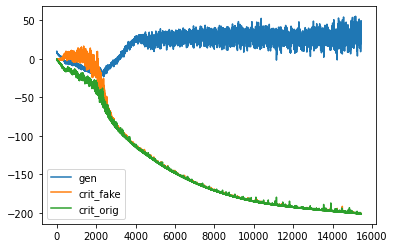

d loss fake  -201.16763305664062
d loss real  -201.30020141601562
[Epoch 45/100] [Batch 201/345] [D loss: -201.233917, acc:   0%] [G loss: 25.902341] [c1: 25.166569, c2: 24.054060, o: 56.714447, f: 29.276939] time: 10:00:29.536611
d loss fake  -201.16690063476562
d loss real  -201.2662811279297
[Epoch 45/100] [Batch 202/345] [D loss: -201.216591, acc:   0%] [G loss: 28.595139] [c1: 30.183052, c2: 29.002789, o: 52.668732, f: 23.451801] time: 10:00:31.827708
d loss fake  -201.03292846679688
d loss real  -201.30963134765625
[Epoch 45/100] [Batch 203/345] [D loss: -201.171280, acc:   0%] [G loss: 20.765644] [c1: 14.869544, c2: 14.507964, o: 63.357471, f: 29.206856] time: 10:00:34.101794
d loss fake  -201.15316772460938
d loss real  -201.25430297851562
[Epoch 45/100] [Batch 204/345] [D loss: -201.203735, acc:   0%] [G loss: 23.135933] [c1: 17.511105, c2: 17.018578, o: 47.508701, f: 15.137052] time: 10:00:36.385933
d loss fake  -201.174560546875
d loss real  -201.15231323242188
[Epoch 45/100

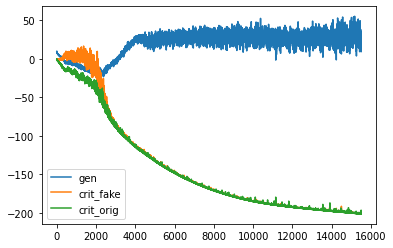

d loss fake  -201.0665283203125
d loss real  -201.27066040039062
[Epoch 45/100] [Batch 251/345] [D loss: -201.168594, acc:   0%] [G loss: 17.448597] [c1: 9.554151, c2: 8.674061, o: 30.673244, f: -1.963341] time: 10:02:25.516692
d loss fake  -201.01612854003906
d loss real  -201.34869384765625
[Epoch 45/100] [Batch 252/345] [D loss: -201.182411, acc:   0%] [G loss: 17.243565] [c1: 8.571523, c2: 7.088676, o: 41.685059, f: 7.434459] time: 10:02:27.805680
d loss fake  -200.72662353515625
d loss real  -201.32061767578125
[Epoch 45/100] [Batch 253/345] [D loss: -201.023621, acc:   0%] [G loss: 4.513096] [c1: -12.778759, c2: -12.917072, o: 42.589413, f: 5.955128] time: 10:02:30.090989
d loss fake  -201.20864868164062
d loss real  -201.3345184326172
[Epoch 45/100] [Batch 254/345] [D loss: -201.271584, acc:   0%] [G loss: 11.735899] [c1: 1.073562, c2: 1.156707, o: 20.648239, f: -11.394176] time: 10:02:32.384116
d loss fake  -201.24925231933594
d loss real  -200.84188842773438
[Epoch 45/100] [Ba

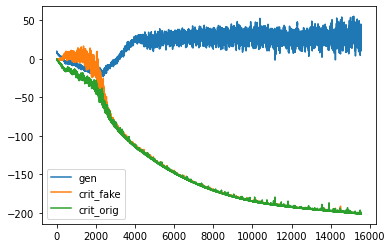

d loss fake  -200.07501220703125
d loss real  -201.39334106445312
[Epoch 45/100] [Batch 301/345] [D loss: -200.734177, acc:   0%] [G loss: 20.454190] [c1: 13.238466, c2: 13.529814, o: 72.758179, f: 36.429443] time: 10:04:21.504055
d loss fake  -201.2650604248047
d loss real  -201.42483520507812
[Epoch 45/100] [Batch 302/345] [D loss: -201.344948, acc:   0%] [G loss: 22.967042] [c1: 15.230470, c2: 14.630405, o: 49.124100, f: 12.280270] time: 10:04:23.805622
d loss fake  -201.370361328125
d loss real  -201.45559692382812
[Epoch 45/100] [Batch 303/345] [D loss: -201.412979, acc:   0%] [G loss: 22.156252] [c1: 17.256380, c2: 16.525942, o: 53.788784, f: 17.887611] time: 10:04:26.078210
d loss fake  -201.226318359375
d loss real  -201.0716552734375
[Epoch 45/100] [Batch 304/345] [D loss: -201.148987, acc:   0%] [G loss: 26.123253] [c1: 19.331207, c2: 19.199766, o: 49.086590, f: 12.361332] time: 10:04:28.368261
d loss fake  -200.86599731445312
d loss real  -201.3865966796875
[Epoch 45/100] [B

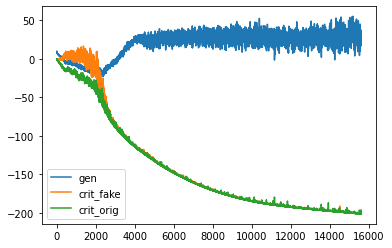

d loss fake  -198.93667602539062
d loss real  -197.61746215820312
[Epoch 46/100] [Batch 1/345] [D loss: -198.277069, acc:   0%] [G loss: 23.546923] [c1: 8.083147, c2: 8.580447, o: 50.027382, f: 6.528103] time: 10:05:58.086192
d loss fake  -201.23663330078125
d loss real  -201.39808654785156
[Epoch 46/100] [Batch 2/345] [D loss: -201.317360, acc:   0%] [G loss: 22.646602] [c1: 11.898638, c2: 12.462831, o: 61.524971, f: 11.615367] time: 10:06:00.432604
d loss fake  -201.132568359375
d loss real  -201.30978393554688
[Epoch 46/100] [Batch 3/345] [D loss: -201.221176, acc:   0%] [G loss: 23.608665] [c1: 15.869874, c2: 16.049477, o: 52.588020, f: 12.511841] time: 10:06:02.767403
d loss fake  -201.37216186523438
d loss real  -201.5139923095703
[Epoch 46/100] [Batch 4/345] [D loss: -201.443077, acc:   0%] [G loss: 28.177703] [c1: 21.926094, c2: 18.926514, o: 54.237438, f: 21.701611] time: 10:06:05.113817
d loss fake  -201.2019805908203
d loss real  -201.45724487304688
[Epoch 46/100] [Batch 5/3

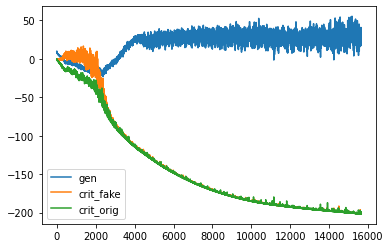

d loss fake  -201.485107421875
d loss real  -201.62353515625
[Epoch 46/100] [Batch 51/345] [D loss: -201.554321, acc:   0%] [G loss: 27.966756] [c1: 22.499809, c2: 22.398586, o: 61.122925, f: 20.412283] time: 10:07:53.319460
d loss fake  -201.44491577148438
d loss real  -201.6259765625
[Epoch 46/100] [Batch 52/345] [D loss: -201.535446, acc:   0%] [G loss: 24.671519] [c1: 14.896731, c2: 14.445748, o: 62.636604, f: 20.351015] time: 10:07:55.603877
d loss fake  -201.4911346435547
d loss real  -201.51431274414062
[Epoch 46/100] [Batch 53/345] [D loss: -201.502724, acc:   0%] [G loss: 30.789240] [c1: 27.514099, c2: 26.965096, o: 56.291611, f: 17.408836] time: 10:07:57.882209
d loss fake  -199.75230407714844
d loss real  -200.47772216796875
[Epoch 46/100] [Batch 54/345] [D loss: -200.115013, acc:   0%] [G loss: 32.103812] [c1: 19.101284, c2: 19.400616, o: 66.754135, f: 22.924282] time: 10:08:00.141983
d loss fake  -201.48324584960938
d loss real  -201.630859375
[Epoch 46/100] [Batch 55/345]

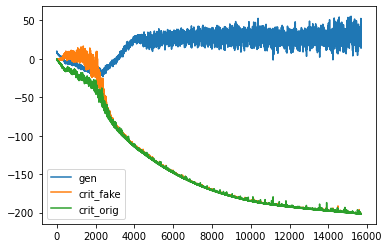

d loss fake  -201.21063232421875
d loss real  -201.80206298828125
[Epoch 46/100] [Batch 101/345] [D loss: -201.506348, acc:   0%] [G loss: 21.449052] [c1: 13.129019, c2: 13.369834, o: 61.812786, f: 22.332695] time: 10:09:49.633298
d loss fake  -200.3006591796875
d loss real  -195.65890502929688
[Epoch 46/100] [Batch 102/345] [D loss: -197.979782, acc:   0%] [G loss: 18.035162] [c1: -0.796747, c2: -0.251159, o: 49.478287, f: 13.101182] time: 10:09:51.929009
d loss fake  -201.55740356445312
d loss real  -201.6404571533203
[Epoch 46/100] [Batch 103/345] [D loss: -201.598930, acc:   0%] [G loss: 22.420329] [c1: 9.583670, c2: 9.750041, o: 52.263229, f: 7.074994] time: 10:09:54.226264
d loss fake  -201.55810546875
d loss real  -201.49542236328125
[Epoch 46/100] [Batch 104/345] [D loss: -201.526764, acc:   0%] [G loss: 22.806559] [c1: 14.508326, c2: 13.228983, o: 53.931149, f: 11.310154] time: 10:09:56.512598
d loss fake  -200.59793090820312
d loss real  -201.4918212890625
[Epoch 46/100] [Bat

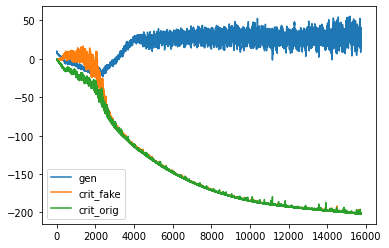

d loss fake  -201.552490234375
d loss real  -201.873779296875
[Epoch 46/100] [Batch 151/345] [D loss: -201.713135, acc:   0%] [G loss: 36.712710] [c1: 39.504017, c2: 38.598461, o: 57.187752, f: 25.550327] time: 10:11:45.903850
d loss fake  -201.7550811767578
d loss real  -201.86172485351562
[Epoch 46/100] [Batch 152/345] [D loss: -201.808403, acc:   0%] [G loss: 38.356832] [c1: 39.000938, c2: 39.070526, o: 71.372955, f: 36.946274] time: 10:11:48.195633
d loss fake  -201.67507934570312
d loss real  -201.48289489746094
[Epoch 46/100] [Batch 153/345] [D loss: -201.578987, acc:   0%] [G loss: 46.885072] [c1: 54.230946, c2: 54.205013, o: 72.944183, f: 38.661316] time: 10:11:50.469474
d loss fake  -201.72647094726562
d loss real  -201.85330200195312
[Epoch 46/100] [Batch 154/345] [D loss: -201.789886, acc:   0%] [G loss: 41.633482] [c1: 44.091896, c2: 43.685036, o: 87.777176, f: 54.630108] time: 10:11:52.752262
d loss fake  -201.48275756835938
d loss real  -201.78285217285156
[Epoch 46/100] 

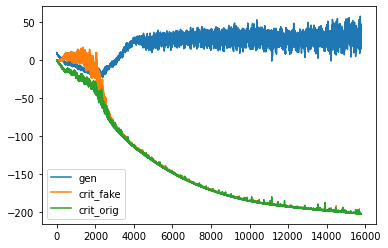

d loss fake  -201.91046142578125
d loss real  -201.99819946289062
[Epoch 46/100] [Batch 201/345] [D loss: -201.954330, acc:   0%] [G loss: 37.340134] [c1: 39.347946, c2: 39.358009, o: 81.254013, f: 45.659412] time: 10:13:40.735564
d loss fake  -201.92745971679688
d loss real  -202.0236053466797
[Epoch 46/100] [Batch 202/345] [D loss: -201.975533, acc:   0%] [G loss: 30.079279] [c1: 28.375664, c2: 27.674976, o: 72.780151, f: 38.418316] time: 10:13:43.017508
d loss fake  -201.82997131347656
d loss real  -201.39971923828125
[Epoch 46/100] [Batch 203/345] [D loss: -201.614845, acc:   0%] [G loss: 33.583596] [c1: 31.706203, c2: 31.388752, o: 62.248589, f: 26.468065] time: 10:13:45.300127
d loss fake  -201.67042541503906
d loss real  -201.951171875
[Epoch 46/100] [Batch 204/345] [D loss: -201.810799, acc:   0%] [G loss: 47.968710] [c1: 53.359215, c2: 53.001236, o: 72.519394, f: 34.600483] time: 10:13:47.589803
d loss fake  -201.86984252929688
d loss real  -201.90921020507812
[Epoch 46/100] [

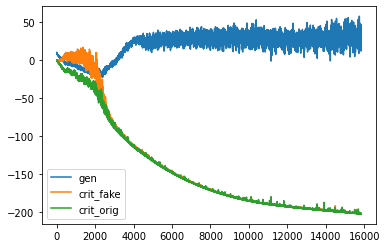

d loss fake  -201.39981079101562
d loss real  -201.23695373535156
[Epoch 46/100] [Batch 251/345] [D loss: -201.318382, acc:   0%] [G loss: 36.584713] [c1: 32.864487, c2: 33.631256, o: 78.600761, f: 39.470493] time: 10:15:36.799885
d loss fake  -201.85833740234375
d loss real  -201.28150939941406
[Epoch 46/100] [Batch 252/345] [D loss: -201.569923, acc:   0%] [G loss: 50.955876] [c1: 61.103127, c2: 61.260571, o: 75.555336, f: 39.022453] time: 10:15:39.103782
d loss fake  -201.84652709960938
d loss real  -202.03671264648438
[Epoch 46/100] [Batch 253/345] [D loss: -201.941620, acc:   0%] [G loss: 54.712273] [c1: 66.569229, c2: 66.659653, o: 97.168243, f: 59.032738] time: 10:15:41.388353
d loss fake  -201.80140686035156
d loss real  -202.08499145507812
[Epoch 46/100] [Batch 254/345] [D loss: -201.943199, acc:   0%] [G loss: 42.692183] [c1: 45.993572, c2: 46.188171, o: 101.394081, f: 66.847198] time: 10:15:43.690202
d loss fake  -202.01132202148438
d loss real  -202.13021850585938
[Epoch 46

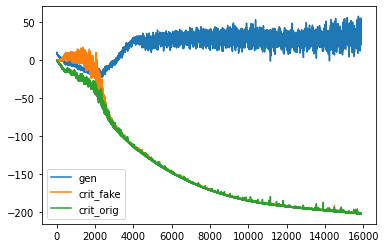

d loss fake  -202.12457275390625
d loss real  -202.24423217773438
[Epoch 46/100] [Batch 301/345] [D loss: -202.184402, acc:   0%] [G loss: 25.532822] [c1: 18.062922, c2: 18.184658, o: 44.776211, f: 10.502306] time: 10:17:32.685268
d loss fake  -201.4662322998047
d loss real  -202.22923278808594
[Epoch 46/100] [Batch 302/345] [D loss: -201.847733, acc:   0%] [G loss: 18.949067] [c1: 7.925536, c2: 7.192270, o: 54.255539, f: 16.687298] time: 10:17:34.980262
d loss fake  -201.67587280273438
d loss real  -200.9446563720703
[Epoch 46/100] [Batch 303/345] [D loss: -201.310265, acc:   0%] [G loss: 24.039789] [c1: 16.392330, c2: 16.577461, o: 42.384163, f: 6.835476] time: 10:17:37.264101
d loss fake  -202.05886840820312
d loss real  -202.16329956054688
[Epoch 46/100] [Batch 304/345] [D loss: -202.111084, acc:   0%] [G loss: 15.680035] [c1: 4.902449, c2: 4.748768, o: 53.886784, f: 16.223051] time: 10:17:39.560758
d loss fake  -201.73797607421875
d loss real  -202.21908569335938
[Epoch 46/100] [B

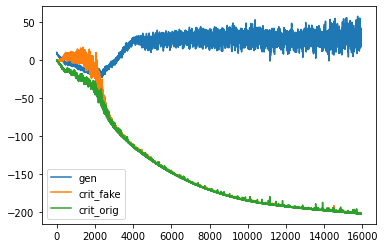

d loss fake  -201.4336700439453
d loss real  -202.228271484375
[Epoch 47/100] [Batch 1/345] [D loss: -201.830971, acc:   0%] [G loss: 16.489969] [c1: 3.380780, c2: 3.948823, o: 53.290459, f: 12.104530] time: 10:19:08.526004
d loss fake  -201.6760711669922
d loss real  -202.28060913085938
[Epoch 47/100] [Batch 2/345] [D loss: -201.978340, acc:   0%] [G loss: 13.824797] [c1: 1.887780, c2: 2.002225, o: 45.502148, f: 6.658536] time: 10:19:10.837930
d loss fake  -201.85670471191406
d loss real  -201.63412475585938
[Epoch 47/100] [Batch 3/345] [D loss: -201.745415, acc:   0%] [G loss: 21.828774] [c1: 11.801271, c2: 11.508452, o: 42.161987, f: 1.992064] time: 10:19:13.175348
d loss fake  -202.17791748046875
d loss real  -202.30982971191406
[Epoch 47/100] [Batch 4/345] [D loss: -202.243874, acc:   0%] [G loss: 21.326789] [c1: 13.376780, c2: 12.504325, o: 53.214485, f: 13.834863] time: 10:19:15.506125
d loss fake  -201.84329223632812
d loss real  -202.33697509765625
[Epoch 47/100] [Batch 5/345]

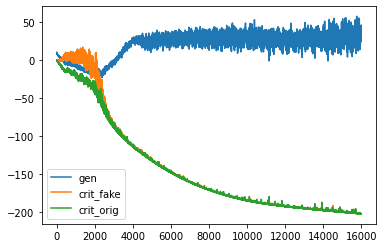

d loss fake  -202.31256103515625
d loss real  -202.296142578125
[Epoch 47/100] [Batch 51/345] [D loss: -202.304352, acc:   0%] [G loss: 35.660567] [c1: 34.582752, c2: 33.648121, o: 69.598404, f: 31.752970] time: 10:21:04.402549
d loss fake  -202.22305297851562
d loss real  -202.31643676757812
[Epoch 47/100] [Batch 52/345] [D loss: -202.269745, acc:   0%] [G loss: 34.184440] [c1: 29.176384, c2: 28.997345, o: 73.116951, f: 33.463341] time: 10:21:06.709259
d loss fake  -201.54188537597656
d loss real  -202.44268798828125
[Epoch 47/100] [Batch 53/345] [D loss: -201.992287, acc:   0%] [G loss: 21.922828] [c1: 7.891375, c2: 7.988741, o: 73.598366, f: 28.018936] time: 10:21:09.000424
d loss fake  -202.17930603027344
d loss real  -202.43838500976562
[Epoch 47/100] [Batch 54/345] [D loss: -202.308846, acc:   0%] [G loss: 20.168566] [c1: 9.270453, c2: 9.305002, o: 51.049507, f: 9.310489] time: 10:21:11.298943
d loss fake  -202.28585815429688
d loss real  -202.31451416015625
[Epoch 47/100] [Batch

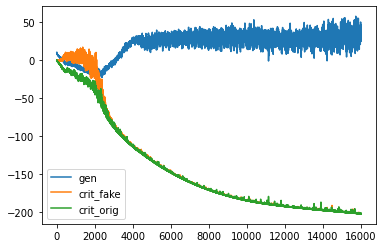

d loss fake  -202.45504760742188
d loss real  -202.4130401611328
[Epoch 47/100] [Batch 101/345] [D loss: -202.434044, acc:   0%] [G loss: 47.976625] [c1: 50.995117, c2: 51.343143, o: 85.243759, f: 45.185837] time: 10:23:01.375003
d loss fake  -202.38619995117188
d loss real  -202.38209533691406
[Epoch 47/100] [Batch 102/345] [D loss: -202.384148, acc:   0%] [G loss: 45.465751] [c1: 48.407990, c2: 47.523354, o: 93.748260, f: 50.493599] time: 10:23:03.671704
d loss fake  -202.4306640625
d loss real  -202.41537475585938
[Epoch 47/100] [Batch 103/345] [D loss: -202.423019, acc:   0%] [G loss: 42.206334] [c1: 44.859795, c2: 44.306129, o: 86.692245, f: 45.679031] time: 10:23:05.967460
d loss fake  -202.33462524414062
d loss real  -202.24563598632812
[Epoch 47/100] [Batch 104/345] [D loss: -202.290131, acc:   0%] [G loss: 42.626403] [c1: 42.202896, c2: 42.442204, o: 87.745590, f: 44.835529] time: 10:23:08.266275
d loss fake  -202.40789794921875
d loss real  -202.52996826171875
[Epoch 47/100] 

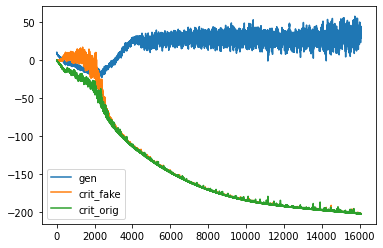

d loss fake  -202.3203125
d loss real  -202.62445068359375
[Epoch 47/100] [Batch 151/345] [D loss: -202.472382, acc:   0%] [G loss: 57.188211] [c1: 67.129143, c2: 67.186188, o: 83.714775, f: 45.922321] time: 10:24:57.989593
d loss fake  -202.4063720703125
d loss real  -202.69049072265625
[Epoch 47/100] [Batch 152/345] [D loss: -202.548431, acc:   0%] [G loss: 43.364088] [c1: 47.009197, c2: 46.871414, o: 99.536530, f: 66.728249] time: 10:25:00.295401
d loss fake  -202.58526611328125
d loss real  -202.58621215820312
[Epoch 47/100] [Batch 153/345] [D loss: -202.585739, acc:   0%] [G loss: 41.081166] [c1: 45.760704, c2: 45.782616, o: 84.494110, f: 49.003956] time: 10:25:02.588067
d loss fake  -202.4149169921875
d loss real  -202.52078247070312
[Epoch 47/100] [Batch 154/345] [D loss: -202.467850, acc:   0%] [G loss: 49.721203] [c1: 54.836479, c2: 55.088623, o: 81.116379, f: 42.267807] time: 10:25:04.893514
d loss fake  -202.56491088867188
d loss real  -202.57772827148438
[Epoch 47/100] [Bat

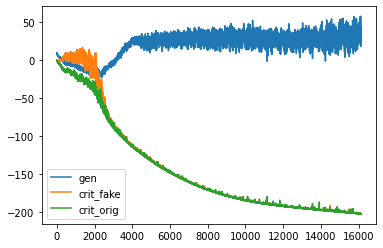

d loss fake  -202.65798950195312
d loss real  -202.80120849609375
[Epoch 47/100] [Batch 201/345] [D loss: -202.729599, acc:   0%] [G loss: 32.350367] [c1: 31.234440, c2: 30.963816, o: 67.862991, f: 32.240868] time: 10:26:53.923778
d loss fake  -202.67515563964844
d loss real  -202.71444702148438
[Epoch 47/100] [Batch 202/345] [D loss: -202.694801, acc:   0%] [G loss: 37.739389] [c1: 38.213318, c2: 38.601898, o: 66.826653, f: 31.273254] time: 10:26:56.224025
d loss fake  -202.65481567382812
d loss real  -202.8041229248047
[Epoch 47/100] [Batch 203/345] [D loss: -202.729469, acc:   0%] [G loss: 38.890083] [c1: 41.495010, c2: 41.670467, o: 74.538223, f: 37.954861] time: 10:26:58.519012
d loss fake  -202.6577911376953
d loss real  -202.80299377441406
[Epoch 47/100] [Batch 204/345] [D loss: -202.730392, acc:   0%] [G loss: 33.894692] [c1: 33.198036, c2: 33.394081, o: 77.587433, f: 43.950157] time: 10:27:00.819899
d loss fake  -202.72789001464844
d loss real  -202.77325439453125
[Epoch 47/10

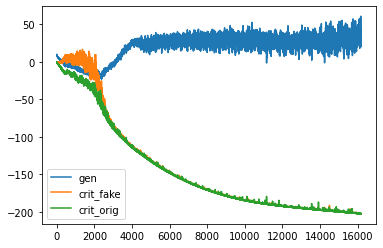

d loss fake  -202.20135498046875
d loss real  -202.83529663085938
[Epoch 47/100] [Batch 251/345] [D loss: -202.518326, acc:   0%] [G loss: 29.703784] [c1: 27.069384, c2: 27.822445, o: 74.475021, f: 40.216354] time: 10:28:50.604687
d loss fake  -202.77157592773438
d loss real  -202.91168212890625
[Epoch 47/100] [Batch 252/345] [D loss: -202.841629, acc:   0%] [G loss: 25.172332] [c1: 22.029083, c2: 22.021912, o: 63.714813, f: 26.642365] time: 10:28:52.913616
d loss fake  -202.6836700439453
d loss real  -202.89378356933594
[Epoch 47/100] [Batch 253/345] [D loss: -202.788727, acc:   0%] [G loss: 24.359183] [c1: 18.447565, c2: 17.621559, o: 59.271217, f: 21.447601] time: 10:28:55.201629
d loss fake  -202.8106689453125
d loss real  -202.91561889648438
[Epoch 47/100] [Batch 254/345] [D loss: -202.863144, acc:   0%] [G loss: 23.968654] [c1: 19.214487, c2: 19.172657, o: 53.262367, f: 20.697222] time: 10:28:57.499649
d loss fake  -202.763427734375
d loss real  -202.9280548095703
[Epoch 47/100] 

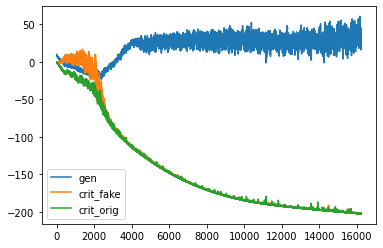

d loss fake  -202.80242919921875
d loss real  -202.99673461914062
[Epoch 47/100] [Batch 301/345] [D loss: -202.899582, acc:   0%] [G loss: 29.831281] [c1: 25.384312, c2: 25.514812, o: 65.683525, f: 30.628098] time: 10:30:47.367167
d loss fake  -202.70367431640625
d loss real  -201.34011840820312
[Epoch 47/100] [Batch 302/345] [D loss: -202.021896, acc:   0%] [G loss: 33.876649] [c1: 29.756256, c2: 30.051777, o: 60.792030, f: 24.448200] time: 10:30:49.663542
d loss fake  -202.62420654296875
d loss real  -202.95220947265625
[Epoch 47/100] [Batch 303/345] [D loss: -202.788208, acc:   0%] [G loss: 28.690585] [c1: 20.062588, c2: 21.317644, o: 69.342316, f: 32.850349] time: 10:30:51.953959
d loss fake  -202.87388610839844
d loss real  -202.96502685546875
[Epoch 47/100] [Batch 304/345] [D loss: -202.919456, acc:   0%] [G loss: 21.736053] [c1: 14.528606, c2: 14.525455, o: 54.544193, f: 21.655800] time: 10:30:54.254479
d loss fake  -202.82171630859375
d loss real  -202.15245056152344
[Epoch 47/

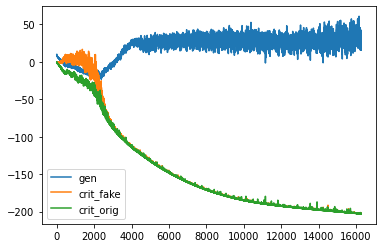

d loss fake  -202.58514404296875
d loss real  -203.02711486816406
[Epoch 48/100] [Batch 1/345] [D loss: -202.806129, acc:   0%] [G loss: 16.307433] [c1: 3.017146, c2: 2.509982, o: 56.645527, f: 15.412369] time: 10:32:23.256152
d loss fake  -202.07716369628906
d loss real  -203.06126403808594
[Epoch 48/100] [Batch 2/345] [D loss: -202.569214, acc:   0%] [G loss: 8.016913] [c1: -9.584394, c2: -9.579843, o: 42.275749, f: 2.278812] time: 10:32:25.570992
d loss fake  -202.80075073242188
d loss real  -202.97279357910156
[Epoch 48/100] [Batch 3/345] [D loss: -202.886772, acc:   0%] [G loss: 14.379923] [c1: 0.380766, c2: 0.193418, o: 32.343990, f: -10.126402] time: 10:32:27.928478
d loss fake  -202.76455688476562
d loss real  -203.07504272460938
[Epoch 48/100] [Batch 4/345] [D loss: -202.919800, acc:   0%] [G loss: 14.397867] [c1: -2.359262, c2: -2.613675, o: 44.387558, f: 0.638780] time: 10:32:30.267093
d loss fake  -202.57611083984375
d loss real  -203.0460662841797
[Epoch 48/100] [Batch 5/3

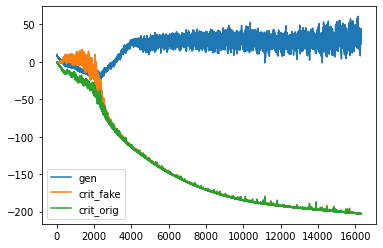

d loss fake  -203.02357482910156
d loss real  -202.74525451660156
[Epoch 48/100] [Batch 51/345] [D loss: -202.884415, acc:   0%] [G loss: 37.590993] [c1: 33.781883, c2: 33.662144, o: 52.852852, f: 13.349163] time: 10:34:19.272516
d loss fake  -203.082275390625
d loss real  -203.2025146484375
[Epoch 48/100] [Batch 52/345] [D loss: -203.142395, acc:   0%] [G loss: 33.845440] [c1: 30.498171, c2: 30.050415, o: 76.496895, f: 36.263153] time: 10:34:21.555576
d loss fake  -203.06155395507812
d loss real  -203.19461059570312
[Epoch 48/100] [Batch 53/345] [D loss: -203.128082, acc:   0%] [G loss: 32.277148] [c1: 29.115982, c2: 28.956802, o: 69.119797, f: 29.586821] time: 10:34:23.851900
d loss fake  -203.07156372070312
d loss real  -203.10107421875
[Epoch 48/100] [Batch 54/345] [D loss: -203.086319, acc:   0%] [G loss: 34.209680] [c1: 29.585073, c2: 29.503454, o: 71.411140, f: 29.246658] time: 10:34:26.137060
d loss fake  -203.00433349609375
d loss real  -203.11656188964844
[Epoch 48/100] [Batc

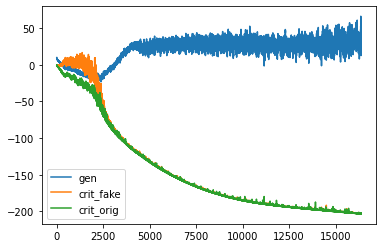

d loss fake  -203.06951904296875
d loss real  -202.87164306640625
[Epoch 48/100] [Batch 101/345] [D loss: -202.970581, acc:   0%] [G loss: 25.937938] [c1: 17.666616, c2: 16.338848, o: 50.027939, f: 6.493755] time: 10:36:15.939554
d loss fake  -203.0225830078125
d loss real  -202.74765014648438
[Epoch 48/100] [Batch 102/345] [D loss: -202.885117, acc:   0%] [G loss: 35.743376] [c1: 36.712761, c2: 35.574669, o: 62.242039, f: 22.147896] time: 10:36:18.247447
d loss fake  -203.14645385742188
d loss real  -203.24594116210938
[Epoch 48/100] [Batch 103/345] [D loss: -203.196198, acc:   0%] [G loss: 39.650630] [c1: 39.492508, c2: 39.238945, o: 77.402977, f: 35.954803] time: 10:36:20.550435
d loss fake  -202.4475860595703
d loss real  -203.30972290039062
[Epoch 48/100] [Batch 104/345] [D loss: -202.878654, acc:   0%] [G loss: 27.121911] [c1: 17.158585, c2: 17.778072, o: 78.607437, f: 35.325813] time: 10:36:22.865685
d loss fake  -202.86231994628906
d loss real  -203.28170776367188
[Epoch 48/100

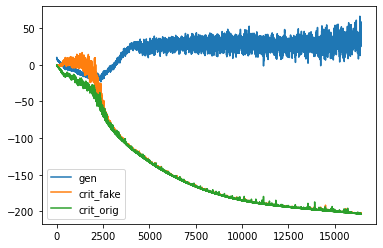

d loss fake  -203.2615509033203
d loss real  -203.4099578857422
[Epoch 48/100] [Batch 151/345] [D loss: -203.335754, acc:   0%] [G loss: 28.528777] [c1: 23.253849, c2: 23.775677, o: 57.631367, f: 17.923946] time: 10:38:13.027691
d loss fake  -203.2261962890625
d loss real  -203.0345458984375
[Epoch 48/100] [Batch 152/345] [D loss: -203.130371, acc:   0%] [G loss: 38.613856] [c1: 40.174301, c2: 39.871090, o: 63.789986, f: 26.919632] time: 10:38:15.341773
d loss fake  -203.24330139160156
d loss real  -203.38623046875
[Epoch 48/100] [Batch 153/345] [D loss: -203.314766, acc:   0%] [G loss: 27.991089] [c1: 19.549496, c2: 19.322807, o: 79.613853, f: 39.307137] time: 10:38:17.626229
d loss fake  -203.14404296875
d loss real  -203.297119140625
[Epoch 48/100] [Batch 154/345] [D loss: -203.220581, acc:   0%] [G loss: 45.721794] [c1: 48.960911, c2: 49.312725, o: 57.877659, f: 22.716801] time: 10:38:19.930682
d loss fake  -203.26763916015625
d loss real  -203.40850830078125
[Epoch 48/100] [Batch 

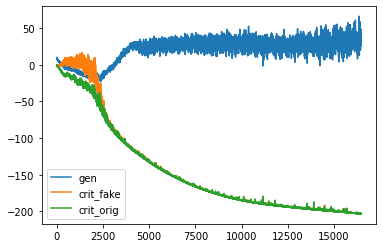

d loss fake  -203.39865112304688
d loss real  -203.3747100830078
[Epoch 48/100] [Batch 201/345] [D loss: -203.386681, acc:   0%] [G loss: 37.074542] [c1: 30.509636, c2: 30.279610, o: 71.310654, f: 29.036695] time: 10:40:08.721452
d loss fake  -203.43893432617188
d loss real  -203.54006958007812
[Epoch 48/100] [Batch 202/345] [D loss: -203.489502, acc:   0%] [G loss: 28.790905] [c1: 23.125959, c2: 22.923559, o: 73.401688, f: 33.765583] time: 10:40:11.015788
d loss fake  -202.99276733398438
d loss real  -203.44725036621094
[Epoch 48/100] [Batch 203/345] [D loss: -203.220009, acc:   0%] [G loss: 24.919326] [c1: 13.898970, c2: 14.447363, o: 58.628830, f: 21.500408] time: 10:40:13.303578
d loss fake  -203.41653442382812
d loss real  -203.49395751953125
[Epoch 48/100] [Batch 204/345] [D loss: -203.455246, acc:   0%] [G loss: 23.559921] [c1: 13.938273, c2: 13.960263, o: 54.701248, f: 13.553978] time: 10:40:15.606199
d loss fake  -203.40524291992188
d loss real  -202.70094299316406
[Epoch 48/1

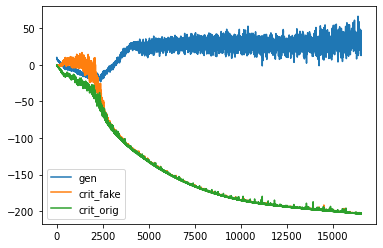

d loss fake  -203.44723510742188
d loss real  -203.61715698242188
[Epoch 48/100] [Batch 251/345] [D loss: -203.532196, acc:   0%] [G loss: 21.373578] [c1: 13.812130, c2: 13.128345, o: 47.259914, f: 14.530123] time: 10:42:05.635893
d loss fake  -202.47567749023438
d loss real  -203.30030822753906
[Epoch 48/100] [Batch 252/345] [D loss: -202.887993, acc:   0%] [G loss: 20.492225] [c1: 6.469969, c2: 6.447349, o: 46.567291, f: 8.817340] time: 10:42:07.929744
d loss fake  -203.30593872070312
d loss real  -203.3369140625
[Epoch 48/100] [Batch 253/345] [D loss: -203.321426, acc:   0%] [G loss: 26.922023] [c1: 17.720881, c2: 17.292400, o: 45.519268, f: 6.760271] time: 10:42:10.225283
d loss fake  -203.0850372314453
d loss real  -203.36888122558594
[Epoch 48/100] [Batch 254/345] [D loss: -203.226959, acc:   0%] [G loss: 28.075886] [c1: 18.382465, c2: 18.786837, o: 61.637871, f: 18.253654] time: 10:42:12.522563
d loss fake  -203.48779296875
d loss real  -203.58277893066406
[Epoch 48/100] [Batch 

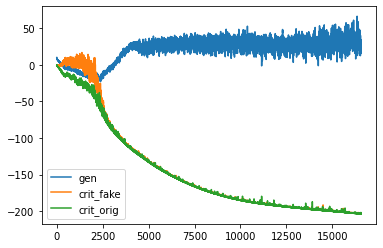

d loss fake  -203.55474853515625
d loss real  -203.07110595703125
[Epoch 48/100] [Batch 301/345] [D loss: -203.312927, acc:   0%] [G loss: 28.084255] [c1: 18.273129, c2: 18.314150, o: 39.943726, f: -1.486881] time: 10:44:02.179798
d loss fake  -203.5567626953125
d loss real  -203.65902709960938
[Epoch 48/100] [Batch 302/345] [D loss: -203.607895, acc:   0%] [G loss: 32.487765] [c1: 25.321148, c2: 24.501692, o: 59.217392, f: 20.216221] time: 10:44:04.472417
d loss fake  -203.5794677734375
d loss real  -203.6927032470703
[Epoch 48/100] [Batch 303/345] [D loss: -203.636086, acc:   0%] [G loss: 33.565288] [c1: 27.407909, c2: 25.540867, o: 63.894165, f: 27.462101] time: 10:44:06.769299
d loss fake  -202.66229248046875
d loss real  -203.6698455810547
[Epoch 48/100] [Batch 304/345] [D loss: -203.166069, acc:   0%] [G loss: 21.380632] [c1: 8.621360, c2: 8.060951, o: 62.326485, f: 24.192068] time: 10:44:09.069831
d loss fake  -202.0034942626953
d loss real  -203.11886596679688
[Epoch 48/100] [B

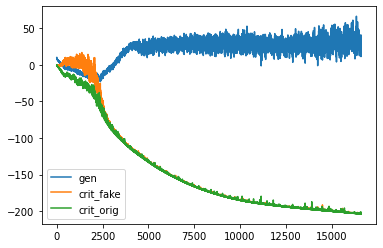

d loss fake  -203.08181762695312
d loss real  -203.6143798828125
[Epoch 49/100] [Batch 1/345] [D loss: -203.348099, acc:   0%] [G loss: 18.529947] [c1: 0.981601, c2: 1.278939, o: 46.769367, f: 3.316385] time: 10:45:39.412712
d loss fake  -203.57997131347656
d loss real  -203.74520874023438
[Epoch 49/100] [Batch 2/345] [D loss: -203.662590, acc:   0%] [G loss: 16.956930] [c1: 2.370326, c2: 0.787092, o: 42.894066, f: 5.244003] time: 10:45:41.784509
d loss fake  -203.60984802246094
d loss real  -203.76260375976562
[Epoch 49/100] [Batch 3/345] [D loss: -203.686226, acc:   0%] [G loss: 22.949267] [c1: 7.797670, c2: 6.928497, o: 39.310452, f: -2.464769] time: 10:45:44.136652
d loss fake  -203.1063690185547
d loss real  -203.7605438232422
[Epoch 49/100] [Batch 4/345] [D loss: -203.433456, acc:   0%] [G loss: 16.754838] [c1: -0.527643, c2: 0.011765, o: 50.967171, f: 8.483589] time: 10:45:46.456396
d loss fake  -203.48342895507812
d loss real  -203.72572326660156
[Epoch 49/100] [Batch 5/345] [D

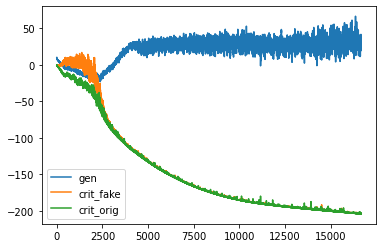

d loss fake  -203.68951416015625
d loss real  -203.83621215820312
[Epoch 49/100] [Batch 51/345] [D loss: -203.762863, acc:   0%] [G loss: 23.902005] [c1: 12.122918, c2: 11.214891, o: 62.423256, f: 14.955189] time: 10:47:35.234079
d loss fake  -203.67648315429688
d loss real  -202.55007934570312
[Epoch 49/100] [Batch 52/345] [D loss: -203.113281, acc:   0%] [G loss: 38.513695] [c1: 29.098354, c2: 29.323563, o: 52.463238, f: 8.327544] time: 10:47:37.531875
d loss fake  -203.61962890625
d loss real  -203.7560577392578
[Epoch 49/100] [Batch 53/345] [D loss: -203.687843, acc:   0%] [G loss: 37.673754] [c1: 28.654823, c2: 28.541115, o: 82.846031, f: 31.866962] time: 10:47:39.827016
d loss fake  -202.98045349121094
d loss real  -203.603515625
[Epoch 49/100] [Batch 54/345] [D loss: -203.291985, acc:   0%] [G loss: 28.489812] [c1: 16.604519, c2: 16.109840, o: 75.322372, f: 30.670240] time: 10:47:42.129075
d loss fake  -203.66464233398438
d loss real  -203.86134338378906
[Epoch 49/100] [Batch 55

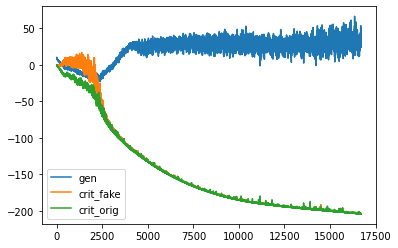

d loss fake  -203.73309326171875
d loss real  -203.96034240722656
[Epoch 49/100] [Batch 101/345] [D loss: -203.846718, acc:   0%] [G loss: 30.495523] [c1: 21.087040, c2: 21.141506, o: 71.314095, f: 25.242357] time: 10:49:32.191912
d loss fake  -203.4661865234375
d loss real  -203.72650146484375
[Epoch 49/100] [Batch 102/345] [D loss: -203.596344, acc:   0%] [G loss: 28.349175] [c1: 16.595341, c2: 16.520220, o: 61.660362, f: 19.248669] time: 10:49:34.488263
d loss fake  -203.86473083496094
d loss real  -204.00888061523438
[Epoch 49/100] [Batch 103/345] [D loss: -203.936806, acc:   0%] [G loss: 28.843237] [c1: 20.094673, c2: 19.807411, o: 65.265244, f: 20.495722] time: 10:49:36.778547
d loss fake  -203.91754150390625
d loss real  -203.96914672851562
[Epoch 49/100] [Batch 104/345] [D loss: -203.943344, acc:   0%] [G loss: 32.833195] [c1: 30.060938, c2: 29.329025, o: 61.699921, f: 18.646870] time: 10:49:39.073465
d loss fake  -203.82899475097656
d loss real  -204.01185607910156
[Epoch 49/1

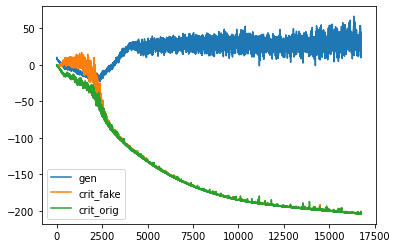

d loss fake  -203.95901489257812
d loss real  -204.10797119140625
[Epoch 49/100] [Batch 151/345] [D loss: -204.033493, acc:   0%] [G loss: 28.575396] [c1: 23.191330, c2: 22.946487, o: 64.185043, f: 26.766508] time: 10:51:28.593290
d loss fake  -203.9872283935547
d loss real  -203.98446655273438
[Epoch 49/100] [Batch 152/345] [D loss: -203.985847, acc:   0%] [G loss: 36.192972] [c1: 32.830116, c2: 32.006664, o: 58.284866, f: 20.993748] time: 10:51:30.898811
d loss fake  -203.98672485351562
d loss real  -204.11508178710938
[Epoch 49/100] [Batch 153/345] [D loss: -204.050903, acc:   0%] [G loss: 40.607294] [c1: 40.218048, c2: 39.860954, o: 74.005287, f: 35.192924] time: 10:51:33.186081
d loss fake  -203.97933959960938
d loss real  -204.0112762451172
[Epoch 49/100] [Batch 154/345] [D loss: -203.995308, acc:   0%] [G loss: 41.226229] [c1: 38.041996, c2: 38.117725, o: 77.289131, f: 37.270782] time: 10:51:35.486975
d loss fake  -204.05287170410156
d loss real  -204.1581573486328
[Epoch 49/100

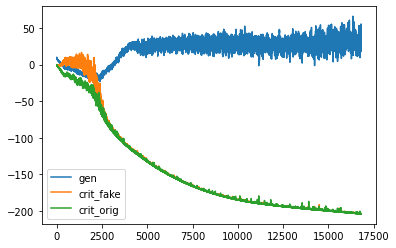

d loss fake  -204.05349731445312
d loss real  -203.96871948242188
[Epoch 49/100] [Batch 201/345] [D loss: -204.011108, acc:   0%] [G loss: 45.097135] [c1: 48.775543, c2: 48.547615, o: 68.032234, f: 31.663746] time: 10:53:24.410028
d loss fake  -203.92172241210938
d loss real  -204.18235778808594
[Epoch 49/100] [Batch 202/345] [D loss: -204.052040, acc:   0%] [G loss: 30.105240] [c1: 23.925735, c2: 24.265728, o: 85.285263, f: 47.064468] time: 10:53:26.715286
d loss fake  -204.09185791015625
d loss real  -204.2376708984375
[Epoch 49/100] [Batch 203/345] [D loss: -204.164764, acc:   0%] [G loss: 28.511085] [c1: 25.482334, c2: 25.474401, o: 58.558060, f: 26.059250] time: 10:53:29.009821
d loss fake  -204.13693237304688
d loss real  -203.90818786621094
[Epoch 49/100] [Batch 204/345] [D loss: -204.022560, acc:   0%] [G loss: 35.010755] [c1: 33.434807, c2: 33.492802, o: 57.053871, f: 24.862686] time: 10:53:31.304171
d loss fake  -204.09136962890625
d loss real  -204.233642578125
[Epoch 49/100

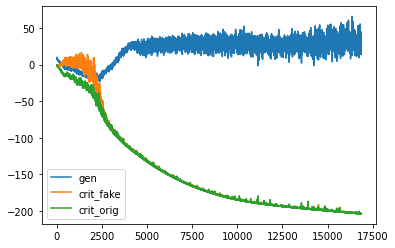

d loss fake  -204.12257385253906
d loss real  -204.1941680908203
[Epoch 49/100] [Batch 251/345] [D loss: -204.158371, acc:   0%] [G loss: 48.438918] [c1: 52.265514, c2: 52.154408, o: 76.490860, f: 37.978836] time: 10:55:21.026094
d loss fake  -204.08436584472656
d loss real  -203.5006103515625
[Epoch 49/100] [Batch 252/345] [D loss: -203.792488, acc:   0%] [G loss: 46.897073] [c1: 46.617523, c2: 46.652042, o: 90.790878, f: 50.493011] time: 10:55:23.324378
d loss fake  -204.17388916015625
d loss real  -204.09573364257812
[Epoch 49/100] [Batch 253/345] [D loss: -204.134811, acc:   0%] [G loss: 49.756127] [c1: 52.457123, c2: 52.997963, o: 91.518974, f: 49.294159] time: 10:55:25.608885
d loss fake  -204.174560546875
d loss real  -204.3401336669922
[Epoch 49/100] [Batch 254/345] [D loss: -204.257347, acc:   0%] [G loss: 38.214395] [c1: 32.437180, c2: 32.805954, o: 95.008461, f: 49.460938] time: 10:55:27.908626
d loss fake  -204.1990203857422
d loss real  -204.34078979492188
[Epoch 49/100] [

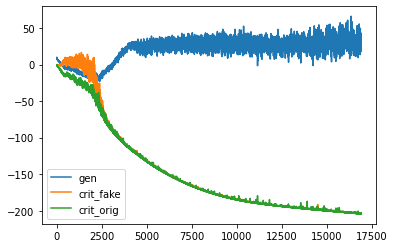

d loss fake  -204.30593872070312
d loss real  -204.35226440429688
[Epoch 49/100] [Batch 301/345] [D loss: -204.329102, acc:   0%] [G loss: 23.158811] [c1: 12.946168, c2: 12.619629, o: 51.576958, f: 12.404207] time: 10:57:17.719828
d loss fake  -204.29434204101562
d loss real  -204.46092224121094
[Epoch 49/100] [Batch 302/345] [D loss: -204.377632, acc:   0%] [G loss: 25.013462] [c1: 12.829841, c2: 12.854746, o: 49.947845, f: 10.546627] time: 10:57:20.024678
d loss fake  -204.20248413085938
d loss real  -204.28744506835938
[Epoch 49/100] [Batch 303/345] [D loss: -204.244965, acc:   0%] [G loss: 25.280506] [c1: 18.127110, c2: 17.772282, o: 49.553989, f: 15.840982] time: 10:57:22.307456
d loss fake  -203.53811645507812
d loss real  -204.1455078125
[Epoch 49/100] [Batch 304/345] [D loss: -203.841812, acc:   0%] [G loss: 23.546315] [c1: 11.314280, c2: 11.300071, o: 56.763664, f: 15.486369] time: 10:57:24.604726
d loss fake  -204.32354736328125
d loss real  -204.43141174316406
[Epoch 49/100]

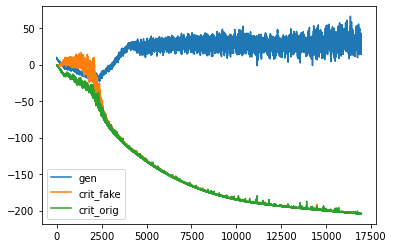

d loss fake  -203.4025115966797
d loss real  -204.21023559570312
[Epoch 50/100] [Batch 1/345] [D loss: -203.806374, acc:   0%] [G loss: 14.179977] [c1: -5.103763, c2: -4.208577, o: 40.260571, f: -1.978004] time: 10:58:53.397662
d loss fake  -204.319091796875
d loss real  -204.4900360107422
[Epoch 50/100] [Batch 2/345] [D loss: -204.404564, acc:   0%] [G loss: 16.986023] [c1: 3.548386, c2: 3.508183, o: 39.404819, f: 0.509020] time: 10:58:55.701400
d loss fake  -203.5777587890625
d loss real  -204.46694946289062
[Epoch 50/100] [Batch 3/345] [D loss: -204.022354, acc:   0%] [G loss: 13.101546] [c1: -6.070536, c2: -6.583609, o: 42.918831, f: -0.329095] time: 10:58:58.052882
d loss fake  -204.32745361328125
d loss real  -204.45382690429688
[Epoch 50/100] [Batch 4/345] [D loss: -204.390640, acc:   0%] [G loss: 19.113488] [c1: 4.712372, c2: 3.647034, o: 37.950378, f: -4.322254] time: 10:59:00.380284
d loss fake  -203.60360717773438
d loss real  -204.32814025878906
[Epoch 50/100] [Batch 5/345]

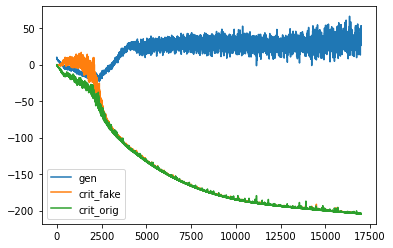

d loss fake  -204.45184326171875
d loss real  -204.66342163085938
[Epoch 50/100] [Batch 51/345] [D loss: -204.557632, acc:   0%] [G loss: 45.426613] [c1: 47.365501, c2: 46.757759, o: 97.673203, f: 55.859680] time: 11:00:49.172391
d loss fake  -204.47439575195312
d loss real  -204.5693359375
[Epoch 50/100] [Batch 52/345] [D loss: -204.521866, acc:   0%] [G loss: 41.368986] [c1: 41.010460, c2: 40.427818, o: 88.124565, f: 47.513958] time: 11:00:51.465234
d loss fake  -204.52427673339844
d loss real  -204.64773559570312
[Epoch 50/100] [Batch 53/345] [D loss: -204.586006, acc:   0%] [G loss: 39.480984] [c1: 33.779755, c2: 33.904194, o: 79.850563, f: 37.097069] time: 11:00:53.760169
d loss fake  -204.5286407470703
d loss real  -204.5859832763672
[Epoch 50/100] [Batch 54/345] [D loss: -204.557312, acc:   0%] [G loss: 40.574943] [c1: 37.683540, c2: 37.621895, o: 76.078064, f: 34.725006] time: 11:00:56.045948
d loss fake  -204.47377014160156
d loss real  -204.6475830078125
[Epoch 50/100] [Batch

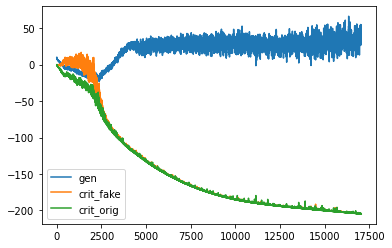

d loss fake  -204.57217407226562
d loss real  -204.47372436523438
[Epoch 50/100] [Batch 101/345] [D loss: -204.522949, acc:   0%] [G loss: 43.379037] [c1: 39.840378, c2: 40.487633, o: 88.225281, f: 42.738014] time: 11:02:45.761774
d loss fake  -204.4752197265625
d loss real  -204.68853759765625
[Epoch 50/100] [Batch 102/345] [D loss: -204.581879, acc:   0%] [G loss: 33.753150] [c1: 27.156898, c2: 27.386885, o: 87.252121, f: 42.275982] time: 11:02:48.061360
d loss fake  -204.59866333007812
d loss real  -204.68014526367188
[Epoch 50/100] [Batch 103/345] [D loss: -204.639404, acc:   0%] [G loss: 39.663498] [c1: 34.332779, c2: 34.176682, o: 72.627991, f: 24.304691] time: 11:02:50.348931
d loss fake  -204.64791870117188
d loss real  -204.68597412109375
[Epoch 50/100] [Batch 104/345] [D loss: -204.666946, acc:   0%] [G loss: 34.903847] [c1: 26.961281, c2: 26.685307, o: 87.238472, f: 39.597000] time: 11:02:52.650596
d loss fake  -204.6456298828125
d loss real  -204.71646118164062
[Epoch 50/10

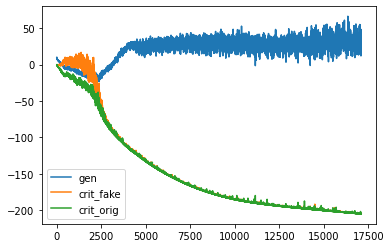

d loss fake  -204.6387939453125
d loss real  -204.82632446289062
[Epoch 50/100] [Batch 151/345] [D loss: -204.732559, acc:   0%] [G loss: 35.011698] [c1: 30.281860, c2: 30.705069, o: 79.451088, f: 34.617058] time: 11:04:42.559739
d loss fake  -204.67391967773438
d loss real  -204.7882080078125
[Epoch 50/100] [Batch 152/345] [D loss: -204.731064, acc:   0%] [G loss: 30.653119] [c1: 22.706877, c2: 22.577877, o: 68.416718, f: 31.591928] time: 11:04:44.859178
d loss fake  -204.61135864257812
d loss real  -204.57553100585938
[Epoch 50/100] [Batch 153/345] [D loss: -204.593445, acc:   0%] [G loss: 29.085217] [c1: 21.112589, c2: 21.726379, o: 60.287712, f: 23.230213] time: 11:04:47.148541
d loss fake  -204.6719970703125
d loss real  -204.84918212890625
[Epoch 50/100] [Batch 154/345] [D loss: -204.760590, acc:   0%] [G loss: 32.455785] [c1: 28.744389, c2: 28.092010, o: 61.326515, f: 22.301273] time: 11:04:49.446611
d loss fake  -204.6576385498047
d loss real  -204.8092041015625
[Epoch 50/100] 

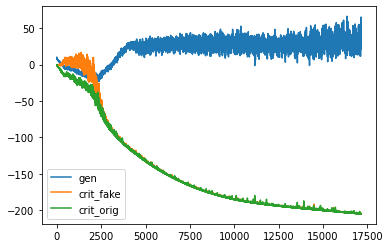

d loss fake  -204.81309509277344
d loss real  -204.93101501464844
[Epoch 50/100] [Batch 201/345] [D loss: -204.872055, acc:   0%] [G loss: 30.690992] [c1: 26.529280, c2: 26.067774, o: 66.036179, f: 27.465485] time: 11:06:38.140874
d loss fake  -204.78082275390625
d loss real  -204.9234619140625
[Epoch 50/100] [Batch 202/345] [D loss: -204.852142, acc:   0%] [G loss: 27.371691] [c1: 19.742558, c2: 19.702946, o: 61.632370, f: 27.291286] time: 11:06:40.441866
d loss fake  -204.767578125
d loss real  -204.9148406982422
[Epoch 50/100] [Batch 203/345] [D loss: -204.841209, acc:   0%] [G loss: 22.949711] [c1: 13.120814, c2: 13.577806, o: 53.784637, f: 16.813993] time: 11:06:42.754415
d loss fake  -204.7029266357422
d loss real  -204.93508911132812
[Epoch 50/100] [Batch 204/345] [D loss: -204.819008, acc:   0%] [G loss: 39.557153] [c1: 41.001812, c2: 41.002941, o: 51.396500, f: 19.875404] time: 11:06:45.048420
d loss fake  -204.65380859375
d loss real  -204.93978881835938
[Epoch 50/100] [Batch

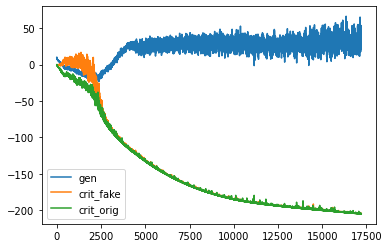

d loss fake  -204.63404846191406
d loss real  -204.7261199951172
[Epoch 50/100] [Batch 251/345] [D loss: -204.680084, acc:   0%] [G loss: 29.592955] [c1: 20.079750, c2: 19.688999, o: 58.103439, f: 15.940285] time: 11:08:35.049525
d loss fake  -204.78814697265625
d loss real  -204.70587158203125
[Epoch 50/100] [Batch 252/345] [D loss: -204.747009, acc:   0%] [G loss: 31.029978] [c1: 22.223598, c2: 22.198860, o: 63.383980, f: 19.661526] time: 11:08:37.353040
d loss fake  -204.8966064453125
d loss real  -205.08172607421875
[Epoch 50/100] [Batch 253/345] [D loss: -204.989166, acc:   0%] [G loss: 30.584101] [c1: 25.326645, c2: 24.689083, o: 64.615585, f: 26.166016] time: 11:08:39.639718
d loss fake  -204.734375
d loss real  -204.95065307617188
[Epoch 50/100] [Batch 254/345] [D loss: -204.842514, acc:   0%] [G loss: 28.921332] [c1: 19.608019, c2: 19.879503, o: 61.711674, f: 21.671816] time: 11:08:41.949784
d loss fake  -204.8264617919922
d loss real  -205.00978088378906
[Epoch 50/100] [Batch

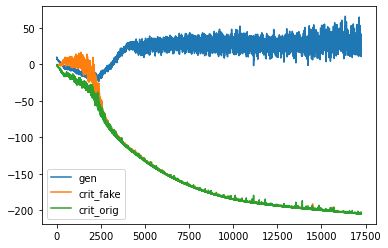

d loss fake  -204.423828125
d loss real  -204.94891357421875
[Epoch 50/100] [Batch 301/345] [D loss: -204.686371, acc:   0%] [G loss: 22.555321] [c1: 10.982038, c2: 10.547746, o: 48.495060, f: 14.173745] time: 11:10:31.556809
d loss fake  -204.45281982421875
d loss real  -205.07774353027344
[Epoch 50/100] [Batch 302/345] [D loss: -204.765282, acc:   0%] [G loss: 19.959353] [c1: 4.499636, c2: 4.885906, o: 49.908794, f: 9.149977] time: 11:10:33.840157
d loss fake  -204.9451446533203
d loss real  -204.82528686523438
[Epoch 50/100] [Batch 303/345] [D loss: -204.885216, acc:   0%] [G loss: 31.754058] [c1: 25.220570, c2: 24.278414, o: 47.526764, f: 6.485290] time: 11:10:36.125630
d loss fake  -204.8288116455078
d loss real  -204.9642333984375
[Epoch 50/100] [Batch 304/345] [D loss: -204.896523, acc:   0%] [G loss: 30.096080] [c1: 22.374683, c2: 22.287754, o: 66.711349, f: 24.773701] time: 11:10:38.418803
d loss fake  -205.02786254882812
d loss real  -205.06979370117188
[Epoch 50/100] [Batch 

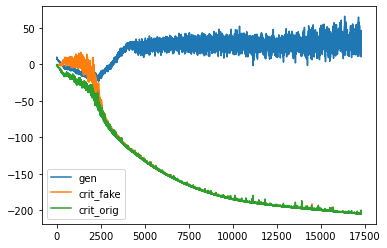

d loss fake  -203.05628967285156
d loss real  -205.13345336914062
[Epoch 51/100] [Batch 1/345] [D loss: -204.094872, acc:   0%] [G loss: 8.198014] [c1: -12.793826, c2: -12.550679, o: 36.300545, f: -0.592571] time: 11:12:08.569643
d loss fake  -204.91798400878906
d loss real  -204.96780395507812
[Epoch 51/100] [Batch 2/345] [D loss: -204.942894, acc:   0%] [G loss: 15.427237] [c1: -2.475342, c2: -2.913791, o: 30.003761, f: -14.320480] time: 11:12:10.895637
d loss fake  -204.80267333984375
d loss real  -205.006103515625
[Epoch 51/100] [Batch 3/345] [D loss: -204.904388, acc:   0%] [G loss: 17.667364] [c1: 1.338338, c2: 0.138285, o: 40.726738, f: -1.076818] time: 11:12:13.227945
d loss fake  -205.0157928466797
d loss real  -205.08609008789062
[Epoch 51/100] [Batch 4/345] [D loss: -205.050941, acc:   0%] [G loss: 26.413825] [c1: 13.935959, c2: 13.367820, o: 46.777367, f: 1.755786] time: 11:12:15.537946
d loss fake  -204.97671508789062
d loss real  -205.151611328125
[Epoch 51/100] [Batch 5/

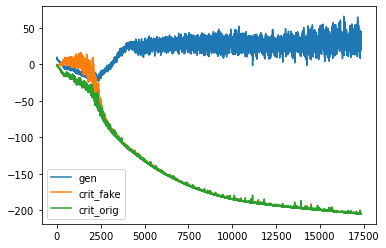

d loss fake  -205.10818481445312
d loss real  -205.26673889160156
[Epoch 51/100] [Batch 51/345] [D loss: -205.187462, acc:   0%] [G loss: 35.810036] [c1: 27.550871, c2: 26.671974, o: 64.094376, f: 23.769939] time: 11:14:04.337978
d loss fake  -205.15525817871094
d loss real  -205.28366088867188
[Epoch 51/100] [Batch 52/345] [D loss: -205.219460, acc:   0%] [G loss: 31.386192] [c1: 22.013599, c2: 21.909557, o: 67.078339, f: 26.760954] time: 11:14:06.636185
d loss fake  -204.87930297851562
d loss real  -205.1356964111328
[Epoch 51/100] [Batch 53/345] [D loss: -205.007500, acc:   0%] [G loss: 30.018370] [c1: 17.132252, c2: 17.308800, o: 66.508743, f: 20.798058] time: 11:14:08.921397
d loss fake  -205.1769256591797
d loss real  -205.30889892578125
[Epoch 51/100] [Batch 54/345] [D loss: -205.242912, acc:   0%] [G loss: 28.578232] [c1: 17.564323, c2: 17.425476, o: 64.949593, f: 20.952181] time: 11:14:11.215397
d loss fake  -205.11737060546875
d loss real  -205.0855255126953
[Epoch 51/100] [B

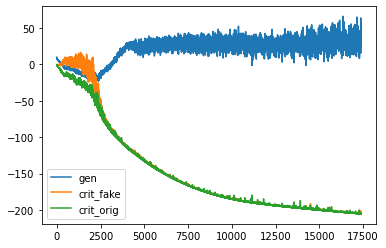

d loss fake  -205.27618408203125
d loss real  -205.3487091064453
[Epoch 51/100] [Batch 101/345] [D loss: -205.312447, acc:   0%] [G loss: 25.735133] [c1: 15.697094, c2: 15.363502, o: 39.935974, f: -1.822402] time: 11:16:01.227055
d loss fake  -205.2676239013672
d loss real  -205.38002014160156
[Epoch 51/100] [Batch 102/345] [D loss: -205.323822, acc:   0%] [G loss: 30.071928] [c1: 19.569155, c2: 19.145418, o: 64.055145, f: 16.141577] time: 11:16:03.530231
d loss fake  -205.29888916015625
d loss real  -205.38766479492188
[Epoch 51/100] [Batch 103/345] [D loss: -205.343277, acc:   0%] [G loss: 30.281851] [c1: 21.106983, c2: 20.990688, o: 63.953419, f: 19.746523] time: 11:16:05.824432
d loss fake  -205.26449584960938
d loss real  -205.2989501953125
[Epoch 51/100] [Batch 104/345] [D loss: -205.281723, acc:   0%] [G loss: 31.982613] [c1: 23.311653, c2: 23.655273, o: 67.120270, f: 22.205423] time: 11:16:08.126513
d loss fake  -205.2804718017578
d loss real  -205.30154418945312
[Epoch 51/100]

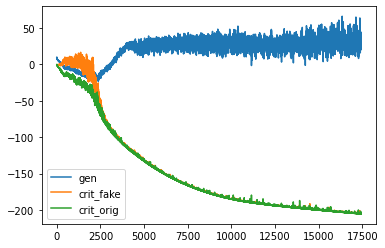

d loss fake  -205.0108642578125
d loss real  -205.480224609375
[Epoch 51/100] [Batch 151/345] [D loss: -205.245544, acc:   0%] [G loss: 23.726338] [c1: 11.609840, c2: 10.871740, o: 61.957600, f: 26.315830] time: 11:17:57.942767
d loss fake  -205.28953552246094
d loss real  -205.45953369140625
[Epoch 51/100] [Batch 152/345] [D loss: -205.374535, acc:   0%] [G loss: 15.697425] [c1: -0.579487, c2: -1.072775, o: 49.910145, f: 11.165995] time: 11:18:00.241102
d loss fake  -205.31309509277344
d loss real  -205.47299194335938
[Epoch 51/100] [Batch 153/345] [D loss: -205.393044, acc:   0%] [G loss: 17.284438] [c1: 3.456904, c2: 3.247108, o: 34.751610, f: -1.407012] time: 11:18:02.540530
d loss fake  -205.39089965820312
d loss real  -205.50332641601562
[Epoch 51/100] [Batch 154/345] [D loss: -205.447113, acc:   0%] [G loss: 18.217641] [c1: 5.442270, c2: 4.641356, o: 41.569725, f: 4.345238] time: 11:18:04.831688
d loss fake  -205.265625
d loss real  -205.0875701904297
[Epoch 51/100] [Batch 155/3

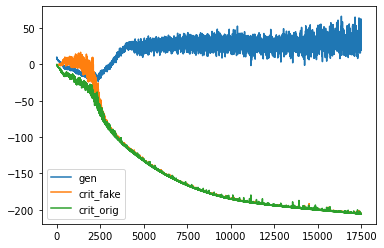

d loss fake  -205.4602508544922
d loss real  -205.60638427734375
[Epoch 51/100] [Batch 201/345] [D loss: -205.533318, acc:   0%] [G loss: 23.567645] [c1: 11.796431, c2: 11.461814, o: 46.803902, f: 8.583040] time: 11:19:53.785996
d loss fake  -205.50543212890625
d loss real  -205.535400390625
[Epoch 51/100] [Batch 202/345] [D loss: -205.520416, acc:   0%] [G loss: 29.645493] [c1: 20.018894, c2: 19.956797, o: 53.030994, f: 11.239296] time: 11:19:56.089166
d loss fake  -205.39056396484375
d loss real  -205.36001586914062
[Epoch 51/100] [Batch 203/345] [D loss: -205.375290, acc:   0%] [G loss: 42.924028] [c1: 38.722908, c2: 38.732422, o: 60.401371, f: 17.352962] time: 11:19:58.383021
d loss fake  -205.3060302734375
d loss real  -205.61386108398438
[Epoch 51/100] [Batch 204/345] [D loss: -205.459946, acc:   0%] [G loss: 29.128573] [c1: 19.182915, c2: 18.793274, o: 80.302856, f: 40.881271] time: 11:20:00.681068
d loss fake  -205.50674438476562
d loss real  -205.643798828125
[Epoch 51/100] [B

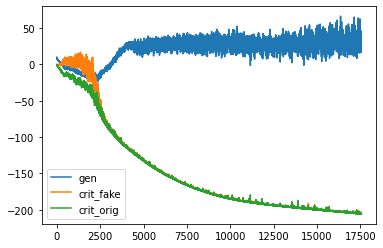

d loss fake  -205.60003662109375
d loss real  -205.70394897460938
[Epoch 51/100] [Batch 251/345] [D loss: -205.651993, acc:   0%] [G loss: 26.796296] [c1: 16.266951, c2: 16.287663, o: 60.610050, f: 21.487469] time: 11:21:50.485115
d loss fake  -205.59381103515625
d loss real  -205.69647216796875
[Epoch 51/100] [Batch 252/345] [D loss: -205.645142, acc:   0%] [G loss: 19.601148] [c1: 5.856016, c2: 6.556929, o: 54.751671, f: 17.519867] time: 11:21:52.779752
d loss fake  -205.59854125976562
d loss real  -204.78306579589844
[Epoch 51/100] [Batch 253/345] [D loss: -205.190804, acc:   0%] [G loss: 28.837806] [c1: 20.922321, c2: 21.209787, o: 42.773689, f: 5.893335] time: 11:21:55.070725
d loss fake  -205.5774688720703
d loss real  -205.62103271484375
[Epoch 51/100] [Batch 254/345] [D loss: -205.599251, acc:   0%] [G loss: 27.918003] [c1: 17.606333, c2: 17.123491, o: 58.381241, f: 18.917454] time: 11:21:57.375592
d loss fake  -205.42605590820312
d loss real  -205.70458984375
[Epoch 51/100] [B

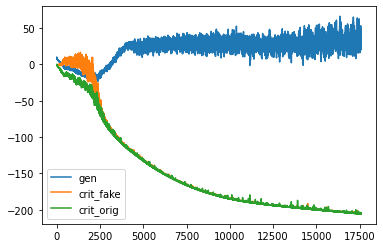

d loss fake  -205.68031311035156
d loss real  -205.76541137695312
[Epoch 51/100] [Batch 301/345] [D loss: -205.722862, acc:   0%] [G loss: 32.747172] [c1: 20.693371, c2: 20.892967, o: 77.030296, f: 31.612417] time: 11:23:47.397274
d loss fake  -205.70947265625
d loss real  -205.76910400390625
[Epoch 51/100] [Batch 302/345] [D loss: -205.739288, acc:   0%] [G loss: 29.109839] [c1: 14.682977, c2: 14.438783, o: 66.056885, f: 21.164431] time: 11:23:49.709131
d loss fake  -205.354248046875
d loss real  -205.7915802001953
[Epoch 51/100] [Batch 303/345] [D loss: -205.572914, acc:   0%] [G loss: 22.634424] [c1: 8.633365, c2: 8.665543, o: 53.382233, f: 16.444975] time: 11:23:52.004994
d loss fake  -205.68438720703125
d loss real  -205.65655517578125
[Epoch 51/100] [Batch 304/345] [D loss: -205.670471, acc:   0%] [G loss: 27.950196] [c1: 19.189026, c2: 18.236332, o: 50.348740, f: 9.039968] time: 11:23:54.313092
d loss fake  -205.19815063476562
d loss real  -205.22900390625
[Epoch 51/100] [Batch 

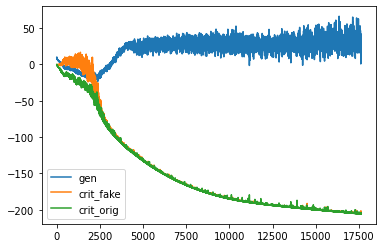

d loss fake  -205.18051147460938
d loss real  -205.83892822265625
[Epoch 52/100] [Batch 1/345] [D loss: -205.509720, acc:   0%] [G loss: 15.649761] [c1: -5.203769, c2: -4.737790, o: 62.050388, f: 19.734474] time: 11:25:23.148057
d loss fake  -205.680908203125
d loss real  -205.30157470703125
[Epoch 52/100] [Batch 2/345] [D loss: -205.491241, acc:   0%] [G loss: 27.592870] [c1: 13.409577, c2: 12.921938, o: 38.286797, f: -6.677303] time: 11:25:25.475461
d loss fake  -205.06600952148438
d loss real  -205.80728149414062
[Epoch 52/100] [Batch 3/345] [D loss: -205.436646, acc:   0%] [G loss: 19.101269] [c1: -1.168394, c2: -1.075073, o: 61.450878, f: 12.771856] time: 11:25:27.801866
d loss fake  -205.5756378173828
d loss real  -205.78297424316406
[Epoch 52/100] [Batch 4/345] [D loss: -205.679306, acc:   0%] [G loss: 18.119286] [c1: -1.027023, c2: -1.567762, o: 45.441254, f: -1.698822] time: 11:25:30.151800
d loss fake  -205.46380615234375
d loss real  -205.86346435546875
[Epoch 52/100] [Batch

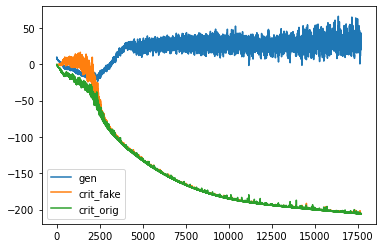

d loss fake  -205.5941619873047
d loss real  -205.3494110107422
[Epoch 52/100] [Batch 51/345] [D loss: -205.471786, acc:   0%] [G loss: 27.904759] [c1: 15.619229, c2: 14.986187, o: 56.488243, f: 13.616602] time: 11:27:19.198240
d loss fake  -205.8807373046875
d loss real  -205.93524169921875
[Epoch 52/100] [Batch 52/345] [D loss: -205.907990, acc:   0%] [G loss: 39.210598] [c1: 32.126686, c2: 31.709911, o: 64.877289, f: 18.236675] time: 11:27:21.504629
d loss fake  -205.86578369140625
d loss real  -205.90313720703125
[Epoch 52/100] [Batch 53/345] [D loss: -205.884460, acc:   0%] [G loss: 39.231323] [c1: 34.237068, c2: 33.827194, o: 75.994484, f: 31.753674] time: 11:27:23.812964
d loss fake  -205.31573486328125
d loss real  -205.94064331054688
[Epoch 52/100] [Batch 54/345] [D loss: -205.628189, acc:   0%] [G loss: 30.701089] [c1: 17.911699, c2: 18.535238, o: 78.225967, f: 33.045525] time: 11:27:26.101201
d loss fake  -205.74989318847656
d loss real  -205.80975341796875
[Epoch 52/100] [B

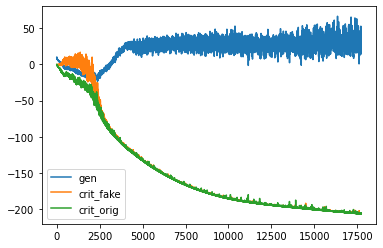

d loss fake  -205.97496032714844
d loss real  -206.05044555664062
[Epoch 52/100] [Batch 101/345] [D loss: -206.012703, acc:   0%] [G loss: 36.036019] [c1: 28.408806, c2: 28.521355, o: 67.621666, f: 20.399984] time: 11:29:15.982533
d loss fake  -205.93008422851562
d loss real  -206.06100463867188
[Epoch 52/100] [Batch 102/345] [D loss: -205.995544, acc:   0%] [G loss: 44.252223] [c1: 40.119072, c2: 39.796772, o: 77.786713, f: 30.345892] time: 11:29:18.280301
d loss fake  -205.77761840820312
d loss real  -206.0928955078125
[Epoch 52/100] [Batch 103/345] [D loss: -205.935257, acc:   0%] [G loss: 35.103812] [c1: 25.884296, c2: 26.256813, o: 83.443893, f: 39.410767] time: 11:29:20.567866
d loss fake  -205.97842407226562
d loss real  -206.0673828125
[Epoch 52/100] [Batch 104/345] [D loss: -206.022903, acc:   0%] [G loss: 34.367946] [c1: 27.759720, c2: 27.604023, o: 73.586609, f: 28.788675] time: 11:29:22.866829
d loss fake  -205.49566650390625
d loss real  -206.07310485839844
[Epoch 52/100] 

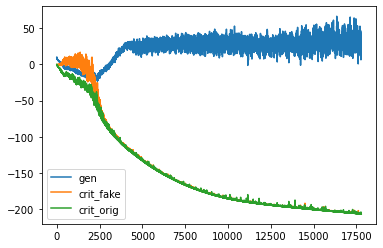

d loss fake  -206.01373291015625
d loss real  -205.90847778320312
[Epoch 52/100] [Batch 151/345] [D loss: -205.961105, acc:   0%] [G loss: 33.757308] [c1: 26.467279, c2: 25.965588, o: 53.286652, f: 16.886711] time: 11:31:12.936511
d loss fake  -205.9905548095703
d loss real  -206.11537170410156
[Epoch 52/100] [Batch 152/345] [D loss: -206.052963, acc:   0%] [G loss: 30.866376] [c1: 20.879303, c2: 20.995331, o: 66.434433, f: 24.705017] time: 11:31:15.233417
d loss fake  -206.08380126953125
d loss real  -206.16256713867188
[Epoch 52/100] [Batch 153/345] [D loss: -206.123184, acc:   0%] [G loss: 30.297633] [c1: 20.546066, c2: 21.016748, o: 64.848083, f: 20.694508] time: 11:31:17.525102
d loss fake  -205.85650634765625
d loss real  -206.150390625
[Epoch 52/100] [Batch 154/345] [D loss: -206.003448, acc:   0%] [G loss: 46.166668] [c1: 43.125629, c2: 43.027092, o: 63.836365, f: 21.178345] time: 11:31:19.843194
d loss fake  -206.00521850585938
d loss real  -205.98684692382812
[Epoch 52/100] [

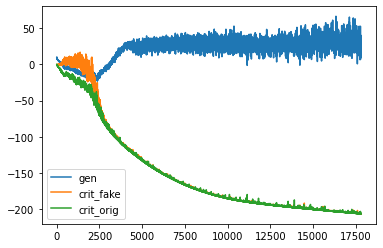

d loss fake  -206.1751708984375
d loss real  -206.27589416503906
[Epoch 52/100] [Batch 201/345] [D loss: -206.225533, acc:   0%] [G loss: 32.461388] [c1: 26.556217, c2: 26.513683, o: 70.535431, f: 31.951637] time: 11:33:08.661175
d loss fake  -206.14382934570312
d loss real  -206.23455810546875
[Epoch 52/100] [Batch 202/345] [D loss: -206.189194, acc:   0%] [G loss: 38.493778] [c1: 35.066811, c2: 34.764267, o: 64.530579, f: 25.519684] time: 11:33:10.974516
d loss fake  -206.17034912109375
d loss real  -206.24765014648438
[Epoch 52/100] [Batch 203/345] [D loss: -206.209000, acc:   0%] [G loss: 38.238672] [c1: 33.970890, c2: 33.980309, o: 73.502533, f: 34.114922] time: 11:33:13.265801
d loss fake  -206.17471313476562
d loss real  -206.2352752685547
[Epoch 52/100] [Batch 204/345] [D loss: -206.204994, acc:   0%] [G loss: 36.177706] [c1: 31.877892, c2: 32.388790, o: 75.989151, f: 37.889164] time: 11:33:15.572688
d loss fake  -206.14093017578125
d loss real  -205.24098205566406
[Epoch 52/10

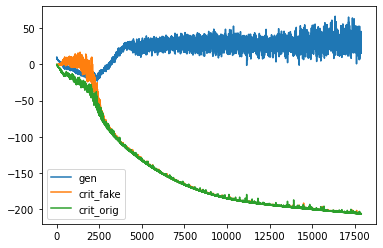

d loss fake  -204.71649169921875
d loss real  -205.27517700195312
[Epoch 52/100] [Batch 251/345] [D loss: -204.995834, acc:   0%] [G loss: 22.006807] [c1: 5.472453, c2: 5.326441, o: 43.340454, f: 2.880734] time: 11:35:05.680717
d loss fake  -206.28921508789062
d loss real  -206.3784942626953
[Epoch 52/100] [Batch 252/345] [D loss: -206.333855, acc:   0%] [G loss: 21.024861] [c1: 7.304119, c2: 7.631671, o: 49.095211, f: 6.314463] time: 11:35:07.978551
d loss fake  -206.2367706298828
d loss real  -206.23020935058594
[Epoch 52/100] [Batch 253/345] [D loss: -206.233490, acc:   0%] [G loss: 30.102537] [c1: 22.512074, c2: 22.318161, o: 46.218781, f: 6.801960] time: 11:35:10.273393
d loss fake  -206.24313354492188
d loss real  -206.38047790527344
[Epoch 52/100] [Batch 254/345] [D loss: -206.311806, acc:   0%] [G loss: 33.113051] [c1: 29.816586, c2: 29.577835, o: 63.833923, f: 25.079147] time: 11:35:12.578300
d loss fake  -206.0370635986328
d loss real  -205.85531616210938
[Epoch 52/100] [Batc

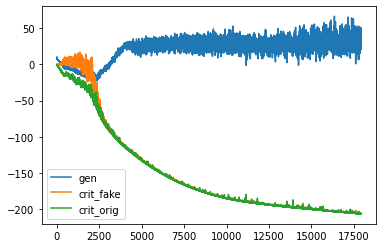

d loss fake  -206.3583221435547
d loss real  -206.4491729736328
[Epoch 52/100] [Batch 301/345] [D loss: -206.403748, acc:   0%] [G loss: 37.437550] [c1: 31.554499, c2: 30.836792, o: 81.370239, f: 37.959694] time: 11:37:02.285112
d loss fake  -205.35984802246094
d loss real  -206.24072265625
[Epoch 52/100] [Batch 302/345] [D loss: -205.800285, acc:   0%] [G loss: 28.663940] [c1: 18.166183, c2: 17.880352, o: 69.982323, f: 30.430483] time: 11:37:04.588644
d loss fake  -206.31948852539062
d loss real  -206.46456909179688
[Epoch 52/100] [Batch 303/345] [D loss: -206.392029, acc:   0%] [G loss: 21.818563] [c1: 3.890854, c2: 4.325022, o: 63.040668, f: 18.125683] time: 11:37:06.881305
d loss fake  -205.93507385253906
d loss real  -206.22576904296875
[Epoch 52/100] [Batch 304/345] [D loss: -206.080421, acc:   0%] [G loss: 22.140095] [c1: 7.239990, c2: 6.996673, o: 43.068043, f: 5.325931] time: 11:37:09.180501
d loss fake  -206.3131866455078
d loss real  -206.40097045898438
[Epoch 52/100] [Batch

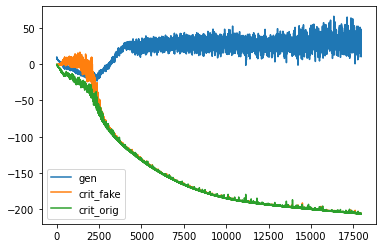

d loss fake  -206.4359130859375
d loss real  -206.51974487304688
[Epoch 53/100] [Batch 1/345] [D loss: -206.477829, acc:   0%] [G loss: 21.932865] [c1: 9.661259, c2: 9.052273, o: 40.194706, f: 2.441632] time: 11:38:38.785680
d loss fake  -206.40139770507812
d loss real  -206.28347778320312
[Epoch 53/100] [Batch 2/345] [D loss: -206.342438, acc:   0%] [G loss: 28.272981] [c1: 18.178356, c2: 18.162296, o: 48.832016, f: 9.526361] time: 11:38:41.135174
d loss fake  -206.3053741455078
d loss real  -206.31739807128906
[Epoch 53/100] [Batch 3/345] [D loss: -206.311386, acc:   0%] [G loss: 32.475697] [c1: 18.897400, c2: 19.192417, o: 60.965828, f: 14.820210] time: 11:38:43.485641
d loss fake  -205.99569702148438
d loss real  -206.533935546875
[Epoch 53/100] [Batch 4/345] [D loss: -206.264816, acc:   0%] [G loss: 20.031916] [c1: 2.697531, c2: 3.588885, o: 63.191727, f: 20.841293] time: 11:38:45.822603
d loss fake  -206.11776733398438
d loss real  -206.46218872070312
[Epoch 53/100] [Batch 5/345]

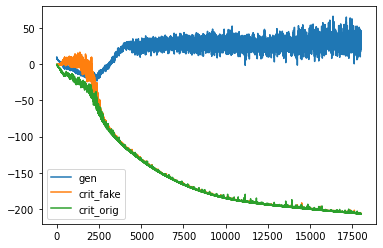

d loss fake  -206.43499755859375
d loss real  -206.00408935546875
[Epoch 53/100] [Batch 51/345] [D loss: -206.219543, acc:   0%] [G loss: 31.694647] [c1: 21.534128, c2: 20.991032, o: 57.835037, f: 14.310813] time: 11:40:34.190486
d loss fake  -206.47012329101562
d loss real  -206.54774475097656
[Epoch 53/100] [Batch 52/345] [D loss: -206.508934, acc:   0%] [G loss: 30.994939] [c1: 16.737221, c2: 16.748714, o: 67.311737, f: 19.202988] time: 11:40:36.476450
d loss fake  -206.27664184570312
d loss real  -205.6674346923828
[Epoch 53/100] [Batch 53/345] [D loss: -205.972038, acc:   0%] [G loss: 34.305779] [c1: 26.263556, c2: 25.766994, o: 63.813107, f: 20.688444] time: 11:40:38.763567
d loss fake  -206.24041748046875
d loss real  -206.01318359375
[Epoch 53/100] [Batch 54/345] [D loss: -206.126801, acc:   0%] [G loss: 33.257043] [c1: 18.230366, c2: 18.756279, o: 70.957809, f: 21.018730] time: 11:40:41.061061
d loss fake  -206.32614135742188
d loss real  -206.64175415039062
[Epoch 53/100] [Ba

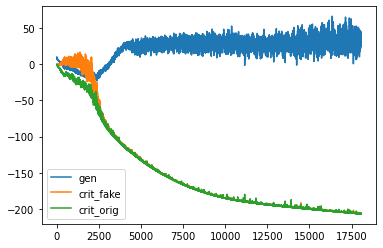

d loss fake  -206.63209533691406
d loss real  -206.75860595703125
[Epoch 53/100] [Batch 101/345] [D loss: -206.695351, acc:   0%] [G loss: 33.155790] [c1: 27.188622, c2: 27.185265, o: 73.655121, f: 27.555525] time: 11:42:30.583278
d loss fake  -206.610107421875
d loss real  -205.84933471679688
[Epoch 53/100] [Batch 102/345] [D loss: -206.229721, acc:   0%] [G loss: 41.505048] [c1: 36.035454, c2: 35.469063, o: 70.781570, f: 28.245090] time: 11:42:32.890822
d loss fake  -206.4910888671875
d loss real  -206.69674682617188
[Epoch 53/100] [Batch 103/345] [D loss: -206.593918, acc:   0%] [G loss: 51.497380] [c1: 50.749474, c2: 50.533703, o: 84.419525, f: 35.737755] time: 11:42:35.171705
d loss fake  -206.63690185546875
d loss real  -206.76364135742188
[Epoch 53/100] [Batch 104/345] [D loss: -206.700272, acc:   0%] [G loss: 42.547599] [c1: 39.784843, c2: 40.020630, o: 99.577347, f: 53.505611] time: 11:42:37.462428
d loss fake  -206.62606811523438
d loss real  -206.73329162597656
[Epoch 53/100

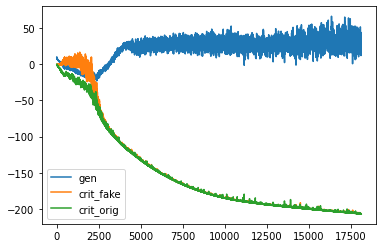

d loss fake  -206.7156982421875
d loss real  -206.73170471191406
[Epoch 53/100] [Batch 151/345] [D loss: -206.723701, acc:   0%] [G loss: 43.767413] [c1: 40.680305, c2: 40.567558, o: 73.501266, f: 32.867767] time: 11:44:26.775286
d loss fake  -206.74034118652344
d loss real  -206.79718017578125
[Epoch 53/100] [Batch 152/345] [D loss: -206.768761, acc:   0%] [G loss: 32.763262] [c1: 22.403910, c2: 22.429724, o: 81.038040, f: 39.451317] time: 11:44:29.071635
d loss fake  -206.67327880859375
d loss real  -206.7330322265625
[Epoch 53/100] [Batch 153/345] [D loss: -206.703156, acc:   0%] [G loss: 39.438500] [c1: 36.836842, c2: 36.266670, o: 64.253937, f: 25.882963] time: 11:44:31.353393
d loss fake  -205.9302520751953
d loss real  -206.8764190673828
[Epoch 53/100] [Batch 154/345] [D loss: -206.403336, acc:   0%] [G loss: 22.339503] [c1: 4.048985, c2: 3.702410, o: 75.645401, f: 33.207935] time: 11:44:33.641713
d loss fake  -206.68170166015625
d loss real  -206.80703735351562
[Epoch 53/100] [

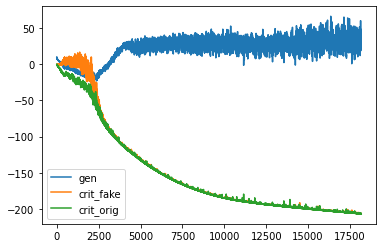

d loss fake  -206.84515380859375
d loss real  -206.9091796875
[Epoch 53/100] [Batch 201/345] [D loss: -206.877167, acc:   0%] [G loss: 39.223530] [c1: 34.628948, c2: 34.577919, o: 72.408752, f: 31.300911] time: 11:46:22.036741
d loss fake  -206.83584594726562
d loss real  -206.94808959960938
[Epoch 53/100] [Batch 202/345] [D loss: -206.891968, acc:   0%] [G loss: 39.705283] [c1: 36.588707, c2: 36.766071, o: 76.092468, f: 35.140320] time: 11:46:24.332377
d loss fake  -206.78073120117188
d loss real  -206.890869140625
[Epoch 53/100] [Batch 203/345] [D loss: -206.835800, acc:   0%] [G loss: 50.570216] [c1: 50.811165, c2: 50.803654, o: 79.763786, f: 37.220184] time: 11:46:26.618584
d loss fake  -206.85874938964844
d loss real  -206.96990966796875
[Epoch 53/100] [Batch 204/345] [D loss: -206.914330, acc:   0%] [G loss: 42.653667] [c1: 34.661961, c2: 35.074886, o: 93.117966, f: 48.993446] time: 11:46:28.903180
d loss fake  -206.89578247070312
d loss real  -206.966796875
[Epoch 53/100] [Batch

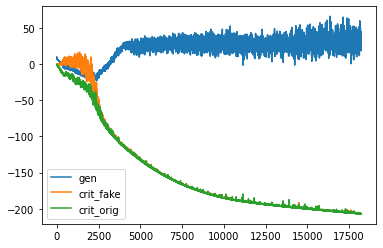

d loss fake  -206.76907348632812
d loss real  -206.92620849609375
[Epoch 53/100] [Batch 251/345] [D loss: -206.847641, acc:   0%] [G loss: 50.443793] [c1: 54.287167, c2: 53.633049, o: 83.057640, f: 45.155945] time: 11:48:18.250259
d loss fake  -206.96099853515625
d loss real  -207.06085205078125
[Epoch 53/100] [Batch 252/345] [D loss: -207.010925, acc:   0%] [G loss: 44.012794] [c1: 44.401493, c2: 43.647026, o: 94.018158, f: 53.130424] time: 11:48:20.533575
d loss fake  -206.7956085205078
d loss real  -206.9146728515625
[Epoch 53/100] [Batch 253/345] [D loss: -206.855141, acc:   0%] [G loss: 41.286394] [c1: 35.885571, c2: 35.517788, o: 83.539444, f: 44.130005] time: 11:48:22.816395
d loss fake  -206.88758850097656
d loss real  -207.07015991210938
[Epoch 53/100] [Batch 254/345] [D loss: -206.978874, acc:   0%] [G loss: 30.819826] [c1: 19.262838, c2: 19.361618, o: 79.773773, f: 34.933418] time: 11:48:25.106245
d loss fake  -206.91033935546875
d loss real  -207.00555419921875
[Epoch 53/10

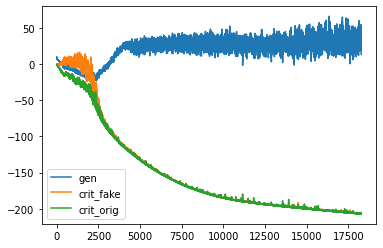

d loss fake  -206.4384765625
d loss real  -204.6961669921875
[Epoch 53/100] [Batch 301/345] [D loss: -205.567322, acc:   0%] [G loss: 20.593283] [c1: 4.566802, c2: 2.992268, o: 33.250988, f: -5.522135] time: 11:50:14.516138
d loss fake  -205.79725646972656
d loss real  -206.85702514648438
[Epoch 53/100] [Batch 302/345] [D loss: -206.327141, acc:   0%] [G loss: 9.630305] [c1: -14.959745, c2: -16.605137, o: 41.200962, f: 1.832339] time: 11:50:16.800571
d loss fake  -204.41046142578125
d loss real  -207.07965087890625
[Epoch 53/100] [Batch 303/345] [D loss: -205.745056, acc:   0%] [G loss: 12.876303] [c1: -13.315624, c2: -12.541922, o: 25.801622, f: -17.561752] time: 11:50:19.073979
d loss fake  -206.68417358398438
d loss real  -207.03384399414062
[Epoch 53/100] [Batch 304/345] [D loss: -206.859009, acc:   0%] [G loss: 9.422503] [c1: -12.499603, c2: -12.293006, o: 36.143269, f: -12.374943] time: 11:50:21.361551
d loss fake  -206.98216247558594
d loss real  -207.013916015625
[Epoch 53/100]

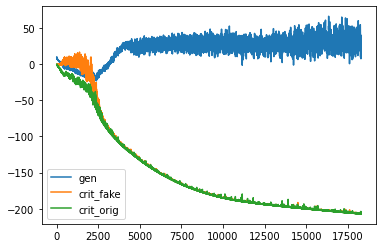

d loss fake  -206.94461059570312
d loss real  -207.14234924316406
[Epoch 54/100] [Batch 1/345] [D loss: -207.043480, acc:   0%] [G loss: 19.898479] [c1: -1.380385, c2: 0.010767, o: 44.674698, f: -1.051765] time: 11:51:49.626201
d loss fake  -204.81434631347656
d loss real  -206.6554412841797
[Epoch 54/100] [Batch 2/345] [D loss: -205.734894, acc:   0%] [G loss: 13.175956] [c1: -10.184220, c2: -10.984526, o: 43.151505, f: 0.600328] time: 11:51:51.975905
d loss fake  -206.36569213867188
d loss real  -206.7666473388672
[Epoch 54/100] [Batch 3/345] [D loss: -206.566170, acc:   0%] [G loss: 17.253209] [c1: -3.858906, c2: -5.537438, o: 39.072266, f: -12.249270] time: 11:51:54.319333
d loss fake  -206.97811889648438
d loss real  -206.79443359375
[Epoch 54/100] [Batch 4/345] [D loss: -206.886276, acc:   0%] [G loss: 25.755906] [c1: 10.089927, c2: 9.067951, o: 42.713856, f: -6.048125] time: 11:51:56.673869
d loss fake  -206.95510864257812
d loss real  -207.06640625
[Epoch 54/100] [Batch 5/345] 

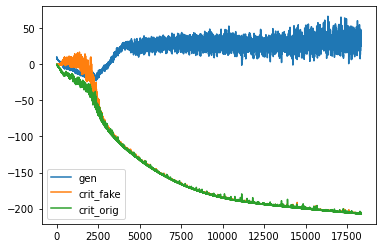

d loss fake  -207.12579345703125
d loss real  -207.22677612304688
[Epoch 54/100] [Batch 51/345] [D loss: -207.176285, acc:   0%] [G loss: 30.601327] [c1: 18.304996, c2: 18.373821, o: 66.290939, f: 19.475252] time: 11:53:44.773480
d loss fake  -207.10816955566406
d loss real  -207.0979461669922
[Epoch 54/100] [Batch 52/345] [D loss: -207.103058, acc:   0%] [G loss: 35.505507] [c1: 26.141766, c2: 25.618397, o: 64.376495, f: 17.578278] time: 11:53:47.047701
d loss fake  -207.06063842773438
d loss real  -207.31167602539062
[Epoch 54/100] [Batch 53/345] [D loss: -207.186157, acc:   0%] [G loss: 40.915430] [c1: 38.163544, c2: 37.433739, o: 74.653404, f: 30.723917] time: 11:53:49.354592
d loss fake  -207.13986206054688
d loss real  -207.228759765625
[Epoch 54/100] [Batch 54/345] [D loss: -207.184311, acc:   0%] [G loss: 37.395601] [c1: 29.987986, c2: 29.591923, o: 77.135803, f: 32.295929] time: 11:53:51.633136
d loss fake  -207.11758422851562
d loss real  -207.2777099609375
[Epoch 54/100] [Ba

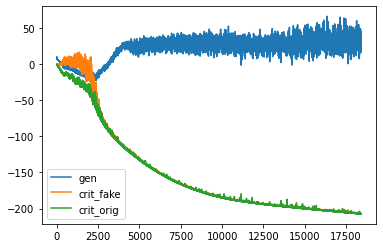

d loss fake  -207.26461791992188
d loss real  -207.2955780029297
[Epoch 54/100] [Batch 101/345] [D loss: -207.280098, acc:   0%] [G loss: 25.923526] [c1: 13.733014, c2: 13.226404, o: 45.063400, f: 2.267051] time: 11:55:40.748248
d loss fake  -207.2338409423828
d loss real  -207.40406799316406
[Epoch 54/100] [Batch 102/345] [D loss: -207.318954, acc:   0%] [G loss: 31.811810] [c1: 23.017666, c2: 22.642456, o: 58.941170, f: 13.279707] time: 11:55:43.031553
d loss fake  -207.17349243164062
d loss real  -207.3944854736328
[Epoch 54/100] [Batch 103/345] [D loss: -207.283989, acc:   0%] [G loss: 36.838475] [c1: 31.984009, c2: 32.216660, o: 67.921028, f: 22.024021] time: 11:55:45.303784
d loss fake  -207.22877502441406
d loss real  -207.40243530273438
[Epoch 54/100] [Batch 104/345] [D loss: -207.315605, acc:   0%] [G loss: 32.601768] [c1: 22.121859, c2: 22.117947, o: 75.663162, f: 31.771957] time: 11:55:47.581879
d loss fake  -207.2440948486328
d loss real  -207.41758728027344
[Epoch 54/100] 

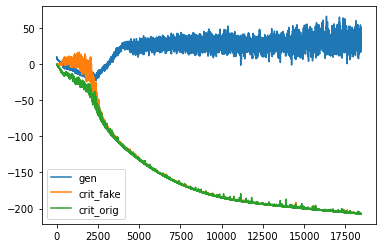

d loss fake  -207.1988525390625
d loss real  -207.40921020507812
[Epoch 54/100] [Batch 151/345] [D loss: -207.304031, acc:   0%] [G loss: 39.289286] [c1: 32.820152, c2: 32.400436, o: 86.817673, f: 46.619743] time: 11:57:36.558526
d loss fake  -207.2958984375
d loss real  -207.41954040527344
[Epoch 54/100] [Batch 152/345] [D loss: -207.357719, acc:   0%] [G loss: 31.825355] [c1: 18.574400, c2: 18.564085, o: 74.940849, f: 31.870924] time: 11:57:38.842633
d loss fake  -207.3572235107422
d loss real  -207.514404296875
[Epoch 54/100] [Batch 153/345] [D loss: -207.435814, acc:   0%] [G loss: 32.064261] [c1: 21.606720, c2: 21.397675, o: 63.035137, f: 18.062897] time: 11:57:41.125838
d loss fake  -207.4433135986328
d loss real  -207.4416961669922
[Epoch 54/100] [Batch 154/345] [D loss: -207.442505, acc:   0%] [G loss: 23.361580] [c1: 6.904476, c2: 7.030881, o: 65.739883, f: 21.640568] time: 11:57:43.410905
d loss fake  -207.2508087158203
d loss real  -206.6904296875
[Epoch 54/100] [Batch 155/3

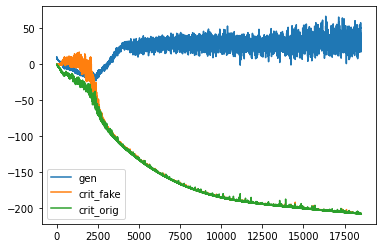

d loss fake  -207.46453857421875
d loss real  -207.33535766601562
[Epoch 54/100] [Batch 201/345] [D loss: -207.399948, acc:   0%] [G loss: 40.571974] [c1: 37.765404, c2: 37.494247, o: 57.835602, f: 16.568937] time: 11:59:31.221063
d loss fake  -207.4980010986328
d loss real  -207.02203369140625
[Epoch 54/100] [Batch 202/345] [D loss: -207.260017, acc:   0%] [G loss: 48.841889] [c1: 50.144775, c2: 49.759201, o: 78.364273, f: 38.889099] time: 11:59:33.503912
d loss fake  -207.3779754638672
d loss real  -207.56402587890625
[Epoch 54/100] [Batch 203/345] [D loss: -207.471001, acc:   0%] [G loss: 28.264442] [c1: 20.062153, c2: 19.492403, o: 90.306824, f: 50.351135] time: 11:59:35.792851
d loss fake  -207.4927215576172
d loss real  -207.61248779296875
[Epoch 54/100] [Batch 204/345] [D loss: -207.552605, acc:   0%] [G loss: 25.306056] [c1: 16.016800, c2: 15.700169, o: 58.204636, f: 18.858158] time: 11:59:38.091997
d loss fake  -206.0373992919922
d loss real  -207.57810974121094
[Epoch 54/100]

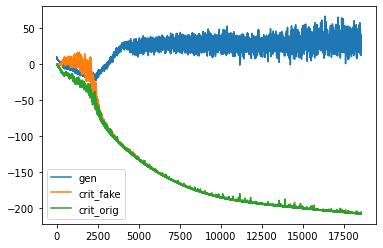

d loss fake  -207.5187530517578
d loss real  -206.96035766601562
[Epoch 54/100] [Batch 251/345] [D loss: -207.239555, acc:   0%] [G loss: 32.046501] [c1: 21.256767, c2: 20.947294, o: 33.251900, f: -5.748433] time: 12:01:27.273682
d loss fake  -207.47442626953125
d loss real  -207.59768676757812
[Epoch 54/100] [Batch 252/345] [D loss: -207.536057, acc:   0%] [G loss: 32.866107] [c1: 25.457512, c2: 24.658209, o: 64.525772, f: 23.069380] time: 12:01:29.549860
d loss fake  -207.29283142089844
d loss real  -207.6955108642578
[Epoch 54/100] [Batch 253/345] [D loss: -207.494171, acc:   0%] [G loss: 23.684450] [c1: 5.711919, c2: 5.385595, o: 65.658264, f: 21.122364] time: 12:01:31.826443
d loss fake  -207.5386199951172
d loss real  -207.650390625
[Epoch 54/100] [Batch 254/345] [D loss: -207.594505, acc:   0%] [G loss: 24.965454] [c1: 12.094146, c2: 11.484028, o: 49.294510, f: 7.331046] time: 12:01:34.112170
d loss fake  -207.5423126220703
d loss real  -207.6728515625
[Epoch 54/100] [Batch 255/

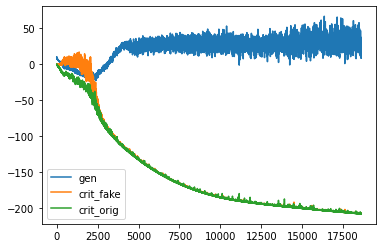

d loss fake  -207.5533447265625
d loss real  -207.62161254882812
[Epoch 54/100] [Batch 301/345] [D loss: -207.587479, acc:   0%] [G loss: 29.638576] [c1: 19.549953, c2: 19.734520, o: 63.377316, f: 19.022369] time: 12:03:22.885716
d loss fake  -207.4398193359375
d loss real  -204.9576416015625
[Epoch 54/100] [Batch 302/345] [D loss: -206.198730, acc:   0%] [G loss: 36.937531] [c1: 26.872505, c2: 26.416355, o: 62.948097, f: 18.126991] time: 12:03:25.176174
d loss fake  -207.53643798828125
d loss real  -207.31710815429688
[Epoch 54/100] [Batch 303/345] [D loss: -207.426773, acc:   0%] [G loss: 45.877130] [c1: 44.132252, c2: 43.671494, o: 74.904968, f: 29.066191] time: 12:03:27.457459
d loss fake  -207.46139526367188
d loss real  -207.66912841796875
[Epoch 54/100] [Batch 304/345] [D loss: -207.565262, acc:   0%] [G loss: 36.522766] [c1: 24.238770, c2: 24.604996, o: 85.293541, f: 44.650917] time: 12:03:29.740233
d loss fake  -207.60076904296875
d loss real  -207.68089294433594
[Epoch 54/100

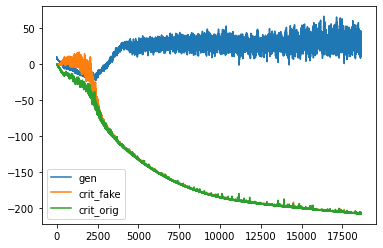

d loss fake  -205.3245086669922
d loss real  -207.3590087890625
[Epoch 55/100] [Batch 1/345] [D loss: -206.341759, acc:   0%] [G loss: 15.395182] [c1: -6.701203, c2: -5.827291, o: 48.421761, f: 3.415822] time: 12:04:57.798155
d loss fake  -207.47735595703125
d loss real  -207.50831604003906
[Epoch 55/100] [Batch 2/345] [D loss: -207.492836, acc:   0%] [G loss: 22.814223] [c1: 3.675347, c2: 4.848369, o: 42.335140, f: -7.558565] time: 12:05:00.131034
d loss fake  -207.66204833984375
d loss real  -207.6150665283203
[Epoch 55/100] [Batch 3/345] [D loss: -207.638557, acc:   0%] [G loss: 25.912340] [c1: 14.488710, c2: 14.540401, o: 51.315067, f: 5.049031] time: 12:05:02.490413
d loss fake  -207.56597900390625
d loss real  -207.55471801757812
[Epoch 55/100] [Batch 4/345] [D loss: -207.560349, acc:   0%] [G loss: 37.347116] [c1: 31.596897, c2: 29.950985, o: 58.657326, f: 15.062619] time: 12:05:04.830614
d loss fake  -207.60870361328125
d loss real  -207.74728393554688
[Epoch 55/100] [Batch 5/3

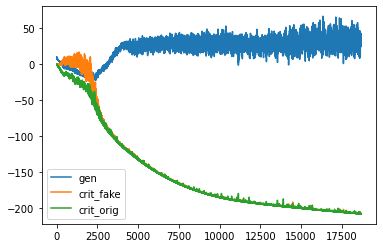

d loss fake  -207.54075622558594
d loss real  -207.39920043945312
[Epoch 55/100] [Batch 51/345] [D loss: -207.469978, acc:   0%] [G loss: 27.110238] [c1: 16.239944, c2: 15.855898, o: 54.145702, f: 8.401480] time: 12:06:52.395215
d loss fake  -207.75567626953125
d loss real  -207.80087280273438
[Epoch 55/100] [Batch 52/345] [D loss: -207.778275, acc:   0%] [G loss: 32.167791] [c1: 17.859711, c2: 17.958990, o: 63.633942, f: 15.016417] time: 12:06:54.673028
d loss fake  -207.8050537109375
d loss real  -207.90235900878906
[Epoch 55/100] [Batch 53/345] [D loss: -207.853706, acc:   0%] [G loss: 33.370334] [c1: 24.305237, c2: 24.000204, o: 67.774467, f: 21.164351] time: 12:06:56.945460
d loss fake  -207.78933715820312
d loss real  -207.67950439453125
[Epoch 55/100] [Batch 54/345] [D loss: -207.734421, acc:   0%] [G loss: 36.820039] [c1: 30.545876, c2: 30.170753, o: 67.270905, f: 22.072664] time: 12:06:59.228933
d loss fake  -207.81808471679688
d loss real  -207.7091064453125
[Epoch 55/100] [B

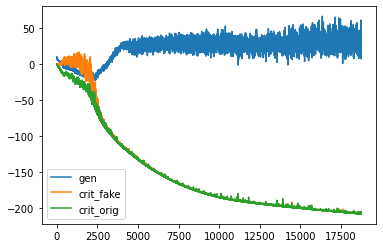

d loss fake  -207.74655151367188
d loss real  -208.0318603515625
[Epoch 55/100] [Batch 101/345] [D loss: -207.889206, acc:   0%] [G loss: 8.754740] [c1: -10.856653, c2: -11.944889, o: 38.103706, f: -3.362739] time: 12:08:48.359592
d loss fake  -207.47247314453125
d loss real  -207.8551788330078
[Epoch 55/100] [Batch 102/345] [D loss: -207.663826, acc:   0%] [G loss: 12.976364] [c1: -8.846319, c2: -9.669161, o: 29.972027, f: -14.293846] time: 12:08:50.637552
d loss fake  -207.8812713623047
d loss real  -208.05369567871094
[Epoch 55/100] [Batch 103/345] [D loss: -207.967484, acc:   0%] [G loss: 10.376524] [c1: -7.002483, c2: -7.413298, o: 38.308479, f: -4.835765] time: 12:08:52.916477
d loss fake  -207.58541870117188
d loss real  -208.06610107421875
[Epoch 55/100] [Batch 104/345] [D loss: -207.825760, acc:   0%] [G loss: 6.988924] [c1: -14.508092, c2: -14.550915, o: 34.755684, f: -9.062948] time: 12:08:55.195582
d loss fake  -207.7115020751953
d loss real  -208.0008544921875
[Epoch 55/10

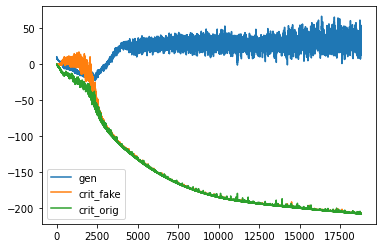

d loss fake  -207.87893676757812
d loss real  -206.9902801513672
[Epoch 55/100] [Batch 151/345] [D loss: -207.434608, acc:   0%] [G loss: 40.769698] [c1: 35.948101, c2: 35.896225, o: 54.450882, f: 13.511581] time: 12:10:44.294658
d loss fake  -207.99969482421875
d loss real  -208.06837463378906
[Epoch 55/100] [Batch 152/345] [D loss: -208.034035, acc:   0%] [G loss: 38.238580] [c1: 28.879023, c2: 29.144367, o: 81.948601, f: 32.311668] time: 12:10:46.581221
d loss fake  -207.95779418945312
d loss real  -208.07130432128906
[Epoch 55/100] [Batch 153/345] [D loss: -208.014549, acc:   0%] [G loss: 27.367605] [c1: 12.916039, c2: 12.928804, o: 76.922287, f: 28.860754] time: 12:10:48.858530
d loss fake  -207.93270874023438
d loss real  -207.99392700195312
[Epoch 55/100] [Batch 154/345] [D loss: -207.963318, acc:   0%] [G loss: 30.670988] [c1: 21.541159, c2: 21.289042, o: 59.722706, f: 16.276369] time: 12:10:51.144022
d loss fake  -207.9117889404297
d loss real  -208.0732421875
[Epoch 55/100] [

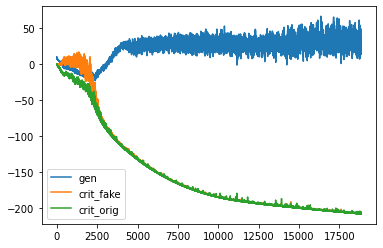

d loss fake  -208.11463928222656
d loss real  -208.065185546875
[Epoch 55/100] [Batch 201/345] [D loss: -208.089912, acc:   0%] [G loss: 32.505400] [c1: 25.516701, c2: 25.513947, o: 54.364784, f: 14.349497] time: 12:12:39.214774
d loss fake  -208.01559448242188
d loss real  -208.17669677734375
[Epoch 55/100] [Batch 202/345] [D loss: -208.096146, acc:   0%] [G loss: 29.493943] [c1: 17.438210, c2: 17.266930, o: 64.727577, f: 23.299580] time: 12:12:41.501231
d loss fake  -208.00900268554688
d loss real  -208.2220916748047
[Epoch 55/100] [Batch 203/345] [D loss: -208.115547, acc:   0%] [G loss: 22.866152] [c1: 9.259386, c2: 9.577347, o: 63.849209, f: 16.991693] time: 12:12:43.767975
d loss fake  -207.99806213378906
d loss real  -207.90911865234375
[Epoch 55/100] [Batch 204/345] [D loss: -207.953590, acc:   0%] [G loss: 40.628749] [c1: 36.526443, c2: 36.272327, o: 51.599335, f: 12.487198] time: 12:12:46.053290
d loss fake  -208.04446411132812
d loss real  -208.21717834472656
[Epoch 55/100] 

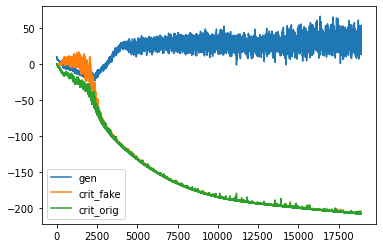

d loss fake  -207.93173217773438
d loss real  -203.8842010498047
[Epoch 55/100] [Batch 251/345] [D loss: -205.907967, acc:   0%] [G loss: 58.178777] [c1: 55.411888, c2: 55.826077, o: 88.412354, f: 43.063423] time: 12:14:35.178236
d loss fake  -208.03277587890625
d loss real  -207.4606170654297
[Epoch 55/100] [Batch 252/345] [D loss: -207.746696, acc:   0%] [G loss: 54.242840] [c1: 52.958824, c2: 53.132339, o: 110.965454, f: 60.476585] time: 12:14:37.473901
d loss fake  -208.04251098632812
d loss real  -207.99737548828125
[Epoch 55/100] [Batch 253/345] [D loss: -208.019943, acc:   0%] [G loss: 47.947056] [c1: 43.089905, c2: 42.803032, o: 97.201492, f: 52.962387] time: 12:14:39.749132
d loss fake  -208.0693359375
d loss real  -208.15365600585938
[Epoch 55/100] [Batch 254/345] [D loss: -208.111496, acc:   0%] [G loss: 34.593437] [c1: 25.493263, c2: 25.152847, o: 89.203392, f: 44.479603] time: 12:14:42.038788
d loss fake  -208.03759765625
d loss real  -208.19866943359375
[Epoch 55/100] [Ba

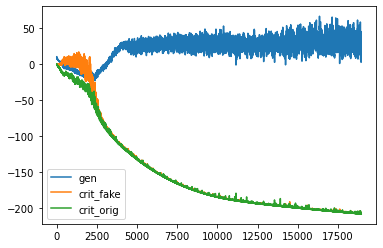

d loss fake  -208.14450073242188
d loss real  -208.28782653808594
[Epoch 55/100] [Batch 301/345] [D loss: -208.216164, acc:   0%] [G loss: 13.809729] [c1: -3.844298, c2: -4.606542, o: 37.620892, f: -2.743806] time: 12:16:31.123356
d loss fake  -208.07925415039062
d loss real  -208.35354614257812
[Epoch 55/100] [Batch 302/345] [D loss: -208.216400, acc:   0%] [G loss: 13.829810] [c1: -6.955450, c2: -6.851532, o: 39.483402, f: -5.327345] time: 12:16:33.404458
d loss fake  -208.2335662841797
d loss real  -208.3726043701172
[Epoch 55/100] [Batch 303/345] [D loss: -208.303085, acc:   0%] [G loss: 22.607287] [c1: 9.256100, c2: 9.427952, o: 33.044838, f: -5.579328] time: 12:16:35.673827
d loss fake  -207.78338623046875
d loss real  -206.66697692871094
[Epoch 55/100] [Batch 304/345] [D loss: -207.225182, acc:   0%] [G loss: 26.379459] [c1: 11.716941, c2: 11.394753, o: 46.846577, f: 7.474513] time: 12:16:37.963999
d loss fake  -207.38934326171875
d loss real  -208.11949157714844
[Epoch 55/100] 

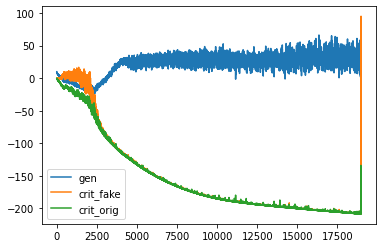

d loss fake  -208.00486755371094
d loss real  -206.8147735595703
[Epoch 56/100] [Batch 1/345] [D loss: -207.409821, acc:   0%] [G loss: 58.462562] [c1: 65.977570, c2: 64.776924, o: 96.820709, f: 54.113216] time: 12:18:05.972552
d loss fake  -207.93948364257812
d loss real  -206.32278442382812
[Epoch 56/100] [Batch 2/345] [D loss: -207.131134, acc:   0%] [G loss: 55.214764] [c1: 60.474205, c2: 59.314098, o: 109.237762, f: 68.428818] time: 12:18:08.298453
d loss fake  -207.962158203125
d loss real  -207.77163696289062
[Epoch 56/100] [Batch 3/345] [D loss: -207.866898, acc:   0%] [G loss: 51.682169] [c1: 56.746544, c2: 55.436226, o: 100.437225, f: 52.573212] time: 12:18:10.658377
d loss fake  -207.85403442382812
d loss real  -207.69070434570312
[Epoch 56/100] [Batch 4/345] [D loss: -207.772369, acc:   0%] [G loss: 45.847747] [c1: 46.915909, c2: 46.107986, o: 107.792763, f: 64.070740] time: 12:18:13.037898
d loss fake  -207.843994140625
d loss real  -207.69183349609375
[Epoch 56/100] [Batc

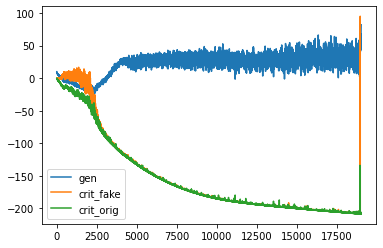

d loss fake  -207.59951782226562
d loss real  -207.83384704589844
[Epoch 56/100] [Batch 51/345] [D loss: -207.716682, acc:   0%] [G loss: 85.429012] [c1: 110.780869, c2: 110.477463, o: 154.028412, f: 105.369720] time: 12:20:01.219850
d loss fake  -207.67877197265625
d loss real  -208.26266479492188
[Epoch 56/100] [Batch 52/345] [D loss: -207.970718, acc:   0%] [G loss: 80.886453] [c1: 102.775444, c2: 102.307983, o: 155.967438, f: 109.854172] time: 12:20:03.496902
d loss fake  -207.715087890625
d loss real  -208.34542846679688
[Epoch 56/100] [Batch 53/345] [D loss: -208.030258, acc:   0%] [G loss: 77.139366] [c1: 97.976013, c2: 97.607864, o: 151.549286, f: 101.997192] time: 12:20:05.783433
d loss fake  -207.46954345703125
d loss real  -208.2821807861328
[Epoch 56/100] [Batch 54/345] [D loss: -207.875862, acc:   0%] [G loss: 82.276473] [c1: 105.703171, c2: 105.321632, o: 149.340744, f: 98.633110] time: 12:20:08.067170
d loss fake  -207.31927490234375
d loss real  -207.29629516601562
[Epo

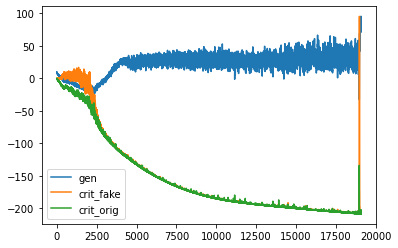

d loss fake  -207.98129272460938
d loss real  -208.5666961669922
[Epoch 56/100] [Batch 101/345] [D loss: -208.273994, acc:   0%] [G loss: 69.424677] [c1: 85.549294, c2: 85.264763, o: 146.040573, f: 93.028358] time: 12:21:57.063547
d loss fake  -207.92303466796875
d loss real  -208.5094451904297
[Epoch 56/100] [Batch 102/345] [D loss: -208.216240, acc:   0%] [G loss: 74.599361] [c1: 92.135193, c2: 91.994377, o: 131.058167, f: 83.265038] time: 12:21:59.348473
d loss fake  -207.98458862304688
d loss real  -208.34608459472656
[Epoch 56/100] [Batch 103/345] [D loss: -208.165337, acc:   0%] [G loss: 73.932664] [c1: 93.623367, c2: 93.527603, o: 136.311981, f: 89.650131] time: 12:22:01.623738
d loss fake  -208.0765380859375
d loss real  -207.87796020507812
[Epoch 56/100] [Batch 104/345] [D loss: -207.977249, acc:   0%] [G loss: 81.868366] [c1: 102.441528, c2: 102.212936, o: 144.429596, f: 94.230309] time: 12:22:03.909489
d loss fake  -208.07989501953125
d loss real  -208.60357666015625
[Epoch 

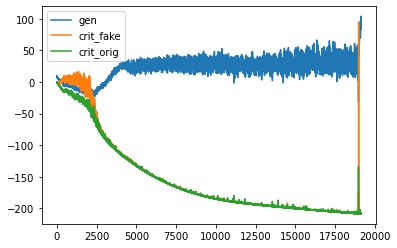

d loss fake  -208.0211181640625
d loss real  -208.61099243164062
[Epoch 56/100] [Batch 151/345] [D loss: -208.316055, acc:   0%] [G loss: 96.491827] [c1: 127.359894, c2: 127.180969, o: 184.332718, f: 131.227646] time: 12:23:52.955530
d loss fake  -207.86602783203125
d loss real  -208.58145141601562
[Epoch 56/100] [Batch 152/345] [D loss: -208.223740, acc:   0%] [G loss: 98.366455] [c1: 131.134628, c2: 130.880096, o: 178.189240, f: 126.146133] time: 12:23:55.230514
d loss fake  -207.98944091796875
d loss real  -208.5799560546875
[Epoch 56/100] [Batch 153/345] [D loss: -208.284698, acc:   0%] [G loss: 99.426491] [c1: 133.395111, c2: 133.107239, o: 184.596313, f: 131.499115] time: 12:23:57.505914
d loss fake  -207.94589233398438
d loss real  -208.42398071289062
[Epoch 56/100] [Batch 154/345] [D loss: -208.184937, acc:   0%] [G loss: 99.813097] [c1: 134.775940, c2: 134.588409, o: 179.941620, f: 133.522125] time: 12:23:59.791539
d loss fake  -208.1392364501953
d loss real  -208.664535522460

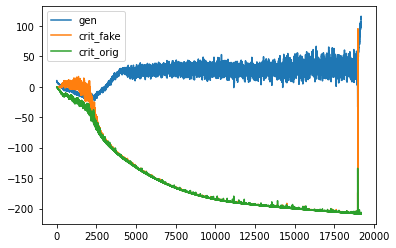

d loss fake  -208.00564575195312
d loss real  -208.5240936279297
[Epoch 56/100] [Batch 201/345] [D loss: -208.264870, acc:   0%] [G loss: 111.881725] [c1: 154.845673, c2: 154.470520, o: 205.282593, f: 153.621368] time: 12:25:47.861680
d loss fake  -207.8292694091797
d loss real  -208.77088928222656
[Epoch 56/100] [Batch 202/345] [D loss: -208.300079, acc:   0%] [G loss: 110.265531] [c1: 150.539062, c2: 149.984131, o: 208.044403, f: 151.893036] time: 12:25:50.168576
d loss fake  -207.99978637695312
d loss real  -208.72857666015625
[Epoch 56/100] [Batch 203/345] [D loss: -208.364182, acc:   0%] [G loss: 105.859844] [c1: 145.657562, c2: 145.358765, o: 210.924911, f: 153.556702] time: 12:25:52.453200
d loss fake  -207.91036987304688
d loss real  -208.69296264648438
[Epoch 56/100] [Batch 204/345] [D loss: -208.301666, acc:   0%] [G loss: 106.555884] [c1: 146.444626, c2: 146.078598, o: 193.920685, f: 144.017761] time: 12:25:54.742838
d loss fake  -207.88699340820312
d loss real  -208.7046203

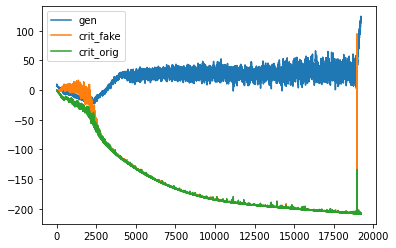

d loss fake  -207.94578552246094
d loss real  -208.5880889892578
[Epoch 56/100] [Batch 251/345] [D loss: -208.266937, acc:   0%] [G loss: 121.580606] [c1: 170.239227, c2: 170.076416, o: 211.446396, f: 170.051971] time: 12:27:43.857116
d loss fake  -207.9915771484375
d loss real  -208.6005859375
[Epoch 56/100] [Batch 252/345] [D loss: -208.296082, acc:   0%] [G loss: 121.344521] [c1: 170.416153, c2: 170.191345, o: 211.980408, f: 170.203766] time: 12:27:46.134292
d loss fake  -207.58628845214844
d loss real  -207.29176330566406
[Epoch 56/100] [Batch 253/345] [D loss: -207.439026, acc:   0%] [G loss: 125.969205] [c1: 174.561554, c2: 174.440582, o: 210.085114, f: 168.381348] time: 12:27:48.422601
d loss fake  -207.43576049804688
d loss real  -208.8196258544922
[Epoch 56/100] [Batch 254/345] [D loss: -208.127693, acc:   0%] [G loss: 120.738338] [c1: 168.554871, c2: 168.348175, o: 223.954926, f: 174.757980] time: 12:27:50.694485
d loss fake  -207.98385620117188
d loss real  -208.357940673828

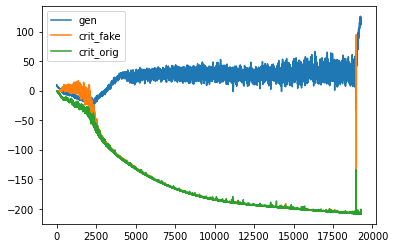

d loss fake  -207.55665588378906
d loss real  -207.80715942382812
[Epoch 56/100] [Batch 301/345] [D loss: -207.681908, acc:   0%] [G loss: 121.972175] [c1: 168.387177, c2: 168.343506, o: 203.610596, f: 163.503891] time: 12:29:39.410096
d loss fake  -207.82272338867188
d loss real  -208.77249145507812
[Epoch 56/100] [Batch 302/345] [D loss: -208.297607, acc:   0%] [G loss: 117.927052] [c1: 165.473419, c2: 165.269058, o: 216.474182, f: 169.911774] time: 12:29:41.697255
d loss fake  -208.03411865234375
d loss real  -208.69129943847656
[Epoch 56/100] [Batch 303/345] [D loss: -208.362709, acc:   0%] [G loss: 118.394150] [c1: 165.189209, c2: 165.007263, o: 210.214722, f: 167.468536] time: 12:29:43.970872
d loss fake  -207.92221069335938
d loss real  -206.8614044189453
[Epoch 56/100] [Batch 304/345] [D loss: -207.391808, acc:   0%] [G loss: 121.006376] [c1: 170.196808, c2: 170.045074, o: 202.045273, f: 164.723419] time: 12:29:46.250788
d loss fake  -208.05213928222656
d loss real  -208.610336

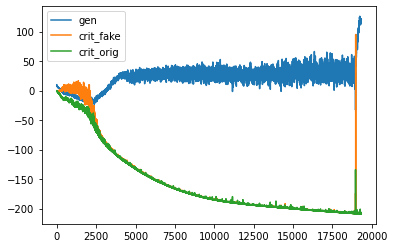

d loss fake  -208.23329162597656
d loss real  -208.9011993408203
[Epoch 57/100] [Batch 1/345] [D loss: -208.567245, acc:   0%] [G loss: 117.165308] [c1: 163.324005, c2: 163.174957, o: 204.830170, f: 165.230316] time: 12:31:14.596627
d loss fake  -208.30897521972656
d loss real  -208.885009765625
[Epoch 57/100] [Batch 2/345] [D loss: -208.596992, acc:   0%] [G loss: 115.777248] [c1: 161.451050, c2: 161.318665, o: 213.256744, f: 168.238770] time: 12:31:16.955837
d loss fake  -207.98446655273438
d loss real  -208.93228149414062
[Epoch 57/100] [Batch 3/345] [D loss: -208.458374, acc:   0%] [G loss: 114.525515] [c1: 158.327972, c2: 158.178207, o: 197.412659, f: 156.031891] time: 12:31:19.318096
d loss fake  -207.74636840820312
d loss real  -208.94940185546875
[Epoch 57/100] [Batch 4/345] [D loss: -208.347885, acc:   0%] [G loss: 113.125903] [c1: 155.585114, c2: 155.384369, o: 204.352722, f: 156.826935] time: 12:31:21.660792
d loss fake  -207.92291259765625
d loss real  -208.8935546875
[Epoc

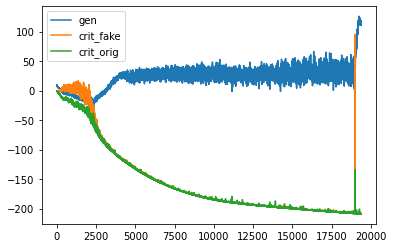

d loss fake  -208.39031982421875
d loss real  -209.03164672851562
[Epoch 57/100] [Batch 51/345] [D loss: -208.710983, acc:   0%] [G loss: 108.102585] [c1: 150.837662, c2: 150.536316, o: 184.664398, f: 151.519104] time: 12:33:09.516385
d loss fake  -208.40420532226562
d loss real  -208.09487915039062
[Epoch 57/100] [Batch 52/345] [D loss: -208.249542, acc:   0%] [G loss: 117.847050] [c1: 162.706299, c2: 162.657471, o: 189.677063, f: 153.462097] time: 12:33:11.798846
d loss fake  -208.45803833007812
d loss real  -208.9544219970703
[Epoch 57/100] [Batch 53/345] [D loss: -208.706230, acc:   0%] [G loss: 114.600429] [c1: 158.907059, c2: 158.717682, o: 199.520416, f: 161.798309] time: 12:33:14.070817
d loss fake  -208.4040985107422
d loss real  -208.81707763671875
[Epoch 57/100] [Batch 54/345] [D loss: -208.610588, acc:   0%] [G loss: 114.415475] [c1: 158.593597, c2: 158.365005, o: 196.840424, f: 158.040466] time: 12:33:16.360365
d loss fake  -208.54513549804688
d loss real  -209.00120544433

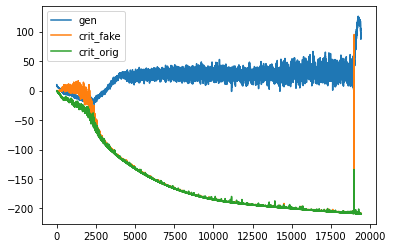

d loss fake  -208.67642211914062
d loss real  -209.22320556640625
[Epoch 57/100] [Batch 101/345] [D loss: -208.949814, acc:   0%] [G loss: 88.552304] [c1: 115.044106, c2: 114.716873, o: 175.381470, f: 124.527161] time: 12:35:05.572583
d loss fake  -208.36630249023438
d loss real  -209.14776611328125
[Epoch 57/100] [Batch 102/345] [D loss: -208.757034, acc:   0%] [G loss: 88.251412] [c1: 114.975914, c2: 114.632782, o: 154.153870, f: 115.075165] time: 12:35:07.862131
d loss fake  -208.62620544433594
d loss real  -209.11163330078125
[Epoch 57/100] [Batch 103/345] [D loss: -208.868919, acc:   0%] [G loss: 90.670189] [c1: 118.356834, c2: 118.058388, o: 155.256470, f: 111.943977] time: 12:35:10.135216
d loss fake  -208.72207641601562
d loss real  -209.21421813964844
[Epoch 57/100] [Batch 104/345] [D loss: -208.968147, acc:   0%] [G loss: 91.768960] [c1: 121.666298, c2: 121.337173, o: 163.976471, f: 122.750984] time: 12:35:12.420962
d loss fake  -208.6265869140625
d loss real  -209.1315155029

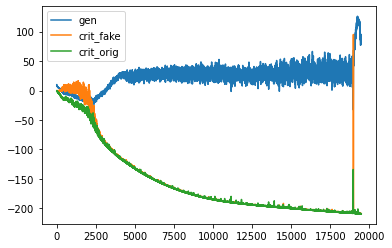

d loss fake  -208.8470458984375
d loss real  -209.27548217773438
[Epoch 57/100] [Batch 151/345] [D loss: -209.061264, acc:   0%] [G loss: 80.944964] [c1: 105.555084, c2: 105.189415, o: 153.051056, f: 105.227318] time: 12:37:01.609475
d loss fake  -208.75076293945312
d loss real  -209.25404357910156
[Epoch 57/100] [Batch 152/345] [D loss: -209.002403, acc:   0%] [G loss: 73.754636] [c1: 96.448792, c2: 96.231522, o: 144.055725, f: 104.116142] time: 12:37:03.901555
d loss fake  -208.93310546875
d loss real  -208.9837646484375
[Epoch 57/100] [Batch 153/345] [D loss: -208.958435, acc:   0%] [G loss: 79.964515] [c1: 108.573769, c2: 108.363876, o: 134.489700, f: 98.796120] time: 12:37:06.184489
d loss fake  -208.83840942382812
d loss real  -209.27357482910156
[Epoch 57/100] [Batch 154/345] [D loss: -209.055992, acc:   0%] [G loss: 82.433272] [c1: 112.430466, c2: 112.082901, o: 152.610321, f: 112.449059] time: 12:37:08.475584
d loss fake  -208.86599731445312
d loss real  -209.12307739257812
[E

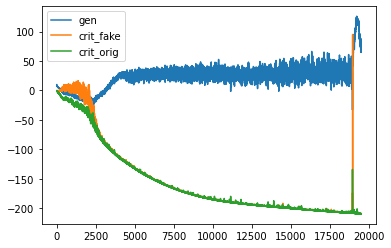

d loss fake  -209.15200805664062
d loss real  -209.35256958007812
[Epoch 57/100] [Batch 201/345] [D loss: -209.252289, acc:   0%] [G loss: 69.537673] [c1: 94.908768, c2: 94.474548, o: 126.712395, f: 88.824585] time: 12:38:56.648834
d loss fake  -208.96566772460938
d loss real  -209.2786865234375
[Epoch 57/100] [Batch 202/345] [D loss: -209.122177, acc:   0%] [G loss: 70.428251] [c1: 94.342155, c2: 93.859619, o: 129.333252, f: 91.700920] time: 12:38:58.936891
d loss fake  -208.928466796875
d loss real  -209.3450927734375
[Epoch 57/100] [Batch 203/345] [D loss: -209.136780, acc:   0%] [G loss: 62.118871] [c1: 84.636444, c2: 84.512375, o: 139.827576, f: 98.640213] time: 12:39:01.217687
d loss fake  -209.08309936523438
d loss real  -209.41839599609375
[Epoch 57/100] [Batch 204/345] [D loss: -209.250748, acc:   0%] [G loss: 60.782031] [c1: 80.015335, c2: 79.923813, o: 121.944916, f: 80.443253] time: 12:39:03.499359
d loss fake  -208.96983337402344
d loss real  -209.4515838623047
[Epoch 57/1

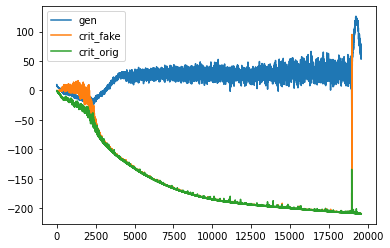

d loss fake  -209.11624145507812
d loss real  -209.02813720703125
[Epoch 57/100] [Batch 251/345] [D loss: -209.072189, acc:   0%] [G loss: 69.503548] [c1: 96.511101, c2: 95.948975, o: 119.901718, f: 86.742096] time: 12:40:52.759643
d loss fake  -208.98883056640625
d loss real  -209.13096618652344
[Epoch 57/100] [Batch 252/345] [D loss: -209.059898, acc:   0%] [G loss: 66.021275] [c1: 89.889297, c2: 89.332848, o: 130.625290, f: 93.383186] time: 12:40:55.047253
d loss fake  -209.0391845703125
d loss real  -209.4760284423828
[Epoch 57/100] [Batch 253/345] [D loss: -209.257607, acc:   0%] [G loss: 62.364132] [c1: 84.763672, c2: 84.777115, o: 131.057434, f: 90.773819] time: 12:40:57.336528
d loss fake  -209.06614685058594
d loss real  -208.9215545654297
[Epoch 57/100] [Batch 254/345] [D loss: -208.993851, acc:   0%] [G loss: 66.206533] [c1: 92.141434, c2: 92.150215, o: 124.898743, f: 88.233551] time: 12:40:59.636749
d loss fake  -209.12149047851562
d loss real  -209.52732849121094
[Epoch 57

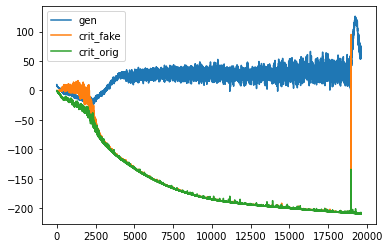

d loss fake  -209.3017578125
d loss real  -209.61062622070312
[Epoch 57/100] [Batch 301/345] [D loss: -209.456192, acc:   0%] [G loss: 66.149716] [c1: 84.767181, c2: 84.697830, o: 138.853378, f: 86.869919] time: 12:42:48.901962
d loss fake  -209.30419921875
d loss real  -209.53457641601562
[Epoch 57/100] [Batch 302/345] [D loss: -209.419388, acc:   0%] [G loss: 65.509251] [c1: 83.044136, c2: 82.981171, o: 133.756531, f: 84.851059] time: 12:42:51.201242
d loss fake  -209.37567138671875
d loss real  -209.57354736328125
[Epoch 57/100] [Batch 303/345] [D loss: -209.474609, acc:   0%] [G loss: 68.557975] [c1: 89.650696, c2: 89.496887, o: 134.567932, f: 85.705338] time: 12:42:53.502033
d loss fake  -209.3082733154297
d loss real  -209.57594299316406
[Epoch 57/100] [Batch 304/345] [D loss: -209.442108, acc:   0%] [G loss: 63.005785] [c1: 83.095009, c2: 83.019928, o: 140.374664, f: 90.347992] time: 12:42:55.792160
d loss fake  -209.38262939453125
d loss real  -209.58804321289062
[Epoch 57/100]

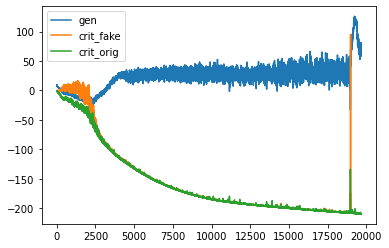

d loss fake  -209.4220733642578
d loss real  -209.62966918945312
[Epoch 58/100] [Batch 1/345] [D loss: -209.525871, acc:   0%] [G loss: 69.919992] [c1: 87.838852, c2: 88.001877, o: 138.416885, f: 82.758392] time: 12:44:24.229350
d loss fake  -209.48678588867188
d loss real  -209.63198852539062
[Epoch 58/100] [Batch 2/345] [D loss: -209.559387, acc:   0%] [G loss: 71.415773] [c1: 91.079544, c2: 91.167053, o: 145.600555, f: 90.317345] time: 12:44:26.572003
d loss fake  -209.37799072265625
d loss real  -209.62423706054688
[Epoch 58/100] [Batch 3/345] [D loss: -209.501114, acc:   0%] [G loss: 70.210231] [c1: 89.314720, c2: 89.048019, o: 138.242157, f: 88.783546] time: 12:44:28.921395
d loss fake  -209.4603271484375
d loss real  -209.61427307128906
[Epoch 58/100] [Batch 4/345] [D loss: -209.537300, acc:   0%] [G loss: 78.899671] [c1: 103.718605, c2: 103.172356, o: 149.609009, f: 96.453110] time: 12:44:31.259952
d loss fake  -209.49600219726562
d loss real  -209.68968200683594
[Epoch 58/100]

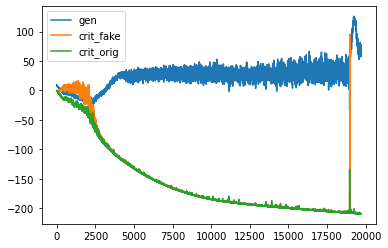

d loss fake  -209.54673767089844
d loss real  -209.73057556152344
[Epoch 58/100] [Batch 51/345] [D loss: -209.638657, acc:   0%] [G loss: 57.753613] [c1: 73.722641, c2: 73.424698, o: 118.883659, f: 72.458000] time: 12:46:19.578413
d loss fake  -209.42581176757812
d loss real  -209.6153564453125
[Epoch 58/100] [Batch 52/345] [D loss: -209.520584, acc:   0%] [G loss: 57.728342] [c1: 74.306839, c2: 73.687119, o: 115.003906, f: 72.030670] time: 12:46:21.859798
d loss fake  -209.50967407226562
d loss real  -209.66123962402344
[Epoch 58/100] [Batch 53/345] [D loss: -209.585457, acc:   0%] [G loss: 61.969584] [c1: 80.504356, c2: 79.815384, o: 122.395935, f: 77.831749] time: 12:46:24.137847
d loss fake  -209.4307098388672
d loss real  -209.71786499023438
[Epoch 58/100] [Batch 54/345] [D loss: -209.574287, acc:   0%] [G loss: 55.749572] [c1: 68.314247, c2: 67.992638, o: 131.030106, f: 74.723160] time: 12:46:26.417680
d loss fake  -209.56509399414062
d loss real  -209.67730712890625
[Epoch 58/10

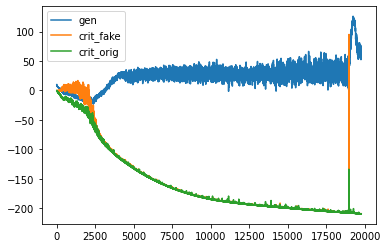

d loss fake  -209.67454528808594
d loss real  -209.8541259765625
[Epoch 58/100] [Batch 101/345] [D loss: -209.764336, acc:   0%] [G loss: 62.859176] [c1: 80.690674, c2: 80.972565, o: 124.135147, f: 72.693268] time: 12:48:15.133852
d loss fake  -209.66893005371094
d loss real  -209.82656860351562
[Epoch 58/100] [Batch 102/345] [D loss: -209.747749, acc:   0%] [G loss: 63.115773] [c1: 77.914185, c2: 78.290756, o: 132.991531, f: 78.951538] time: 12:48:17.407746
d loss fake  -209.65231323242188
d loss real  -209.62112426757812
[Epoch 58/100] [Batch 103/345] [D loss: -209.636719, acc:   0%] [G loss: 63.694693] [c1: 80.537003, c2: 80.752853, o: 128.757050, f: 77.882278] time: 12:48:19.685241
d loss fake  -209.71066284179688
d loss real  -209.7905731201172
[Epoch 58/100] [Batch 104/345] [D loss: -209.750618, acc:   0%] [G loss: 65.078714] [c1: 83.773262, c2: 83.150719, o: 134.446289, f: 79.674103] time: 12:48:21.964743
d loss fake  -209.65267944335938
d loss real  -209.82763671875
[Epoch 58/1

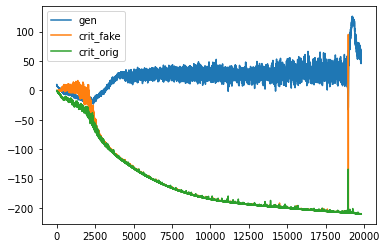

d loss fake  -209.56072998046875
d loss real  -209.67555236816406
[Epoch 58/100] [Batch 151/345] [D loss: -209.618141, acc:   0%] [G loss: 58.309563] [c1: 76.995331, c2: 76.253410, o: 121.749954, f: 79.026993] time: 12:50:10.902037
d loss fake  -209.797607421875
d loss real  -209.95571899414062
[Epoch 58/100] [Batch 152/345] [D loss: -209.876663, acc:   0%] [G loss: 56.148896] [c1: 70.502960, c2: 70.265488, o: 128.435699, f: 74.773216] time: 12:50:13.182793
d loss fake  -209.82850646972656
d loss real  -209.90020751953125
[Epoch 58/100] [Batch 153/345] [D loss: -209.864357, acc:   0%] [G loss: 61.389293] [c1: 75.977837, c2: 75.873642, o: 121.222717, f: 68.440125] time: 12:50:15.448033
d loss fake  -209.79629516601562
d loss real  -209.94363403320312
[Epoch 58/100] [Batch 154/345] [D loss: -209.869965, acc:   0%] [G loss: 67.203323] [c1: 86.080780, c2: 85.627350, o: 132.373962, f: 80.568802] time: 12:50:17.737236
d loss fake  -209.81329345703125
d loss real  -209.6905517578125
[Epoch 58

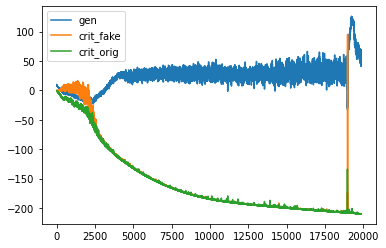

d loss fake  -209.97442626953125
d loss real  -210.0513153076172
[Epoch 58/100] [Batch 201/345] [D loss: -210.012871, acc:   0%] [G loss: 45.454817] [c1: 52.974373, c2: 53.157516, o: 106.917023, f: 54.298355] time: 12:52:05.523707
d loss fake  -209.92953491210938
d loss real  -209.82327270507812
[Epoch 58/100] [Batch 202/345] [D loss: -209.876404, acc:   0%] [G loss: 55.463144] [c1: 68.463776, c2: 68.350525, o: 100.433426, f: 53.355537] time: 12:52:07.809248
d loss fake  -209.89544677734375
d loss real  -210.0716552734375
[Epoch 58/100] [Batch 203/345] [D loss: -209.983551, acc:   0%] [G loss: 51.333185] [c1: 66.564087, c2: 66.383362, o: 119.913681, f: 72.457947] time: 12:52:10.093280
d loss fake  -209.90077209472656
d loss real  -210.00994873046875
[Epoch 58/100] [Batch 204/345] [D loss: -209.955360, acc:   0%] [G loss: 45.836146] [c1: 54.535545, c2: 54.197254, o: 114.177376, f: 63.228096] time: 12:52:12.372915
d loss fake  -209.84324645996094
d loss real  -210.01260375976562
[Epoch 5

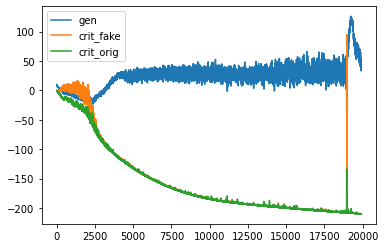

d loss fake  -210.0279083251953
d loss real  -209.97845458984375
[Epoch 58/100] [Batch 251/345] [D loss: -210.003181, acc:   0%] [G loss: 46.148898] [c1: 57.698692, c2: 57.288948, o: 91.962242, f: 50.108910] time: 12:54:01.460077
d loss fake  -210.04957580566406
d loss real  -210.15431213378906
[Epoch 58/100] [Batch 252/345] [D loss: -210.101944, acc:   0%] [G loss: 50.849073] [c1: 66.031998, c2: 64.698776, o: 107.831947, f: 64.723419] time: 12:54:03.735808
d loss fake  -209.98532104492188
d loss real  -209.89675903320312
[Epoch 58/100] [Batch 253/345] [D loss: -209.941040, acc:   0%] [G loss: 49.927149] [c1: 61.118118, c2: 60.618370, o: 101.604904, f: 57.980061] time: 12:54:05.999977
d loss fake  -209.91470336914062
d loss real  -209.9863739013672
[Epoch 58/100] [Batch 254/345] [D loss: -209.950539, acc:   0%] [G loss: 48.047735] [c1: 58.358158, c2: 58.142036, o: 107.834152, f: 61.129852] time: 12:54:08.276295
d loss fake  -210.03262329101562
d loss real  -210.1678924560547
[Epoch 58/

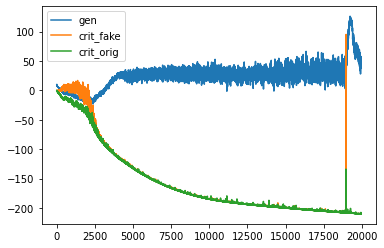

d loss fake  -210.13339233398438
d loss real  -210.2220458984375
[Epoch 58/100] [Batch 301/345] [D loss: -210.177719, acc:   0%] [G loss: 39.986370] [c1: 44.531628, c2: 44.216549, o: 103.900230, f: 49.578583] time: 12:55:57.090356
d loss fake  -210.13978576660156
d loss real  -210.23049926757812
[Epoch 58/100] [Batch 302/345] [D loss: -210.185143, acc:   0%] [G loss: 34.372358] [c1: 36.855728, c2: 36.845970, o: 96.324684, f: 45.554268] time: 12:55:59.390012
d loss fake  -210.12387084960938
d loss real  -210.2294921875
[Epoch 58/100] [Batch 303/345] [D loss: -210.176682, acc:   0%] [G loss: 36.223191] [c1: 38.812840, c2: 38.796280, o: 85.234055, f: 36.626156] time: 12:56:01.670974
d loss fake  -210.14450073242188
d loss real  -210.20193481445312
[Epoch 58/100] [Batch 304/345] [D loss: -210.173218, acc:   0%] [G loss: 31.636179] [c1: 33.493439, c2: 33.094364, o: 88.661385, f: 40.980358] time: 12:56:03.957499
d loss fake  -210.11370849609375
d loss real  -210.18600463867188
[Epoch 58/100]

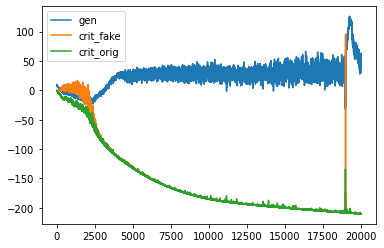

d loss fake  -210.17584228515625
d loss real  -210.2209930419922
[Epoch 59/100] [Batch 1/345] [D loss: -210.198418, acc:   0%] [G loss: 52.692267] [c1: 64.447098, c2: 64.572052, o: 125.453392, f: 72.272316] time: 12:57:32.530567
d loss fake  -210.1612091064453
d loss real  -210.26661682128906
[Epoch 59/100] [Batch 2/345] [D loss: -210.213913, acc:   0%] [G loss: 48.903238] [c1: 56.504028, c2: 56.676430, o: 116.795975, f: 61.825565] time: 12:57:34.839815
d loss fake  -210.17430114746094
d loss real  -210.25743103027344
[Epoch 59/100] [Batch 3/345] [D loss: -210.215866, acc:   0%] [G loss: 47.455133] [c1: 53.458229, c2: 53.586166, o: 110.883713, f: 56.960712] time: 12:57:37.161819
d loss fake  -210.208740234375
d loss real  -210.29415893554688
[Epoch 59/100] [Batch 4/345] [D loss: -210.251450, acc:   0%] [G loss: 51.284730] [c1: 61.396843, c2: 60.838486, o: 105.464844, f: 55.138306] time: 12:57:39.532148
d loss fake  -210.16510009765625
d loss real  -210.30543518066406
[Epoch 59/100] [Ba

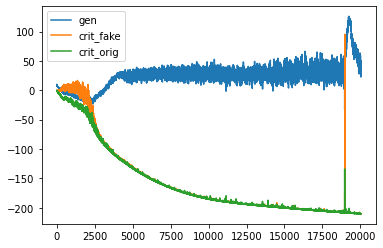

d loss fake  -210.19482421875
d loss real  -210.41635131835938
[Epoch 59/100] [Batch 51/345] [D loss: -210.305588, acc:   0%] [G loss: 34.814741] [c1: 33.294949, c2: 33.267143, o: 99.033607, f: 46.405037] time: 12:59:27.736225
d loss fake  -210.25645446777344
d loss real  -210.40432739257812
[Epoch 59/100] [Batch 52/345] [D loss: -210.330391, acc:   0%] [G loss: 33.501074] [c1: 35.767609, c2: 35.654404, o: 81.134476, f: 34.224373] time: 12:59:30.025304
d loss fake  -210.2970428466797
d loss real  -210.40789794921875
[Epoch 59/100] [Batch 53/345] [D loss: -210.352470, acc:   0%] [G loss: 35.077283] [c1: 37.872444, c2: 37.280422, o: 84.075760, f: 35.582272] time: 12:59:32.318141
d loss fake  -210.2957763671875
d loss real  -210.4257354736328
[Epoch 59/100] [Batch 54/345] [D loss: -210.360756, acc:   0%] [G loss: 37.893673] [c1: 40.433350, c2: 39.966003, o: 91.267410, f: 39.989429] time: 12:59:34.603527
d loss fake  -209.90921020507812
d loss real  -210.20721435546875
[Epoch 59/100] [Batc

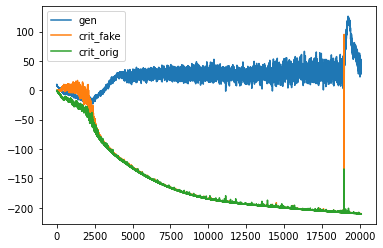

d loss fake  -210.39910888671875
d loss real  -210.49569702148438
[Epoch 59/100] [Batch 101/345] [D loss: -210.447403, acc:   0%] [G loss: 41.906641] [c1: 47.602551, c2: 46.881504, o: 89.878281, f: 42.847977] time: 13:01:24.079834
d loss fake  -210.36306762695312
d loss real  -210.47061157226562
[Epoch 59/100] [Batch 102/345] [D loss: -210.416840, acc:   0%] [G loss: 42.827291] [c1: 48.606243, c2: 48.845249, o: 96.703247, f: 46.130432] time: 13:01:26.380347
d loss fake  -210.35305786132812
d loss real  -210.30084228515625
[Epoch 59/100] [Batch 103/345] [D loss: -210.326950, acc:   0%] [G loss: 43.888178] [c1: 47.390537, c2: 47.429127, o: 98.922157, f: 45.203598] time: 13:01:28.669493
d loss fake  -210.37039184570312
d loss real  -210.48544311523438
[Epoch 59/100] [Batch 104/345] [D loss: -210.427917, acc:   0%] [G loss: 41.511197] [c1: 46.819786, c2: 46.639145, o: 105.078857, f: 49.047592] time: 13:01:30.965115
d loss fake  -210.29966735839844
d loss real  -210.50320434570312
[Epoch 59

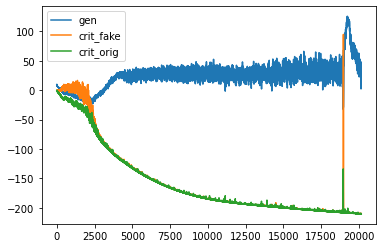

d loss fake  -210.39828491210938
d loss real  -210.57269287109375
[Epoch 59/100] [Batch 151/345] [D loss: -210.485489, acc:   0%] [G loss: 18.808079] [c1: 7.629396, c2: 7.230370, o: 57.841309, f: 8.941803] time: 13:03:20.295261
d loss fake  -210.34780883789062
d loss real  -210.38726806640625
[Epoch 59/100] [Batch 152/345] [D loss: -210.367538, acc:   0%] [G loss: 22.561124] [c1: 16.458649, c2: 15.885857, o: 51.669250, f: 6.972821] time: 13:03:22.587629
d loss fake  -210.39700317382812
d loss real  -210.57421875
[Epoch 59/100] [Batch 153/345] [D loss: -210.485611, acc:   0%] [G loss: 28.011952] [c1: 22.860210, c2: 22.839254, o: 67.259621, f: 17.836975] time: 13:03:24.868237
d loss fake  -210.29830932617188
d loss real  -210.5684356689453
[Epoch 59/100] [Batch 154/345] [D loss: -210.433372, acc:   0%] [G loss: 21.727054] [c1: 10.646221, c2: 10.934608, o: 71.937950, f: 19.824408] time: 13:03:27.162127
d loss fake  -210.14808654785156
d loss real  -210.60752868652344
[Epoch 59/100] [Batch

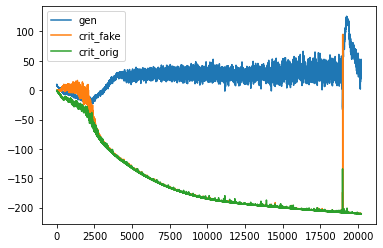

d loss fake  -210.511474609375
d loss real  -210.65911865234375
[Epoch 59/100] [Batch 201/345] [D loss: -210.585297, acc:   0%] [G loss: 29.261747] [c1: 22.755424, c2: 22.292938, o: 70.364517, f: 20.468094] time: 13:05:15.622173
d loss fake  -210.41400146484375
d loss real  -210.64633178710938
[Epoch 59/100] [Batch 202/345] [D loss: -210.530167, acc:   0%] [G loss: 47.913855] [c1: 55.497963, c2: 54.763275, o: 74.395691, f: 30.454958] time: 13:05:17.911738
d loss fake  -210.51470947265625
d loss real  -210.67750549316406
[Epoch 59/100] [Batch 203/345] [D loss: -210.596107, acc:   0%] [G loss: 42.991903] [c1: 41.769192, c2: 41.581154, o: 103.015900, f: 50.574371] time: 13:05:20.192572
d loss fake  -210.31466674804688
d loss real  -210.6009979248047
[Epoch 59/100] [Batch 204/345] [D loss: -210.457832, acc:   0%] [G loss: 25.532585] [c1: 14.324752, c2: 14.623615, o: 93.121140, f: 38.580273] time: 13:05:22.479915
d loss fake  -210.46441650390625
d loss real  -210.6326904296875
[Epoch 59/100

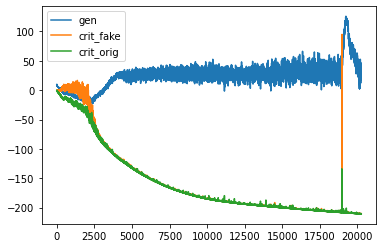

d loss fake  -210.61441040039062
d loss real  -210.75576782226562
[Epoch 59/100] [Batch 251/345] [D loss: -210.685089, acc:   0%] [G loss: 20.014720] [c1: 8.370676, c2: 7.877136, o: 45.182129, f: -1.786146] time: 13:07:11.931742
d loss fake  -210.50146484375
d loss real  -210.63796997070312
[Epoch 59/100] [Batch 252/345] [D loss: -210.569717, acc:   0%] [G loss: 36.105977] [c1: 33.223740, c2: 32.295902, o: 54.228062, f: 10.891598] time: 13:07:14.223954
d loss fake  -210.6393585205078
d loss real  -210.76927185058594
[Epoch 59/100] [Batch 253/345] [D loss: -210.704315, acc:   0%] [G loss: 35.723955] [c1: 31.181368, c2: 30.408333, o: 78.950600, f: 32.204578] time: 13:07:16.501360
d loss fake  -209.51980590820312
d loss real  -210.70254516601562
[Epoch 59/100] [Batch 254/345] [D loss: -210.111176, acc:   0%] [G loss: 15.311933] [c1: -1.004238, c2: -1.023810, o: 78.698456, f: 27.751429] time: 13:07:18.800562
d loss fake  -209.3557891845703
d loss real  -210.73858642578125
[Epoch 59/100] [B

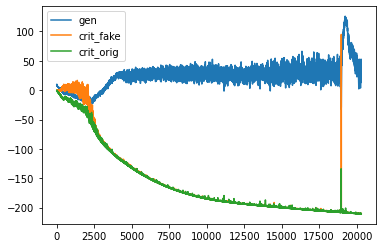

d loss fake  -210.66314697265625
d loss real  -210.5208740234375
[Epoch 59/100] [Batch 301/345] [D loss: -210.592010, acc:   0%] [G loss: 38.215482] [c1: 32.187534, c2: 31.646217, o: 80.758537, f: 28.866457] time: 13:09:08.094004
d loss fake  -210.67221069335938
d loss real  -210.76004028320312
[Epoch 59/100] [Batch 302/345] [D loss: -210.716125, acc:   0%] [G loss: 41.474716] [c1: 37.539032, c2: 37.185143, o: 87.069618, f: 32.107578] time: 13:09:10.406562
d loss fake  -209.8446044921875
d loss real  -210.82754516601562
[Epoch 59/100] [Batch 303/345] [D loss: -210.336075, acc:   0%] [G loss: 25.286796] [c1: 11.342514, c2: 11.290350, o: 90.677193, f: 35.335484] time: 13:09:12.694441
d loss fake  -210.667724609375
d loss real  -210.76683044433594
[Epoch 59/100] [Batch 304/345] [D loss: -210.717278, acc:   0%] [G loss: 30.359312] [c1: 19.201818, c2: 18.789879, o: 66.777519, f: 12.970831] time: 13:09:14.978651
d loss fake  -210.6288299560547
d loss real  -210.83932495117188
[Epoch 59/100] 

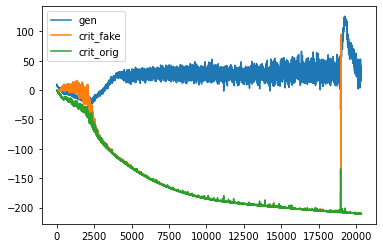

d loss fake  -210.38983154296875
d loss real  -210.83047485351562
[Epoch 60/100] [Batch 1/345] [D loss: -210.610153, acc:   0%] [G loss: 16.950760] [c1: -1.354293, c2: -1.716020, o: 70.885574, f: 16.343906] time: 13:10:43.435106
d loss fake  -210.34088134765625
d loss real  -210.89239501953125
[Epoch 60/100] [Batch 2/345] [D loss: -210.616638, acc:   0%] [G loss: 7.497765] [c1: -17.248596, c2: -17.172028, o: 50.870537, f: -4.216961] time: 13:10:45.786509
d loss fake  -210.5674591064453
d loss real  -210.8936004638672
[Epoch 60/100] [Batch 3/345] [D loss: -210.730530, acc:   0%] [G loss: 9.236820] [c1: -13.009554, c2: -13.345903, o: 34.761124, f: -16.018021] time: 13:10:48.160957
d loss fake  -210.69036865234375
d loss real  -210.8756103515625
[Epoch 60/100] [Batch 4/345] [D loss: -210.782990, acc:   0%] [G loss: 9.081198] [c1: -10.252055, c2: -10.675087, o: 40.511963, f: -8.526235] time: 13:10:50.535726
d loss fake  -210.73094177246094
d loss real  -210.80093383789062
[Epoch 60/100] [B

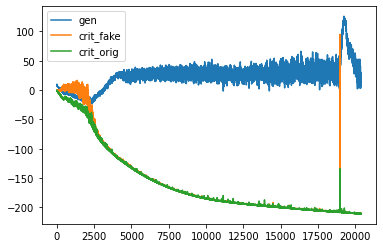

d loss fake  -210.77444458007812
d loss real  -210.9217987060547
[Epoch 60/100] [Batch 51/345] [D loss: -210.848122, acc:   0%] [G loss: 9.493397] [c1: -10.078117, c2: -10.291939, o: 32.709160, f: -13.766652] time: 13:12:39.013982
d loss fake  -210.76803588867188
d loss real  -210.8370361328125
[Epoch 60/100] [Batch 52/345] [D loss: -210.802536, acc:   0%] [G loss: 15.147092] [c1: -2.973930, c2: -3.631289, o: 35.494381, f: -14.414558] time: 13:12:41.311424
d loss fake  -210.75909423828125
d loss real  -210.95396423339844
[Epoch 60/100] [Batch 53/345] [D loss: -210.856529, acc:   0%] [G loss: 18.084852] [c1: 1.128222, c2: 0.676703, o: 47.425709, f: -2.960911] time: 13:12:43.598119
d loss fake  -210.70079040527344
d loss real  -210.7982177734375
[Epoch 60/100] [Batch 54/345] [D loss: -210.749504, acc:   0%] [G loss: 19.389821] [c1: 2.886158, c2: 2.908326, o: 51.529495, f: 0.010694] time: 13:12:45.874602
d loss fake  -209.27630615234375
d loss real  -210.918212890625
[Epoch 60/100] [Batch

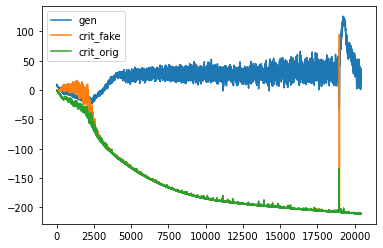

d loss fake  -210.8155059814453
d loss real  -211.09027099609375
[Epoch 60/100] [Batch 101/345] [D loss: -210.952888, acc:   0%] [G loss: 14.376031] [c1: -7.166819, c2: -7.164868, o: 54.954601, f: -0.308277] time: 13:14:35.182649
d loss fake  -210.90328979492188
d loss real  -211.06663513183594
[Epoch 60/100] [Batch 102/345] [D loss: -210.984962, acc:   0%] [G loss: 19.114972] [c1: 2.906768, c2: 2.505974, o: 44.454956, f: -2.707168] time: 13:14:37.471816
d loss fake  -210.90707397460938
d loss real  -211.0467071533203
[Epoch 60/100] [Batch 103/345] [D loss: -210.976891, acc:   0%] [G loss: 14.877887] [c1: -2.016956, c2: -2.009923, o: 48.727318, f: 1.487085] time: 13:14:39.763684
d loss fake  -210.83444213867188
d loss real  -211.07012939453125
[Epoch 60/100] [Batch 104/345] [D loss: -210.952286, acc:   0%] [G loss: 14.568542] [c1: -4.751429, c2: -4.820372, o: 45.144768, f: -3.133561] time: 13:14:42.057987
d loss fake  -210.9234619140625
d loss real  -211.08499145507812
[Epoch 60/100] [

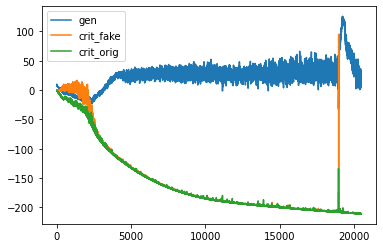

d loss fake  -210.90794372558594
d loss real  -211.0040283203125
[Epoch 60/100] [Batch 151/345] [D loss: -210.955986, acc:   0%] [G loss: 13.384164] [c1: -10.942404, c2: -10.659855, o: 30.515167, f: -20.753721] time: 13:16:31.602179
d loss fake  -210.9268035888672
d loss real  -211.1667938232422
[Epoch 60/100] [Batch 152/345] [D loss: -211.046799, acc:   0%] [G loss: 11.103722] [c1: -14.593142, c2: -14.869373, o: 41.741310, f: -13.289834] time: 13:16:33.896145
d loss fake  -210.56817626953125
d loss real  -211.08119201660156
[Epoch 60/100] [Batch 153/345] [D loss: -210.824684, acc:   0%] [G loss: 10.253344] [c1: -15.735315, c2: -16.161232, o: 37.402653, f: -14.952271] time: 13:16:36.173738
d loss fake  -210.97506713867188
d loss real  -211.12472534179688
[Epoch 60/100] [Batch 154/345] [D loss: -211.049896, acc:   0%] [G loss: 23.122157] [c1: 6.677111, c2: 5.855438, o: 41.084221, f: -7.875557] time: 13:16:38.469023
d loss fake  -210.56317138671875
d loss real  -210.96792602539062
[Epoch

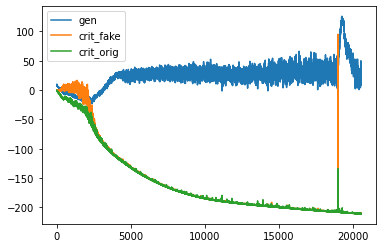

d loss fake  -211.02285766601562
d loss real  -210.9499053955078
[Epoch 60/100] [Batch 201/345] [D loss: -210.986382, acc:   0%] [G loss: 35.079564] [c1: 22.742760, c2: 22.619801, o: 68.047424, f: 13.402382] time: 13:18:26.784777
d loss fake  -211.0006561279297
d loss real  -211.0030059814453
[Epoch 60/100] [Batch 202/345] [D loss: -211.001831, acc:   0%] [G loss: 34.981524] [c1: 23.129539, c2: 22.843342, o: 76.473976, f: 21.943645] time: 13:18:29.071967
d loss fake  -211.0491485595703
d loss real  -211.20330810546875
[Epoch 60/100] [Batch 203/345] [D loss: -211.126228, acc:   0%] [G loss: 25.498459] [c1: 9.734254, c2: 9.396036, o: 78.293060, f: 25.052513] time: 13:18:31.353688
d loss fake  -210.5538330078125
d loss real  -211.17921447753906
[Epoch 60/100] [Batch 204/345] [D loss: -210.866524, acc:   0%] [G loss: 9.629544] [c1: -14.152786, c2: -14.082929, o: 60.324455, f: 8.753356] time: 13:18:33.651256
d loss fake  -210.86276245117188
d loss real  -211.2563018798828
[Epoch 60/100] [Ba

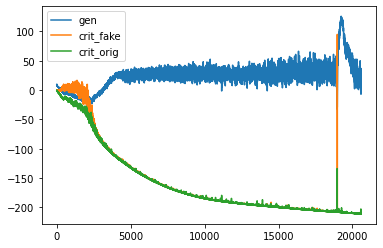

d loss fake  -211.05238342285156
d loss real  -211.18885803222656
[Epoch 60/100] [Batch 251/345] [D loss: -211.120621, acc:   0%] [G loss: 16.671836] [c1: -8.029146, c2: -8.772479, o: 29.019016, f: -18.898506] time: 13:20:23.198488
d loss fake  -208.54660034179688
d loss real  -211.05633544921875
[Epoch 60/100] [Batch 252/345] [D loss: -209.801468, acc:   0%] [G loss: 6.136030] [c1: -19.450121, c2: -19.630356, o: 41.177780, f: -5.832682] time: 13:20:25.494115
d loss fake  -210.92706298828125
d loss real  -211.25320434570312
[Epoch 60/100] [Batch 253/345] [D loss: -211.090134, acc:   0%] [G loss: 4.148200] [c1: -22.367268, c2: -22.424124, o: 25.873365, f: -24.292255] time: 13:20:27.780910
d loss fake  -210.83718872070312
d loss real  -211.00601196289062
[Epoch 60/100] [Batch 254/345] [D loss: -210.921600, acc:   0%] [G loss: 9.624152] [c1: -12.136089, c2: -12.791428, o: 27.118458, f: -21.127090] time: 13:20:30.071041
d loss fake  -211.0015411376953
d loss real  -211.2723388671875
[Epoch

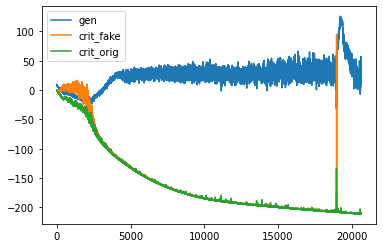

d loss fake  -211.18353271484375
d loss real  -209.319580078125
[Epoch 60/100] [Batch 301/345] [D loss: -210.251556, acc:   0%] [G loss: 44.213484] [c1: 39.031487, c2: 38.815266, o: 68.442139, f: 20.960083] time: 13:22:19.207262
d loss fake  -211.1709747314453
d loss real  -211.28958129882812
[Epoch 60/100] [Batch 302/345] [D loss: -211.230278, acc:   0%] [G loss: 32.745367] [c1: 21.201393, c2: 20.895706, o: 89.845467, f: 39.493183] time: 13:22:21.497380
d loss fake  -211.1054229736328
d loss real  -211.32937622070312
[Epoch 60/100] [Batch 303/345] [D loss: -211.217400, acc:   0%] [G loss: 21.124590] [c1: -0.346285, c2: -0.840167, o: 71.919571, f: 19.830885] time: 13:22:23.781418
d loss fake  -211.16238403320312
d loss real  -211.14935302734375
[Epoch 60/100] [Batch 304/345] [D loss: -211.155869, acc:   0%] [G loss: 25.310067] [c1: 11.070174, c2: 10.668914, o: 48.319550, f: 2.560976] time: 13:22:26.077830
d loss fake  -211.20156860351562
d loss real  -211.3235321044922
[Epoch 60/100] [

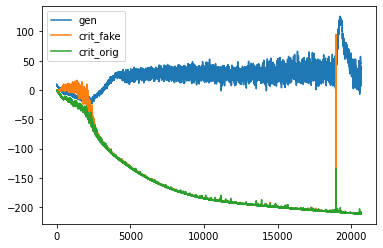

d loss fake  -211.14190673828125
d loss real  -211.25888061523438
[Epoch 61/100] [Batch 1/345] [D loss: -211.200394, acc:   0%] [G loss: 25.495103] [c1: 3.960638, c2: 4.557180, o: 63.351715, f: 8.197985] time: 13:23:55.081358
d loss fake  -211.22134399414062
d loss real  -211.26596069335938
[Epoch 61/100] [Batch 2/345] [D loss: -211.243652, acc:   0%] [G loss: 26.044383] [c1: 10.749815, c2: 10.527345, o: 61.823227, f: 7.713744] time: 13:23:57.412818
d loss fake  -211.11468505859375
d loss real  -211.3926239013672
[Epoch 61/100] [Batch 3/345] [D loss: -211.253654, acc:   0%] [G loss: 20.559664] [c1: 0.699394, c2: -0.239436, o: 60.313335, f: 8.874695] time: 13:23:59.764197
d loss fake  -211.2378387451172
d loss real  -211.40069580078125
[Epoch 61/100] [Batch 4/345] [D loss: -211.319267, acc:   0%] [G loss: 24.963208] [c1: 9.989145, c2: 8.986195, o: 53.317390, f: 1.377916] time: 13:24:02.109788
d loss fake  -211.20094299316406
d loss real  -211.35321044921875
[Epoch 61/100] [Batch 5/345] 

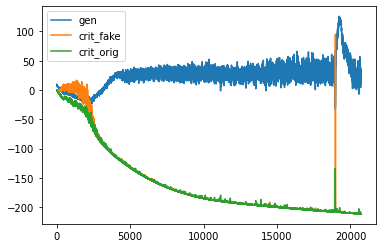

d loss fake  -211.33274841308594
d loss real  -211.45248413085938
[Epoch 61/100] [Batch 51/345] [D loss: -211.392616, acc:   0%] [G loss: 31.624537] [c1: 19.650776, c2: 19.143591, o: 55.667255, f: 5.442482] time: 13:25:50.420300
d loss fake  -211.27078247070312
d loss real  -211.48849487304688
[Epoch 61/100] [Batch 52/345] [D loss: -211.379639, acc:   0%] [G loss: 19.326404] [c1: -0.815334, c2: -1.105794, o: 68.951096, f: 14.957198] time: 13:25:52.715416
d loss fake  -211.34959411621094
d loss real  -211.41238403320312
[Epoch 61/100] [Batch 53/345] [D loss: -211.380989, acc:   0%] [G loss: 38.424601] [c1: 30.379993, c2: 29.771856, o: 50.958710, f: 3.689041] time: 13:25:55.004100
d loss fake  -211.2366180419922
d loss real  -211.4972686767578
[Epoch 61/100] [Batch 54/345] [D loss: -211.366943, acc:   0%] [G loss: 47.572118] [c1: 44.080734, c2: 43.499916, o: 80.194748, f: 31.201687] time: 13:25:57.293075
d loss fake  -211.39151000976562
d loss real  -211.55874633789062
[Epoch 61/100] [Ba

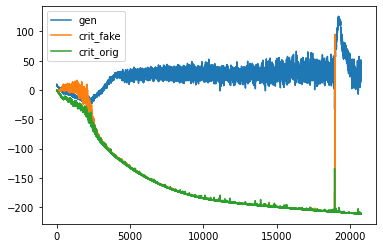

d loss fake  -211.49359130859375
d loss real  -211.62112426757812
[Epoch 61/100] [Batch 101/345] [D loss: -211.557358, acc:   0%] [G loss: 31.747893] [c1: 19.682367, c2: 19.367367, o: 74.972015, f: 22.269878] time: 13:27:46.740980
d loss fake  -211.46347045898438
d loss real  -211.3660430908203
[Epoch 61/100] [Batch 102/345] [D loss: -211.414757, acc:   0%] [G loss: 36.448334] [c1: 23.213203, c2: 23.059584, o: 70.725983, f: 15.808226] time: 13:27:49.034842
d loss fake  -211.4845428466797
d loss real  -211.58819580078125
[Epoch 61/100] [Batch 103/345] [D loss: -211.536369, acc:   0%] [G loss: 37.386834] [c1: 27.964973, c2: 27.866016, o: 83.261810, f: 28.083210] time: 13:27:51.317799
d loss fake  -211.47039794921875
d loss real  -211.49154663085938
[Epoch 61/100] [Batch 104/345] [D loss: -211.480972, acc:   0%] [G loss: 44.199517] [c1: 38.712227, c2: 38.683907, o: 81.104904, f: 26.500221] time: 13:27:53.604842
d loss fake  -211.4902801513672
d loss real  -211.63455200195312
[Epoch 61/100

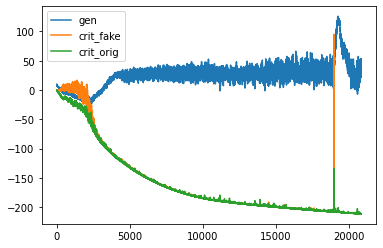

d loss fake  -211.5881805419922
d loss real  -211.733154296875
[Epoch 61/100] [Batch 151/345] [D loss: -211.660667, acc:   0%] [G loss: 36.707503] [c1: 24.561493, c2: 24.429337, o: 87.486862, f: 36.256027] time: 13:29:42.919772
d loss fake  -211.55191040039062
d loss real  -211.6990203857422
[Epoch 61/100] [Batch 152/345] [D loss: -211.625465, acc:   0%] [G loss: 31.908426] [c1: 18.382523, c2: 18.196085, o: 78.996124, f: 26.368233] time: 13:29:45.215477
d loss fake  -211.60870361328125
d loss real  -211.74990844726562
[Epoch 61/100] [Batch 153/345] [D loss: -211.679306, acc:   0%] [G loss: 31.374668] [c1: 14.102926, c2: 13.673983, o: 70.160957, f: 13.914152] time: 13:29:47.495622
d loss fake  -211.56094360351562
d loss real  -211.70941162109375
[Epoch 61/100] [Batch 154/345] [D loss: -211.635178, acc:   0%] [G loss: 36.420626] [c1: 26.335102, c2: 25.847958, o: 68.599541, f: 18.781353] time: 13:29:49.789255
d loss fake  -211.61044311523438
d loss real  -211.680908203125
[Epoch 61/100] [

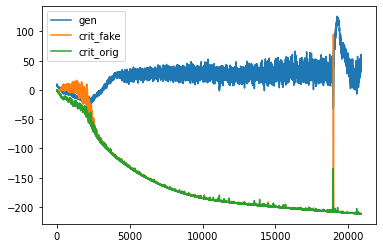

d loss fake  -211.6584930419922
d loss real  -211.84112548828125
[Epoch 61/100] [Batch 201/345] [D loss: -211.749809, acc:   0%] [G loss: 33.317076] [c1: 20.127184, c2: 19.809959, o: 72.644615, f: 23.295702] time: 13:31:38.147027
d loss fake  -211.69137573242188
d loss real  -211.7529754638672
[Epoch 61/100] [Batch 202/345] [D loss: -211.722176, acc:   0%] [G loss: 35.034506] [c1: 21.890839, c2: 21.733677, o: 70.879944, f: 19.137005] time: 13:31:40.434304
d loss fake  -211.697021484375
d loss real  -211.688232421875
[Epoch 61/100] [Batch 203/345] [D loss: -211.692627, acc:   0%] [G loss: 38.872500] [c1: 28.185280, c2: 28.187355, o: 74.755676, f: 20.953579] time: 13:31:42.719204
d loss fake  -211.70062255859375
d loss real  -211.76834106445312
[Epoch 61/100] [Batch 204/345] [D loss: -211.734482, acc:   0%] [G loss: 37.652256] [c1: 28.027760, c2: 27.848362, o: 82.874153, f: 31.581038] time: 13:31:45.009527
d loss fake  -211.74295043945312
d loss real  -211.79405212402344
[Epoch 61/100] [

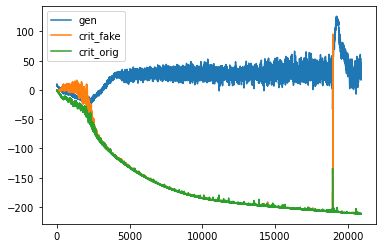

d loss fake  -211.73495483398438
d loss real  -211.47784423828125
[Epoch 61/100] [Batch 251/345] [D loss: -211.606400, acc:   0%] [G loss: 43.389467] [c1: 31.302959, c2: 30.537880, o: 74.989975, f: 21.921982] time: 13:33:34.313412
d loss fake  -211.27734375
d loss real  -211.64700317382812
[Epoch 61/100] [Batch 252/345] [D loss: -211.462173, acc:   0%] [G loss: 37.427237] [c1: 19.281153, c2: 19.049351, o: 87.436600, f: 27.225384] time: 13:33:36.599525
d loss fake  -211.24111938476562
d loss real  -211.90032958984375
[Epoch 61/100] [Batch 253/345] [D loss: -211.570724, acc:   0%] [G loss: 21.762114] [c1: -3.849844, c2: -3.402508, o: 79.979073, f: 18.494934] time: 13:33:38.889979
d loss fake  -211.6748046875
d loss real  -211.90548706054688
[Epoch 61/100] [Batch 254/345] [D loss: -211.790146, acc:   0%] [G loss: 19.260451] [c1: -7.726906, c2: -7.176229, o: 55.606289, f: -2.044170] time: 13:33:41.196446
d loss fake  -211.7577667236328
d loss real  -211.85227966308594
[Epoch 61/100] [Batch

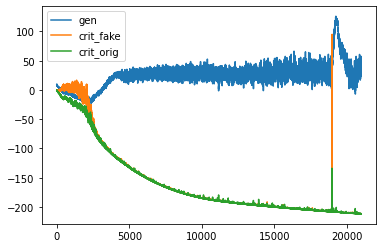

d loss fake  -211.83572387695312
d loss real  -211.7921905517578
[Epoch 61/100] [Batch 301/345] [D loss: -211.813957, acc:   0%] [G loss: 36.581002] [c1: 21.121120, c2: 21.086477, o: 69.374054, f: 17.073641] time: 13:35:30.747059
d loss fake  -211.87442016601562
d loss real  -211.47381591796875
[Epoch 61/100] [Batch 302/345] [D loss: -211.674118, acc:   0%] [G loss: 44.518671] [c1: 35.060539, c2: 34.602058, o: 74.466248, f: 20.298063] time: 13:35:33.039173
d loss fake  -211.85174560546875
d loss real  -211.93292236328125
[Epoch 61/100] [Batch 303/345] [D loss: -211.892334, acc:   0%] [G loss: 32.602202] [c1: 15.443232, c2: 15.407053, o: 92.202469, f: 33.159119] time: 13:35:35.324550
d loss fake  -211.72756958007812
d loss real  -211.84255981445312
[Epoch 61/100] [Batch 304/345] [D loss: -211.785065, acc:   0%] [G loss: 36.637722] [c1: 20.337637, c2: 20.601761, o: 71.973511, f: 16.940336] time: 13:35:37.616469
d loss fake  -211.91673278808594
d loss real  -212.0064697265625
[Epoch 61/10

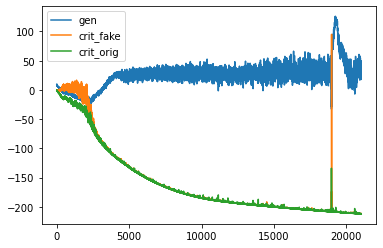

d loss fake  -211.83963012695312
d loss real  -211.86782836914062
[Epoch 62/100] [Batch 1/345] [D loss: -211.853729, acc:   0%] [G loss: 31.258258] [c1: 13.598866, c2: 13.299653, o: 58.118263, f: 2.567803] time: 13:37:06.036571
d loss fake  -211.67300415039062
d loss real  -212.03106689453125
[Epoch 62/100] [Batch 2/345] [D loss: -211.852036, acc:   0%] [G loss: 26.427477] [c1: 6.819661, c2: 6.525364, o: 70.367798, f: 14.241476] time: 13:37:08.375599
d loss fake  -211.91014099121094
d loss real  -212.0067138671875
[Epoch 62/100] [Batch 3/345] [D loss: -211.958427, acc:   0%] [G loss: 37.769278] [c1: 23.911579, c2: 23.428328, o: 63.614410, f: 8.888874] time: 13:37:10.749889
d loss fake  -211.91384887695312
d loss real  -211.97129821777344
[Epoch 62/100] [Batch 4/345] [D loss: -211.942574, acc:   0%] [G loss: 42.285633] [c1: 30.801437, c2: 30.656796, o: 77.239883, f: 23.982349] time: 13:37:13.090161
d loss fake  -211.82879638671875
d loss real  -211.92926025390625
[Epoch 62/100] [Batch 5

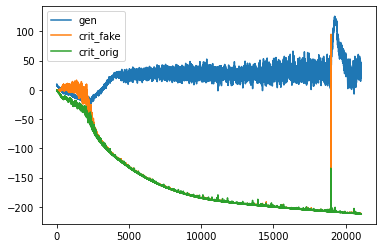

d loss fake  -212.01638793945312
d loss real  -212.11419677734375
[Epoch 62/100] [Batch 51/345] [D loss: -212.065292, acc:   0%] [G loss: 35.148830] [c1: 20.266560, c2: 20.289915, o: 67.094543, f: 10.108697] time: 13:39:01.573782
d loss fake  -211.89749145507812
d loss real  -212.1453857421875
[Epoch 62/100] [Batch 52/345] [D loss: -212.021439, acc:   0%] [G loss: 27.982930] [c1: 8.832151, c2: 8.698219, o: 77.517776, f: 22.287552] time: 13:39:03.854147
d loss fake  -212.04830932617188
d loss real  -211.9289093017578
[Epoch 62/100] [Batch 53/345] [D loss: -211.988609, acc:   0%] [G loss: 37.500836] [c1: 24.335815, c2: 23.510523, o: 64.456108, f: 10.436151] time: 13:39:06.136672
d loss fake  -211.02183532714844
d loss real  -212.04339599609375
[Epoch 62/100] [Batch 54/345] [D loss: -211.532616, acc:   0%] [G loss: 25.890985] [c1: 4.394183, c2: 4.416519, o: 82.627441, f: 22.686909] time: 13:39:08.411377
d loss fake  -210.99440002441406
d loss real  -211.57293701171875
[Epoch 62/100] [Batc

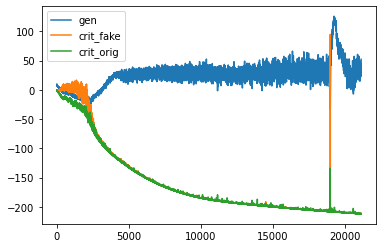

d loss fake  -212.09872436523438
d loss real  -212.20272827148438
[Epoch 62/100] [Batch 101/345] [D loss: -212.150726, acc:   0%] [G loss: 45.201424] [c1: 32.346451, c2: 32.285446, o: 105.893707, f: 43.827374] time: 13:40:57.504872
d loss fake  -212.0978546142578
d loss real  -212.2358856201172
[Epoch 62/100] [Batch 102/345] [D loss: -212.166870, acc:   0%] [G loss: 37.585657] [c1: 24.800138, c2: 24.573320, o: 94.338791, f: 33.666237] time: 13:40:59.788186
d loss fake  -212.12265014648438
d loss real  -212.17880249023438
[Epoch 62/100] [Batch 103/345] [D loss: -212.150726, acc:   0%] [G loss: 30.353260] [c1: 13.993768, c2: 13.690789, o: 87.739517, f: 27.404789] time: 13:41:02.062935
d loss fake  -212.11203002929688
d loss real  -212.24098205566406
[Epoch 62/100] [Batch 104/345] [D loss: -212.176506, acc:   0%] [G loss: 30.333226] [c1: 11.684448, c2: 11.792952, o: 69.959175, f: 11.655099] time: 13:41:04.352451
d loss fake  -212.11544799804688
d loss real  -212.0125732421875
[Epoch 62/10

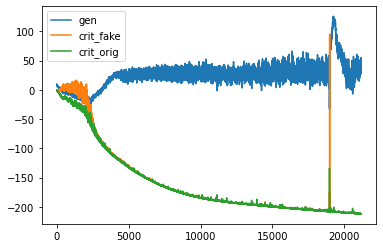

d loss fake  -212.14466857910156
d loss real  -212.31094360351562
[Epoch 62/100] [Batch 151/345] [D loss: -212.227806, acc:   0%] [G loss: 25.864585] [c1: 3.049517, c2: 2.801206, o: 63.124886, f: 4.606278] time: 13:42:53.858943
d loss fake  -211.75595092773438
d loss real  -212.14569091796875
[Epoch 62/100] [Batch 152/345] [D loss: -211.950821, acc:   0%] [G loss: 26.730179] [c1: 2.512244, c2: 2.406971, o: 60.830460, f: 5.157511] time: 13:42:56.163659
d loss fake  -212.19338989257812
d loss real  -212.30191040039062
[Epoch 62/100] [Batch 153/345] [D loss: -212.247650, acc:   0%] [G loss: 26.796305] [c1: 6.528071, c2: 6.853415, o: 61.964745, f: 4.561677] time: 13:42:58.460221
d loss fake  -212.17210388183594
d loss real  -212.08331298828125
[Epoch 62/100] [Batch 154/345] [D loss: -212.127708, acc:   0%] [G loss: 33.582547] [c1: 15.860531, c2: 15.562489, o: 59.848255, f: 6.438531] time: 13:43:00.750628
d loss fake  -212.22103881835938
d loss real  -212.2755126953125
[Epoch 62/100] [Batch

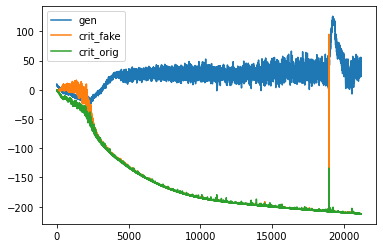

d loss fake  -212.33026123046875
d loss real  -212.38125610351562
[Epoch 62/100] [Batch 201/345] [D loss: -212.355759, acc:   0%] [G loss: 49.563345] [c1: 44.184875, c2: 44.194088, o: 95.041763, f: 42.228249] time: 13:44:49.200401
d loss fake  -212.32115173339844
d loss real  -212.40081787109375
[Epoch 62/100] [Batch 202/345] [D loss: -212.360985, acc:   0%] [G loss: 52.826757] [c1: 45.617760, c2: 45.665730, o: 96.715805, f: 44.207329] time: 13:44:51.509609
d loss fake  -212.34988403320312
d loss real  -212.42298889160156
[Epoch 62/100] [Batch 203/345] [D loss: -212.386436, acc:   0%] [G loss: 48.429357] [c1: 41.337997, c2: 41.276348, o: 99.347946, f: 45.940872] time: 13:44:53.800824
d loss fake  -212.26364135742188
d loss real  -212.4061279296875
[Epoch 62/100] [Batch 204/345] [D loss: -212.334885, acc:   0%] [G loss: 35.224642] [c1: 20.085152, c2: 19.941521, o: 93.633728, f: 40.323593] time: 13:44:56.106669
d loss fake  -212.31906127929688
d loss real  -212.08169555664062
[Epoch 62/1

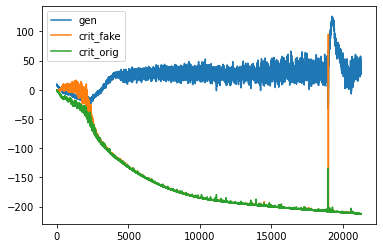

d loss fake  -212.35684204101562
d loss real  -212.40338134765625
[Epoch 62/100] [Batch 251/345] [D loss: -212.380112, acc:   0%] [G loss: 52.644795] [c1: 41.751030, c2: 41.616985, o: 95.127235, f: 36.436302] time: 13:46:45.786302
d loss fake  -212.39205932617188
d loss real  -212.40785217285156
[Epoch 62/100] [Batch 252/345] [D loss: -212.399956, acc:   0%] [G loss: 50.631665] [c1: 40.550499, c2: 40.602131, o: 100.137939, f: 42.098999] time: 13:46:48.086226
d loss fake  -212.37864685058594
d loss real  -212.48245239257812
[Epoch 62/100] [Batch 253/345] [D loss: -212.430550, acc:   0%] [G loss: 47.451695] [c1: 36.997280, c2: 36.680923, o: 98.332962, f: 41.303085] time: 13:46:50.361993
d loss fake  -212.39857482910156
d loss real  -212.44677734375
[Epoch 62/100] [Batch 254/345] [D loss: -212.422676, acc:   0%] [G loss: 37.908794] [c1: 22.169151, c2: 22.214020, o: 90.803482, f: 36.345650] time: 13:46:52.654925
d loss fake  -212.14337158203125
d loss real  -212.48194885253906
[Epoch 62/10

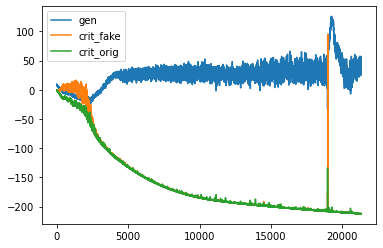

d loss fake  -212.4803466796875
d loss real  -212.55438232421875
[Epoch 62/100] [Batch 301/345] [D loss: -212.517365, acc:   0%] [G loss: 39.875586] [c1: 25.351845, c2: 24.968468, o: 75.671661, f: 19.429214] time: 13:48:41.980571
d loss fake  -211.8623046875
d loss real  -212.55184936523438
[Epoch 62/100] [Batch 302/345] [D loss: -212.207077, acc:   0%] [G loss: 28.981566] [c1: 7.577256, c2: 7.330272, o: 80.634689, f: 26.311117] time: 13:48:44.278019
d loss fake  -212.472900390625
d loss real  -212.56765747070312
[Epoch 62/100] [Batch 303/345] [D loss: -212.520279, acc:   0%] [G loss: 29.966503] [c1: 6.666822, c2: 6.365154, o: 67.094818, f: 6.444054] time: 13:48:46.560417
d loss fake  -212.447021484375
d loss real  -212.41079711914062
[Epoch 62/100] [Batch 304/345] [D loss: -212.428909, acc:   0%] [G loss: 42.813588] [c1: 29.604664, c2: 29.219997, o: 67.504959, f: 10.054163] time: 13:48:48.851731
d loss fake  -212.33485412597656
d loss real  -212.26141357421875
[Epoch 62/100] [Batch 30

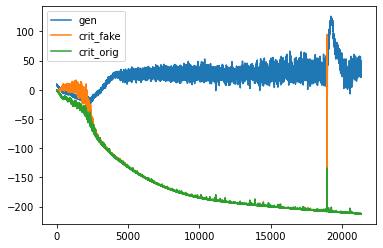

d loss fake  -212.4696502685547
d loss real  -212.54177856445312
[Epoch 63/100] [Batch 1/345] [D loss: -212.505714, acc:   0%] [G loss: 28.113259] [c1: 6.949906, c2: 6.547716, o: 52.765167, f: -1.036875] time: 13:50:17.650165
d loss fake  -212.38958740234375
d loss real  -212.58700561523438
[Epoch 63/100] [Batch 2/345] [D loss: -212.488297, acc:   0%] [G loss: 25.689125] [c1: 0.056557, c2: -0.109263, o: 63.463058, f: 4.172977] time: 13:50:19.985670
d loss fake  -212.476806640625
d loss real  -212.58853149414062
[Epoch 63/100] [Batch 3/345] [D loss: -212.532669, acc:   0%] [G loss: 26.369190] [c1: 5.458567, c2: 5.708920, o: 61.395821, f: 2.645185] time: 13:50:22.357438
d loss fake  -212.533935546875
d loss real  -212.54403686523438
[Epoch 63/100] [Batch 4/345] [D loss: -212.538986, acc:   0%] [G loss: 32.670140] [c1: 12.777868, c2: 13.372513, o: 63.485939, f: 3.622150] time: 13:50:24.694962
d loss fake  -212.57797241210938
d loss real  -212.63040161132812
[Epoch 63/100] [Batch 5/345] [D

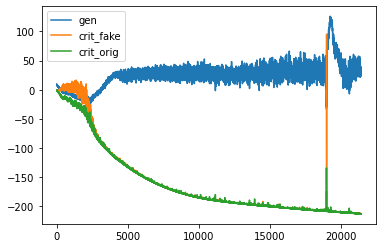

d loss fake  -212.62387084960938
d loss real  -212.7127227783203
[Epoch 63/100] [Batch 51/345] [D loss: -212.668297, acc:   0%] [G loss: 30.972425] [c1: 11.295376, c2: 11.654870, o: 71.502541, f: 8.799657] time: 13:52:13.049876
d loss fake  -212.64068603515625
d loss real  -212.63893127441406
[Epoch 63/100] [Batch 52/345] [D loss: -212.639809, acc:   0%] [G loss: 35.739928] [c1: 17.319317, c2: 17.046844, o: 70.880119, f: 10.669207] time: 13:52:15.339027
d loss fake  -212.48133850097656
d loss real  -212.38949584960938
[Epoch 63/100] [Batch 53/345] [D loss: -212.435417, acc:   0%] [G loss: 37.357809] [c1: 18.898960, c2: 18.346001, o: 79.942673, f: 17.941500] time: 13:52:17.625947
d loss fake  -212.55184936523438
d loss real  -212.67340087890625
[Epoch 63/100] [Batch 54/345] [D loss: -212.612625, acc:   0%] [G loss: 32.114262] [c1: 14.305340, c2: 13.478971, o: 82.731491, f: 21.069069] time: 13:52:19.915578
d loss fake  -212.47340393066406
d loss real  -212.67156982421875
[Epoch 63/100] [

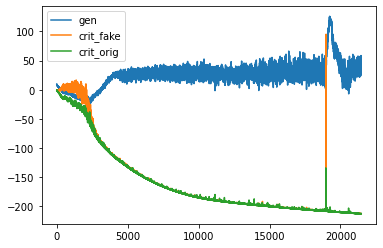

d loss fake  -212.7076416015625
d loss real  -212.72390747070312
[Epoch 63/100] [Batch 101/345] [D loss: -212.715775, acc:   0%] [G loss: 41.450007] [c1: 29.888929, c2: 29.739403, o: 103.784874, f: 42.027504] time: 13:54:09.567118
d loss fake  -212.65805053710938
d loss real  -212.7495880126953
[Epoch 63/100] [Batch 102/345] [D loss: -212.703819, acc:   0%] [G loss: 45.951391] [c1: 35.711193, c2: 35.340031, o: 90.101929, f: 31.176243] time: 13:54:11.861693
d loss fake  -212.72677612304688
d loss real  -212.80606079101562
[Epoch 63/100] [Batch 103/345] [D loss: -212.766418, acc:   0%] [G loss: 45.206086] [c1: 33.460854, c2: 33.391247, o: 90.235016, f: 32.328156] time: 13:54:14.149731
d loss fake  -212.74154663085938
d loss real  -212.81588745117188
[Epoch 63/100] [Batch 104/345] [D loss: -212.778717, acc:   0%] [G loss: 42.217467] [c1: 29.022758, c2: 28.698603, o: 93.974480, f: 34.573799] time: 13:54:16.439501
d loss fake  -212.705322265625
d loss real  -212.71551513671875
[Epoch 63/100

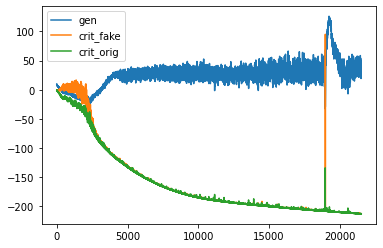

d loss fake  -212.66586303710938
d loss real  -212.9146728515625
[Epoch 63/100] [Batch 151/345] [D loss: -212.790268, acc:   0%] [G loss: 27.934113] [c1: 3.769244, c2: 4.138294, o: 81.115143, f: 18.407852] time: 13:56:05.795041
d loss fake  -212.80831909179688
d loss real  -212.77090454101562
[Epoch 63/100] [Batch 152/345] [D loss: -212.789612, acc:   0%] [G loss: 37.720320] [c1: 19.500031, c2: 19.254368, o: 66.893890, f: 5.415585] time: 13:56:08.087533
d loss fake  -212.65472412109375
d loss real  -212.8970489501953
[Epoch 63/100] [Batch 153/345] [D loss: -212.775887, acc:   0%] [G loss: 28.282417] [c1: 6.027732, c2: 5.719307, o: 77.700821, f: 19.200098] time: 13:56:10.367213
d loss fake  -212.8400421142578
d loss real  -212.92713928222656
[Epoch 63/100] [Batch 154/345] [D loss: -212.883591, acc:   0%] [G loss: 30.126974] [c1: 8.190996, c2: 7.759630, o: 66.201035, f: 7.488139] time: 13:56:12.669906
d loss fake  -212.83837890625
d loss real  -212.9039764404297
[Epoch 63/100] [Batch 155

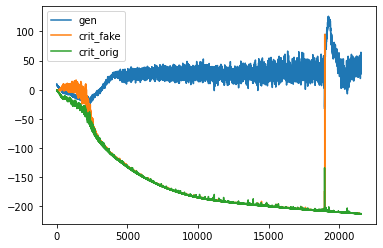

d loss fake  -212.92904663085938
d loss real  -212.94796752929688
[Epoch 63/100] [Batch 201/345] [D loss: -212.938507, acc:   0%] [G loss: 49.131316] [c1: 39.849453, c2: 39.482269, o: 90.086685, f: 34.764801] time: 13:58:01.261519
d loss fake  -212.9113006591797
d loss real  -213.0264892578125
[Epoch 63/100] [Batch 202/345] [D loss: -212.968895, acc:   0%] [G loss: 46.496572] [c1: 34.907307, c2: 34.534897, o: 95.392212, f: 39.867622] time: 13:58:03.554983
d loss fake  -212.9345703125
d loss real  -212.98281860351562
[Epoch 63/100] [Batch 203/345] [D loss: -212.958694, acc:   0%] [G loss: 47.190541] [c1: 36.386604, c2: 36.339348, o: 92.795532, f: 34.932457] time: 13:58:05.845635
d loss fake  -212.94187927246094
d loss real  -213.0255126953125
[Epoch 63/100] [Batch 204/345] [D loss: -212.983696, acc:   0%] [G loss: 48.977445] [c1: 39.955406, c2: 40.134735, o: 94.440384, f: 36.602882] time: 13:58:08.134920
d loss fake  -212.91543579101562
d loss real  -212.99716186523438
[Epoch 63/100] [B

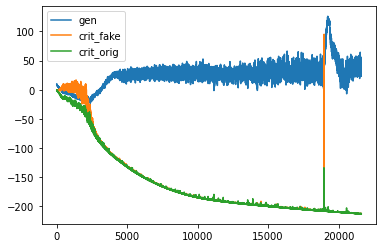

d loss fake  -213.01290893554688
d loss real  -213.0438995361328
[Epoch 63/100] [Batch 251/345] [D loss: -213.028404, acc:   0%] [G loss: 34.316041] [c1: 16.023581, c2: 16.023968, o: 77.038818, f: 20.216389] time: 13:59:57.750447
d loss fake  -212.8510284423828
d loss real  -213.05551147460938
[Epoch 63/100] [Batch 252/345] [D loss: -212.953270, acc:   0%] [G loss: 27.562821] [c1: 6.267979, c2: 6.278573, o: 71.894958, f: 17.281948] time: 14:00:00.055044
d loss fake  -212.96463012695312
d loss real  -212.86244201660156
[Epoch 63/100] [Batch 253/345] [D loss: -212.913536, acc:   0%] [G loss: 37.207181] [c1: 18.352642, c2: 18.369007, o: 60.564838, f: 6.074329] time: 14:00:02.349116
d loss fake  -212.9691162109375
d loss real  -213.07398986816406
[Epoch 63/100] [Batch 254/345] [D loss: -213.021553, acc:   0%] [G loss: 34.154945] [c1: 13.058892, c2: 12.755227, o: 73.873825, f: 17.468201] time: 14:00:04.647385
d loss fake  -212.9302520751953
d loss real  -213.0655975341797
[Epoch 63/100] [Ba

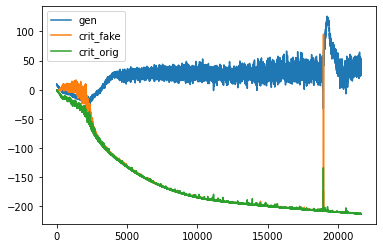

d loss fake  -213.115478515625
d loss real  -213.13262939453125
[Epoch 63/100] [Batch 301/345] [D loss: -213.124054, acc:   0%] [G loss: 23.702295] [c1: 0.880825, c2: 0.768778, o: 55.682274, f: 0.116561] time: 14:01:54.234948
d loss fake  -213.07098388671875
d loss real  -212.7655029296875
[Epoch 63/100] [Batch 302/345] [D loss: -212.918243, acc:   0%] [G loss: 35.317568] [c1: 20.554600, c2: 20.194530, o: 58.652115, f: 4.124552] time: 14:01:56.527756
d loss fake  -213.0509490966797
d loss real  -212.921630859375
[Epoch 63/100] [Batch 303/345] [D loss: -212.986290, acc:   0%] [G loss: 45.721337] [c1: 33.630791, c2: 33.325806, o: 74.051094, f: 19.227764] time: 14:01:58.810495
d loss fake  -212.927001953125
d loss real  -213.18460083007812
[Epoch 63/100] [Batch 304/345] [D loss: -213.055801, acc:   0%] [G loss: 37.092307] [c1: 16.750896, c2: 16.642120, o: 89.272339, f: 31.252657] time: 14:02:01.099407
d loss fake  -212.90145874023438
d loss real  -209.6915740966797
[Epoch 63/100] [Batch 3

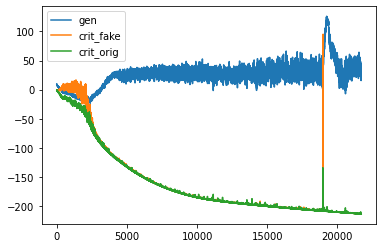

d loss fake  -213.0786590576172
d loss real  -213.22445678710938
[Epoch 64/100] [Batch 1/345] [D loss: -213.151558, acc:   0%] [G loss: 19.551404] [c1: -8.104824, c2: -8.402449, o: 44.181854, f: -8.234927] time: 14:03:29.502621
d loss fake  -213.02108764648438
d loss real  -213.21133422851562
[Epoch 64/100] [Batch 2/345] [D loss: -213.116211, acc:   0%] [G loss: 18.237727] [c1: -9.614109, c2: -9.743158, o: 46.789581, f: -6.622348] time: 14:03:31.880745
d loss fake  -213.08233642578125
d loss real  -213.22088623046875
[Epoch 64/100] [Batch 3/345] [D loss: -213.151611, acc:   0%] [G loss: 16.592674] [c1: -13.481693, c2: -13.431543, o: 44.502922, f: -11.031860] time: 14:03:34.238580
d loss fake  -212.84259033203125
d loss real  -213.21449279785156
[Epoch 64/100] [Batch 4/345] [D loss: -213.028542, acc:   0%] [G loss: 14.048839] [c1: -15.513725, c2: -15.534986, o: 43.071102, f: -13.331847] time: 14:03:36.610881
d loss fake  -213.14683532714844
d loss real  -213.20091247558594
[Epoch 64/100

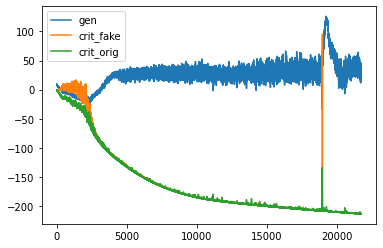

d loss fake  -213.21035766601562
d loss real  -213.3274688720703
[Epoch 64/100] [Batch 51/345] [D loss: -213.268913, acc:   0%] [G loss: 24.591941] [c1: -0.196849, c2: -0.671857, o: 65.344376, f: 7.156012] time: 14:05:24.799535
d loss fake  -212.6112823486328
d loss real  -213.17356872558594
[Epoch 64/100] [Batch 52/345] [D loss: -212.892426, acc:   0%] [G loss: 18.997506] [c1: -6.107715, c2: -6.356823, o: 58.014343, f: -0.729173] time: 14:05:27.080438
d loss fake  -213.17010498046875
d loss real  -213.25408935546875
[Epoch 64/100] [Batch 53/345] [D loss: -213.212097, acc:   0%] [G loss: 30.151732] [c1: 13.411764, c2: 12.807424, o: 55.404198, f: -0.906098] time: 14:05:29.363180
d loss fake  -213.21072387695312
d loss real  -212.89756774902344
[Epoch 64/100] [Batch 54/345] [D loss: -213.054146, acc:   0%] [G loss: 36.355701] [c1: 19.147327, c2: 18.817120, o: 68.509575, f: 11.496877] time: 14:05:31.654629
d loss fake  -213.20220947265625
d loss real  -213.240478515625
[Epoch 64/100] [Bat

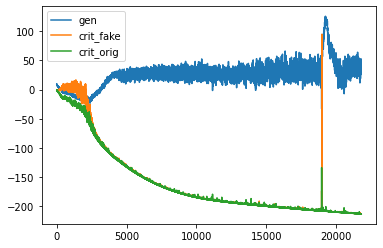

d loss fake  -213.3114013671875
d loss real  -213.40280151367188
[Epoch 64/100] [Batch 101/345] [D loss: -213.357101, acc:   0%] [G loss: 39.393631] [c1: 21.779957, c2: 21.690237, o: 88.853493, f: 25.488674] time: 14:07:20.684524
d loss fake  -213.31082153320312
d loss real  -213.38345336914062
[Epoch 64/100] [Batch 102/345] [D loss: -213.347137, acc:   0%] [G loss: 41.381698] [c1: 28.635944, c2: 28.319519, o: 84.342407, f: 23.663315] time: 14:07:22.970657
d loss fake  -213.31817626953125
d loss real  -213.39920043945312
[Epoch 64/100] [Batch 103/345] [D loss: -213.358688, acc:   0%] [G loss: 35.901813] [c1: 17.754189, c2: 17.725906, o: 89.509483, f: 28.514820] time: 14:07:25.256931
d loss fake  -213.32534790039062
d loss real  -213.39559936523438
[Epoch 64/100] [Batch 104/345] [D loss: -213.360474, acc:   0%] [G loss: 33.499605] [c1: 16.419510, c2: 16.304974, o: 76.486786, f: 18.612553] time: 14:07:27.537724
d loss fake  -213.3060302734375
d loss real  -213.40760803222656
[Epoch 64/10

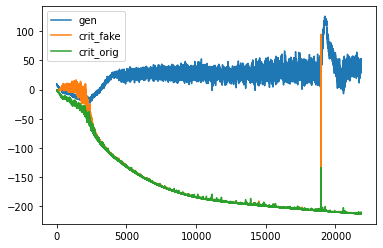

d loss fake  -213.35379028320312
d loss real  -213.11895751953125
[Epoch 64/100] [Batch 151/345] [D loss: -213.236374, acc:   0%] [G loss: 50.129483] [c1: 40.266651, c2: 40.218285, o: 99.677750, f: 41.234962] time: 14:09:16.822191
d loss fake  -213.41416931152344
d loss real  -213.39825439453125
[Epoch 64/100] [Batch 152/345] [D loss: -213.406212, acc:   0%] [G loss: 38.742320] [c1: 19.728397, c2: 19.440544, o: 98.078949, f: 36.383415] time: 14:09:19.103838
d loss fake  -213.36094665527344
d loss real  -213.45199584960938
[Epoch 64/100] [Batch 153/345] [D loss: -213.406471, acc:   0%] [G loss: 35.540739] [c1: 15.342066, c2: 15.459080, o: 79.483063, f: 18.589355] time: 14:09:21.393854
d loss fake  -213.39349365234375
d loss real  -213.397216796875
[Epoch 64/100] [Batch 154/345] [D loss: -213.395355, acc:   0%] [G loss: 37.014864] [c1: 19.854872, c2: 19.811842, o: 74.982658, f: 16.889126] time: 14:09:23.688891
d loss fake  -213.43096923828125
d loss real  -213.46707153320312
[Epoch 64/10

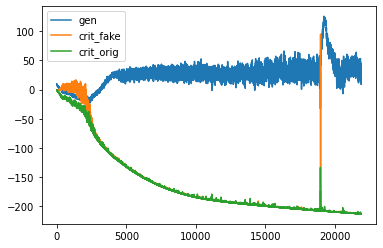

d loss fake  -213.51588439941406
d loss real  -213.60324096679688
[Epoch 64/100] [Batch 201/345] [D loss: -213.559563, acc:   0%] [G loss: 24.263478] [c1: 1.104784, c2: 0.910086, o: 59.521633, f: 6.328138] time: 14:11:11.847628
d loss fake  -213.50115966796875
d loss real  -213.57809448242188
[Epoch 64/100] [Batch 202/345] [D loss: -213.539627, acc:   0%] [G loss: 25.407458] [c1: 5.018808, c2: 4.977472, o: 54.937202, f: 2.282017] time: 14:11:14.136283
d loss fake  -213.4735107421875
d loss real  -213.50343322753906
[Epoch 64/100] [Batch 203/345] [D loss: -213.488472, acc:   0%] [G loss: 29.204379] [c1: 8.261774, c2: 8.325533, o: 58.403431, f: 4.387685] time: 14:11:16.405978
d loss fake  -213.5038604736328
d loss real  -213.58956909179688
[Epoch 64/100] [Batch 204/345] [D loss: -213.546715, acc:   0%] [G loss: 24.595295] [c1: 3.494079, c2: 3.526285, o: 62.729210, f: 7.880532] time: 14:11:18.693511
d loss fake  -213.50135803222656
d loss real  -213.1649932861328
[Epoch 64/100] [Batch 205

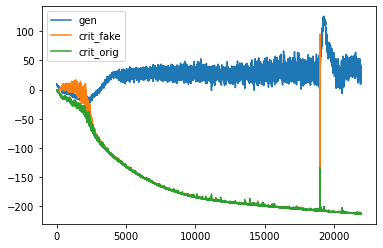

d loss fake  -213.49392700195312
d loss real  -213.63287353515625
[Epoch 64/100] [Batch 251/345] [D loss: -213.563400, acc:   0%] [G loss: 37.877438] [c1: 19.621155, c2: 19.395050, o: 64.108856, f: 7.624174] time: 14:13:07.898572
d loss fake  -213.51925659179688
d loss real  -213.62413024902344
[Epoch 64/100] [Batch 252/345] [D loss: -213.571693, acc:   0%] [G loss: 34.920725] [c1: 15.288502, c2: 15.165280, o: 75.949677, f: 19.871799] time: 14:13:10.177900
d loss fake  -213.5428924560547
d loss real  -213.66371154785156
[Epoch 64/100] [Batch 253/345] [D loss: -213.603302, acc:   0%] [G loss: 36.985218] [c1: 19.674236, c2: 19.199451, o: 73.107986, f: 15.450936] time: 14:13:12.456258
d loss fake  -213.53033447265625
d loss real  -213.40420532226562
[Epoch 64/100] [Batch 254/345] [D loss: -213.467270, acc:   0%] [G loss: 50.123332] [c1: 38.724014, c2: 38.823517, o: 76.515274, f: 20.927811] time: 14:13:14.761474
d loss fake  -213.05284118652344
d loss real  -213.61663818359375
[Epoch 64/10

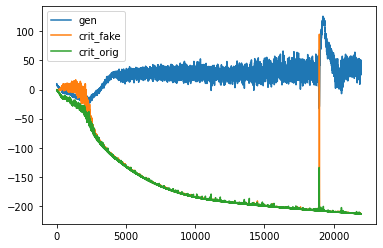

d loss fake  -213.63783264160156
d loss real  -213.69227600097656
[Epoch 64/100] [Batch 301/345] [D loss: -213.665054, acc:   0%] [G loss: 34.567489] [c1: 13.930100, c2: 13.892515, o: 69.973221, f: 12.762600] time: 14:15:03.751170
d loss fake  -213.6299285888672
d loss real  -213.69003295898438
[Epoch 64/100] [Batch 302/345] [D loss: -213.659981, acc:   0%] [G loss: 45.113848] [c1: 29.828785, c2: 29.837708, o: 73.310715, f: 16.252113] time: 14:15:06.028127
d loss fake  -213.52525329589844
d loss real  -213.73617553710938
[Epoch 64/100] [Batch 303/345] [D loss: -213.630714, acc:   0%] [G loss: 36.860929] [c1: 15.862328, c2: 15.750562, o: 85.534485, f: 28.498705] time: 14:15:08.315454
d loss fake  -213.6388397216797
d loss real  -213.71319580078125
[Epoch 64/100] [Batch 304/345] [D loss: -213.676018, acc:   0%] [G loss: 30.928308] [c1: 11.523685, c2: 11.423626, o: 74.133354, f: 17.423847] time: 14:15:10.607802
d loss fake  -213.67092895507812
d loss real  -213.7322998046875
[Epoch 64/100

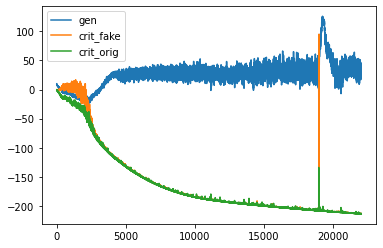

d loss fake  -213.73046875
d loss real  -213.78805541992188
[Epoch 65/100] [Batch 1/345] [D loss: -213.759262, acc:   0%] [G loss: 26.253682] [c1: 3.072249, c2: 2.684835, o: 48.978954, f: -2.752068] time: 14:16:39.199828
d loss fake  -213.135498046875
d loss real  -213.720703125
[Epoch 65/100] [Batch 2/345] [D loss: -213.428101, acc:   0%] [G loss: 19.728538] [c1: -8.407599, c2: -8.436634, o: 55.712814, f: 0.764028] time: 14:16:41.570010
d loss fake  -212.96966552734375
d loss real  -213.60235595703125
[Epoch 65/100] [Batch 3/345] [D loss: -213.286011, acc:   0%] [G loss: 17.737798] [c1: -12.049656, c2: -12.061657, o: 51.129162, f: -8.167009] time: 14:16:43.941219
d loss fake  -213.70249938964844
d loss real  -213.74258422851562
[Epoch 65/100] [Batch 4/345] [D loss: -213.722542, acc:   0%] [G loss: 22.172855] [c1: -4.042147, c2: -4.430000, o: 49.263897, f: -11.097425] time: 14:16:46.299938
d loss fake  -213.69692993164062
d loss real  -213.7925262451172
[Epoch 65/100] [Batch 5/345] [D 

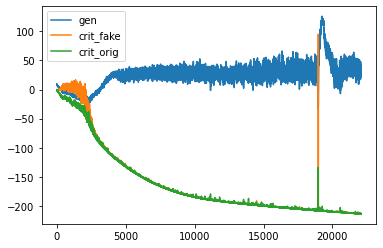

d loss fake  -213.78753662109375
d loss real  -213.802734375
[Epoch 65/100] [Batch 51/345] [D loss: -213.795135, acc:   0%] [G loss: 37.443509] [c1: 15.027447, c2: 14.710076, o: 78.933784, f: 12.468077] time: 14:18:34.263832
d loss fake  -213.78060913085938
d loss real  -213.8547821044922
[Epoch 65/100] [Batch 52/345] [D loss: -213.817696, acc:   0%] [G loss: 37.187401] [c1: 16.888912, c2: 16.826813, o: 81.324005, f: 17.081993] time: 14:18:36.547183
d loss fake  -213.81137084960938
d loss real  -213.8314666748047
[Epoch 65/100] [Batch 53/345] [D loss: -213.821419, acc:   0%] [G loss: 27.041130] [c1: 3.116264, c2: 3.187867, o: 74.737091, f: 16.460739] time: 14:18:38.823483
d loss fake  -213.79905700683594
d loss real  -213.89675903320312
[Epoch 65/100] [Batch 54/345] [D loss: -213.847908, acc:   0%] [G loss: 29.815999] [c1: 5.652871, c2: 5.524364, o: 60.287708, f: 1.917297] time: 14:18:41.110439
d loss fake  -213.8181915283203
d loss real  -213.8670654296875
[Epoch 65/100] [Batch 55/345

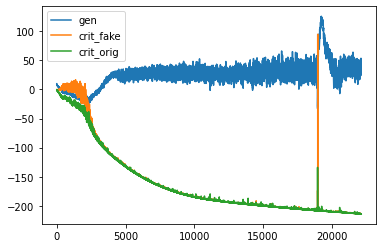

d loss fake  -213.8995819091797
d loss real  -213.9420928955078
[Epoch 65/100] [Batch 101/345] [D loss: -213.920837, acc:   0%] [G loss: 40.901313] [c1: 26.500511, c2: 26.180784, o: 100.259300, f: 40.684231] time: 14:20:30.413705
d loss fake  -213.9219512939453
d loss real  -213.94671630859375
[Epoch 65/100] [Batch 102/345] [D loss: -213.934334, acc:   0%] [G loss: 36.300799] [c1: 19.474289, c2: 19.341473, o: 85.176163, f: 27.211365] time: 14:20:32.707863
d loss fake  -213.8865203857422
d loss real  -213.85487365722656
[Epoch 65/100] [Batch 103/345] [D loss: -213.870697, acc:   0%] [G loss: 38.154764] [c1: 21.269493, c2: 21.351181, o: 78.216400, f: 19.799057] time: 14:20:34.995561
d loss fake  -213.85910034179688
d loss real  -213.5999755859375
[Epoch 65/100] [Batch 104/345] [D loss: -213.729538, acc:   0%] [G loss: 41.290231] [c1: 23.153326, c2: 23.357950, o: 81.102432, f: 19.721024] time: 14:20:37.286186
d loss fake  -213.92938232421875
d loss real  -213.98391723632812
[Epoch 65/100]

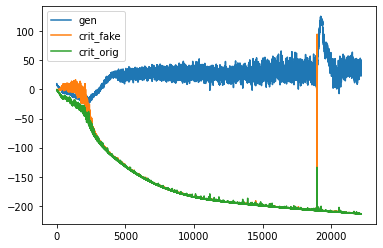

d loss fake  -213.99778747558594
d loss real  -214.05078125
[Epoch 65/100] [Batch 151/345] [D loss: -214.024284, acc:   0%] [G loss: 29.713847] [c1: 7.667043, c2: 7.322285, o: 56.377831, f: -0.266672] time: 14:22:26.336236
d loss fake  -213.90536499023438
d loss real  -213.2142791748047
[Epoch 65/100] [Batch 152/345] [D loss: -213.559822, acc:   0%] [G loss: 47.649910] [c1: 33.633278, c2: 33.685295, o: 66.381210, f: 6.593911] time: 14:22:28.617583
d loss fake  -214.02426147460938
d loss real  -214.0421142578125
[Epoch 65/100] [Batch 153/345] [D loss: -214.033188, acc:   0%] [G loss: 41.904856] [c1: 26.186552, c2: 26.284744, o: 96.766930, f: 35.472855] time: 14:22:30.878479
d loss fake  -213.97193908691406
d loss real  -213.7533416748047
[Epoch 65/100] [Batch 154/345] [D loss: -213.862640, acc:   0%] [G loss: 51.075343] [c1: 40.582481, c2: 40.515900, o: 83.832657, f: 26.981627] time: 14:22:33.163406
d loss fake  -214.0089111328125
d loss real  -214.06350708007812
[Epoch 65/100] [Batch 1

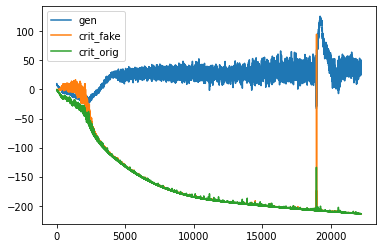

d loss fake  -214.06419372558594
d loss real  -214.10299682617188
[Epoch 65/100] [Batch 201/345] [D loss: -214.083595, acc:   0%] [G loss: 40.439857] [c1: 26.375790, c2: 26.330973, o: 77.240921, f: 23.174709] time: 14:24:21.086560
d loss fake  -214.08706665039062
d loss real  -214.1360321044922
[Epoch 65/100] [Batch 202/345] [D loss: -214.111549, acc:   0%] [G loss: 40.299222] [c1: 25.253313, c2: 25.333082, o: 83.080566, f: 25.266659] time: 14:24:23.374611
d loss fake  -214.10406494140625
d loss real  -214.13584899902344
[Epoch 65/100] [Batch 203/345] [D loss: -214.119957, acc:   0%] [G loss: 38.594584] [c1: 23.196039, c2: 23.202259, o: 82.876572, f: 26.184025] time: 14:24:25.643743
d loss fake  -214.11129760742188
d loss real  -214.16842651367188
[Epoch 65/100] [Batch 204/345] [D loss: -214.139862, acc:   0%] [G loss: 39.095131] [c1: 23.722996, c2: 23.544134, o: 76.938095, f: 21.622360] time: 14:24:27.920729
d loss fake  -214.07162475585938
d loss real  -214.09613037109375
[Epoch 65/1

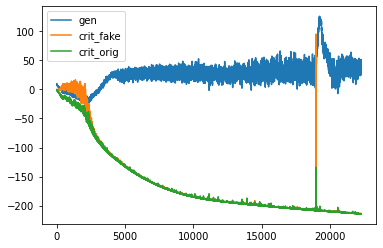

d loss fake  -214.16014099121094
d loss real  -214.21279907226562
[Epoch 65/100] [Batch 251/345] [D loss: -214.186470, acc:   0%] [G loss: 44.892009] [c1: 30.910675, c2: 31.004656, o: 91.767525, f: 36.101128] time: 14:26:16.913506
d loss fake  -214.17510986328125
d loss real  -214.20437622070312
[Epoch 65/100] [Batch 252/345] [D loss: -214.189743, acc:   0%] [G loss: 40.011854] [c1: 22.693188, c2: 22.880108, o: 87.827591, f: 33.772312] time: 14:26:19.200693
d loss fake  -214.172119140625
d loss real  -214.23092651367188
[Epoch 65/100] [Batch 253/345] [D loss: -214.201523, acc:   0%] [G loss: 37.648790] [c1: 19.601494, c2: 19.730652, o: 75.723877, f: 21.259827] time: 14:26:21.482638
d loss fake  -214.15716552734375
d loss real  -214.2081298828125
[Epoch 65/100] [Batch 254/345] [D loss: -214.182648, acc:   0%] [G loss: 35.220358] [c1: 16.085154, c2: 15.797391, o: 75.527512, f: 22.332907] time: 14:26:23.775154
d loss fake  -214.0497283935547
d loss real  -214.22280883789062
[Epoch 65/100]

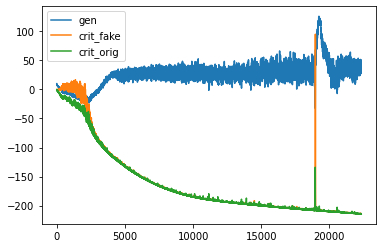

d loss fake  -214.21563720703125
d loss real  -213.96395874023438
[Epoch 65/100] [Batch 301/345] [D loss: -214.089798, acc:   0%] [G loss: 37.238008] [c1: 17.693150, c2: 17.499830, o: 64.845093, f: 5.153603] time: 14:28:12.872758
d loss fake  -214.12469482421875
d loss real  -214.14987182617188
[Epoch 65/100] [Batch 302/345] [D loss: -214.137283, acc:   0%] [G loss: 36.611324] [c1: 17.955803, c2: 17.902239, o: 77.831497, f: 18.211966] time: 14:28:15.166631
d loss fake  -214.10919189453125
d loss real  -214.3186798095703
[Epoch 65/100] [Batch 303/345] [D loss: -214.213936, acc:   0%] [G loss: 28.792562] [c1: 5.584690, c2: 5.828195, o: 76.431427, f: 18.057610] time: 14:28:17.452866
d loss fake  -214.22396850585938
d loss real  -214.3004608154297
[Epoch 65/100] [Batch 304/345] [D loss: -214.262215, acc:   0%] [G loss: 29.987870] [c1: 6.431376, c2: 6.182258, o: 62.728798, f: 6.848841] time: 14:28:19.754579
d loss fake  -214.26092529296875
d loss real  -214.26144409179688
[Epoch 65/100] [Ba

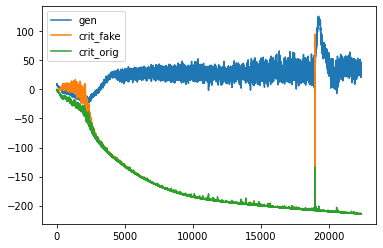

d loss fake  -214.25857543945312
d loss real  -214.27706909179688
[Epoch 66/100] [Batch 1/345] [D loss: -214.267822, acc:   0%] [G loss: 33.526933] [c1: 14.183069, c2: 13.893370, o: 83.031090, f: 24.052639] time: 14:29:48.162075
d loss fake  -214.28900146484375
d loss real  -214.30288696289062
[Epoch 66/100] [Batch 2/345] [D loss: -214.295944, acc:   0%] [G loss: 34.811089] [c1: 14.744902, c2: 14.592302, o: 70.086838, f: 12.723091] time: 14:29:50.560712
d loss fake  -214.173828125
d loss real  -214.27874755859375
[Epoch 66/100] [Batch 3/345] [D loss: -214.226288, acc:   0%] [G loss: 31.205297] [c1: 10.172115, c2: 10.165459, o: 70.664421, f: 14.623365] time: 14:29:52.922505
d loss fake  -213.743896484375
d loss real  -214.25830078125
[Epoch 66/100] [Batch 4/345] [D loss: -214.001099, acc:   0%] [G loss: 24.694413] [c1: -0.072687, c2: -0.137930, o: 70.806236, f: 9.114910] time: 14:29:55.296639
d loss fake  -214.18377685546875
d loss real  -214.32461547851562
[Epoch 66/100] [Batch 5/345] 

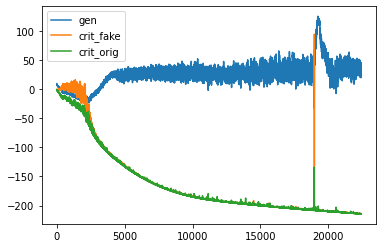

d loss fake  -214.3787384033203
d loss real  -214.3597412109375
[Epoch 66/100] [Batch 51/345] [D loss: -214.369240, acc:   0%] [G loss: 37.006892] [c1: 19.217522, c2: 19.009901, o: 75.311935, f: 17.816965] time: 14:31:43.692028
d loss fake  -214.3518524169922
d loss real  -214.4154052734375
[Epoch 66/100] [Batch 52/345] [D loss: -214.383629, acc:   0%] [G loss: 39.968796] [c1: 23.972485, c2: 23.819006, o: 77.195724, f: 18.577694] time: 14:31:45.974111
d loss fake  -214.3330535888672
d loss real  -213.90635681152344
[Epoch 66/100] [Batch 53/345] [D loss: -214.119705, acc:   0%] [G loss: 43.861797] [c1: 26.500889, c2: 26.478601, o: 84.677307, f: 22.722389] time: 14:31:48.253721
d loss fake  -214.3630828857422
d loss real  -214.42971801757812
[Epoch 66/100] [Batch 54/345] [D loss: -214.396400, acc:   0%] [G loss: 42.968401] [c1: 26.919315, c2: 26.710543, o: 88.593246, f: 29.948669] time: 14:31:50.530205
d loss fake  -214.32203674316406
d loss real  -214.40196228027344
[Epoch 66/100] [Batc

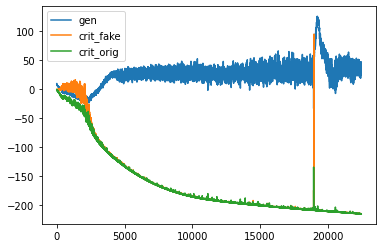

d loss fake  -214.47323608398438
d loss real  -214.52001953125
[Epoch 66/100] [Batch 101/345] [D loss: -214.496628, acc:   0%] [G loss: 37.888248] [c1: 21.205959, c2: 20.858236, o: 82.592079, f: 23.219475] time: 14:33:39.757531
d loss fake  -214.454833984375
d loss real  -214.51443481445312
[Epoch 66/100] [Batch 102/345] [D loss: -214.484634, acc:   0%] [G loss: 44.195387] [c1: 29.957758, c2: 29.849367, o: 80.294518, f: 20.783264] time: 14:33:42.042739
d loss fake  -214.4281005859375
d loss real  -214.40382385253906
[Epoch 66/100] [Batch 103/345] [D loss: -214.415962, acc:   0%] [G loss: 41.263255] [c1: 26.302895, c2: 26.266541, o: 90.797195, f: 29.272549] time: 14:33:44.316989
d loss fake  -214.490966796875
d loss real  -214.56097412109375
[Epoch 66/100] [Batch 104/345] [D loss: -214.525970, acc:   0%] [G loss: 36.905791] [c1: 16.627861, c2: 16.659508, o: 88.079445, f: 24.678867] time: 14:33:46.596471
d loss fake  -214.3943634033203
d loss real  -214.54989624023438
[Epoch 66/100] [Bat

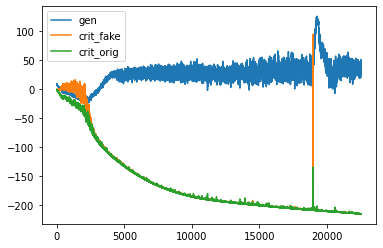

d loss fake  -214.54656982421875
d loss real  -214.46304321289062
[Epoch 66/100] [Batch 151/345] [D loss: -214.504807, acc:   0%] [G loss: 46.848451] [c1: 33.563675, c2: 33.537483, o: 84.822372, f: 29.822090] time: 14:35:35.982598
d loss fake  -214.55691528320312
d loss real  -214.4450225830078
[Epoch 66/100] [Batch 152/345] [D loss: -214.500969, acc:   0%] [G loss: 48.427000] [c1: 38.214672, c2: 37.970074, o: 92.346924, f: 34.493946] time: 14:35:38.262088
d loss fake  -214.5531463623047
d loss real  -214.59439086914062
[Epoch 66/100] [Batch 153/345] [D loss: -214.573769, acc:   0%] [G loss: 41.121364] [c1: 25.628151, c2: 25.656593, o: 96.164444, f: 37.644638] time: 14:35:40.547600
d loss fake  -214.59312438964844
d loss real  -214.62698364257812
[Epoch 66/100] [Batch 154/345] [D loss: -214.610054, acc:   0%] [G loss: 39.860196] [c1: 23.083038, c2: 23.025299, o: 82.036064, f: 26.428165] time: 14:35:42.844916
d loss fake  -214.53009033203125
d loss real  -214.5926055908203
[Epoch 66/100

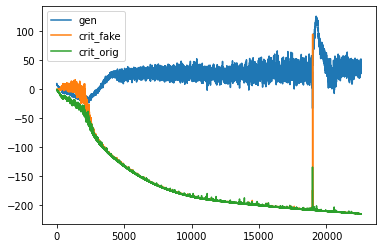

d loss fake  -214.65206909179688
d loss real  -214.71356201171875
[Epoch 66/100] [Batch 201/345] [D loss: -214.682816, acc:   0%] [G loss: 42.139847] [c1: 25.312637, c2: 25.278141, o: 79.782700, f: 22.122887] time: 14:37:31.013737
d loss fake  -214.61264038085938
d loss real  -214.6668701171875
[Epoch 66/100] [Batch 202/345] [D loss: -214.639755, acc:   0%] [G loss: 32.770367] [c1: 13.488565, c2: 13.396112, o: 80.061691, f: 25.583824] time: 14:37:33.305963
d loss fake  -214.6226806640625
d loss real  -214.69992065429688
[Epoch 66/100] [Batch 203/345] [D loss: -214.661301, acc:   0%] [G loss: 34.229418] [c1: 13.723810, c2: 13.832422, o: 68.253731, f: 12.150223] time: 14:37:35.586550
d loss fake  -214.69027709960938
d loss real  -214.6959228515625
[Epoch 66/100] [Batch 204/345] [D loss: -214.693100, acc:   0%] [G loss: 31.513633] [c1: 11.775423, c2: 11.681162, o: 68.691620, f: 14.355103] time: 14:37:37.884728
d loss fake  -214.671142578125
d loss real  -214.72543334960938
[Epoch 66/100] 

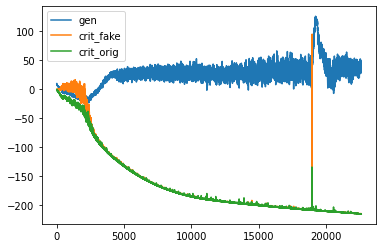

d loss fake  -214.60092163085938
d loss real  -213.80043029785156
[Epoch 66/100] [Batch 251/345] [D loss: -214.200676, acc:   0%] [G loss: 50.264368] [c1: 34.724880, c2: 34.796936, o: 90.048874, f: 30.957920] time: 14:39:27.112012
d loss fake  -214.3263397216797
d loss real  -214.68807983398438
[Epoch 66/100] [Batch 252/345] [D loss: -214.507210, acc:   0%] [G loss: 31.962611] [c1: 6.015187, c2: 6.174186, o: 97.989975, f: 33.534714] time: 14:39:29.392180
d loss fake  -214.5120391845703
d loss real  -214.75650024414062
[Epoch 66/100] [Batch 253/345] [D loss: -214.634270, acc:   0%] [G loss: 26.522912] [c1: 1.409720, c2: 1.525552, o: 66.988411, f: 7.979202] time: 14:39:31.661819
d loss fake  -214.68487548828125
d loss real  -214.7591094970703
[Epoch 66/100] [Batch 254/345] [D loss: -214.721992, acc:   0%] [G loss: 32.473287] [c1: 10.556383, c2: 10.170332, o: 58.688011, f: -0.415168] time: 14:39:33.951021
d loss fake  -214.69747924804688
d loss real  -214.7035675048828
[Epoch 66/100] [Bat

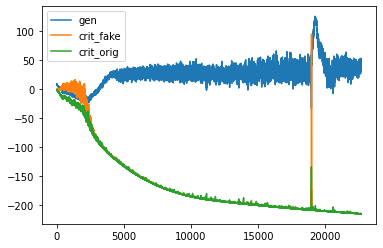

d loss fake  -214.7861328125
d loss real  -214.84011840820312
[Epoch 66/100] [Batch 301/345] [D loss: -214.813126, acc:   0%] [G loss: 44.664626] [c1: 29.474346, c2: 29.297684, o: 77.554176, f: 24.375603] time: 14:41:22.892148
d loss fake  -214.7977294921875
d loss real  -214.83615112304688
[Epoch 66/100] [Batch 302/345] [D loss: -214.816940, acc:   0%] [G loss: 37.250706] [c1: 18.192331, c2: 18.091995, o: 80.069550, f: 25.939577] time: 14:41:25.183085
d loss fake  -214.8011016845703
d loss real  -214.81407165527344
[Epoch 66/100] [Batch 303/345] [D loss: -214.807587, acc:   0%] [G loss: 34.181904] [c1: 15.205075, c2: 14.930691, o: 73.595551, f: 18.939610] time: 14:41:27.475633
d loss fake  -214.39315795898438
d loss real  -214.86605834960938
[Epoch 66/100] [Batch 304/345] [D loss: -214.629608, acc:   0%] [G loss: 23.270189] [c1: -0.263510, c2: -0.353248, o: 69.245827, f: 17.500210] time: 14:41:29.761596
d loss fake  -214.78854370117188
d loss real  -214.84591674804688
[Epoch 66/100] [

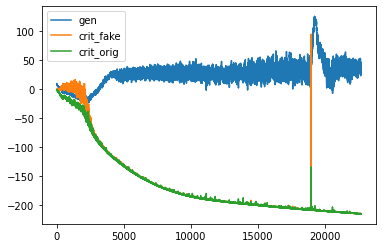

d loss fake  -214.82687377929688
d loss real  -214.90432739257812
[Epoch 67/100] [Batch 1/345] [D loss: -214.865601, acc:   0%] [G loss: 26.245687] [c1: 1.322243, c2: 1.123509, o: 61.502323, f: 3.419732] time: 14:42:58.044135
d loss fake  -214.82467651367188
d loss real  -214.9408416748047
[Epoch 67/100] [Batch 2/345] [D loss: -214.882759, acc:   0%] [G loss: 25.378527] [c1: 0.747358, c2: 0.522868, o: 57.112617, f: 2.328662] time: 14:43:00.380907
d loss fake  -214.81625366210938
d loss real  -214.83291625976562
[Epoch 67/100] [Batch 3/345] [D loss: -214.824585, acc:   0%] [G loss: 35.020364] [c1: 15.662029, c2: 15.257999, o: 56.539085, f: 1.467552] time: 14:43:02.773191
d loss fake  -214.79684448242188
d loss real  -214.88714599609375
[Epoch 67/100] [Batch 4/345] [D loss: -214.841995, acc:   0%] [G loss: 35.763878] [c1: 17.042496, c2: 16.728516, o: 70.724777, f: 17.601376] time: 14:43:05.097975
d loss fake  -214.78781127929688
d loss real  -214.63229370117188
[Epoch 67/100] [Batch 5/34

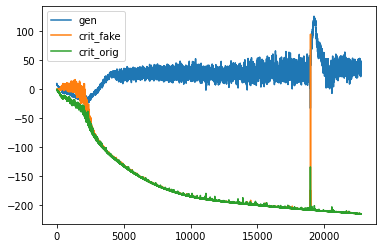

d loss fake  -214.9246826171875
d loss real  -214.9893341064453
[Epoch 67/100] [Batch 51/345] [D loss: -214.957008, acc:   0%] [G loss: 35.347340] [c1: 16.975935, c2: 16.965366, o: 73.511604, f: 15.679420] time: 14:44:53.113723
d loss fake  -214.9622802734375
d loss real  -215.01841735839844
[Epoch 67/100] [Batch 52/345] [D loss: -214.990349, acc:   0%] [G loss: 35.102603] [c1: 16.188206, c2: 15.979362, o: 74.042068, f: 16.542532] time: 14:44:55.419026
d loss fake  -214.92233276367188
d loss real  -214.97698974609375
[Epoch 67/100] [Batch 53/345] [D loss: -214.949661, acc:   0%] [G loss: 40.758998] [c1: 25.890038, c2: 25.718506, o: 73.317734, f: 15.575608] time: 14:44:57.706019
d loss fake  -214.9410858154297
d loss real  -215.00172424316406
[Epoch 67/100] [Batch 54/345] [D loss: -214.971405, acc:   0%] [G loss: 36.365884] [c1: 16.274328, c2: 16.338135, o: 82.814987, f: 23.491459] time: 14:44:59.993151
d loss fake  -214.92333984375
d loss real  -214.96884155273438
[Epoch 67/100] [Batch

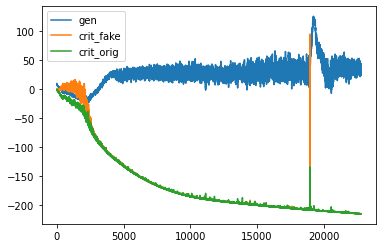

d loss fake  -215.04249572753906
d loss real  -215.09356689453125
[Epoch 67/100] [Batch 101/345] [D loss: -215.068031, acc:   0%] [G loss: 26.017123] [c1: 2.613199, c2: 2.638776, o: 68.943985, f: 10.397256] time: 14:46:48.920789
d loss fake  -214.98597717285156
d loss real  -214.93350219726562
[Epoch 67/100] [Batch 102/345] [D loss: -214.959740, acc:   0%] [G loss: 32.119920] [c1: 12.943009, c2: 12.782696, o: 58.762085, f: 3.368065] time: 14:46:51.192768
d loss fake  -215.0375213623047
d loss real  -214.91551208496094
[Epoch 67/100] [Batch 103/345] [D loss: -214.976517, acc:   0%] [G loss: 37.743041] [c1: 22.291742, c2: 22.200172, o: 71.803909, f: 13.282077] time: 14:46:53.462121
d loss fake  -215.05075073242188
d loss real  -215.06695556640625
[Epoch 67/100] [Batch 104/345] [D loss: -215.058853, acc:   0%] [G loss: 37.934527] [c1: 18.758398, c2: 18.733238, o: 80.864700, f: 20.837765] time: 14:46:55.745661
d loss fake  -215.0708770751953
d loss real  -215.04962158203125
[Epoch 67/100] 

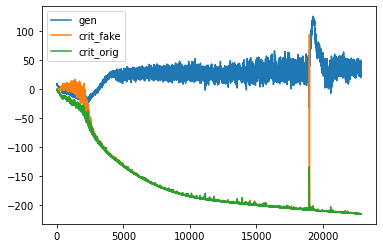

d loss fake  -215.1110076904297
d loss real  -215.16607666015625
[Epoch 67/100] [Batch 151/345] [D loss: -215.138542, acc:   0%] [G loss: 31.563697] [c1: 8.479401, c2: 8.488147, o: 70.514526, f: 10.905894] time: 14:48:44.522644
d loss fake  -214.98629760742188
d loss real  -215.1829833984375
[Epoch 67/100] [Batch 152/345] [D loss: -215.084641, acc:   0%] [G loss: 40.701672] [c1: 25.746365, c2: 25.539646, o: 68.154129, f: 10.264534] time: 14:48:46.808410
d loss fake  -215.08580017089844
d loss real  -215.1619110107422
[Epoch 67/100] [Batch 153/345] [D loss: -215.123856, acc:   0%] [G loss: 39.688952] [c1: 22.950489, c2: 22.728350, o: 79.006699, f: 24.642113] time: 14:48:49.086432
d loss fake  -215.1494140625
d loss real  -215.15692138671875
[Epoch 67/100] [Batch 154/345] [D loss: -215.153168, acc:   0%] [G loss: 39.287013] [c1: 22.864708, c2: 22.775482, o: 75.153717, f: 22.987125] time: 14:48:51.375340
d loss fake  -215.08731079101562
d loss real  -215.14364624023438
[Epoch 67/100] [Bat

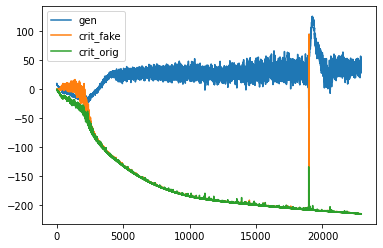

d loss fake  -215.17127990722656
d loss real  -215.1611328125
[Epoch 67/100] [Batch 201/345] [D loss: -215.166206, acc:   0%] [G loss: 45.239795] [c1: 32.231422, c2: 32.119160, o: 72.730888, f: 21.081024] time: 14:50:39.203168
d loss fake  -215.21136474609375
d loss real  -215.22332763671875
[Epoch 67/100] [Batch 202/345] [D loss: -215.217346, acc:   0%] [G loss: 36.296210] [c1: 18.553314, c2: 18.600836, o: 84.214325, f: 30.556904] time: 14:50:41.491060
d loss fake  -215.22198486328125
d loss real  -215.26275634765625
[Epoch 67/100] [Batch 203/345] [D loss: -215.242371, acc:   0%] [G loss: 40.426125] [c1: 25.447426, c2: 25.345188, o: 72.043983, f: 20.787556] time: 14:50:43.757942
d loss fake  -215.19259643554688
d loss real  -215.1715545654297
[Epoch 67/100] [Batch 204/345] [D loss: -215.182076, acc:   0%] [G loss: 39.997302] [c1: 24.451534, c2: 24.361412, o: 74.406113, f: 24.281406] time: 14:50:46.022785
d loss fake  -215.23257446289062
d loss real  -215.25794982910156
[Epoch 67/100] 

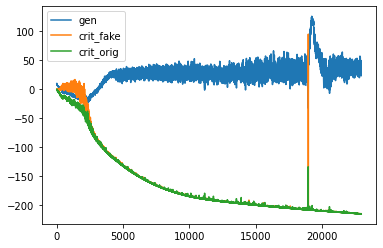

d loss fake  -215.186767578125
d loss real  -215.31285095214844
[Epoch 67/100] [Batch 251/345] [D loss: -215.249809, acc:   0%] [G loss: 43.884925] [c1: 32.354073, c2: 32.086361, o: 67.830841, f: 18.512602] time: 14:52:34.852981
d loss fake  -215.23574829101562
d loss real  -214.74252319335938
[Epoch 67/100] [Batch 252/345] [D loss: -214.989136, acc:   0%] [G loss: 47.618759] [c1: 32.782814, c2: 32.646751, o: 81.352180, f: 28.293457] time: 14:52:37.136979
d loss fake  -215.138671875
d loss real  -215.31771850585938
[Epoch 67/100] [Batch 253/345] [D loss: -215.228195, acc:   0%] [G loss: 37.698392] [c1: 19.016886, c2: 19.043444, o: 89.300476, f: 34.132133] time: 14:52:39.434231
d loss fake  -215.1839599609375
d loss real  -215.31732177734375
[Epoch 67/100] [Batch 254/345] [D loss: -215.250641, acc:   0%] [G loss: 32.874672] [c1: 11.515874, c2: 11.581627, o: 73.223518, f: 18.369526] time: 14:52:41.724764
d loss fake  -215.2240753173828
d loss real  -215.302734375
[Epoch 67/100] [Batch 25

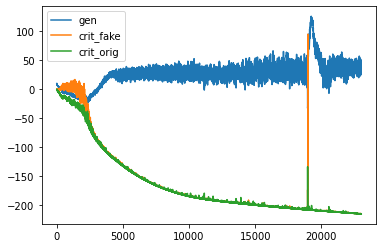

d loss fake  -215.33316040039062
d loss real  -215.381591796875
[Epoch 67/100] [Batch 301/345] [D loss: -215.357376, acc:   0%] [G loss: 40.519612] [c1: 25.006752, c2: 24.798817, o: 65.093811, f: 9.999126] time: 14:54:30.640371
d loss fake  -215.05596923828125
d loss real  -214.7554931640625
[Epoch 67/100] [Batch 302/345] [D loss: -214.905731, acc:   0%] [G loss: 41.287447] [c1: 24.478506, c2: 24.270945, o: 78.549805, f: 25.426350] time: 14:54:32.930654
d loss fake  -215.28817749023438
d loss real  -215.3711700439453
[Epoch 67/100] [Batch 303/345] [D loss: -215.329674, acc:   0%] [G loss: 30.022932] [c1: 6.492219, c2: 6.323638, o: 79.386673, f: 21.585083] time: 14:54:35.209787
d loss fake  -215.29519653320312
d loss real  -215.37576293945312
[Epoch 67/100] [Batch 304/345] [D loss: -215.335480, acc:   0%] [G loss: 25.619268] [c1: 1.049470, c2: 1.001783, o: 62.128220, f: 8.963381] time: 14:54:37.495359
d loss fake  -215.34756469726562
d loss real  -215.40756225585938
[Epoch 67/100] [Batc

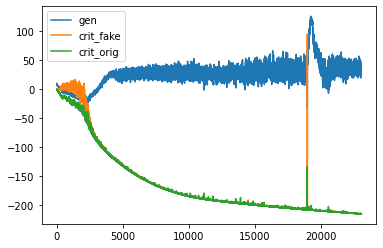

d loss fake  -215.38046264648438
d loss real  -215.42408752441406
[Epoch 68/100] [Batch 1/345] [D loss: -215.402275, acc:   0%] [G loss: 32.641104] [c1: 12.047691, c2: 11.902491, o: 64.361855, f: 6.637177] time: 14:56:06.304580
d loss fake  -215.39889526367188
d loss real  -215.44876098632812
[Epoch 68/100] [Batch 2/345] [D loss: -215.423828, acc:   0%] [G loss: 32.163186] [c1: 10.353966, c2: 10.198960, o: 68.155602, f: 11.257954] time: 14:56:08.647556
d loss fake  -215.40939331054688
d loss real  -215.3538055419922
[Epoch 68/100] [Batch 3/345] [D loss: -215.381599, acc:   0%] [G loss: 34.875416] [c1: 15.710420, c2: 15.671813, o: 66.889450, f: 10.564783] time: 14:56:11.004639
d loss fake  -215.3280487060547
d loss real  -215.3807373046875
[Epoch 68/100] [Batch 4/345] [D loss: -215.354393, acc:   0%] [G loss: 35.814495] [c1: 14.351988, c2: 14.446821, o: 73.427010, f: 14.060330] time: 14:56:13.356196
d loss fake  -215.3683319091797
d loss real  -215.35992431640625
[Epoch 68/100] [Batch 5

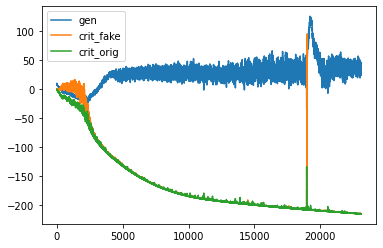

d loss fake  -215.4827423095703
d loss real  -215.53677368164062
[Epoch 68/100] [Batch 51/345] [D loss: -215.509758, acc:   0%] [G loss: 36.999691] [c1: 19.866241, c2: 19.425320, o: 78.917290, f: 22.305607] time: 14:58:01.462530
d loss fake  -215.42999267578125
d loss real  -215.50433349609375
[Epoch 68/100] [Batch 52/345] [D loss: -215.467163, acc:   0%] [G loss: 39.442064] [c1: 23.371922, c2: 23.272062, o: 79.751541, f: 21.515648] time: 14:58:03.737431
d loss fake  -215.49563598632812
d loss real  -215.5470428466797
[Epoch 68/100] [Batch 53/345] [D loss: -215.521339, acc:   0%] [G loss: 36.316933] [c1: 18.311642, c2: 18.272358, o: 80.030800, f: 22.722780] time: 14:58:06.026373
d loss fake  -215.4566650390625
d loss real  -215.5380859375
[Epoch 68/100] [Batch 54/345] [D loss: -215.497375, acc:   0%] [G loss: 34.318949] [c1: 16.466608, c2: 16.387030, o: 72.969955, f: 18.274235] time: 14:58:08.314681
d loss fake  -215.46844482421875
d loss real  -215.42807006835938
[Epoch 68/100] [Batch

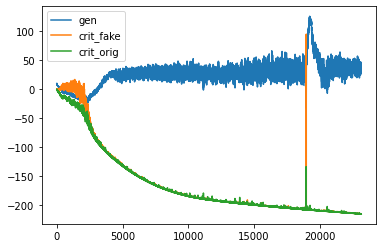

d loss fake  -215.60479736328125
d loss real  -215.59661865234375
[Epoch 68/100] [Batch 101/345] [D loss: -215.600708, acc:   0%] [G loss: 33.826798] [c1: 15.517136, c2: 15.381964, o: 58.332085, f: 2.527421] time: 14:59:57.422487
d loss fake  -215.58676147460938
d loss real  -215.5411376953125
[Epoch 68/100] [Batch 102/345] [D loss: -215.563950, acc:   0%] [G loss: 38.244232] [c1: 21.055286, c2: 20.970387, o: 73.148483, f: 14.842714] time: 14:59:59.712182
d loss fake  -215.51248168945312
d loss real  -215.60484313964844
[Epoch 68/100] [Batch 103/345] [D loss: -215.558662, acc:   0%] [G loss: 29.677260] [c1: 6.995318, c2: 6.910361, o: 79.297623, f: 21.198540] time: 15:00:01.983849
d loss fake  -215.57635498046875
d loss real  -215.364013671875
[Epoch 68/100] [Batch 104/345] [D loss: -215.470184, acc:   0%] [G loss: 38.110315] [c1: 19.542048, c2: 19.371080, o: 68.600464, f: 8.312671] time: 15:00:04.269598
d loss fake  -215.56317138671875
d loss real  -215.5880584716797
[Epoch 68/100] [Ba

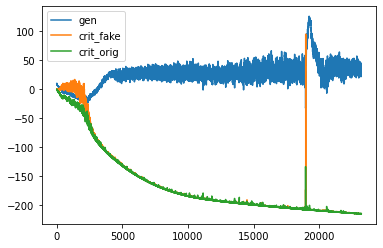

d loss fake  -215.63723754882812
d loss real  -215.37518310546875
[Epoch 68/100] [Batch 151/345] [D loss: -215.506210, acc:   0%] [G loss: 44.154140] [c1: 28.566799, c2: 28.609047, o: 73.244705, f: 18.911268] time: 15:01:53.573844
d loss fake  -215.67398071289062
d loss real  -215.71307373046875
[Epoch 68/100] [Batch 152/345] [D loss: -215.693527, acc:   0%] [G loss: 37.906563] [c1: 19.620621, c2: 19.648056, o: 83.287102, f: 27.505205] time: 15:01:55.860566
d loss fake  -215.67697143554688
d loss real  -215.66172790527344
[Epoch 68/100] [Batch 153/345] [D loss: -215.669350, acc:   0%] [G loss: 38.312732] [c1: 21.266190, c2: 21.192097, o: 74.239563, f: 18.336168] time: 15:01:58.138128
d loss fake  -215.65005493164062
d loss real  -215.701904296875
[Epoch 68/100] [Batch 154/345] [D loss: -215.675980, acc:   0%] [G loss: 40.039993] [c1: 26.629650, c2: 26.322025, o: 76.030243, f: 23.723890] time: 15:02:00.433842
d loss fake  -215.67813110351562
d loss real  -215.7001953125
[Epoch 68/100] [

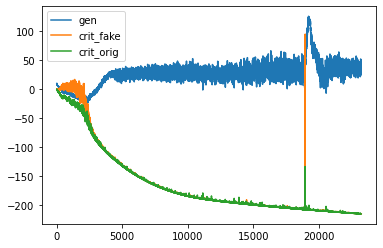

d loss fake  -215.71737670898438
d loss real  -215.78985595703125
[Epoch 68/100] [Batch 201/345] [D loss: -215.753616, acc:   0%] [G loss: 46.317898] [c1: 33.839462, c2: 33.793327, o: 77.693085, f: 25.222553] time: 15:03:48.512608
d loss fake  -215.73260498046875
d loss real  -215.78965759277344
[Epoch 68/100] [Batch 202/345] [D loss: -215.761131, acc:   0%] [G loss: 41.738158] [c1: 26.554768, c2: 26.578491, o: 85.923340, f: 34.725945] time: 15:03:50.805483
d loss fake  -215.7596893310547
d loss real  -215.74610900878906
[Epoch 68/100] [Batch 203/345] [D loss: -215.752899, acc:   0%] [G loss: 40.775181] [c1: 27.030817, c2: 26.974907, o: 76.662766, f: 26.044407] time: 15:03:53.083739
d loss fake  -215.77249145507812
d loss real  -215.80072021484375
[Epoch 68/100] [Batch 204/345] [D loss: -215.786606, acc:   0%] [G loss: 42.797791] [c1: 29.081898, c2: 29.028748, o: 81.545883, f: 26.389271] time: 15:03:55.360190
d loss fake  -215.718994140625
d loss real  -215.6420135498047
[Epoch 68/100]

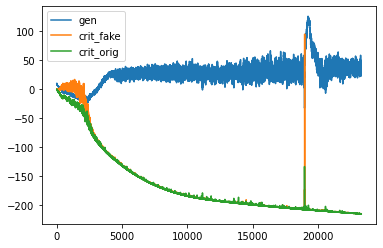

d loss fake  -215.81619262695312
d loss real  -215.76287841796875
[Epoch 68/100] [Batch 251/345] [D loss: -215.789536, acc:   0%] [G loss: 43.189515] [c1: 29.327812, c2: 29.191662, o: 76.048950, f: 18.849197] time: 15:05:44.870924
d loss fake  -215.70899963378906
d loss real  -215.87130737304688
[Epoch 68/100] [Batch 252/345] [D loss: -215.790154, acc:   0%] [G loss: 35.642434] [c1: 15.242012, c2: 15.272009, o: 85.190948, f: 28.039227] time: 15:05:47.171667
d loss fake  -215.8109893798828
d loss real  -215.8987579345703
[Epoch 68/100] [Batch 253/345] [D loss: -215.854874, acc:   0%] [G loss: 33.558830] [c1: 11.389193, c2: 11.334978, o: 71.803452, f: 17.392296] time: 15:05:49.468080
d loss fake  -215.8177032470703
d loss real  -215.80078125
[Epoch 68/100] [Batch 254/345] [D loss: -215.809242, acc:   0%] [G loss: 25.471902] [c1: 1.568880, c2: 1.655291, o: 64.552635, f: 10.957331] time: 15:05:51.768776
d loss fake  -215.76528930664062
d loss real  -215.74978637695312
[Epoch 68/100] [Batch

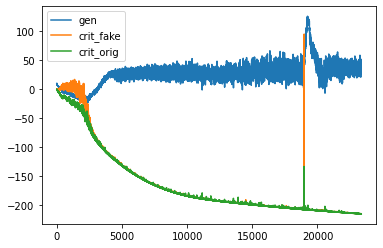

d loss fake  -215.8038787841797
d loss real  -215.92718505859375
[Epoch 68/100] [Batch 301/345] [D loss: -215.865532, acc:   0%] [G loss: 29.467077] [c1: 9.938876, c2: 9.829969, o: 65.722885, f: 12.583990] time: 15:07:40.645126
d loss fake  -215.854248046875
d loss real  -215.94522094726562
[Epoch 68/100] [Batch 302/345] [D loss: -215.899734, acc:   0%] [G loss: 26.649629] [c1: 5.679877, c2: 5.842499, o: 63.946033, f: 11.650815] time: 15:07:42.937913
d loss fake  -215.8663330078125
d loss real  -215.66416931152344
[Epoch 68/100] [Batch 303/345] [D loss: -215.765251, acc:   0%] [G loss: 33.400185] [c1: 14.236855, c2: 14.219637, o: 57.474541, f: 3.840808] time: 15:07:45.229421
d loss fake  -215.88516235351562
d loss real  -215.81594848632812
[Epoch 68/100] [Batch 304/345] [D loss: -215.850555, acc:   0%] [G loss: 44.045772] [c1: 28.291813, c2: 28.269001, o: 70.000298, f: 16.374237] time: 15:07:47.529217
d loss fake  -215.85643005371094
d loss real  -215.93374633789062
[Epoch 68/100] [Bat

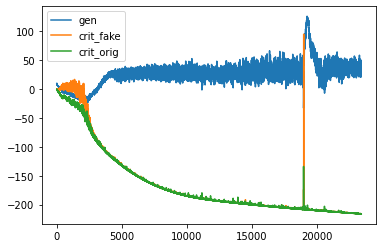

d loss fake  -215.91839599609375
d loss real  -216.01748657226562
[Epoch 69/100] [Batch 1/345] [D loss: -215.967941, acc:   0%] [G loss: 27.173743] [c1: 5.329501, c2: 5.114282, o: 65.006638, f: 13.240220] time: 15:09:16.901599
d loss fake  -215.85675048828125
d loss real  -215.98391723632812
[Epoch 69/100] [Batch 2/345] [D loss: -215.920334, acc:   0%] [G loss: 23.808212] [c1: 0.189680, c2: 0.140761, o: 58.082924, f: 5.138066] time: 15:09:19.236115
d loss fake  -215.81832885742188
d loss real  -215.9603271484375
[Epoch 69/100] [Batch 3/345] [D loss: -215.889328, acc:   0%] [G loss: 22.990448] [c1: -1.891850, c2: -2.062517, o: 53.606133, f: -0.442007] time: 15:09:21.584353
d loss fake  -215.897216796875
d loss real  -215.96392822265625
[Epoch 69/100] [Batch 4/345] [D loss: -215.930573, acc:   0%] [G loss: 31.615955] [c1: 14.465540, c2: 14.059980, o: 54.126904, f: 0.854159] time: 15:09:23.919677
d loss fake  -215.95135498046875
d loss real  -215.99566650390625
[Epoch 69/100] [Batch 5/345

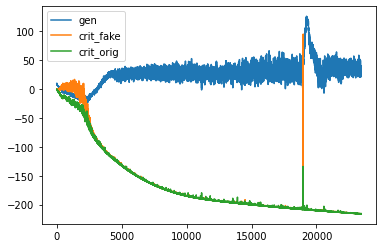

d loss fake  -215.87393188476562
d loss real  -216.07730102539062
[Epoch 69/100] [Batch 51/345] [D loss: -215.975616, acc:   0%] [G loss: 27.271433] [c1: 1.808846, c2: 1.839984, o: 67.867950, f: 10.420771] time: 15:11:12.313365
d loss fake  -216.03797912597656
d loss real  -216.08981323242188
[Epoch 69/100] [Batch 52/345] [D loss: -216.063896, acc:   0%] [G loss: 27.304065] [c1: 5.189664, c2: 5.139251, o: 59.118744, f: 2.617233] time: 15:11:14.606578
d loss fake  -216.0315399169922
d loss real  -216.0428009033203
[Epoch 69/100] [Batch 53/345] [D loss: -216.037170, acc:   0%] [G loss: 36.395628] [c1: 19.009981, c2: 18.604046, o: 61.730736, f: 6.156328] time: 15:11:16.896030
d loss fake  -216.06326293945312
d loss real  -216.0626220703125
[Epoch 69/100] [Batch 54/345] [D loss: -216.062943, acc:   0%] [G loss: 35.492011] [c1: 18.798666, c2: 18.672277, o: 73.271927, f: 17.978821] time: 15:11:19.188636
d loss fake  -216.0401611328125
d loss real  -216.08782958984375
[Epoch 69/100] [Batch 55

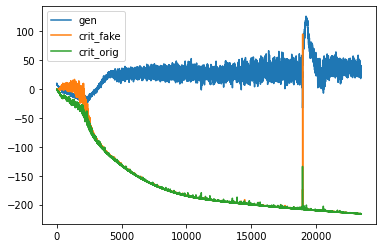

d loss fake  -215.94757080078125
d loss real  -216.0780487060547
[Epoch 69/100] [Batch 101/345] [D loss: -216.012810, acc:   0%] [G loss: 30.092445] [c1: 9.237910, c2: 9.107350, o: 70.848206, f: 12.119993] time: 15:13:08.909586
d loss fake  -216.09552001953125
d loss real  -216.13400268554688
[Epoch 69/100] [Batch 102/345] [D loss: -216.114761, acc:   0%] [G loss: 22.996182] [c1: -0.043977, c2: -0.185845, o: 67.498154, f: 9.696505] time: 15:13:11.208578
d loss fake  -216.13621520996094
d loss real  -216.15774536132812
[Epoch 69/100] [Batch 103/345] [D loss: -216.146980, acc:   0%] [G loss: 22.325138] [c1: -1.614925, c2: -1.898270, o: 56.068687, f: -0.619992] time: 15:13:13.497242
d loss fake  -216.13125610351562
d loss real  -216.1634063720703
[Epoch 69/100] [Batch 104/345] [D loss: -216.147331, acc:   0%] [G loss: 30.151206] [c1: 11.629555, c2: 11.389827, o: 54.168488, f: 0.875021] time: 15:13:15.789655
d loss fake  -216.0703887939453
d loss real  -216.169921875
[Epoch 69/100] [Batch 

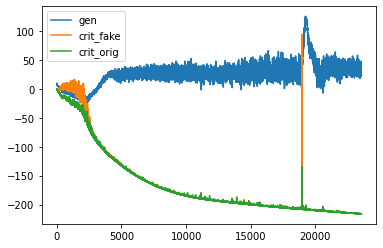

d loss fake  -216.11215209960938
d loss real  -216.18365478515625
[Epoch 69/100] [Batch 151/345] [D loss: -216.147903, acc:   0%] [G loss: 48.530791] [c1: 38.615570, c2: 38.628433, o: 77.466827, f: 21.193916] time: 15:15:05.137849
d loss fake  -216.2052001953125
d loss real  -216.22613525390625
[Epoch 69/100] [Batch 152/345] [D loss: -216.215668, acc:   0%] [G loss: 40.281046] [c1: 25.022163, c2: 24.854900, o: 94.194572, f: 38.268852] time: 15:15:07.428604
d loss fake  -216.17958068847656
d loss real  -216.23194885253906
[Epoch 69/100] [Batch 153/345] [D loss: -216.205765, acc:   0%] [G loss: 37.225975] [c1: 20.225899, c2: 20.151958, o: 79.315590, f: 24.073689] time: 15:15:09.699425
d loss fake  -216.20896911621094
d loss real  -216.13954162597656
[Epoch 69/100] [Batch 154/345] [D loss: -216.174255, acc:   0%] [G loss: 41.032445] [c1: 25.717636, c2: 25.647015, o: 74.899475, f: 20.907532] time: 15:15:11.985558
d loss fake  -216.1392822265625
d loss real  -216.25021362304688
[Epoch 69/10

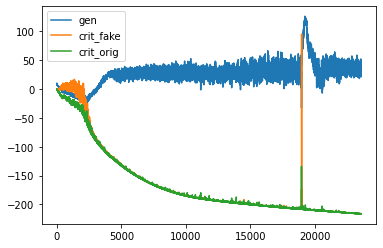

d loss fake  -216.25486755371094
d loss real  -216.22247314453125
[Epoch 69/100] [Batch 201/345] [D loss: -216.238670, acc:   0%] [G loss: 53.278440] [c1: 46.638847, c2: 46.557365, o: 88.815567, f: 36.508728] time: 15:17:00.360841
d loss fake  -216.28948974609375
d loss real  -216.33547973632812
[Epoch 69/100] [Batch 202/345] [D loss: -216.312485, acc:   0%] [G loss: 52.455781] [c1: 42.638168, c2: 42.620647, o: 98.945175, f: 46.527641] time: 15:17:02.653033
d loss fake  -216.21841430664062
d loss real  -216.31228637695312
[Epoch 69/100] [Batch 203/345] [D loss: -216.265350, acc:   0%] [G loss: 41.972336] [c1: 30.434771, c2: 30.411524, o: 93.795097, f: 44.339439] time: 15:17:04.935180
d loss fake  -216.2955322265625
d loss real  -216.26351928710938
[Epoch 69/100] [Batch 204/345] [D loss: -216.279526, acc:   0%] [G loss: 45.635071] [c1: 34.093063, c2: 33.939293, o: 82.440186, f: 29.878561] time: 15:17:07.218924
d loss fake  -216.31460571289062
d loss real  -216.27992248535156
[Epoch 69/1

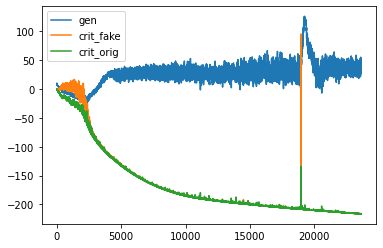

d loss fake  -216.3756866455078
d loss real  -216.39556884765625
[Epoch 69/100] [Batch 251/345] [D loss: -216.385628, acc:   0%] [G loss: 26.663674] [c1: 5.315939, c2: 5.190188, o: 61.515312, f: 8.235090] time: 15:18:56.363111
d loss fake  -216.37937927246094
d loss real  -216.3885040283203
[Epoch 69/100] [Batch 252/345] [D loss: -216.383942, acc:   0%] [G loss: 30.963604] [c1: 11.662930, c2: 11.603008, o: 57.029869, f: 6.017102] time: 15:18:58.663949
d loss fake  -216.37632751464844
d loss real  -216.40182495117188
[Epoch 69/100] [Batch 253/345] [D loss: -216.389076, acc:   0%] [G loss: 31.989151] [c1: 14.952130, c2: 14.779075, o: 64.700592, f: 11.680387] time: 15:19:00.944511
d loss fake  -216.38311767578125
d loss real  -216.4267578125
[Epoch 69/100] [Batch 254/345] [D loss: -216.404938, acc:   0%] [G loss: 35.113626] [c1: 18.832142, c2: 18.653969, o: 66.746613, f: 14.842607] time: 15:19:03.234896
d loss fake  -216.3773956298828
d loss real  -216.34576416015625
[Epoch 69/100] [Batch

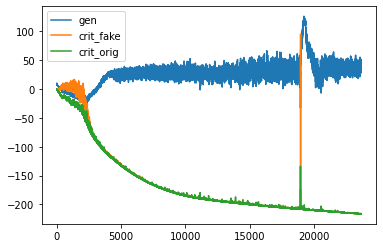

d loss fake  -216.40603637695312
d loss real  -216.4420928955078
[Epoch 69/100] [Batch 301/345] [D loss: -216.424065, acc:   0%] [G loss: 27.781909] [c1: 6.697893, c2: 6.518176, o: 67.304993, f: 13.333904] time: 15:20:52.659436
d loss fake  -216.4186553955078
d loss real  -216.45046997070312
[Epoch 69/100] [Batch 302/345] [D loss: -216.434563, acc:   0%] [G loss: 36.933838] [c1: 20.357214, c2: 20.091076, o: 61.522945, f: 9.581524] time: 15:20:54.954126
d loss fake  -216.43081665039062
d loss real  -216.47430419921875
[Epoch 69/100] [Batch 303/345] [D loss: -216.452560, acc:   0%] [G loss: 30.948308] [c1: 11.603840, c2: 11.426455, o: 71.378624, f: 18.796831] time: 15:20:57.240034
d loss fake  -216.4373779296875
d loss real  -216.036865234375
[Epoch 69/100] [Batch 304/345] [D loss: -216.237122, acc:   0%] [G loss: 40.919284] [c1: 26.591541, c2: 26.476761, o: 65.762299, f: 13.777462] time: 15:20:59.529675
d loss fake  -216.45944213867188
d loss real  -216.48263549804688
[Epoch 69/100] [Ba

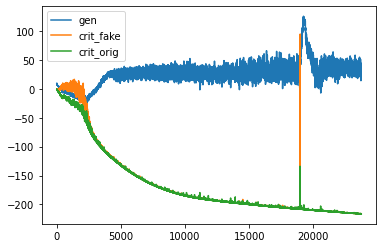

d loss fake  -216.0665283203125
d loss real  -216.40045166015625
[Epoch 70/100] [Batch 1/345] [D loss: -216.233490, acc:   0%] [G loss: 22.579781] [c1: 1.039130, c2: 0.710417, o: 55.191673, f: 2.945728] time: 15:22:28.415424
d loss fake  -216.2049102783203
d loss real  -216.52328491210938
[Epoch 70/100] [Batch 2/345] [D loss: -216.364098, acc:   0%] [G loss: 22.087016] [c1: -2.201653, c2: -2.310543, o: 52.850204, f: 0.788563] time: 15:22:30.759101
d loss fake  -216.13868713378906
d loss real  -216.42733764648438
[Epoch 70/100] [Batch 3/345] [D loss: -216.283012, acc:   0%] [G loss: 21.070960] [c1: -2.970443, c2: -3.105118, o: 50.629505, f: -2.453556] time: 15:22:33.104436
d loss fake  -216.45567321777344
d loss real  -216.49575805664062
[Epoch 70/100] [Batch 4/345] [D loss: -216.475716, acc:   0%] [G loss: 33.231518] [c1: 13.792091, c2: 13.587007, o: 54.368832, f: -1.010102] time: 15:22:35.451978
d loss fake  -216.40579223632812
d loss real  -216.52752685546875
[Epoch 70/100] [Batch 5/

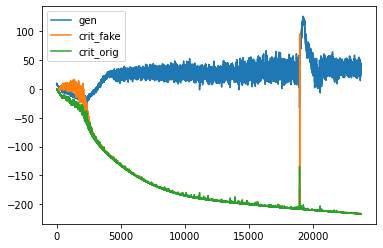

d loss fake  -216.57559204101562
d loss real  -216.39227294921875
[Epoch 70/100] [Batch 51/345] [D loss: -216.483932, acc:   0%] [G loss: 35.152878] [c1: 17.725508, c2: 17.608162, o: 65.449677, f: 12.766316] time: 15:24:24.039501
d loss fake  -216.38912963867188
d loss real  -216.53143310546875
[Epoch 70/100] [Batch 52/345] [D loss: -216.460281, acc:   0%] [G loss: 31.302387] [c1: 12.605649, c2: 12.587088, o: 72.337891, f: 17.323088] time: 15:24:26.322443
d loss fake  -216.4803924560547
d loss real  -216.29440307617188
[Epoch 70/100] [Batch 53/345] [D loss: -216.387398, acc:   0%] [G loss: 35.139965] [c1: 17.216282, c2: 16.998573, o: 69.109848, f: 13.822592] time: 15:24:28.612530
d loss fake  -216.55368041992188
d loss real  -216.60023498535156
[Epoch 70/100] [Batch 54/345] [D loss: -216.576958, acc:   0%] [G loss: 30.617935] [c1: 9.646865, c2: 9.422644, o: 73.334320, f: 15.828766] time: 15:24:30.906149
d loss fake  -216.39990234375
d loss real  -216.60597229003906
[Epoch 70/100] [Batc

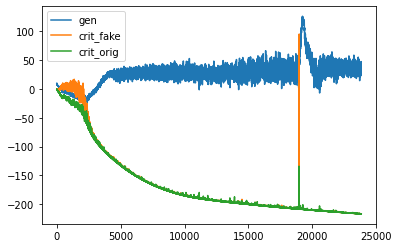

d loss fake  -216.63877868652344
d loss real  -216.29299926757812
[Epoch 70/100] [Batch 101/345] [D loss: -216.465889, acc:   0%] [G loss: 36.449403] [c1: 20.463535, c2: 20.438751, o: 64.890976, f: 13.038638] time: 15:26:20.265551
d loss fake  -216.65090942382812
d loss real  -216.65109252929688
[Epoch 70/100] [Batch 102/345] [D loss: -216.651001, acc:   0%] [G loss: 36.882908] [c1: 19.275631, c2: 19.202866, o: 75.645119, f: 18.648531] time: 15:26:22.561204
d loss fake  -216.67172241210938
d loss real  -216.49441528320312
[Epoch 70/100] [Batch 103/345] [D loss: -216.583069, acc:   0%] [G loss: 44.308718] [c1: 32.081009, c2: 31.802843, o: 78.585289, f: 20.973024] time: 15:26:24.853739
d loss fake  -216.6126708984375
d loss real  -216.62911987304688
[Epoch 70/100] [Batch 104/345] [D loss: -216.620895, acc:   0%] [G loss: 35.054688] [c1: 14.890787, c2: 15.058916, o: 85.952888, f: 30.909685] time: 15:26:27.150529
d loss fake  -216.6592559814453
d loss real  -216.71084594726562
[Epoch 70/10

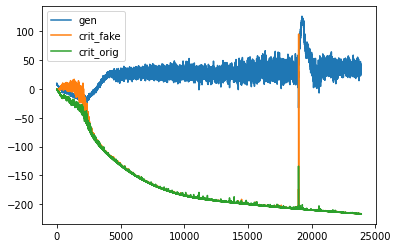

d loss fake  -216.7430419921875
d loss real  -216.697509765625
[Epoch 70/100] [Batch 151/345] [D loss: -216.720276, acc:   0%] [G loss: 41.969612] [c1: 27.259022, c2: 27.280853, o: 78.899780, f: 26.855255] time: 15:28:16.878017
d loss fake  -216.73513793945312
d loss real  -216.76856994628906
[Epoch 70/100] [Batch 152/345] [D loss: -216.751854, acc:   0%] [G loss: 40.042409] [c1: 25.095800, c2: 25.234892, o: 83.065247, f: 28.215485] time: 15:28:19.165912
d loss fake  -216.7115020751953
d loss real  -216.77696228027344
[Epoch 70/100] [Batch 153/345] [D loss: -216.744232, acc:   0%] [G loss: 40.624370] [c1: 27.069996, c2: 27.196089, o: 80.839844, f: 24.343647] time: 15:28:21.453106
d loss fake  -216.74656677246094
d loss real  -216.7512664794922
[Epoch 70/100] [Batch 154/345] [D loss: -216.748917, acc:   0%] [G loss: 38.495805] [c1: 23.570705, c2: 23.471130, o: 82.524796, f: 28.589310] time: 15:28:23.745670
d loss fake  -216.76629638671875
d loss real  -216.75750732421875
[Epoch 70/100] 

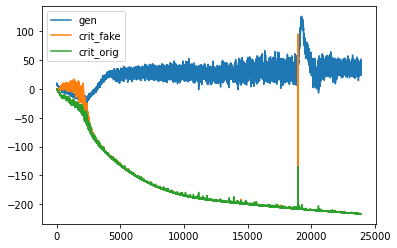

d loss fake  -216.79913330078125
d loss real  -216.65618896484375
[Epoch 70/100] [Batch 201/345] [D loss: -216.727661, acc:   0%] [G loss: 54.301626] [c1: 47.324684, c2: 47.272594, o: 91.363693, f: 36.396210] time: 15:30:12.231408
d loss fake  -216.8212890625
d loss real  -216.86630249023438
[Epoch 70/100] [Batch 202/345] [D loss: -216.843796, acc:   0%] [G loss: 53.261145] [c1: 46.268112, c2: 46.241287, o: 101.020882, f: 47.656631] time: 15:30:14.538189
d loss fake  -216.8380126953125
d loss real  -216.841064453125
[Epoch 70/100] [Batch 203/345] [D loss: -216.839539, acc:   0%] [G loss: 46.722899] [c1: 36.926785, c2: 36.775635, o: 98.852386, f: 46.060539] time: 15:30:16.833944
d loss fake  -216.8142852783203
d loss real  -216.72085571289062
[Epoch 70/100] [Batch 204/345] [D loss: -216.767570, acc:   0%] [G loss: 50.482663] [c1: 44.105129, c2: 43.988350, o: 91.106354, f: 38.566483] time: 15:30:19.123999
d loss fake  -216.7421875
d loss real  -216.8578643798828
[Epoch 70/100] [Batch 205

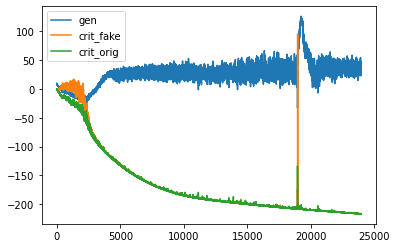

d loss fake  -216.9021453857422
d loss real  -216.9187469482422
[Epoch 70/100] [Batch 251/345] [D loss: -216.910446, acc:   0%] [G loss: 29.091775] [c1: 7.930445, c2: 7.738809, o: 69.905884, f: 15.879707] time: 15:32:08.683680
d loss fake  -216.8999786376953
d loss real  -216.93975830078125
[Epoch 70/100] [Batch 252/345] [D loss: -216.919868, acc:   0%] [G loss: 28.678057] [c1: 9.494510, c2: 9.286697, o: 60.612144, f: 9.289091] time: 15:32:10.976990
d loss fake  -216.78079223632812
d loss real  -216.9458770751953
[Epoch 70/100] [Batch 253/345] [D loss: -216.863335, acc:   0%] [G loss: 24.953477] [c1: 2.418082, c2: 2.321941, o: 59.835690, f: 7.629270] time: 15:32:13.268231
d loss fake  -216.69747924804688
d loss real  -216.9464111328125
[Epoch 70/100] [Batch 254/345] [D loss: -216.821945, acc:   0%] [G loss: 21.650234] [c1: -2.254515, c2: -2.178370, o: 54.550934, f: 3.049464] time: 15:32:15.547170
d loss fake  -216.89186096191406
d loss real  -216.73146057128906
[Epoch 70/100] [Batch 25

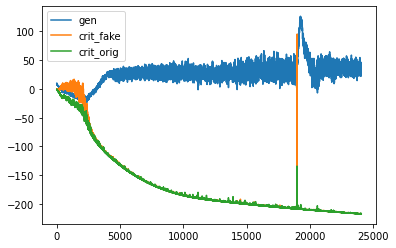

d loss fake  -216.83013916015625
d loss real  -217.00213623046875
[Epoch 70/100] [Batch 301/345] [D loss: -216.916138, acc:   0%] [G loss: 23.890920] [c1: 1.291259, c2: 1.046536, o: 56.152908, f: 5.959631] time: 15:34:04.739696
d loss fake  -216.92984008789062
d loss real  -216.99075317382812
[Epoch 70/100] [Batch 302/345] [D loss: -216.960297, acc:   0%] [G loss: 25.038827] [c1: 3.099283, c2: 2.714064, o: 52.781284, f: 1.576669] time: 15:34:07.029847
d loss fake  -216.94784545898438
d loss real  -216.8047332763672
[Epoch 70/100] [Batch 303/345] [D loss: -216.876289, acc:   0%] [G loss: 38.181422] [c1: 24.923985, c2: 24.784697, o: 55.668213, f: 4.806168] time: 15:34:09.309936
d loss fake  -216.72108459472656
d loss real  -216.96395874023438
[Epoch 70/100] [Batch 304/345] [D loss: -216.842522, acc:   0%] [G loss: 29.487235] [c1: 11.106898, c2: 11.016260, o: 75.302177, f: 25.302887] time: 15:34:11.601104
d loss fake  -216.96005249023438
d loss real  -216.98040771484375
[Epoch 70/100] [Ba

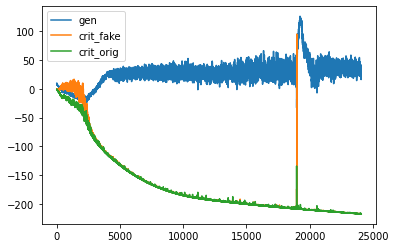

d loss fake  -216.9896240234375
d loss real  -217.0069580078125
[Epoch 71/100] [Batch 1/345] [D loss: -216.998291, acc:   0%] [G loss: 25.830188] [c1: 1.903095, c2: 1.688597, o: 39.837154, f: -10.405150] time: 15:35:41.455582
d loss fake  -216.96575927734375
d loss real  -217.02621459960938
[Epoch 71/100] [Batch 2/345] [D loss: -216.995987, acc:   0%] [G loss: 23.789210] [c1: -0.864816, c2: -0.924863, o: 52.256752, f: 1.199482] time: 15:35:43.796085
d loss fake  -216.75582885742188
d loss real  -217.0422821044922
[Epoch 71/100] [Batch 3/345] [D loss: -216.899055, acc:   0%] [G loss: 12.265616] [c1: -14.666929, c2: -14.781384, o: 50.979218, f: 1.007823] time: 15:35:46.143978
d loss fake  -216.9928436279297
d loss real  -217.01986694335938
[Epoch 71/100] [Batch 4/345] [D loss: -217.006355, acc:   0%] [G loss: 20.521991] [c1: -3.488055, c2: -3.503918, o: 36.340332, f: -15.632397] time: 15:35:48.473991
d loss fake  -216.97268676757812
d loss real  -217.00022888183594
[Epoch 71/100] [Batch 

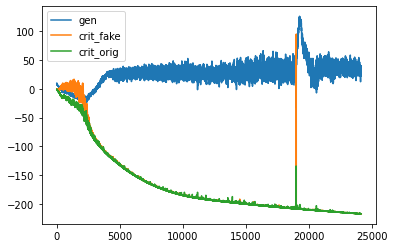

d loss fake  -217.09617614746094
d loss real  -217.10638427734375
[Epoch 71/100] [Batch 51/345] [D loss: -217.101280, acc:   0%] [G loss: 28.508965] [c1: 9.945286, c2: 9.474558, o: 52.938931, f: 1.676551] time: 15:37:36.837558
d loss fake  -217.08786010742188
d loss real  -217.09268188476562
[Epoch 71/100] [Batch 52/345] [D loss: -217.090271, acc:   0%] [G loss: 30.886797] [c1: 11.574450, c2: 11.361734, o: 62.987396, f: 9.303902] time: 15:37:39.124211
d loss fake  -216.88723754882812
d loss real  -216.79356384277344
[Epoch 71/100] [Batch 53/345] [D loss: -216.840401, acc:   0%] [G loss: 30.894381] [c1: 11.259850, c2: 11.246582, o: 64.451904, f: 11.715652] time: 15:37:41.417445
d loss fake  -217.05039978027344
d loss real  -217.14303588867188
[Epoch 71/100] [Batch 54/345] [D loss: -217.096718, acc:   0%] [G loss: 34.295331] [c1: 16.451319, c2: 16.287601, o: 68.064117, f: 13.026432] time: 15:37:43.705799
d loss fake  -217.08644104003906
d loss real  -217.12496948242188
[Epoch 71/100] [Ba

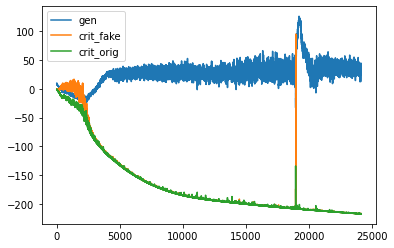

d loss fake  -217.07278442382812
d loss real  -216.54107666015625
[Epoch 71/100] [Batch 101/345] [D loss: -216.806931, acc:   0%] [G loss: 42.135448] [c1: 27.847233, c2: 27.846781, o: 80.620758, f: 24.231346] time: 15:39:33.417778
d loss fake  -216.93075561523438
d loss real  -217.17605590820312
[Epoch 71/100] [Batch 102/345] [D loss: -217.053406, acc:   0%] [G loss: 33.869718] [c1: 15.826944, c2: 15.707270, o: 87.013008, f: 27.134007] time: 15:39:35.708954
d loss fake  -217.1632080078125
d loss real  -217.21778869628906
[Epoch 71/100] [Batch 103/345] [D loss: -217.190498, acc:   0%] [G loss: 27.677388] [c1: 7.386460, c2: 7.147135, o: 73.435791, f: 14.380478] time: 15:39:37.990057
d loss fake  -217.1666259765625
d loss real  -217.22178649902344
[Epoch 71/100] [Batch 104/345] [D loss: -217.194206, acc:   0%] [G loss: 23.069908] [c1: -1.096821, c2: -1.478596, o: 63.608891, f: 6.517149] time: 15:39:40.286139
d loss fake  -217.18505859375
d loss real  -217.15505981445312
[Epoch 71/100] [Ba

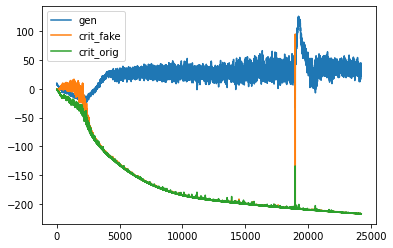

d loss fake  -217.20350646972656
d loss real  -217.27516174316406
[Epoch 71/100] [Batch 151/345] [D loss: -217.239334, acc:   0%] [G loss: 37.425765] [c1: 21.179552, c2: 21.225519, o: 85.797745, f: 31.928371] time: 15:41:29.878813
d loss fake  -217.25088500976562
d loss real  -217.2671356201172
[Epoch 71/100] [Batch 152/345] [D loss: -217.259010, acc:   0%] [G loss: 39.659461] [c1: 23.114859, c2: 23.251373, o: 76.701027, f: 19.853203] time: 15:41:32.168195
d loss fake  -217.2638397216797
d loss real  -217.28933715820312
[Epoch 71/100] [Batch 153/345] [D loss: -217.276588, acc:   0%] [G loss: 36.160714] [c1: 18.954517, c2: 18.919846, o: 80.786469, f: 24.311085] time: 15:41:34.451716
d loss fake  -217.27554321289062
d loss real  -217.32794189453125
[Epoch 71/100] [Batch 154/345] [D loss: -217.301743, acc:   0%] [G loss: 31.770140] [c1: 11.868170, c2: 11.804543, o: 71.875870, f: 18.719639] time: 15:41:36.744860
d loss fake  -217.21426391601562
d loss real  -217.29840087890625
[Epoch 71/10

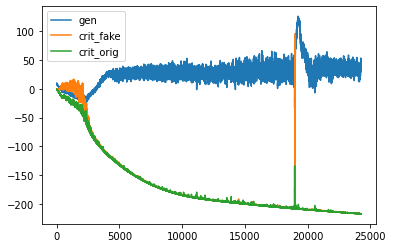

d loss fake  -217.3628692626953
d loss real  -217.39657592773438
[Epoch 71/100] [Batch 201/345] [D loss: -217.379723, acc:   0%] [G loss: 31.558651] [c1: 15.257627, c2: 15.119733, o: 64.692543, f: 14.306009] time: 15:43:25.320498
d loss fake  -217.3704071044922
d loss real  -217.390380859375
[Epoch 71/100] [Batch 202/345] [D loss: -217.380394, acc:   0%] [G loss: 32.122921] [c1: 16.058464, c2: 15.957842, o: 65.406631, f: 15.195675] time: 15:43:27.608513
d loss fake  -217.35923767089844
d loss real  -217.40638732910156
[Epoch 71/100] [Batch 203/345] [D loss: -217.382812, acc:   0%] [G loss: 32.990272] [c1: 17.686340, c2: 17.686520, o: 65.526840, f: 15.815152] time: 15:43:29.882814
d loss fake  -217.34872436523438
d loss real  -217.37908935546875
[Epoch 71/100] [Batch 204/345] [D loss: -217.363907, acc:   0%] [G loss: 37.545107] [c1: 23.876711, c2: 23.888054, o: 69.346680, f: 19.634436] time: 15:43:32.169980
d loss fake  -217.32858276367188
d loss real  -217.3819580078125
[Epoch 71/100] 

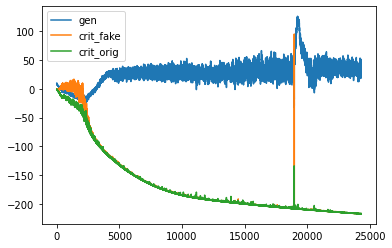

d loss fake  -217.40037536621094
d loss real  -217.48007202148438
[Epoch 71/100] [Batch 251/345] [D loss: -217.440224, acc:   0%] [G loss: 40.010334] [c1: 26.748655, c2: 26.680864, o: 73.868378, f: 23.667355] time: 15:45:21.238216
d loss fake  -217.33644104003906
d loss real  -217.20130920410156
[Epoch 71/100] [Batch 252/345] [D loss: -217.268875, acc:   0%] [G loss: 51.347859] [c1: 42.651577, c2: 42.536083, o: 76.224068, f: 27.369579] time: 15:45:23.531174
d loss fake  -217.36813354492188
d loss real  -217.45925903320312
[Epoch 71/100] [Batch 253/345] [D loss: -217.413696, acc:   0%] [G loss: 42.514770] [c1: 27.398846, c2: 27.367899, o: 94.218689, f: 40.333900] time: 15:45:25.821610
d loss fake  -217.24452209472656
d loss real  -217.45565795898438
[Epoch 71/100] [Batch 254/345] [D loss: -217.350090, acc:   0%] [G loss: 33.787543] [c1: 16.212065, c2: 16.033178, o: 80.425552, f: 27.605488] time: 15:45:28.117422
d loss fake  -217.31076049804688
d loss real  -217.42747497558594
[Epoch 71/

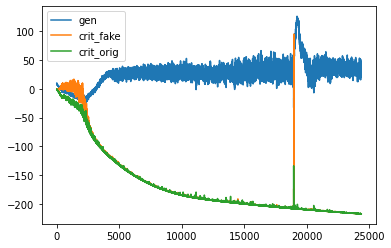

d loss fake  -217.50912475585938
d loss real  -217.53260803222656
[Epoch 71/100] [Batch 301/345] [D loss: -217.520866, acc:   0%] [G loss: 34.185203] [c1: 17.697958, c2: 17.765385, o: 65.658020, f: 17.583828] time: 15:47:17.360128
d loss fake  -217.50770568847656
d loss real  -217.4676055908203
[Epoch 71/100] [Batch 302/345] [D loss: -217.487656, acc:   0%] [G loss: 37.148147] [c1: 23.188133, c2: 23.194069, o: 66.908478, f: 18.092855] time: 15:47:19.644889
d loss fake  -217.48890686035156
d loss real  -217.45359802246094
[Epoch 71/100] [Batch 303/345] [D loss: -217.471252, acc:   0%] [G loss: 43.617539] [c1: 32.291340, c2: 32.156216, o: 72.602425, f: 23.636162] time: 15:47:21.928038
d loss fake  -217.48634338378906
d loss real  -217.46148681640625
[Epoch 71/100] [Batch 304/345] [D loss: -217.473915, acc:   0%] [G loss: 43.338288] [c1: 31.630894, c2: 31.489859, o: 84.346382, f: 31.703663] time: 15:47:24.215254
d loss fake  -217.50909423828125
d loss real  -217.524169921875
[Epoch 71/100

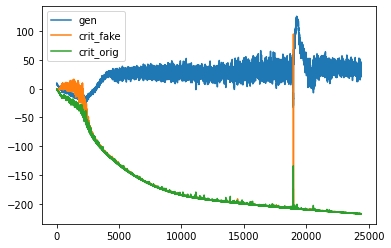

d loss fake  -217.4552001953125
d loss real  -217.53939819335938
[Epoch 72/100] [Batch 1/345] [D loss: -217.497299, acc:   0%] [G loss: 26.367134] [c1: 5.882360, c2: 5.873878, o: 55.110252, f: 4.965934] time: 15:48:52.468147
d loss fake  -217.47393798828125
d loss real  -217.561279296875
[Epoch 72/100] [Batch 2/345] [D loss: -217.517609, acc:   0%] [G loss: 23.321598] [c1: -0.240393, c2: -0.358150, o: 57.585289, f: 6.118647] time: 15:48:54.811778
d loss fake  -217.47061157226562
d loss real  -217.52024841308594
[Epoch 72/100] [Batch 3/345] [D loss: -217.495430, acc:   0%] [G loss: 18.761233] [c1: -4.540877, c2: -4.489259, o: 51.141499, f: 0.131893] time: 15:48:57.141256
d loss fake  -217.34494018554688
d loss real  -217.528076171875
[Epoch 72/100] [Batch 4/345] [D loss: -217.436508, acc:   0%] [G loss: 20.028994] [c1: -2.883281, c2: -2.838128, o: 47.933052, f: -3.909451] time: 15:48:59.474826
d loss fake  -217.5232696533203
d loss real  -217.55572509765625
[Epoch 72/100] [Batch 5/345] 

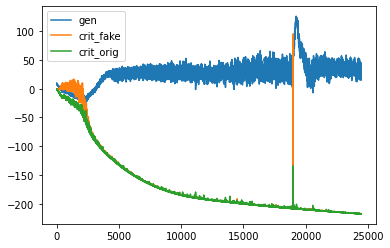

d loss fake  -217.5791015625
d loss real  -217.6614532470703
[Epoch 72/100] [Batch 51/345] [D loss: -217.620277, acc:   0%] [G loss: 26.100307] [c1: 7.355801, c2: 7.376437, o: 61.113770, f: 12.339781] time: 15:50:47.614007
d loss fake  -217.59518432617188
d loss real  -217.67617797851562
[Epoch 72/100] [Batch 52/345] [D loss: -217.635681, acc:   0%] [G loss: 23.066730] [c1: 1.035127, c2: 0.906598, o: 57.251308, f: 7.027699] time: 15:50:49.886484
d loss fake  -217.6337890625
d loss real  -217.41055297851562
[Epoch 72/100] [Batch 53/345] [D loss: -217.522171, acc:   0%] [G loss: 33.859115] [c1: 16.630880, c2: 16.441132, o: 52.559387, f: 1.067410] time: 15:50:52.162134
d loss fake  -217.575439453125
d loss real  -217.61270141601562
[Epoch 72/100] [Batch 54/345] [D loss: -217.594070, acc:   0%] [G loss: 32.879931] [c1: 15.474653, c2: 15.705729, o: 69.732758, f: 18.763626] time: 15:50:54.436887
d loss fake  -217.64599609375
d loss real  -217.5874786376953
[Epoch 72/100] [Batch 55/345] [D lo

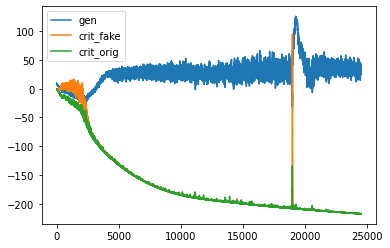

d loss fake  -217.70164489746094
d loss real  -217.7455596923828
[Epoch 72/100] [Batch 101/345] [D loss: -217.723602, acc:   0%] [G loss: 37.871103] [c1: 22.653736, c2: 22.774235, o: 78.521362, f: 21.430849] time: 15:52:43.247879
d loss fake  -217.7010498046875
d loss real  -217.73196411132812
[Epoch 72/100] [Batch 102/345] [D loss: -217.716507, acc:   0%] [G loss: 38.171194] [c1: 23.269371, c2: 23.255280, o: 76.188400, f: 21.149033] time: 15:52:45.532192
d loss fake  -217.72543334960938
d loss real  -217.7111053466797
[Epoch 72/100] [Batch 103/345] [D loss: -217.718269, acc:   0%] [G loss: 32.743571] [c1: 16.842194, c2: 16.446667, o: 78.066429, f: 24.311831] time: 15:52:47.817159
d loss fake  -217.65109252929688
d loss real  -217.21435546875
[Epoch 72/100] [Batch 104/345] [D loss: -217.432724, acc:   0%] [G loss: 35.198417] [c1: 18.104589, c2: 18.052029, o: 69.171783, f: 17.054771] time: 15:52:50.091969
d loss fake  -217.67587280273438
d loss real  -217.70541381835938
[Epoch 72/100] [

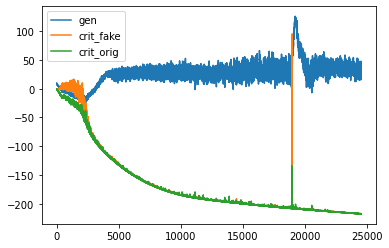

d loss fake  -217.74606323242188
d loss real  -217.8128662109375
[Epoch 72/100] [Batch 151/345] [D loss: -217.779465, acc:   0%] [G loss: 41.503827] [c1: 27.565142, c2: 27.426855, o: 80.582695, f: 28.209263] time: 15:54:39.219632
d loss fake  -217.802978515625
d loss real  -217.803466796875
[Epoch 72/100] [Batch 152/345] [D loss: -217.803223, acc:   0%] [G loss: 32.222138] [c1: 15.066917, c2: 15.013590, o: 78.637878, f: 28.068478] time: 15:54:41.499522
d loss fake  -217.77407836914062
d loss real  -217.67343139648438
[Epoch 72/100] [Batch 153/345] [D loss: -217.723755, acc:   0%] [G loss: 41.343018] [c1: 28.803383, c2: 28.773581, o: 64.700653, f: 14.969822] time: 15:54:43.785716
d loss fake  -217.6700897216797
d loss real  -217.75717163085938
[Epoch 72/100] [Batch 154/345] [D loss: -217.713631, acc:   0%] [G loss: 22.868909] [c1: 1.194482, c2: 1.242970, o: 79.633018, f: 27.572166] time: 15:54:46.069150
d loss fake  -217.77838134765625
d loss real  -217.69906616210938
[Epoch 72/100] [Ba

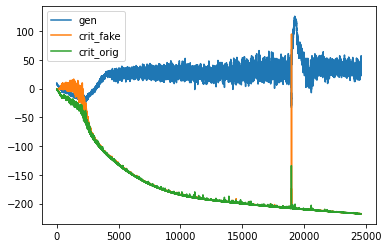

d loss fake  -217.893310546875
d loss real  -217.8631591796875
[Epoch 72/100] [Batch 201/345] [D loss: -217.878235, acc:   0%] [G loss: 35.555229] [c1: 22.253599, c2: 21.918087, o: 80.419678, f: 32.683495] time: 15:56:34.490486
d loss fake  -217.88772583007812
d loss real  -217.8868408203125
[Epoch 72/100] [Batch 202/345] [D loss: -217.887283, acc:   0%] [G loss: 35.070298] [c1: 22.083088, c2: 21.875147, o: 70.754990, f: 23.459494] time: 15:56:36.791220
d loss fake  -217.86883544921875
d loss real  -217.89987182617188
[Epoch 72/100] [Batch 203/345] [D loss: -217.884354, acc:   0%] [G loss: 34.254632] [c1: 21.861279, c2: 21.749207, o: 69.010582, f: 20.917309] time: 15:56:39.074407
d loss fake  -217.84312438964844
d loss real  -217.9010009765625
[Epoch 72/100] [Batch 204/345] [D loss: -217.872063, acc:   0%] [G loss: 30.065302] [c1: 14.494175, c2: 14.370063, o: 70.020111, f: 21.759214] time: 15:56:41.377373
d loss fake  -217.8657684326172
d loss real  -217.72166442871094
[Epoch 72/100] [

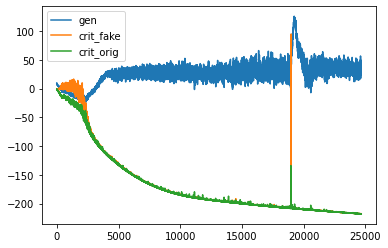

d loss fake  -217.95556640625
d loss real  -217.977783203125
[Epoch 72/100] [Batch 251/345] [D loss: -217.966675, acc:   0%] [G loss: 35.529542] [c1: 19.794031, c2: 19.810051, o: 64.536736, f: 12.446831] time: 15:58:30.977871
d loss fake  -217.95526123046875
d loss real  -217.9825897216797
[Epoch 72/100] [Batch 252/345] [D loss: -217.968925, acc:   0%] [G loss: 35.519543] [c1: 19.839561, c2: 19.630472, o: 71.330406, f: 20.671501] time: 15:58:33.265855
d loss fake  -217.9572296142578
d loss real  -217.9124755859375
[Epoch 72/100] [Batch 253/345] [D loss: -217.934853, acc:   0%] [G loss: 28.474902] [c1: 10.566502, c2: 10.379617, o: 69.712616, f: 21.451206] time: 15:58:35.544140
d loss fake  -217.93675231933594
d loss real  -217.97561645507812
[Epoch 72/100] [Batch 254/345] [D loss: -217.956184, acc:   0%] [G loss: 34.326046] [c1: 19.174553, c2: 18.987206, o: 58.553204, f: 8.655729] time: 15:58:37.842681
d loss fake  -217.91493225097656
d loss real  -217.92909240722656
[Epoch 72/100] [Bat

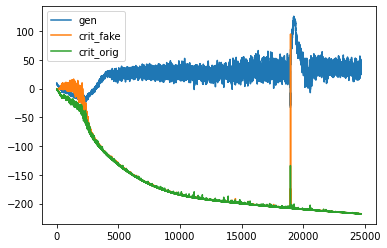

d loss fake  -218.00564575195312
d loss real  -218.0123748779297
[Epoch 72/100] [Batch 301/345] [D loss: -218.009010, acc:   0%] [G loss: 29.653401] [c1: 13.197617, c2: 12.967951, o: 58.446323, f: 9.966145] time: 16:00:27.110570
d loss fake  -218.0406494140625
d loss real  -218.06752014160156
[Epoch 72/100] [Batch 302/345] [D loss: -218.054085, acc:   0%] [G loss: 30.715437] [c1: 12.467243, c2: 12.165551, o: 63.010437, f: 11.701685] time: 16:00:29.400225
d loss fake  -217.9906768798828
d loss real  -218.0576629638672
[Epoch 72/100] [Batch 303/345] [D loss: -218.024170, acc:   0%] [G loss: 26.323842] [c1: 6.442531, c2: 6.134048, o: 61.766609, f: 12.988232] time: 16:00:31.672605
d loss fake  -218.03860473632812
d loss real  -218.06341552734375
[Epoch 72/100] [Batch 304/345] [D loss: -218.051010, acc:   0%] [G loss: 26.819255] [c1: 9.593747, c2: 9.374283, o: 55.073227, f: 6.580160] time: 16:00:33.956240
d loss fake  -218.05795288085938
d loss real  -218.053466796875
[Epoch 72/100] [Batch 

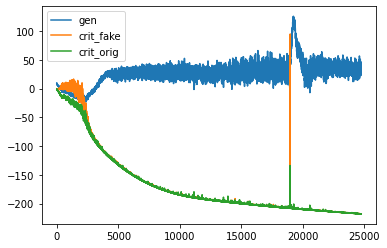

d loss fake  -218.0066375732422
d loss real  -218.07861328125
[Epoch 73/100] [Batch 1/345] [D loss: -218.042625, acc:   0%] [G loss: 27.046879] [c1: 3.133575, c2: 3.108136, o: 66.565987, f: 14.504698] time: 16:02:02.637056
d loss fake  -217.76876831054688
d loss real  -217.95408630371094
[Epoch 73/100] [Batch 2/345] [D loss: -217.861427, acc:   0%] [G loss: 25.691315] [c1: 3.393597, c2: 3.182412, o: 54.821644, f: 4.761340] time: 16:02:04.971637
d loss fake  -217.95069885253906
d loss real  -218.08018493652344
[Epoch 73/100] [Batch 3/345] [D loss: -218.015442, acc:   0%] [G loss: 22.685842] [c1: 0.868411, c2: 0.760269, o: 53.436249, f: 2.437630] time: 16:02:07.357300
d loss fake  -217.97288513183594
d loss real  -218.01307678222656
[Epoch 73/100] [Batch 4/345] [D loss: -217.992981, acc:   0%] [G loss: 25.717681] [c1: 6.645543, c2: 6.258368, o: 52.702698, f: 1.788282] time: 16:02:09.727835
d loss fake  -218.0775604248047
d loss real  -218.04150390625
[Epoch 73/100] [Batch 5/345] [D loss:

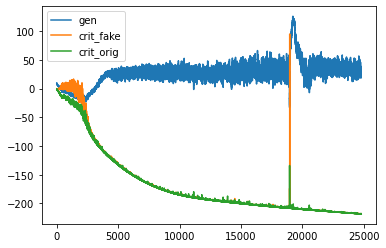

d loss fake  -218.12432861328125
d loss real  -218.14950561523438
[Epoch 73/100] [Batch 51/345] [D loss: -218.136917, acc:   0%] [G loss: 32.315281] [c1: 16.556219, c2: 16.391729, o: 65.614853, f: 10.574038] time: 16:03:58.035184
d loss fake  -218.14849853515625
d loss real  -218.16897583007812
[Epoch 73/100] [Batch 52/345] [D loss: -218.158737, acc:   0%] [G loss: 34.954112] [c1: 20.015320, c2: 19.781368, o: 69.760681, f: 17.075787] time: 16:04:00.320853
d loss fake  -218.16514587402344
d loss real  -218.19776916503906
[Epoch 73/100] [Batch 53/345] [D loss: -218.181458, acc:   0%] [G loss: 38.544802] [c1: 24.294853, c2: 24.103912, o: 72.225845, f: 20.037941] time: 16:04:02.610430
d loss fake  -218.13868713378906
d loss real  -218.20333862304688
[Epoch 73/100] [Batch 54/345] [D loss: -218.171013, acc:   0%] [G loss: 38.253772] [c1: 24.094007, c2: 23.844555, o: 75.785873, f: 24.524326] time: 16:04:04.899400
d loss fake  -218.04859924316406
d loss real  -218.18492126464844
[Epoch 73/100]

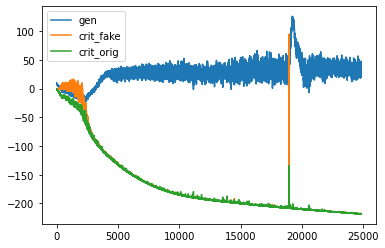

d loss fake  -218.22988891601562
d loss real  -218.25357055664062
[Epoch 73/100] [Batch 101/345] [D loss: -218.241730, acc:   0%] [G loss: 39.940704] [c1: 23.893620, c2: 24.060638, o: 89.321648, f: 34.275341] time: 16:05:54.434014
d loss fake  -218.23541259765625
d loss real  -218.22811889648438
[Epoch 73/100] [Batch 102/345] [D loss: -218.231766, acc:   0%] [G loss: 47.113377] [c1: 34.337036, c2: 34.832359, o: 80.187553, f: 24.782396] time: 16:05:56.725695
d loss fake  -218.22308349609375
d loss real  -218.20338439941406
[Epoch 73/100] [Batch 103/345] [D loss: -218.213234, acc:   0%] [G loss: 45.062489] [c1: 33.694290, c2: 33.899113, o: 88.326416, f: 35.026928] time: 16:05:59.018248
d loss fake  -218.23448181152344
d loss real  -218.27154541015625
[Epoch 73/100] [Batch 104/345] [D loss: -218.253014, acc:   0%] [G loss: 43.802534] [c1: 32.004078, c2: 31.737597, o: 88.205093, f: 34.269585] time: 16:06:01.317390
d loss fake  -218.2145233154297
d loss real  -218.24459838867188
[Epoch 73/1

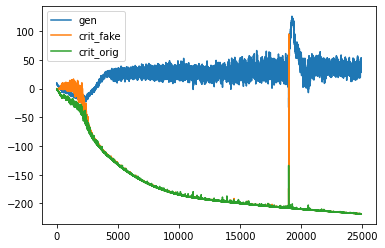

d loss fake  -218.24749755859375
d loss real  -218.30950927734375
[Epoch 73/100] [Batch 151/345] [D loss: -218.278503, acc:   0%] [G loss: 43.831038] [c1: 33.218262, c2: 33.170063, o: 92.484207, f: 42.560036] time: 16:07:50.543787
d loss fake  -218.2975616455078
d loss real  -218.35397338867188
[Epoch 73/100] [Batch 152/345] [D loss: -218.325768, acc:   0%] [G loss: 47.480259] [c1: 38.675076, c2: 38.531178, o: 83.204727, f: 33.140896] time: 16:07:52.850625
d loss fake  -218.30674743652344
d loss real  -218.36614990234375
[Epoch 73/100] [Batch 153/345] [D loss: -218.336449, acc:   0%] [G loss: 45.130668] [c1: 35.752510, c2: 35.498436, o: 87.543205, f: 38.205788] time: 16:07:55.118972
d loss fake  -218.31277465820312
d loss real  -218.27105712890625
[Epoch 73/100] [Batch 154/345] [D loss: -218.291916, acc:   0%] [G loss: 43.788201] [c1: 32.771690, c2: 32.817474, o: 86.416435, f: 35.215790] time: 16:07:57.401062
d loss fake  -218.30804443359375
d loss real  -218.32962036132812
[Epoch 73/1

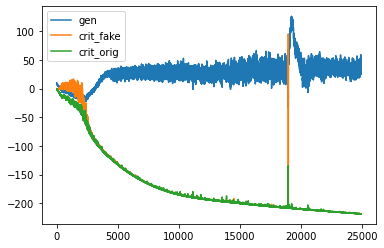

d loss fake  -218.33810424804688
d loss real  -218.3812255859375
[Epoch 73/100] [Batch 201/345] [D loss: -218.359665, acc:   0%] [G loss: 37.668417] [c1: 24.587177, c2: 24.512627, o: 77.828186, f: 30.347828] time: 16:09:45.389760
d loss fake  -218.39137268066406
d loss real  -218.37057495117188
[Epoch 73/100] [Batch 202/345] [D loss: -218.380974, acc:   0%] [G loss: 39.001379] [c1: 25.259071, c2: 25.286785, o: 74.495979, f: 23.375008] time: 16:09:47.665101
d loss fake  -218.38931274414062
d loss real  -218.422119140625
[Epoch 73/100] [Batch 203/345] [D loss: -218.405716, acc:   0%] [G loss: 37.672693] [c1: 25.638273, c2: 25.361149, o: 77.747368, f: 26.238657] time: 16:09:49.943001
d loss fake  -218.34405517578125
d loss real  -218.25877380371094
[Epoch 73/100] [Batch 204/345] [D loss: -218.301414, acc:   0%] [G loss: 49.300513] [c1: 42.954056, c2: 42.879959, o: 74.923119, f: 25.299480] time: 16:09:52.237350
d loss fake  -218.36500549316406
d loss real  -218.43170166015625
[Epoch 73/100

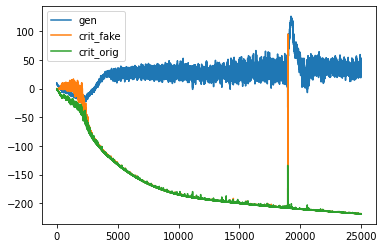

d loss fake  -218.46986389160156
d loss real  -218.4867401123047
[Epoch 73/100] [Batch 251/345] [D loss: -218.478302, acc:   0%] [G loss: 31.152454] [c1: 14.454769, c2: 14.150817, o: 69.069351, f: 17.640503] time: 16:11:41.288743
d loss fake  -218.21041870117188
d loss real  -218.50225830078125
[Epoch 73/100] [Batch 252/345] [D loss: -218.356339, acc:   0%] [G loss: 25.155252] [c1: 4.623343, c2: 4.416359, o: 63.268562, f: 14.002584] time: 16:11:43.579967
d loss fake  -218.44412231445312
d loss real  -218.15158081054688
[Epoch 73/100] [Batch 253/345] [D loss: -218.297852, acc:   0%] [G loss: 38.552818] [c1: 23.276556, c2: 23.070515, o: 53.604408, f: 4.759443] time: 16:11:45.862116
d loss fake  -218.35081481933594
d loss real  -218.5145263671875
[Epoch 73/100] [Batch 254/345] [D loss: -218.432671, acc:   0%] [G loss: 30.426401] [c1: 10.110947, c2: 10.381058, o: 76.270622, f: 21.757858] time: 16:11:48.153672
d loss fake  -218.3692626953125
d loss real  -218.51712036132812
[Epoch 73/100] [

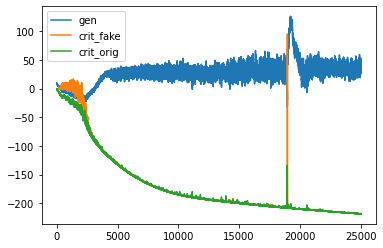

d loss fake  -218.46990966796875
d loss real  -218.50926208496094
[Epoch 73/100] [Batch 301/345] [D loss: -218.489586, acc:   0%] [G loss: 32.797525] [c1: 17.032255, c2: 16.999285, o: 68.989311, f: 20.187847] time: 16:13:37.529189
d loss fake  -218.5322265625
d loss real  -218.54440307617188
[Epoch 73/100] [Batch 302/345] [D loss: -218.538315, acc:   0%] [G loss: 31.106909] [c1: 15.546865, c2: 15.459766, o: 68.679535, f: 19.020977] time: 16:13:39.818302
d loss fake  -218.52651977539062
d loss real  -218.569091796875
[Epoch 73/100] [Batch 303/345] [D loss: -218.547806, acc:   0%] [G loss: 33.425620] [c1: 18.653469, c2: 18.591076, o: 63.690708, f: 15.241756] time: 16:13:42.107376
d loss fake  -218.54513549804688
d loss real  -218.56057739257812
[Epoch 73/100] [Batch 304/345] [D loss: -218.552856, acc:   0%] [G loss: 32.777961] [c1: 17.322105, c2: 17.180370, o: 68.216492, f: 18.139879] time: 16:13:44.405479
d loss fake  -218.4609375
d loss real  -218.53656005859375
[Epoch 73/100] [Batch 3

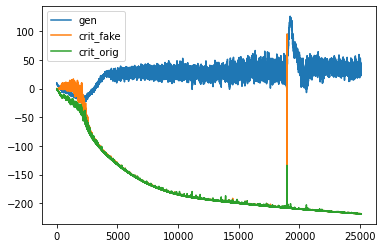

d loss fake  -218.53509521484375
d loss real  -218.62701416015625
[Epoch 74/100] [Batch 1/345] [D loss: -218.581055, acc:   0%] [G loss: 27.751314] [c1: 7.920598, c2: 7.738137, o: 64.447769, f: 14.126020] time: 16:15:12.909826
d loss fake  -217.98269653320312
d loss real  -218.41964721679688
[Epoch 74/100] [Batch 2/345] [D loss: -218.201172, acc:   0%] [G loss: 23.191809] [c1: -0.281281, c2: -0.312160, o: 58.882500, f: 6.833663] time: 16:15:15.237938
d loss fake  -218.44009399414062
d loss real  -218.28579711914062
[Epoch 74/100] [Batch 3/345] [D loss: -218.362946, acc:   0%] [G loss: 27.841371] [c1: 9.695099, c2: 9.465839, o: 54.574467, f: 1.208704] time: 16:15:17.585172
d loss fake  -218.43359375
d loss real  -218.61148071289062
[Epoch 74/100] [Batch 4/345] [D loss: -218.522537, acc:   0%] [G loss: 20.415044] [c1: -3.395799, c2: -3.483971, o: 61.240387, f: 9.692337] time: 16:15:19.925830
d loss fake  -218.5943603515625
d loss real  -218.616943359375
[Epoch 74/100] [Batch 5/345] [D lo

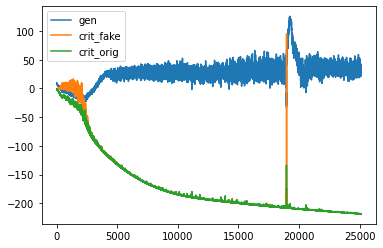

d loss fake  -218.509521484375
d loss real  -218.70126342773438
[Epoch 74/100] [Batch 51/345] [D loss: -218.605392, acc:   0%] [G loss: 22.513738] [c1: -1.044548, c2: -1.238181, o: 64.833710, f: 11.115480] time: 16:17:08.518822
d loss fake  -218.61956787109375
d loss real  -218.71786499023438
[Epoch 74/100] [Batch 52/345] [D loss: -218.668716, acc:   0%] [G loss: 19.601874] [c1: -4.761546, c2: -4.954274, o: 51.149860, f: -1.483616] time: 16:17:10.803681
d loss fake  -218.66452026367188
d loss real  -218.6872100830078
[Epoch 74/100] [Batch 53/345] [D loss: -218.675865, acc:   0%] [G loss: 22.074664] [c1: -0.944585, c2: -1.002561, o: 49.093964, f: -1.494810] time: 16:17:13.097039
d loss fake  -218.61016845703125
d loss real  -218.64285278320312
[Epoch 74/100] [Batch 54/345] [D loss: -218.626511, acc:   0%] [G loss: 25.498542] [c1: 4.027156, c2: 4.056548, o: 50.145149, f: -1.311586] time: 16:17:15.380157
d loss fake  -218.6153564453125
d loss real  -218.7021484375
[Epoch 74/100] [Batch 55

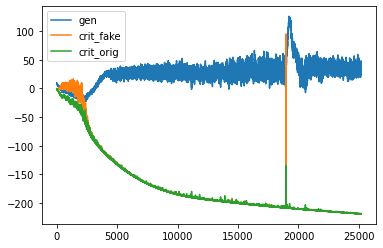

d loss fake  -218.72096252441406
d loss real  -218.7789764404297
[Epoch 74/100] [Batch 101/345] [D loss: -218.749969, acc:   0%] [G loss: 33.883451] [c1: 13.727236, c2: 13.550839, o: 73.708534, f: 16.676338] time: 16:19:04.946239
d loss fake  -218.73220825195312
d loss real  -218.76318359375
[Epoch 74/100] [Batch 102/345] [D loss: -218.747696, acc:   0%] [G loss: 33.447652] [c1: 14.898207, c2: 14.829589, o: 71.043304, f: 15.081615] time: 16:19:07.245265
d loss fake  -218.76385498046875
d loss real  -218.72543334960938
[Epoch 74/100] [Batch 103/345] [D loss: -218.744644, acc:   0%] [G loss: 38.089219] [c1: 21.332226, c2: 21.258991, o: 68.869278, f: 13.319094] time: 16:19:09.541134
d loss fake  -218.75437927246094
d loss real  -218.77835083007812
[Epoch 74/100] [Batch 104/345] [D loss: -218.766365, acc:   0%] [G loss: 36.072213] [c1: 18.429886, c2: 18.321962, o: 78.636169, f: 22.668236] time: 16:19:11.847605
d loss fake  -218.6257781982422
d loss real  -218.28221130371094
[Epoch 74/100] 

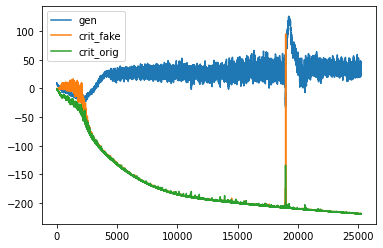

d loss fake  -218.78778076171875
d loss real  -218.8094940185547
[Epoch 74/100] [Batch 151/345] [D loss: -218.798637, acc:   0%] [G loss: 36.018940] [c1: 19.879356, c2: 19.620304, o: 72.742722, f: 21.968243] time: 16:21:01.499292
d loss fake  -218.80709838867188
d loss real  -218.85678100585938
[Epoch 74/100] [Batch 152/345] [D loss: -218.831940, acc:   0%] [G loss: 36.297831] [c1: 22.766407, c2: 22.675468, o: 71.613098, f: 20.672873] time: 16:21:03.790019
d loss fake  -218.82012939453125
d loss real  -218.79827880859375
[Epoch 74/100] [Batch 153/345] [D loss: -218.809204, acc:   0%] [G loss: 43.913342] [c1: 33.834656, c2: 33.798386, o: 73.652222, f: 21.271915] time: 16:21:06.079188
d loss fake  -218.7678680419922
d loss real  -218.81732177734375
[Epoch 74/100] [Batch 154/345] [D loss: -218.792595, acc:   0%] [G loss: 40.446067] [c1: 28.179993, c2: 28.071640, o: 85.091293, f: 35.104954] time: 16:21:08.374531
d loss fake  -218.6977081298828
d loss real  -218.80662536621094
[Epoch 74/100

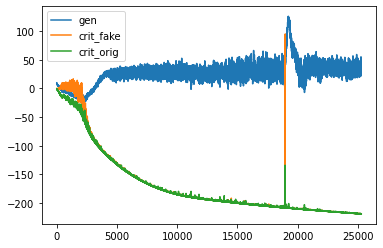

d loss fake  -218.8741455078125
d loss real  -218.9261474609375
[Epoch 74/100] [Batch 201/345] [D loss: -218.900146, acc:   0%] [G loss: 46.696525] [c1: 37.440781, c2: 37.180450, o: 86.960678, f: 35.998886] time: 16:22:56.790093
d loss fake  -218.90162658691406
d loss real  -218.84573364257812
[Epoch 74/100] [Batch 202/345] [D loss: -218.873680, acc:   0%] [G loss: 48.503859] [c1: 41.974770, c2: 41.891212, o: 87.121796, f: 38.348106] time: 16:22:59.088073
d loss fake  -218.92587280273438
d loss real  -218.94717407226562
[Epoch 74/100] [Batch 203/345] [D loss: -218.936523, acc:   0%] [G loss: 44.092429] [c1: 33.816460, c2: 33.788696, o: 91.451332, f: 41.018570] time: 16:23:01.374765
d loss fake  -218.86587524414062
d loss real  -218.949951171875
[Epoch 74/100] [Batch 204/345] [D loss: -218.907913, acc:   0%] [G loss: 38.808733] [c1: 27.174740, c2: 27.027233, o: 84.374268, f: 34.999603] time: 16:23:03.672081
d loss fake  -218.85951232910156
d loss real  -218.96485900878906
[Epoch 74/100]

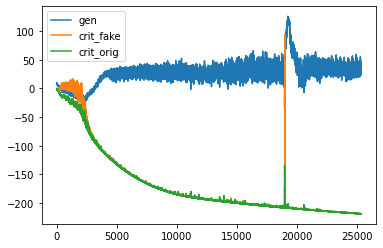

d loss fake  -218.98956298828125
d loss real  -218.99658203125
[Epoch 74/100] [Batch 251/345] [D loss: -218.993073, acc:   0%] [G loss: 38.980618] [c1: 23.576771, c2: 23.433167, o: 84.606155, f: 31.135742] time: 16:24:53.588788
d loss fake  -218.93629455566406
d loss real  -219.0311279296875
[Epoch 74/100] [Batch 252/345] [D loss: -218.983711, acc:   0%] [G loss: 30.525631] [c1: 10.152467, c2: 9.994755, o: 75.023270, f: 23.780796] time: 16:24:55.886626
d loss fake  -218.98403930664062
d loss real  -219.02838134765625
[Epoch 74/100] [Batch 253/345] [D loss: -219.006210, acc:   0%] [G loss: 29.885700] [c1: 11.039663, c2: 10.865403, o: 61.312019, f: 11.748653] time: 16:24:58.177157
d loss fake  -218.96910095214844
d loss real  -219.01470947265625
[Epoch 74/100] [Batch 254/345] [D loss: -218.991905, acc:   0%] [G loss: 29.162985] [c1: 9.634792, c2: 9.388854, o: 60.707726, f: 9.977360] time: 16:25:00.466835
d loss fake  -218.97027587890625
d loss real  -218.9163360595703
[Epoch 74/100] [Bat

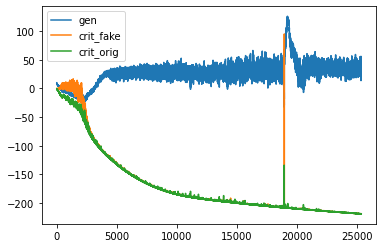

d loss fake  -219.0558319091797
d loss real  -219.0745391845703
[Epoch 74/100] [Batch 301/345] [D loss: -219.065186, acc:   0%] [G loss: 38.338064] [c1: 25.253893, c2: 25.289825, o: 81.772430, f: 31.045570] time: 16:26:49.852647
d loss fake  -219.02647399902344
d loss real  -219.08206176757812
[Epoch 74/100] [Batch 302/345] [D loss: -219.054268, acc:   0%] [G loss: 35.343314] [c1: 20.342365, c2: 20.330980, o: 77.611755, f: 26.665466] time: 16:26:52.145000
d loss fake  -219.06277465820312
d loss real  -219.09584045410156
[Epoch 74/100] [Batch 303/345] [D loss: -219.079308, acc:   0%] [G loss: 35.597343] [c1: 21.109901, c2: 21.066223, o: 70.079773, f: 20.323542] time: 16:26:54.435364
d loss fake  -219.0594024658203
d loss real  -219.08399963378906
[Epoch 74/100] [Batch 304/345] [D loss: -219.071701, acc:   0%] [G loss: 34.807314] [c1: 21.098333, c2: 21.016987, o: 70.272034, f: 20.242241] time: 16:26:56.734887
d loss fake  -219.03504943847656
d loss real  -219.00616455078125
[Epoch 74/100

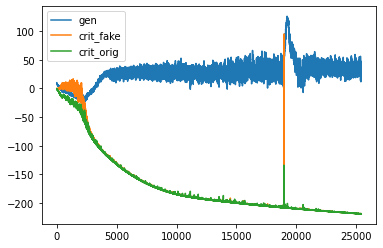

d loss fake  -219.05404663085938
d loss real  -219.12908935546875
[Epoch 75/100] [Batch 1/345] [D loss: -219.091568, acc:   0%] [G loss: 24.121498] [c1: 2.589166, c2: 2.526177, o: 59.956764, f: 8.813506] time: 16:28:25.600244
d loss fake  -218.88980102539062
d loss real  -219.10882568359375
[Epoch 75/100] [Batch 2/345] [D loss: -218.999313, acc:   0%] [G loss: 22.385472] [c1: -0.608301, c2: -0.674699, o: 52.902374, f: 3.339917] time: 16:28:27.958122
d loss fake  -218.94137573242188
d loss real  -219.11680603027344
[Epoch 75/100] [Batch 3/345] [D loss: -219.029091, acc:   0%] [G loss: 21.510887] [c1: -1.146930, c2: -1.260783, o: 51.703781, f: -1.992877] time: 16:28:30.330037
d loss fake  -219.07688903808594
d loss real  -219.14857482910156
[Epoch 75/100] [Batch 4/345] [D loss: -219.112732, acc:   0%] [G loss: 23.197144] [c1: 2.110265, c2: 1.900617, o: 54.567131, f: 3.301712] time: 16:28:32.688696
d loss fake  -219.096923828125
d loss real  -219.13375854492188
[Epoch 75/100] [Batch 5/345

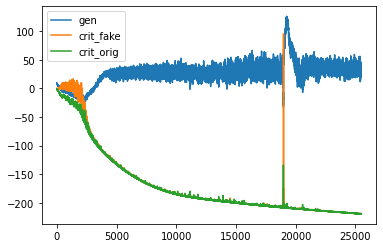

d loss fake  -219.1508331298828
d loss real  -219.22894287109375
[Epoch 75/100] [Batch 51/345] [D loss: -219.189888, acc:   0%] [G loss: 36.552103] [c1: 19.312523, c2: 19.249470, o: 87.222420, f: 33.754868] time: 16:30:21.103983
d loss fake  -219.17327880859375
d loss real  -219.18650817871094
[Epoch 75/100] [Batch 52/345] [D loss: -219.179893, acc:   0%] [G loss: 31.347838] [c1: 14.980804, c2: 14.964502, o: 72.284241, f: 19.365822] time: 16:30:23.392520
d loss fake  -219.14797973632812
d loss real  -219.16632080078125
[Epoch 75/100] [Batch 53/345] [D loss: -219.157150, acc:   0%] [G loss: 30.266782] [c1: 13.518188, c2: 13.306826, o: 67.215652, f: 16.990660] time: 16:30:25.681486
d loss fake  -219.1929931640625
d loss real  -219.1251678466797
[Epoch 75/100] [Batch 54/345] [D loss: -219.159081, acc:   0%] [G loss: 33.420734] [c1: 16.675964, c2: 16.313459, o: 64.454895, f: 11.707385] time: 16:30:27.974608
d loss fake  -219.1714630126953
d loss real  -219.21224975585938
[Epoch 75/100] [Ba

In [0]:
os.chdir(base_path)
from procedures.trainer import *


savepath = 'wasserstein_17'
print("Training CT-GAN Injector...")
CTGAN_inj = Trainer(isInjector = True,
                    savepath=savepath,
                    d_lr=1e-6,
                    combined_lr=1e-6,
                    modelpath=savepath,
                    generator_weight_updates=1,
                    wgan=True,
                    adain=True
                    )
CTGAN_inj.train(epochs=100, batch_size=32, sample_interval=50)
print('Done.')

In [6]:
!pip install pydicom
!pip install SimpleITK

     |████████████████████████████████| 35.3MB 93kB/s 
     |████████████████████████████████| 42.5MB 73kB/s 
